# Look at runs with multiple nudges 
Useful for getting better estimate of energy change per nudge

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import statistics
pd.set_option('display.max_columns',500)

In [2]:
df_2020 = pd.read_csv("csv_data/merged/Spring2020Merged_goodRuns.csv")
df_2023 = pd.read_csv("csv_data/merged/Spring2023Merged_goodRuns.csv")
df_2025 = pd.read_csv("csv_data/merged/Spring2025Merged_goodRuns.csv")

/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1971075393.py:1: DtypeWarning: Columns (31,32,33) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2020 = pd.read_csv("csv_data/merged/Spring2020Merged_goodRuns.csv")
/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1971075393.py:2: DtypeWarning: Columns (32,33,34) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2023 = pd.read_csv("csv_data/merged/Spring2023Merged_goodRuns.csv")
/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1971075393.py:3: DtypeWarning: Columns (31,32,33) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2025 = pd.read_csv("csv_data/merged/Spring2025Merged_goodRuns.csv")


In [3]:
# select runs with multiple nudges. Include backlash for now, the non-backlash nudges are still useful to get energy per nudge
def select_data(df_in):
    df_out = df_in[(df_in['goodRun'])&(df_in['RunHasNudge'])&(df_in['TotalNudges_thisRun']>=1)]
    return df_out

In [4]:
df_2020_good = select_data(df_2020)
df_2023_good = select_data(df_2023)
df_2025_good = select_data(df_2025)

In [5]:
print(df_2020_good['GONI:ROLL'].value_counts())
print(df_2020_good['CBREM:PLANE'].value_counts())

GONI:ROLL
 34.50    456350
-10.50    415326
 29.55     14436
 0.00      11173
Name: count, dtype: int64
CBREM:PLANE
1.0    472612
2.0    409357
0.0     15316
Name: count, dtype: int64


In [6]:
# copy viz code from other notebook (or make it a utility aviailble to all would be better)
nudge_list_2020 = df_2020_good['RunNumber'].unique()
nudge_list_2023 = df_2023_good['RunNumber'].unique()
nudge_list_2025 = df_2025_good['RunNumber'].unique()

In [7]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import statistics
pd.set_option('display.max_columns',500)

def plot_run(df_in, runNumber):

    print("plotting for run ",runNumber)

    # min and max coherent edge energy to include
    minE = 8550
    maxE = 8650
    expectedE = 8600

    roll_0_90 = -10.5
    roll_45_135 = 34.5

    titleRunPeriod = "Spring 20"
    runPeriod = "Spring2020"
    if (runNumber>80000) and (runNumber < 130000):
        runPeriod = 'Spring2023'
        titleRunPeriod = "Spring 23"
        minE = 8520
        maxE = 8720
        expectedE = 8620
        roll_0_90 = 162
        roll_45_135 = -153
    elif runNumber>130000:
        runPeriod = 'Spring2025'
        titleRunPeriod = "Spring 25"
        minE = 8800
        maxE = 9000
        expectedE = 8900
        roll_0_90 = -16.6
        roll_45_135 = 28.4

    df_run_nudges = df_in[(df_in['RunNumber']==runNumber)&(df_in['NudgeOccurred'])&(~df_in['BacklashNudge'])]
    nudge_list = df_run_nudges['NudgeNumber'].unique()

    fig, (ax1, ax2) = plt.subplots(2,1,sharex=True)
    
    set_energy_drawn = False
    nudge_label_set = False

    nudge_times = []
    pitchDiffs = []
    yawDiffs = []

    first_nudge_time = -1000
    max_nudge_time = 0
    
    for seq in nudge_list:

        df_this_nudge = df_run_nudges[df_run_nudges['NudgeNumber']==seq]
        nudge_time = df_this_nudge['TimeStamp'].min()
        print('Nudge number',seq,'occurs at time',nudge_time)

        if first_nudge_time==-1000:
            first_nudge_time = nudge_time

        current_pitchDiff = df_this_nudge['NudgePitchSize'].unique()[0]    
        current_yawDiff = df_this_nudge['NudgeYawSize'].unique()[0]

        # no clue what is causing this, nudges should never be this big. Config change?
        if abs(current_pitchDiff)>1 or abs(current_yawDiff)>1:
            #print(df_this_nudge)
            continue

        pitchDiffs.append(current_pitchDiff)
        yawDiffs.append(current_yawDiff)
        nudge_times.append(nudge_time)
            
        if nudge_time>max_nudge_time:
            max_nudge_time = nudge_time

        # plot the nudge with a vertical red line, add label if label not set yet
        if not nudge_label_set:
            ax1.axvline(nudge_time,color='r',linestyle='--',label='Nudge')
            nudge_label_set = True
        else:
            ax1.axvline(nudge_time,color='r',linestyle='--')
        
        # draw the desired energy and a green shaded +/- 10 MeV band
        if not set_energy_drawn:
            ax1.axhline(y=expectedE,color='g',linestyle='--',label='Set Energy')
            ax1.axhspan(expectedE-10,expectedE+10,color='g',alpha=0.1)
            set_energy_drawn = True
           
    # get the time when the DAQ turned on (status 2)
    df_daq_on = df_in[(df_in['RunNumber']==runNumber)&(df_in['DAQ:STATUS']==2)]

    # initialize to large value. If daq never turned on, defaults to first nudge time
    daq_on_time = 10000
    set_daq_on_time = False
    if not df_daq_on.empty:
        daq_on_time = df_daq_on['TimeStamp'].min()
        set_daq_on_time = True
        print('daq on at time',daq_on_time)


    ax2.plot(nudge_times,yawDiffs,label='YawDiff',marker='o')
    ax2.plot(nudge_times,pitchDiffs,label='PitchDiff',marker='o')
    ax2.set_ylabel('Difference (Degrees)')
    plt.xlabel("Time Stamp (s)")
    ax2.legend()
    
    if set_daq_on_time:
        ax1.axvline(daq_on_time,color='black',label='DAQ On')

    # want the later of the daq turning on and the last nudge
    end_time = max(daq_on_time,max_nudge_time)
    # want the earliest of the daq turning on and the first nudge
    first_time = min(first_nudge_time,daq_on_time)
    
    df_vis = df_in[(df_in['RunNumber']==runNumber)&(df_in['TimeStamp']>=(first_time-30))&(df_in['TimeStamp']<=(end_time+30))&(df_in['CBREM:ENERGY']<maxE)&(df_in['CBREM:ENERGY']>minE)]

    ax1.plot(df_vis['TimeStamp'],df_vis['CBREM:ENERGY'],color='b')
    ax1.yaxis.set_minor_locator(ticker.MultipleLocator(5))

    
    print(df_vis['CBREM:PLANE'].unique())
    plane_values = df_vis['CBREM:PLANE'].mode()
    roll_values = df_vis['GONI:ROLL'].mode()
    print("plane_values are",plane_values)
    print('roll_values are',roll_values)
    print('roll values are',df_vis['GONI:ROLL'].value_counts())
    print('roll values are',df_in[df_in['RunNumber']==runNumber]['GONI:ROLL'].value_counts())

    plane_str = 'Undefined'
    if len(plane_values)==0:
        plane_str = 'Undefined'
    elif plane_values[0]==2:
        plane_str = "PERP"
    elif plane_values[0]==1:
        plane_str = "PARA"
    
    outStr = "Undefined"
    orStr = "Undefined "
    if len(roll_values)==0:
        print('roll values has length 0')
    elif abs(roll_values[0]-roll_0_90)<1.0:
        orStr = "0/90 " 
        outStr = "0_90"
    elif abs(roll_values[0]-roll_45_135)<1.0:
        orStr = "45/135 "
        outStr = "45_135"

    titleStr = 'Run Number '+str(runNumber)+" "+orStr+" "+plane_str
    
    ax1.set_title(titleStr)

    ax1.set_ylabel("Photon Energy (GeV)")
    ax1.legend()

    if outStr!='Undefined' and plane_str!='Undefined':
        plt.savefig("plots/multiNudge/"+outStr+"_"+plane_str+"/plot_run_"+str(runNumber)+".pdf")
 
    plt.show()

    plt.clf()


plotting for run  72102.0
Nudge number 1 occurs at time 441.0
Nudge number 2 occurs at time 466.0
Nudge number 5 occurs at time 515.0
Nudge number 6 occurs at time 522.0
Nudge number 7 occurs at time 546.0
Nudge number 8 occurs at time 555.0
Nudge number 9 occurs at time 562.0
Nudge number 10 occurs at time 573.0
Nudge number 11 occurs at time 583.0
Nudge number 12 occurs at time 607.0
Nudge number 13 occurs at time 625.0
daq on at time 724.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    294
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7148
 0.0       99
Name: count, dtype: int64


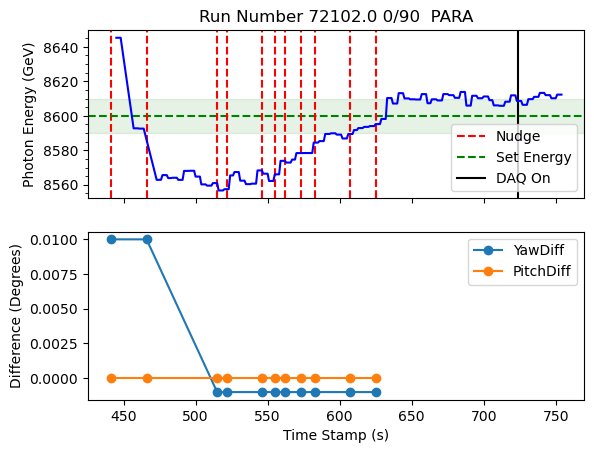

plotting for run  72104.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    0.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 0.0     83
-10.5    58
Name: count, dtype: int64
roll values are GONI:ROLL
 0.0     83
-10.5    81
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

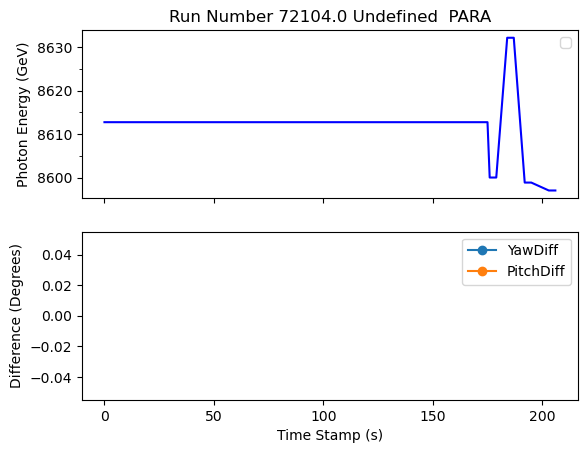

plotting for run  72105.0
Nudge number 2 occurs at time 192.0
daq on at time 270.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6616
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

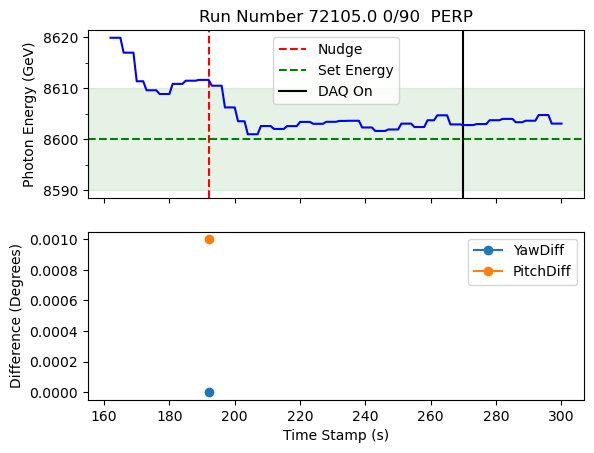

plotting for run  72107.0
Nudge number 5 occurs at time 524.0
Nudge number 6 occurs at time 608.0
Nudge number 8 occurs at time 753.0
Nudge number 10 occurs at time 808.0
Nudge number 11 occurs at time 821.0
daq on at time 960.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    371
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6328
-10.5     162
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

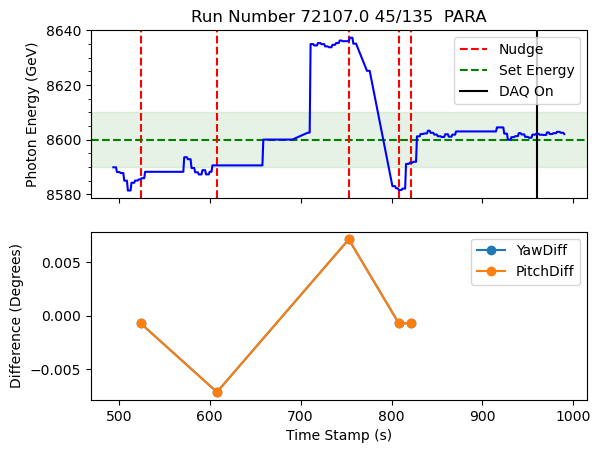

plotting for run  72109.0
Nudge number 4 occurs at time 211.0
Nudge number 5 occurs at time 216.0
daq on at time 252.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    99
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6189
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

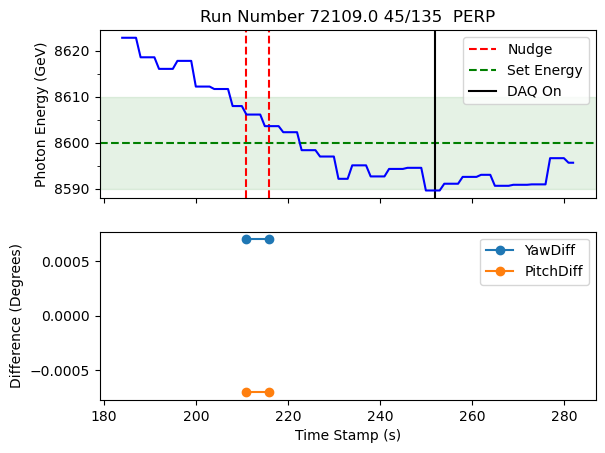

plotting for run  72112.0
Nudge number 2 occurs at time 244.0
Nudge number 3 occurs at time 250.0
Nudge number 4 occurs at time 253.0
Nudge number 5 occurs at time 257.0
Nudge number 6 occurs at time 261.0
Nudge number 7 occurs at time 265.0
Nudge number 8 occurs at time 269.0
Nudge number 9 occurs at time 273.0
daq on at time 236.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    61
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6618
 0.0       67
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

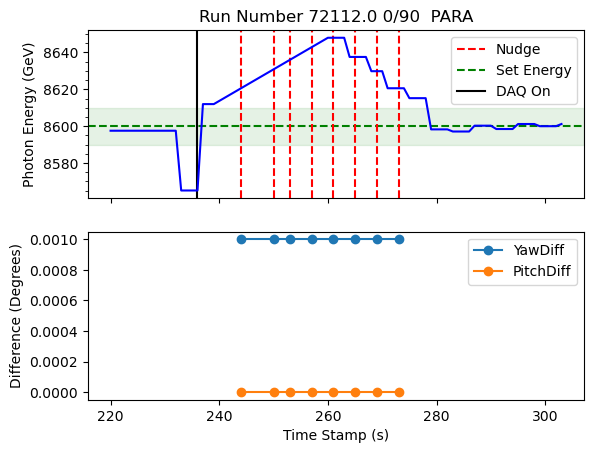

plotting for run  72115.0
[0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    96
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    96
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

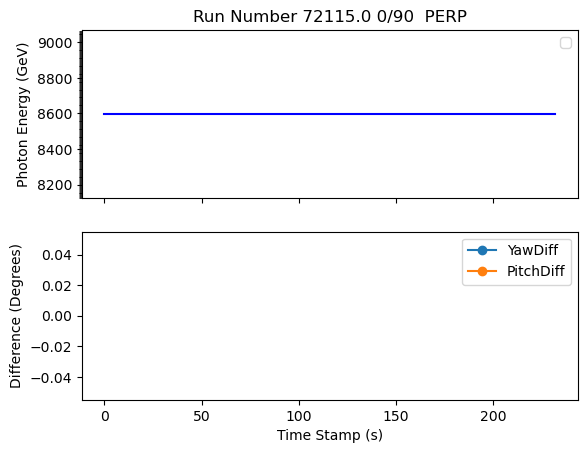

plotting for run  72116.0
Nudge number 1 occurs at time 9.0
daq on at time 37.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    55
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    2126
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

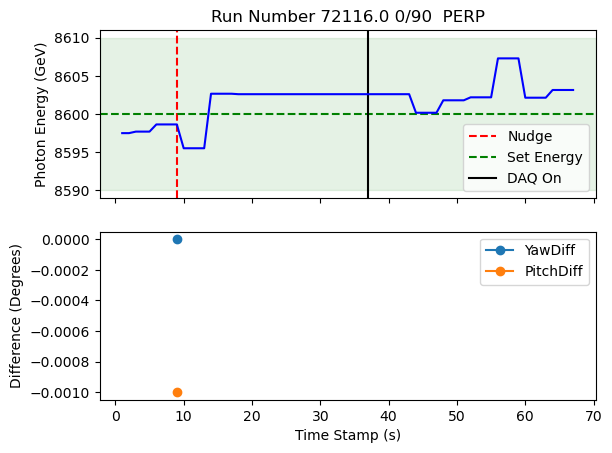

plotting for run  72119.0
Nudge number 6 occurs at time 450.0
Nudge number 7 occurs at time 462.0
Nudge number 8 occurs at time 4071.0
Nudge number 9 occurs at time 4083.0
Nudge number 13 occurs at time 4210.0
Nudge number 14 occurs at time 4228.0
daq on at time 4265.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    241
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6413
-10.5      66
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

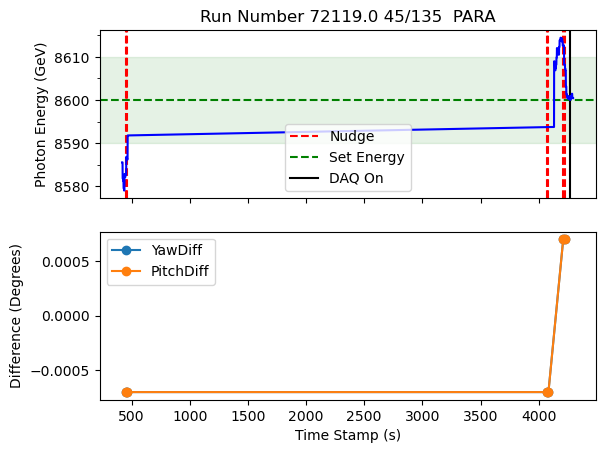

plotting for run  72127.0
Nudge number 1 occurs at time 74.0
Nudge number 2 occurs at time 81.0
Nudge number 5 occurs at time 180.0
daq on at time 263.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    229
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6373
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

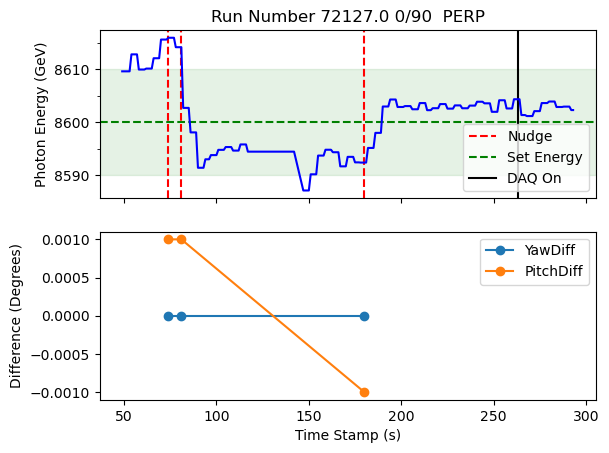

plotting for run  72130.0
daq on at time 464.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    299
-10.5     61
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6314
-10.5      61
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

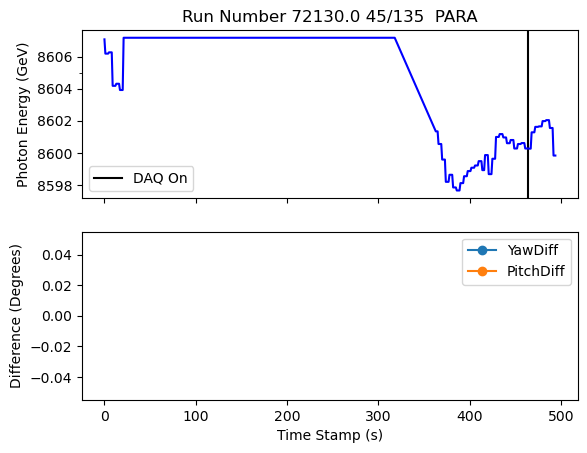

plotting for run  72133.0
daq on at time 193.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    222
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6528
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

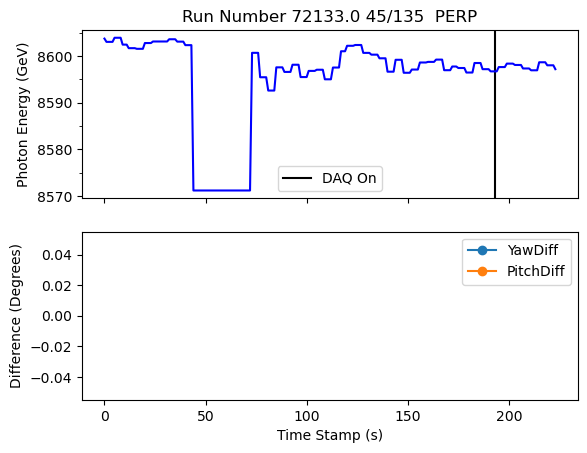

plotting for run  72138.0
daq on at time 404.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    277
 0.0      93
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6769
 0.0       93
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

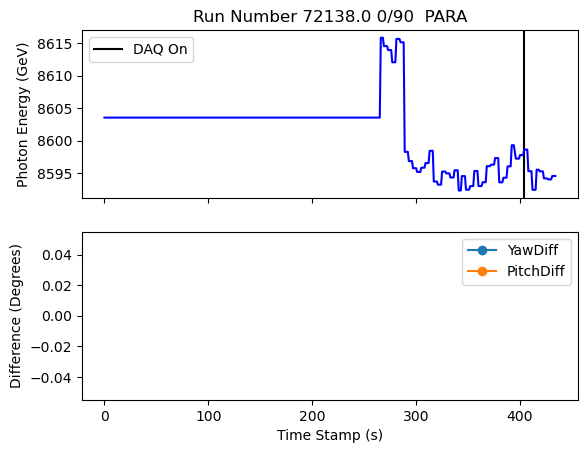

plotting for run  72142.0
Nudge number 1 occurs at time 50.0
Nudge number 2 occurs at time 74.0
Nudge number 3 occurs at time 93.0
daq on at time 200.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    200
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6559
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

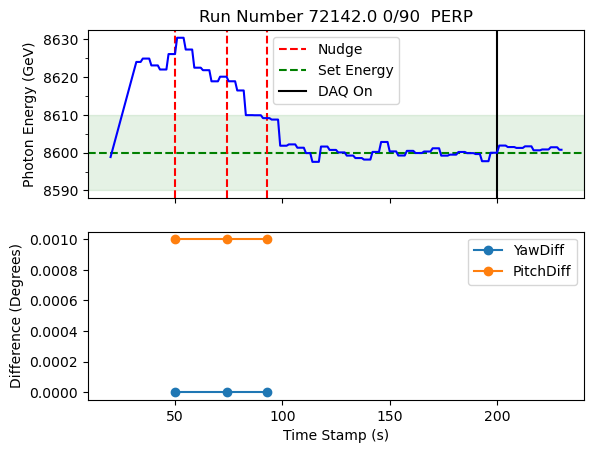

plotting for run  72145.0
Nudge number 5 occurs at time 294.0
Nudge number 6 occurs at time 298.0
Nudge number 7 occurs at time 303.0
Nudge number 8 occurs at time 306.0
Nudge number 9 occurs at time 326.0
Nudge number 10 occurs at time 340.0
Nudge number 11 occurs at time 406.0
Nudge number 19 occurs at time 773.0
Nudge number 20 occurs at time 789.0
daq on at time 489.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    530
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6283
-10.5      12
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

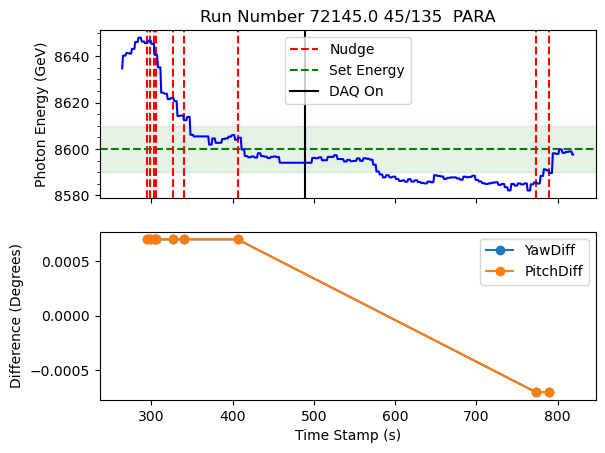

plotting for run  72158.0
Nudge number 2 occurs at time 1453.0
Nudge number 3 occurs at time 1471.0
daq on at time 1591.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    193
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7572
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

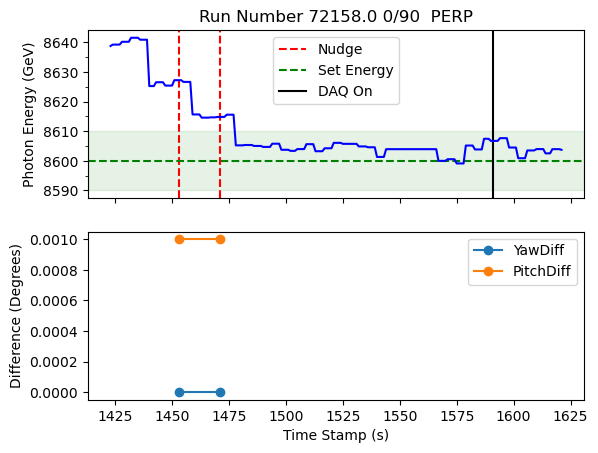

plotting for run  72160.0
daq on at time 613.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    305
-10.5    114
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6661
-10.5     114
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

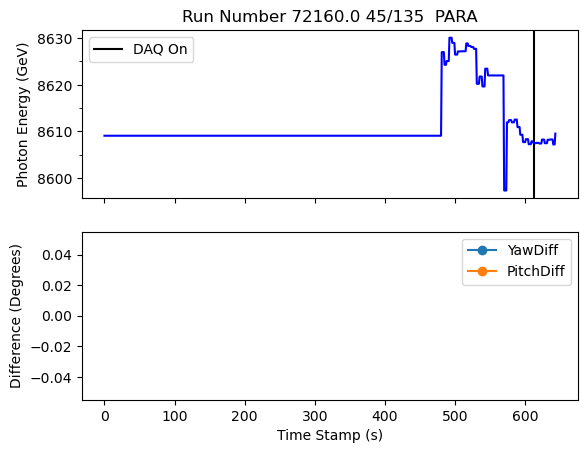

plotting for run  72163.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    76
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    76
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

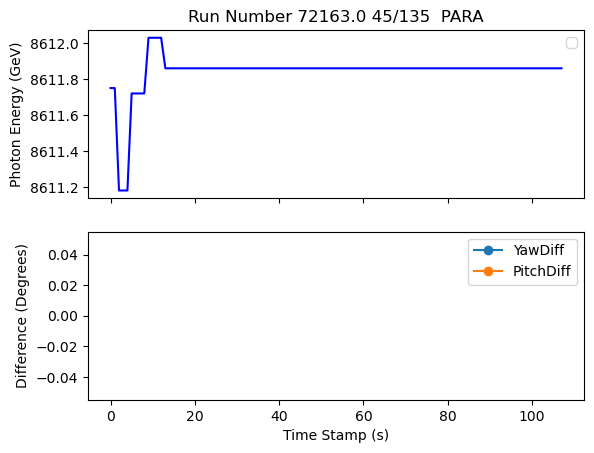

plotting for run  72173.0
Nudge number 2 occurs at time 221.0
Nudge number 3 occurs at time 232.0
daq on at time 329.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    169
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6827
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

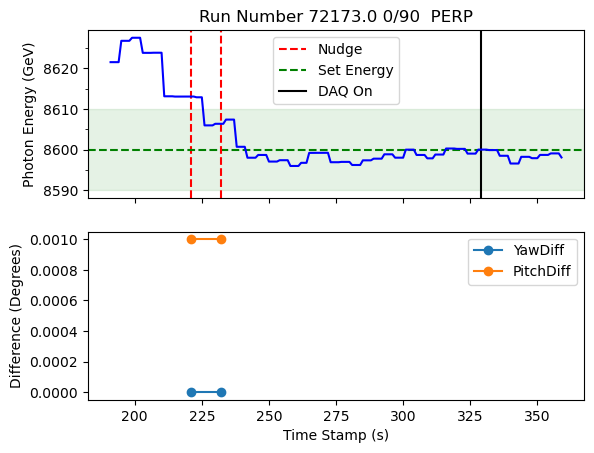

plotting for run  72176.0
Nudge number 4 occurs at time 336.0
Nudge number 5 occurs at time 341.0
Nudge number 6 occurs at time 346.0
Nudge number 7 occurs at time 349.0
Nudge number 8 occurs at time 353.0
Nudge number 11 occurs at time 415.0
Nudge number 12 occurs at time 436.0
Nudge number 13 occurs at time 451.0
Nudge number 14 occurs at time 474.0
Nudge number 15 occurs at time 494.0
Nudge number 16 occurs at time 517.0
Nudge number 17 occurs at time 555.0
daq on at time 690.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    310
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7042
-10.5      58
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

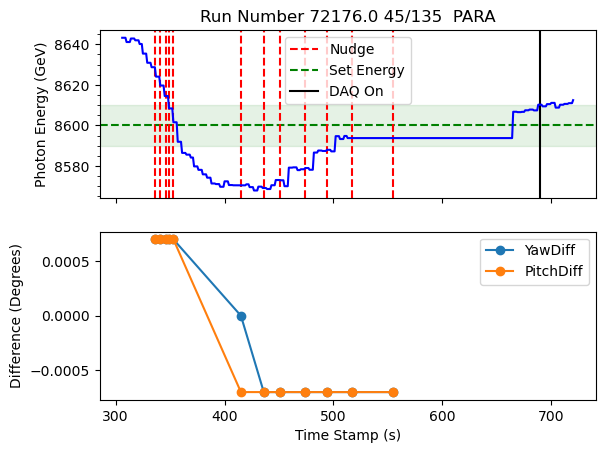

plotting for run  72178.0
Nudge number 4 occurs at time 1860.0
daq on at time 1814.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    105
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    4250
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

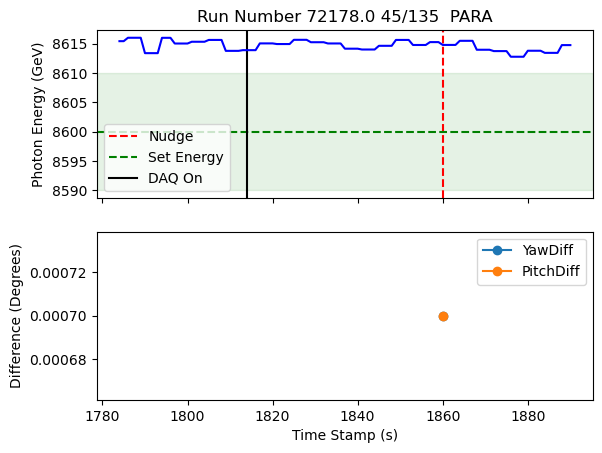

plotting for run  72179.0
Nudge number 2 occurs at time 156.0
daq on at time 166.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    71
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6151
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

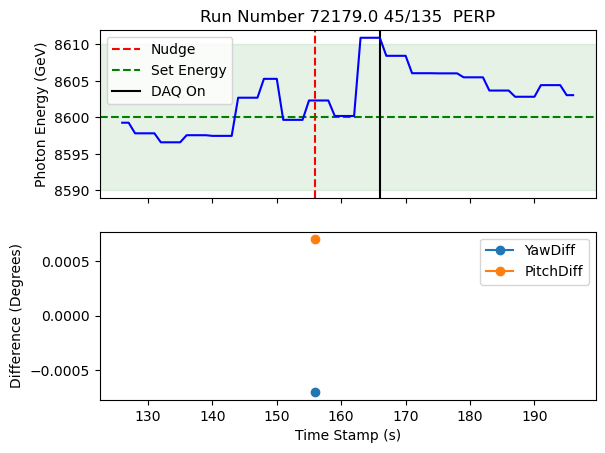

plotting for run  72187.0
Nudge number 2 occurs at time 645.0
Nudge number 3 occurs at time 671.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    98
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    307
 0.0     164
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

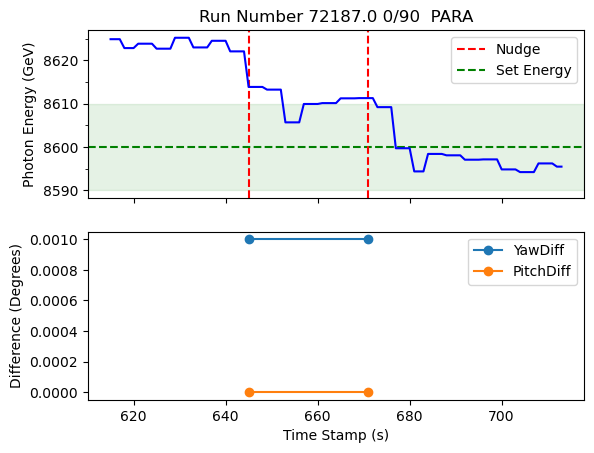

plotting for run  72190.0
Nudge number 1 occurs at time 123.0
Nudge number 2 occurs at time 134.0
daq on at time 185.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    118
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6967
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

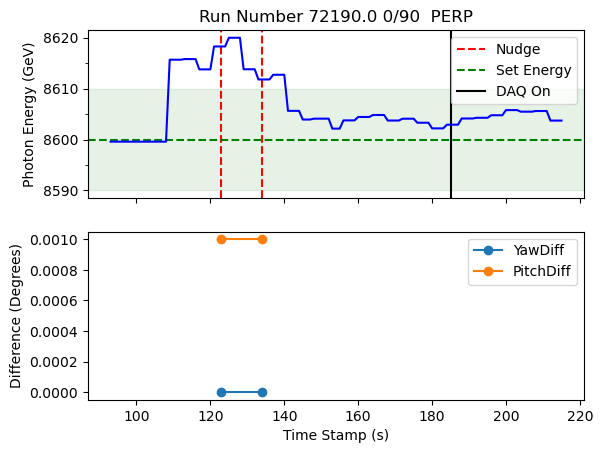

plotting for run  72192.0
[2. 0.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    56
 34.5    47
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    56
 34.5    47
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

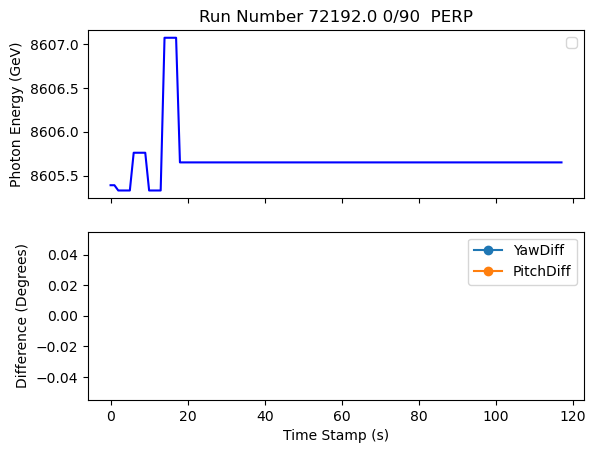

plotting for run  72246.0
Nudge number 2 occurs at time 451.0
Nudge number 3 occurs at time 469.0
daq on at time 499.0
[0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    109
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5315
 0.0      101
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

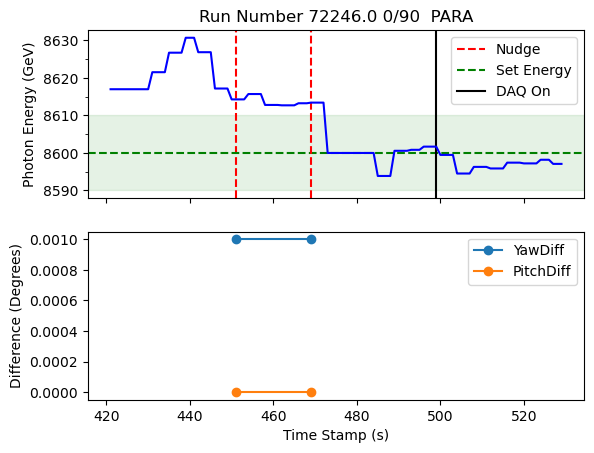

plotting for run  72251.0
daq on at time 2859.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    29.55
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 29.55    1738
-10.50     595
Name: count, dtype: int64
roll values are GONI:ROLL
-10.50    3901
 29.55    1738
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

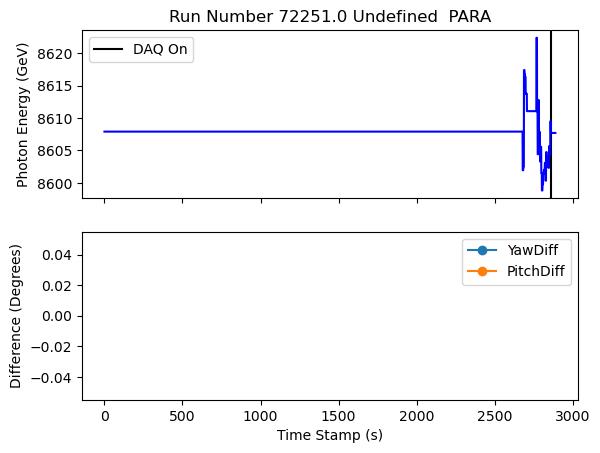

plotting for run  72257.0
Nudge number 1 occurs at time 82.0
Nudge number 2 occurs at time 90.0
Nudge number 3 occurs at time 98.0
Nudge number 6 occurs at time 187.0
daq on at time 210.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    189
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6854
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

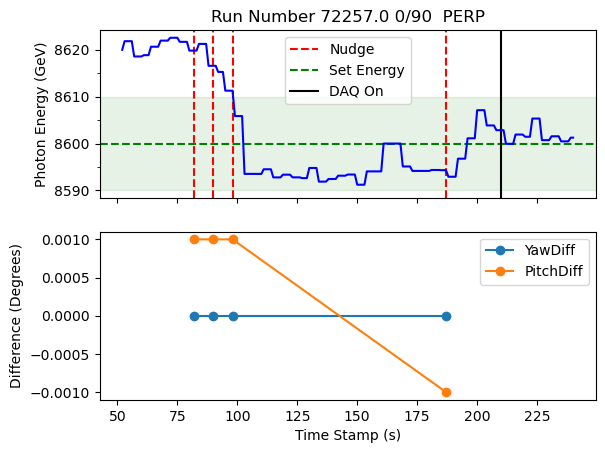

plotting for run  72258.0
Nudge number 5 occurs at time 398.0
Nudge number 6 occurs at time 410.0
Nudge number 7 occurs at time 420.0
Nudge number 8 occurs at time 429.0
Nudge number 9 occurs at time 434.0
Nudge number 10 occurs at time 440.0
Nudge number 11 occurs at time 447.0
Nudge number 15 occurs at time 509.0
Nudge number 16 occurs at time 519.0
Nudge number 17 occurs at time 544.0
Nudge number 21 occurs at time 672.0
Nudge number 22 occurs at time 696.0
daq on at time 739.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    378
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7199
-10.5      54
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

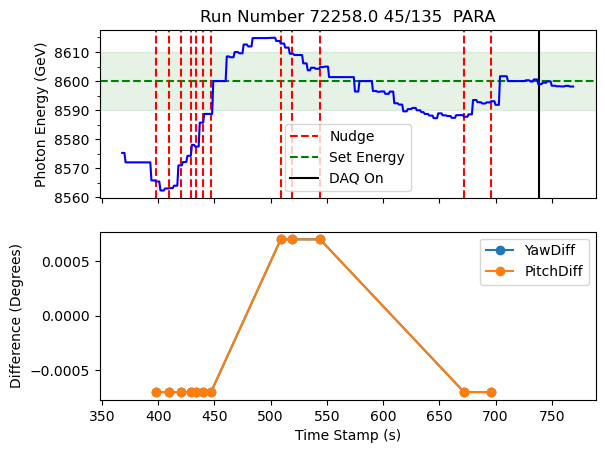

plotting for run  72260.0
daq on at time 260.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    247
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6751
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

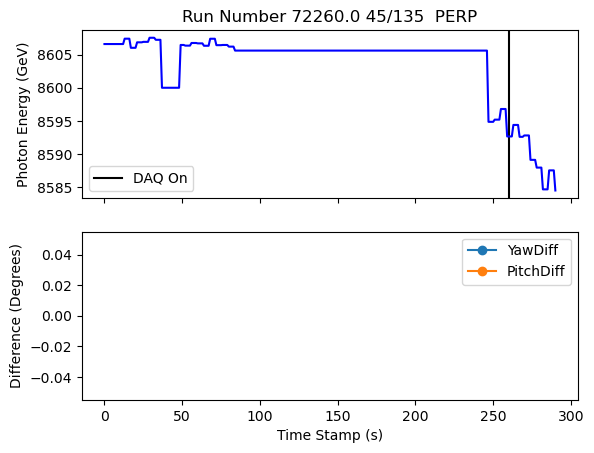

plotting for run  72264.0
Nudge number 2 occurs at time 418.0
Nudge number 3 occurs at time 448.0
daq on at time 432.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    91
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6570
 0.0      181
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

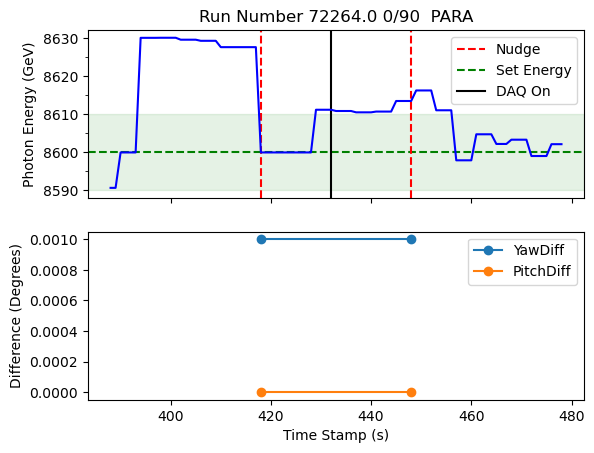

plotting for run  72265.0
Nudge number 3 occurs at time 8702.0
Nudge number 5 occurs at time 8748.0
Nudge number 6 occurs at time 8775.0
daq on at time 8853.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    197
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    11031
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

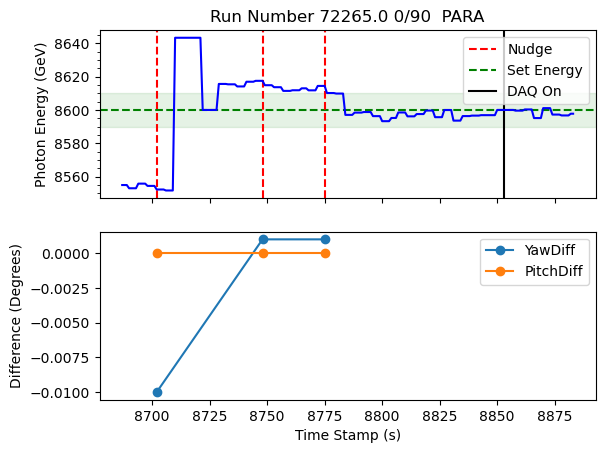

plotting for run  72266.0
Nudge number 2 occurs at time 366.0
daq on at time 344.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    83
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6860
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

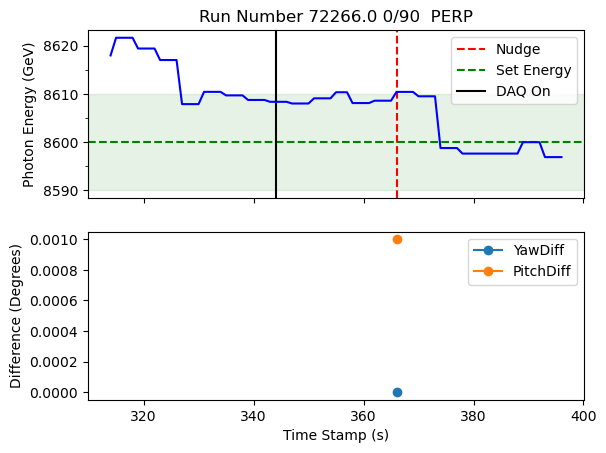

plotting for run  72268.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    107
-10.5     59
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    107
-10.5     59
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

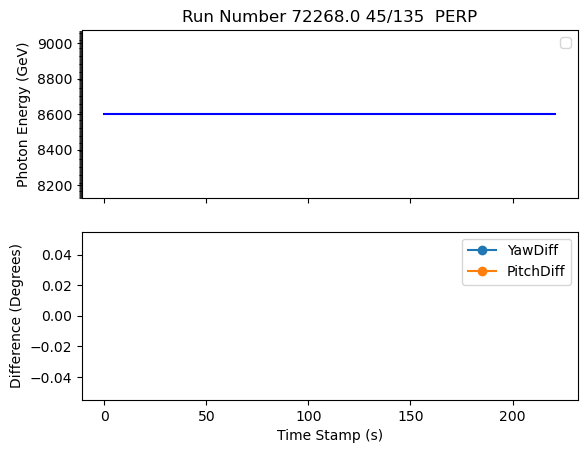

plotting for run  72273.0
daq on at time 235.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    221
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7056
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

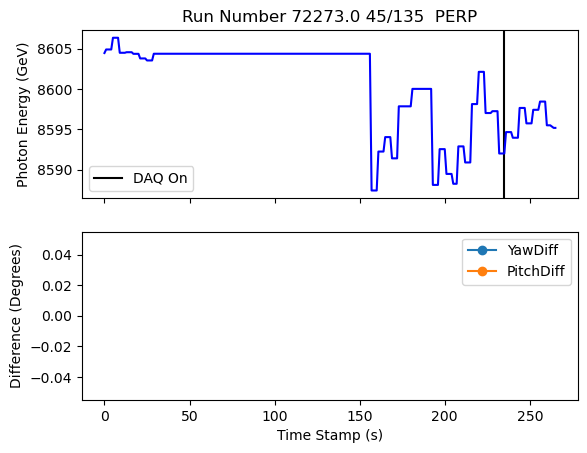

plotting for run  72274.0
Nudge number 1 occurs at time 268.0
daq on at time 142.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    185
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5079
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

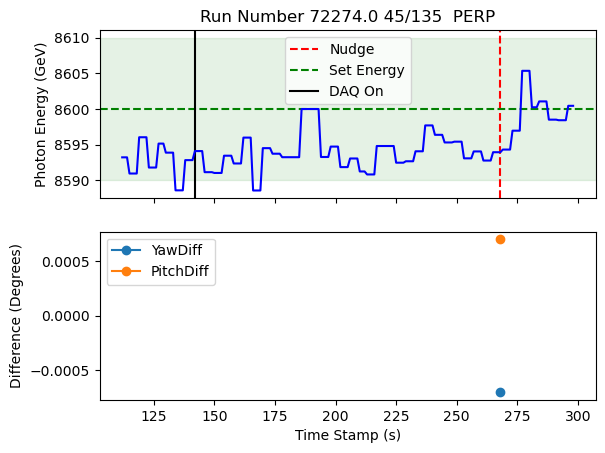

plotting for run  72283.0
daq on at time 367.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    194
 0.0     129
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6932
 0.0      129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

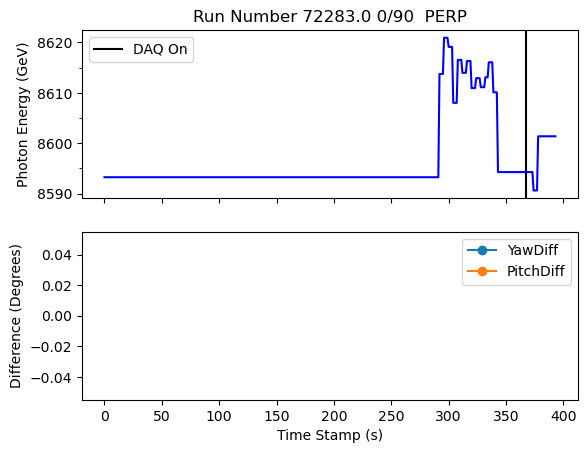

plotting for run  72285.0
Nudge number 2 occurs at time 197.0
daq on at time 341.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    205
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7561
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

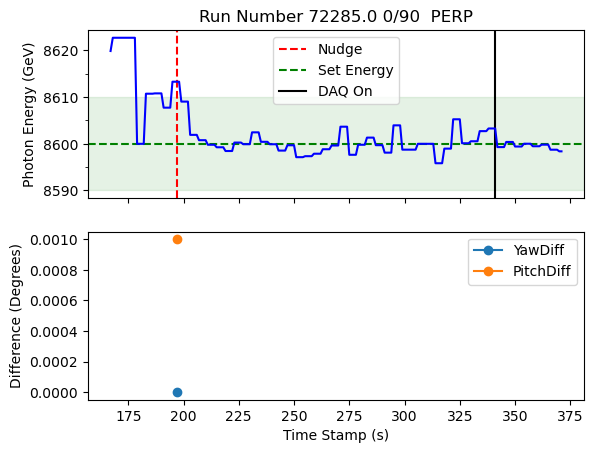

plotting for run  72294.0
Nudge number 2 occurs at time 414.0
Nudge number 3 occurs at time 435.0
Nudge number 4 occurs at time 438.0
Nudge number 5 occurs at time 444.0
Nudge number 6 occurs at time 445.0
Nudge number 7 occurs at time 457.0
Nudge number 8 occurs at time 458.0
daq on at time 568.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    175
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7109
-10.5      47
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

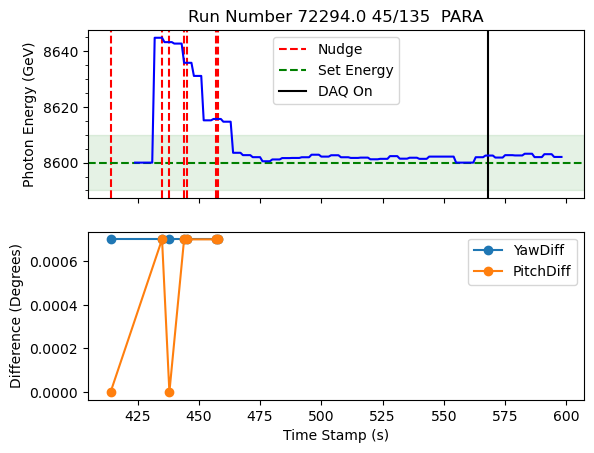

plotting for run  72297.0
Nudge number 2 occurs at time 3520.0
Nudge number 3 occurs at time 3566.0
daq on at time 1763.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1613
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7037
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

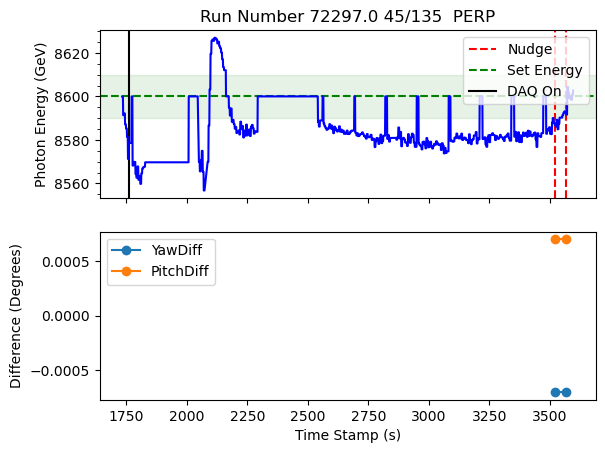

plotting for run  72302.0
daq on at time 452.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    229
 0.0     205
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6932
 0.0      205
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

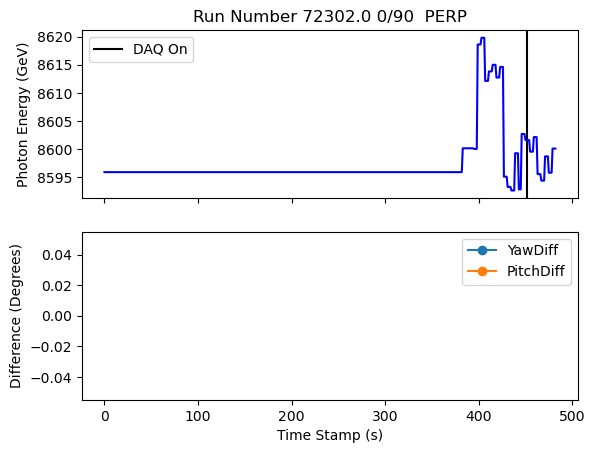

plotting for run  72363.0
Nudge number 4 occurs at time 705.0
Nudge number 5 occurs at time 716.0
Nudge number 6 occurs at time 738.0
daq on at time 1153.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    438
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6777
-10.5     336
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

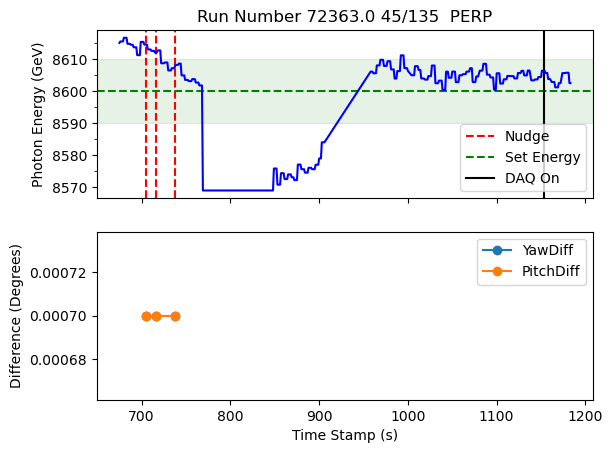

plotting for run  72367.0
Nudge number 1 occurs at time 3966.0
daq on at time 4332.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    427
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    9414
 0.0      280
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

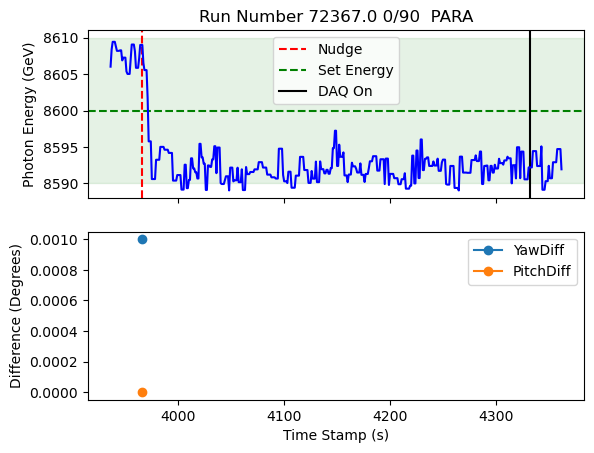

plotting for run  72370.0
daq on at time 957.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    651
 34.5    275
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    2950
-10.5     651
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

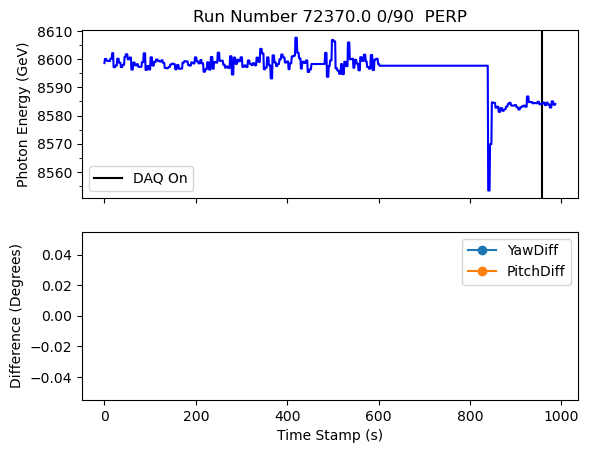

plotting for run  72375.0
daq on at time 1650.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1360
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7920
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

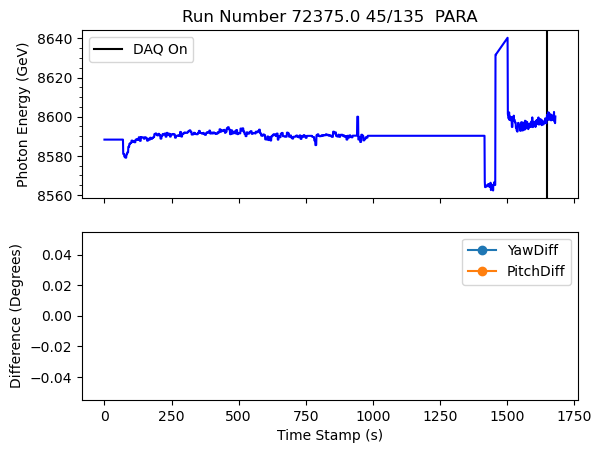

plotting for run  72388.0
daq on at time 145.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    117
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6594
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

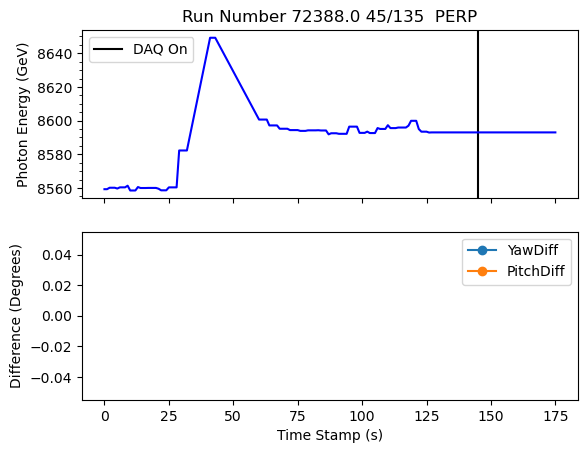

plotting for run  72406.0
Nudge number 2 occurs at time 286.0
Nudge number 3 occurs at time 338.0
daq on at time 366.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6873
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

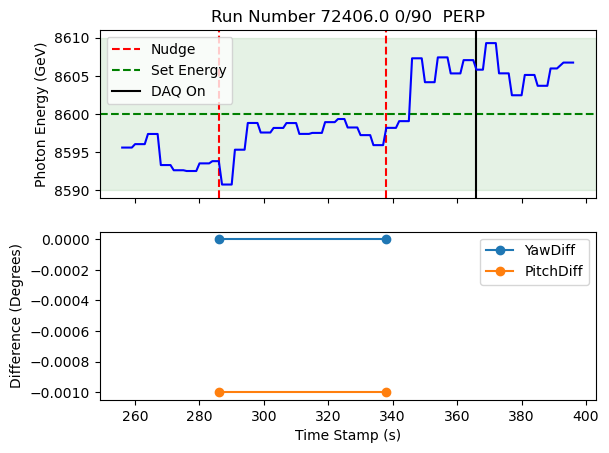

plotting for run  72410.0
Nudge number 2 occurs at time 416.0
Nudge number 3 occurs at time 430.0
Nudge number 4 occurs at time 444.0
Nudge number 5 occurs at time 451.0
Nudge number 6 occurs at time 475.0
Nudge number 7 occurs at time 483.0
daq on at time 299.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    234
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6726
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

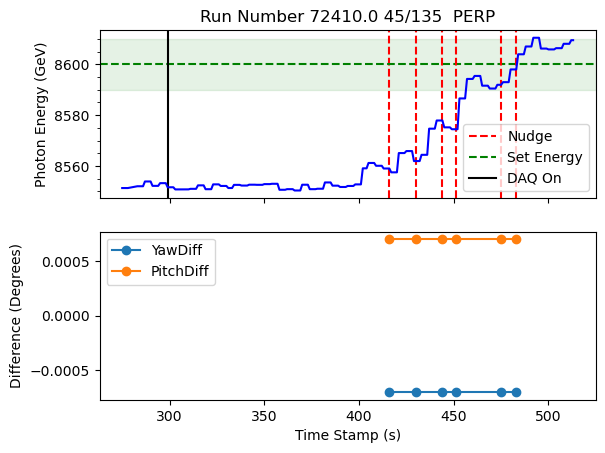

plotting for run  72417.0
Nudge number 2 occurs at time 417.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    58
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    251
-10.5     86
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

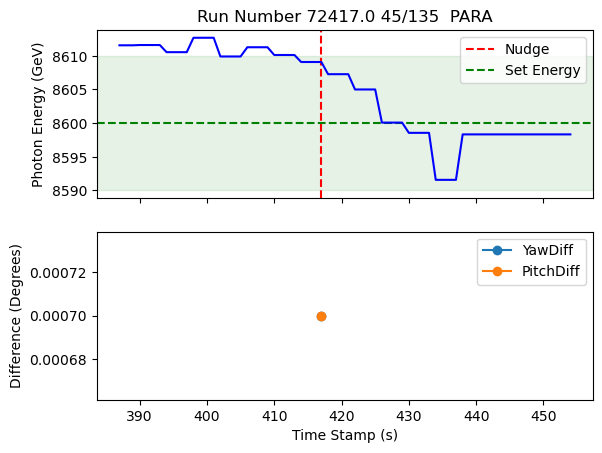

plotting for run  72420.0
Nudge number 2 occurs at time 227.0
daq on at time 328.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    134
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7056
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

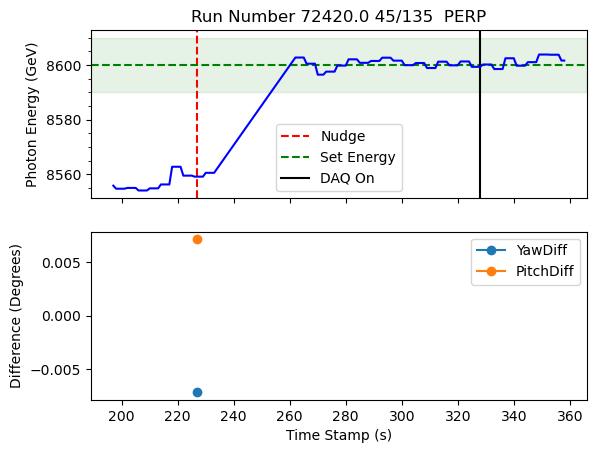

plotting for run  72423.0
Nudge number 1 occurs at time 155.0
daq on at time 234.0
[2. 0.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    114
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6593
 34.5      87
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

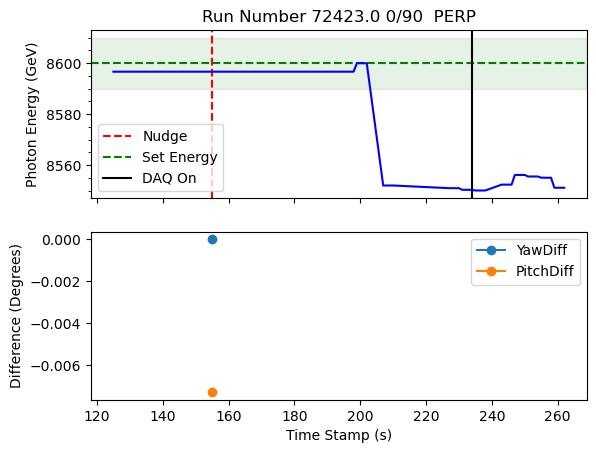

plotting for run  72424.0
Nudge number 1 occurs at time 6178.0
Nudge number 2 occurs at time 6182.0
Nudge number 3 occurs at time 6186.0
Nudge number 4 occurs at time 6190.0
Nudge number 5 occurs at time 6194.0
Nudge number 6 occurs at time 6197.0
Nudge number 9 occurs at time 6226.0
Nudge number 10 occurs at time 6234.0
Nudge number 11 occurs at time 6244.0
daq on at time 213.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    5348
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6829
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

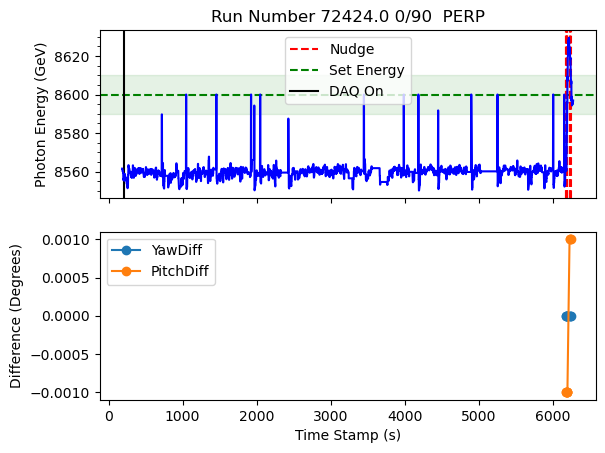

plotting for run  72434.0
Nudge number 3 occurs at time 246.0
Nudge number 4 occurs at time 260.0
daq on at time 289.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    102
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5993
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

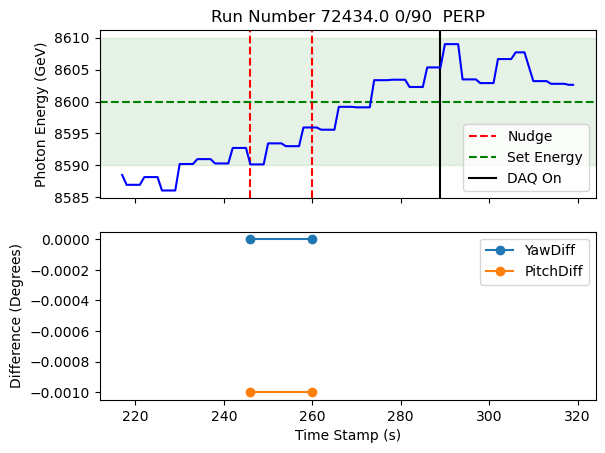

plotting for run  72650.0
Nudge number 1 occurs at time 2951.0
Nudge number 2 occurs at time 2961.0
daq on at time 642.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    1985
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4345
 0.0      114
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

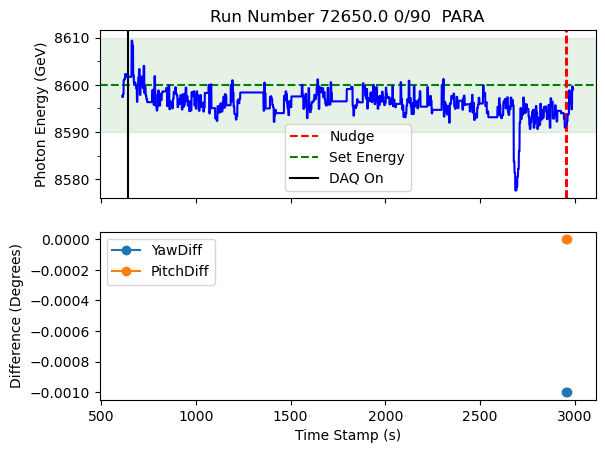

plotting for run  72653.0
daq on at time 9682.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    63
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    2550
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

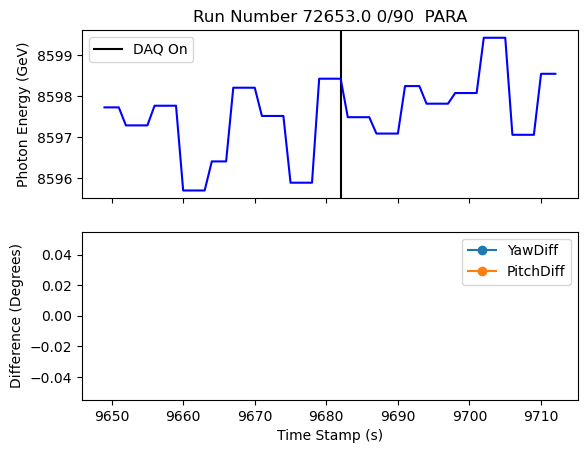

plotting for run  72657.0
Nudge number 4 occurs at time 686.0
Nudge number 5 occurs at time 697.0
Nudge number 6 occurs at time 705.0
Nudge number 7 occurs at time 708.0
Nudge number 8 occurs at time 723.0
daq on at time 502.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    114
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6675
-10.5      80
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

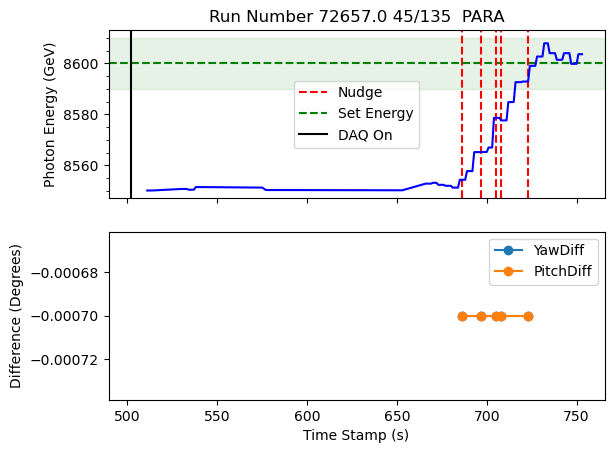

plotting for run  72658.0
Nudge number 5 occurs at time 494.0
Nudge number 6 occurs at time 513.0
Nudge number 7 occurs at time 528.0
daq on at time 274.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    233
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6174
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

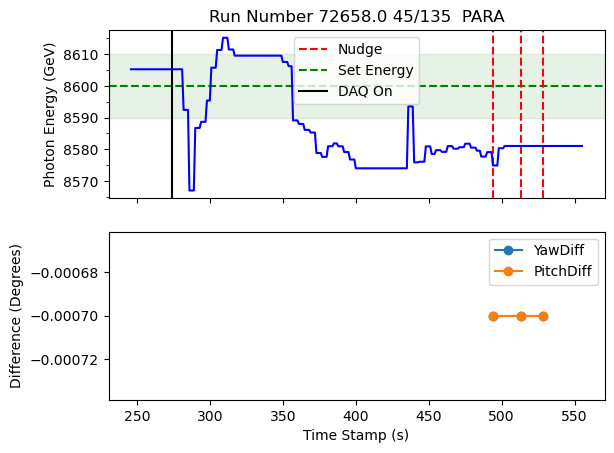

plotting for run  72659.0
daq on at time 171.0
[0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    176
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    3201
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

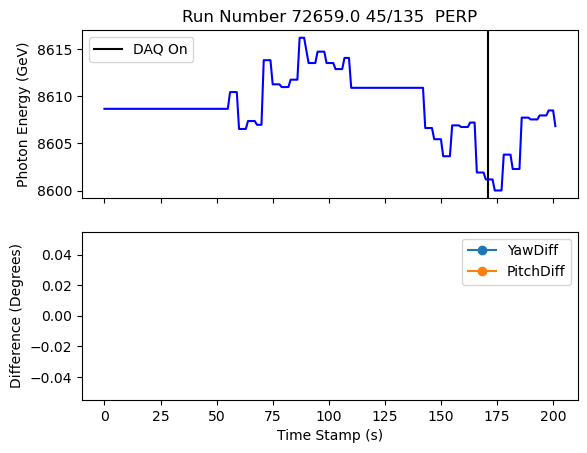

plotting for run  72666.0
Nudge number 1 occurs at time 334.0
Nudge number 2 occurs at time 365.0
daq on at time 469.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    152
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    686
 0.0     103
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

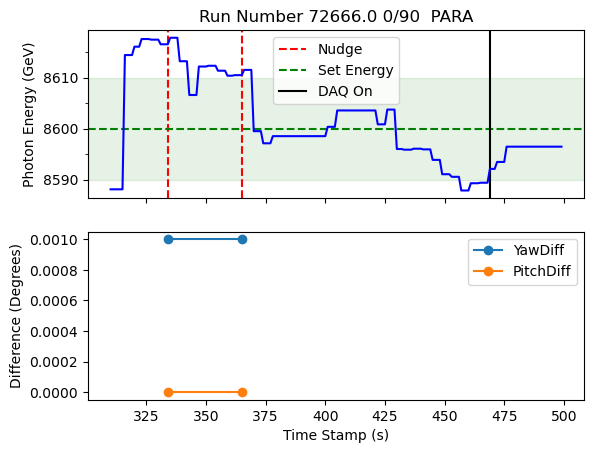

plotting for run  72673.0
Nudge number 4 occurs at time 276.0
Nudge number 5 occurs at time 298.0
Nudge number 6 occurs at time 311.0
Nudge number 7 occurs at time 326.0
daq on at time 214.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    148
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    2215
-10.5      16
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

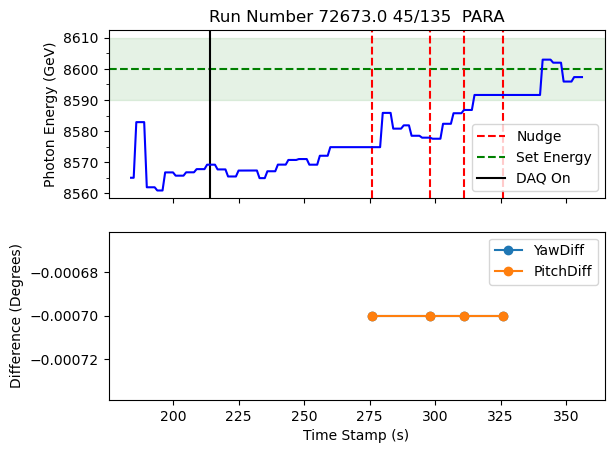

plotting for run  72677.0
daq on at time 240.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    271
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    4300
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

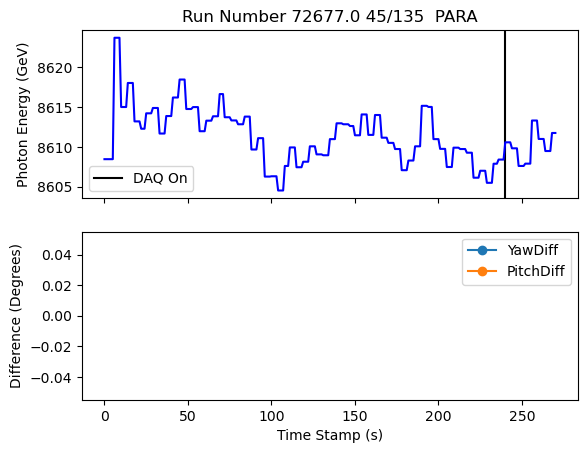

plotting for run  72678.0
Nudge number 2 occurs at time 78.0
Nudge number 3 occurs at time 94.0
Nudge number 4 occurs at time 100.0
Nudge number 8 occurs at time 171.0
daq on at time 211.0
[0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    190
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    1030
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

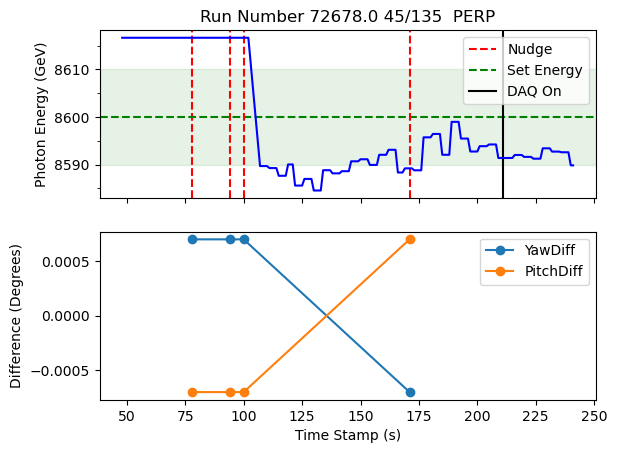

plotting for run  72684.0
daq on at time 8035.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    86
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5323
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

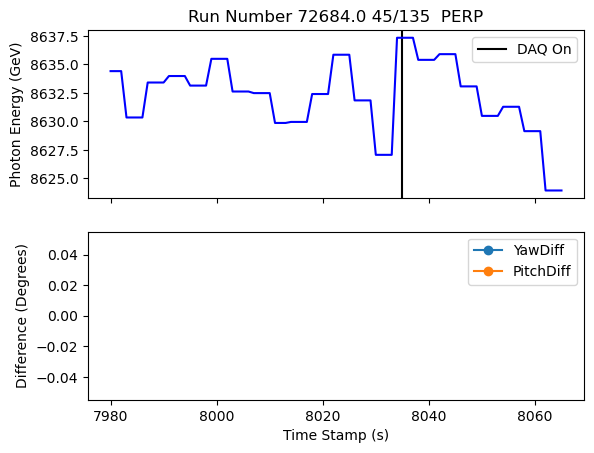

plotting for run  72686.0
daq on at time 1030.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    90
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    2348
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

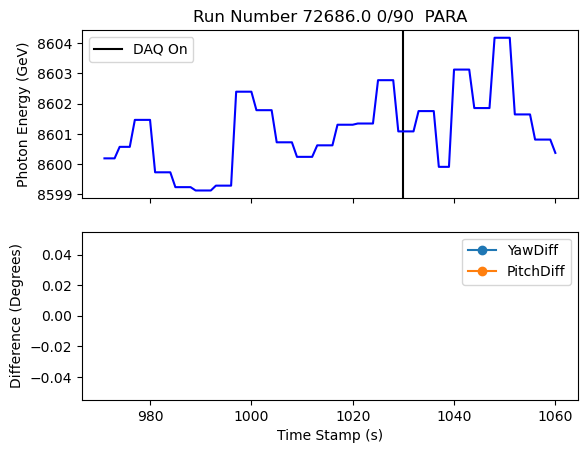

plotting for run  72703.0
Nudge number 1 occurs at time 52.0
Nudge number 2 occurs at time 123.0
daq on at time 198.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    196
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6326
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

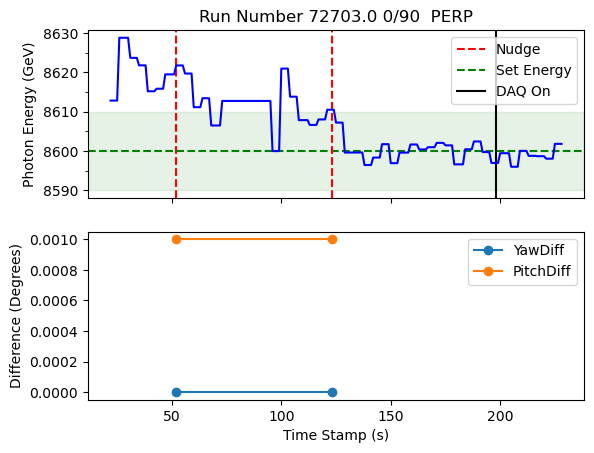

plotting for run  72706.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    29.55
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 29.55    981
-10.50    648
Name: count, dtype: int64
roll values are GONI:ROLL
 29.55    981
-10.50    648
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

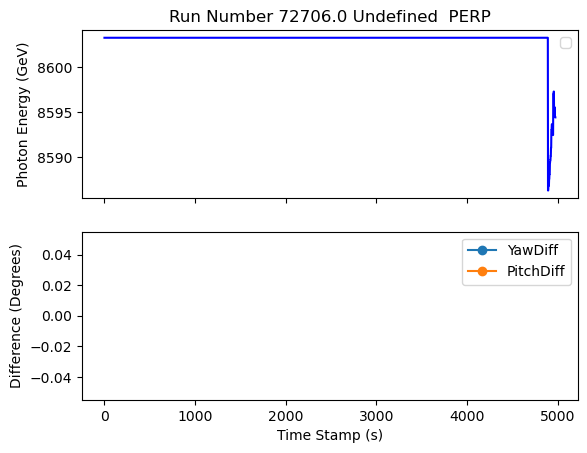

plotting for run  72707.0
Nudge number 1 occurs at time 549.0
daq on at time 242.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    368
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3284
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

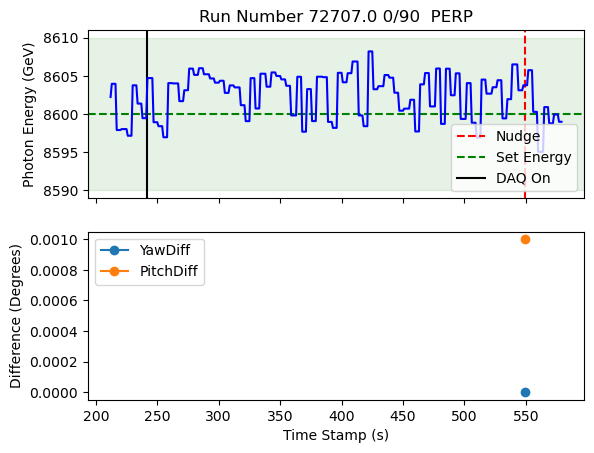

plotting for run  72708.0
Nudge number 7 occurs at time 695.0
Nudge number 8 occurs at time 701.0
Nudge number 9 occurs at time 707.0
Nudge number 10 occurs at time 713.0
Nudge number 11 occurs at time 987.0
Nudge number 15 occurs at time 1066.0
Nudge number 18 occurs at time 1158.0
daq on at time 1199.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    428
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6811
-10.5      87
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

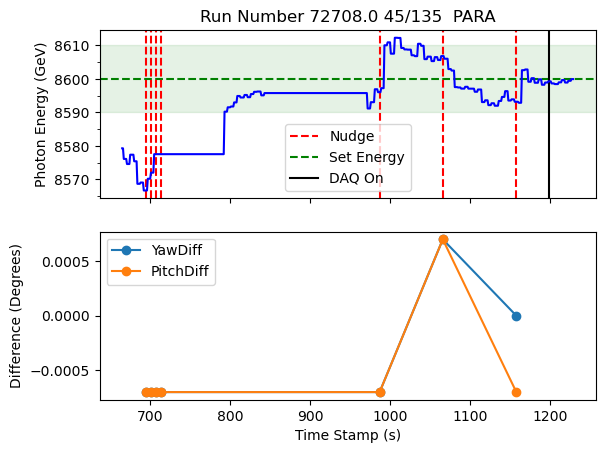

plotting for run  72719.0
daq on at time 41.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    72
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7075
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

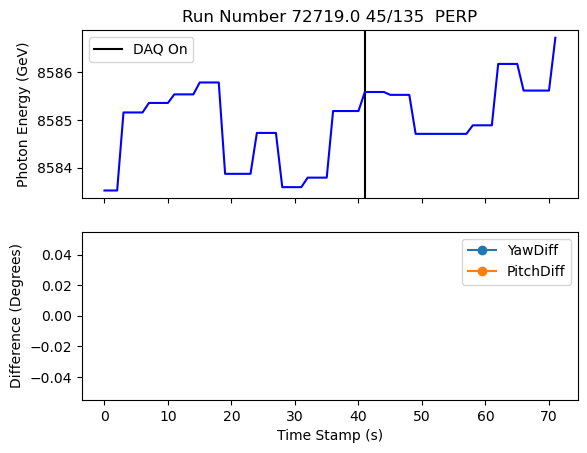

plotting for run  72722.0
Nudge number 3 occurs at time 476.0
Nudge number 4 occurs at time 477.0
Nudge number 5 occurs at time 479.0
daq on at time 573.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    126
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5840
 0.0      123
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

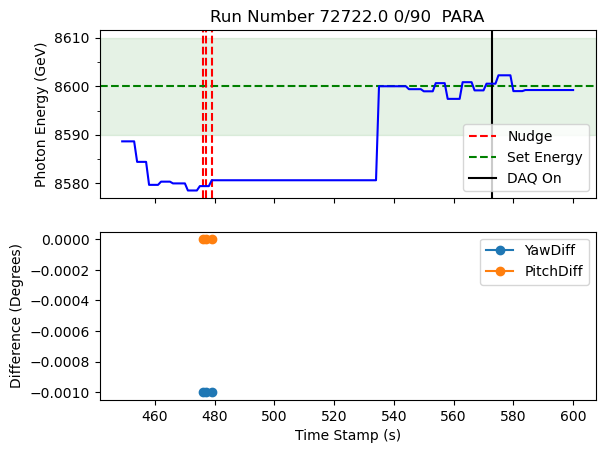

plotting for run  72725.0
Nudge number 2 occurs at time 123.0
Nudge number 3 occurs at time 138.0
daq on at time 160.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    92
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    569
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

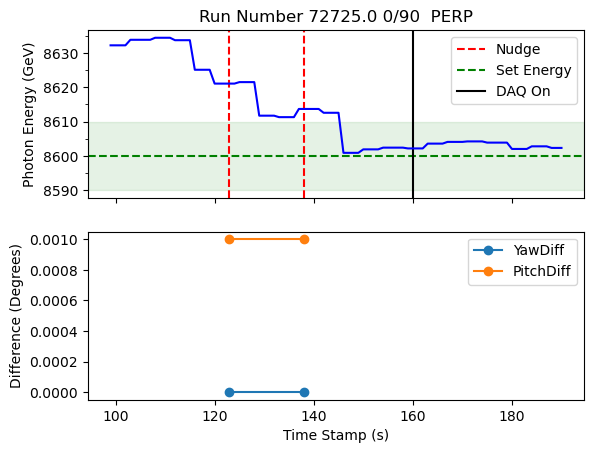

plotting for run  72730.0
Nudge number 1 occurs at time 302.0
Nudge number 5 occurs at time 502.0
Nudge number 6 occurs at time 523.0
Nudge number 7 occurs at time 546.0
Nudge number 8 occurs at time 588.0
daq on at time 713.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    311
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7603
-10.5     192
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

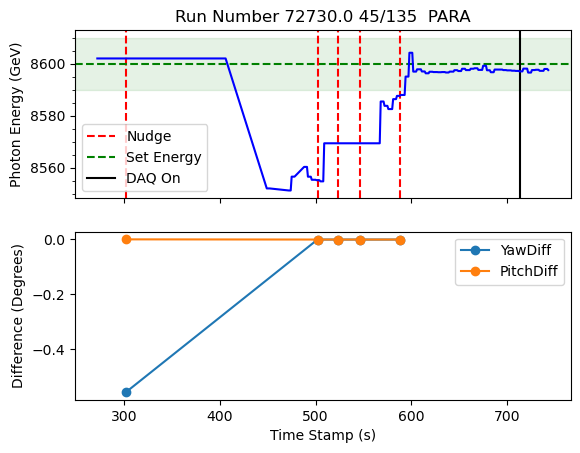

plotting for run  72732.0
daq on at time 390.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    347
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6354
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

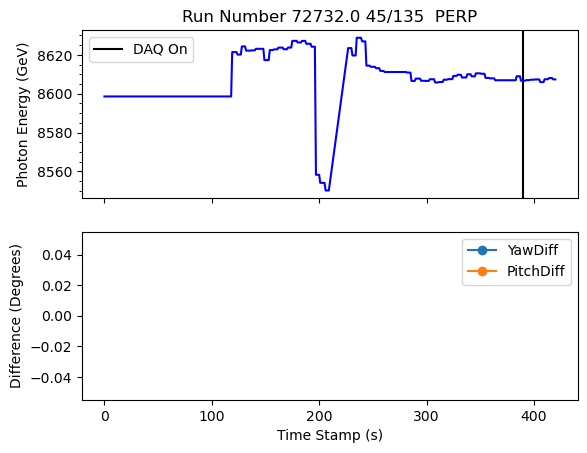

plotting for run  72739.0
Nudge number 2 occurs at time 1190.0
Nudge number 3 occurs at time 1800.0
daq on at time 1857.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    462
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3446
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

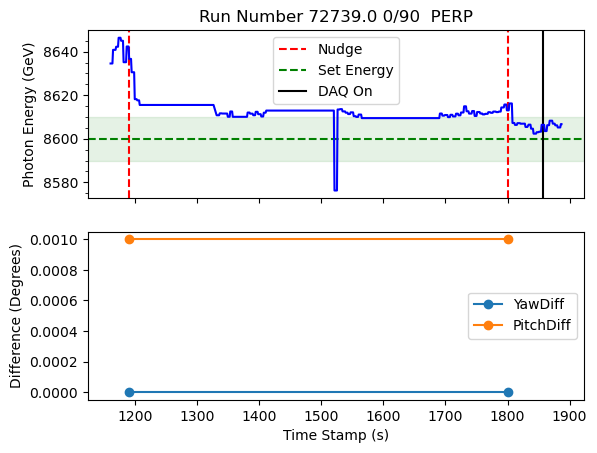

plotting for run  72742.0
Nudge number 5 occurs at time 879.0
Nudge number 6 occurs at time 904.0
Nudge number 7 occurs at time 954.0
Nudge number 8 occurs at time 984.0
daq on at time 1009.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    180
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6391
-10.5     135
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

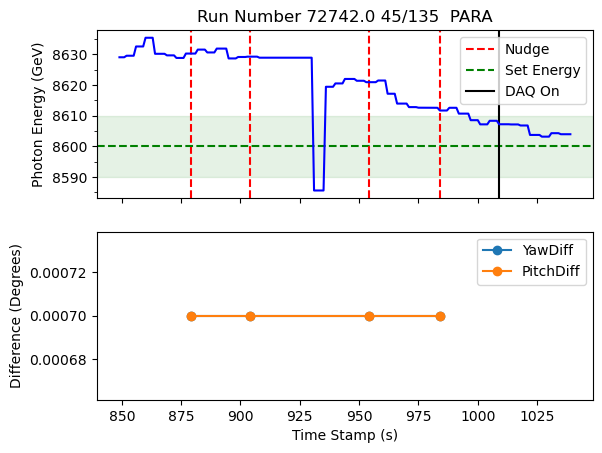

plotting for run  72745.0
Nudge number 2 occurs at time 1800.0
daq on at time 411.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    540
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5979
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

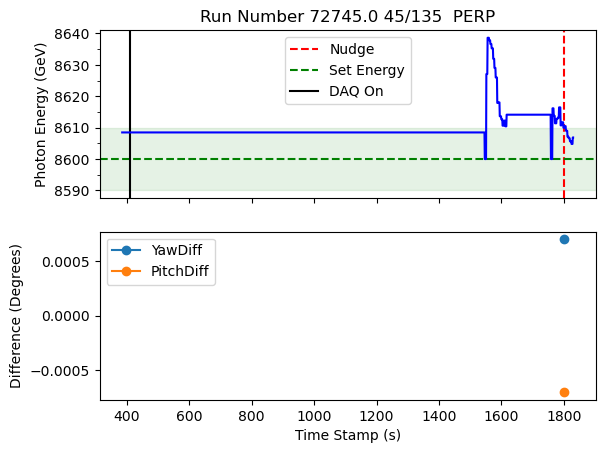

plotting for run  72749.0
Nudge number 1 occurs at time 270.0
Nudge number 2 occurs at time 271.0
Nudge number 3 occurs at time 285.0
Nudge number 4 occurs at time 302.0
daq on at time 383.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5612
 0.0      113
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

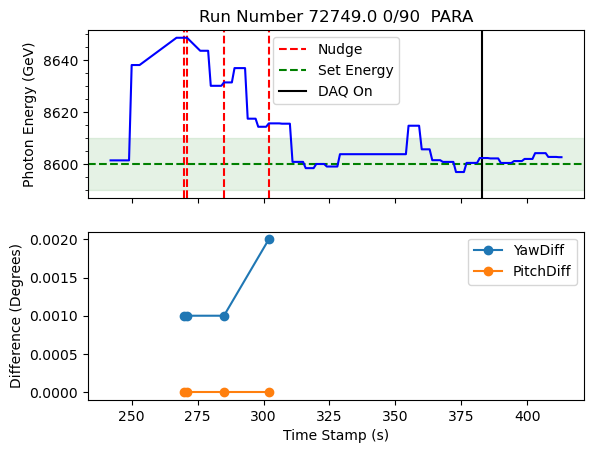

plotting for run  72752.0
Nudge number 2 occurs at time 29417.0
Nudge number 3 occurs at time 29422.0
Nudge number 4 occurs at time 29427.0
Nudge number 7 occurs at time 29490.0
daq on at time 29344.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    184
Name: count, dtype: int64
roll values are GONI:ROLL
 29.55    8548
-10.50    8340
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

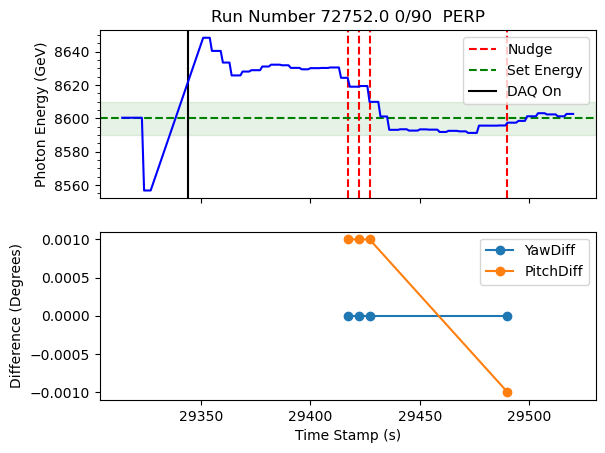

plotting for run  72754.0
Nudge number 2 occurs at time 412.0
Nudge number 3 occurs at time 439.0
Nudge number 4 occurs at time 453.0
Nudge number 5 occurs at time 471.0
Nudge number 6 occurs at time 647.0
Nudge number 7 occurs at time 659.0
Nudge number 8 occurs at time 695.0
Nudge number 9 occurs at time 702.0
Nudge number 10 occurs at time 805.0
Nudge number 14 occurs at time 961.0
Nudge number 15 occurs at time 971.0
Nudge number 16 occurs at time 1016.0
Nudge number 17 occurs at time 1089.0
Nudge number 18 occurs at time 1107.0
Nudge number 19 occurs at time 3690.0
Nudge number 20 occurs at time 3710.0
Nudge number 21 occurs at time 3728.0
Nudge number 22 occurs at time 3803.0
daq on at time 386.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1687
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6957
-10.5     117
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

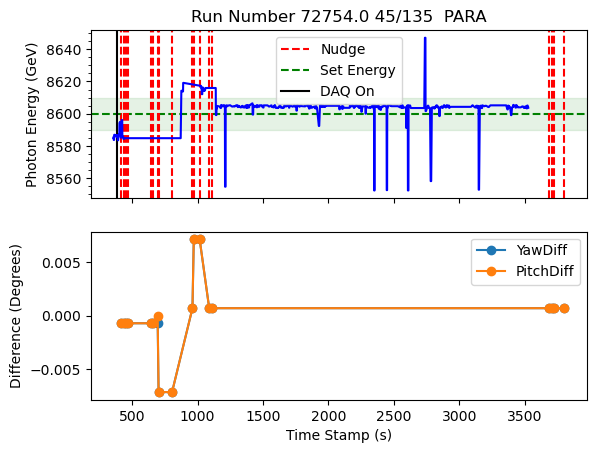

plotting for run  72757.0
daq on at time 405.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    383
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7702
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

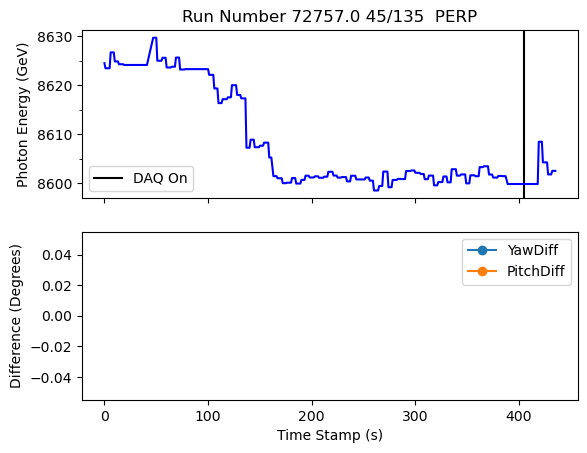

plotting for run  72758.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    2
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

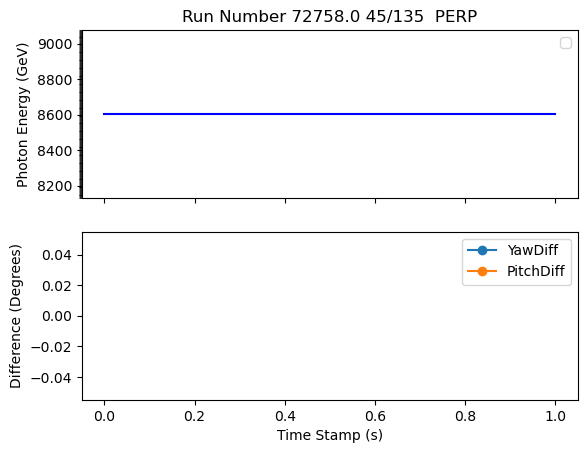

plotting for run  72761.0
Nudge number 2 occurs at time 356.0
Nudge number 3 occurs at time 369.0
Nudge number 4 occurs at time 385.0
Nudge number 5 occurs at time 403.0
Nudge number 6 occurs at time 427.0
daq on at time 452.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    143
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3207
 0.0       66
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

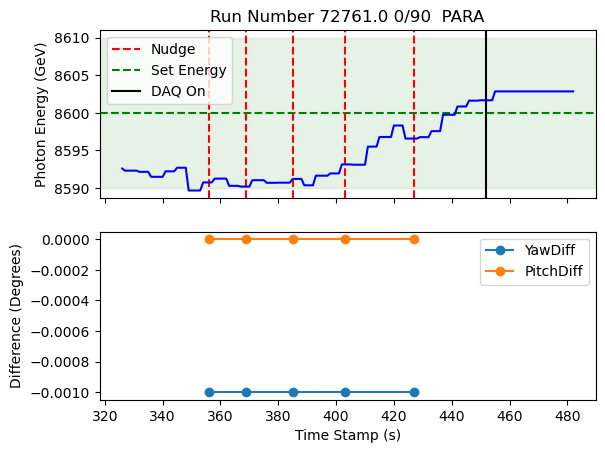

plotting for run  72764.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    71
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    71
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

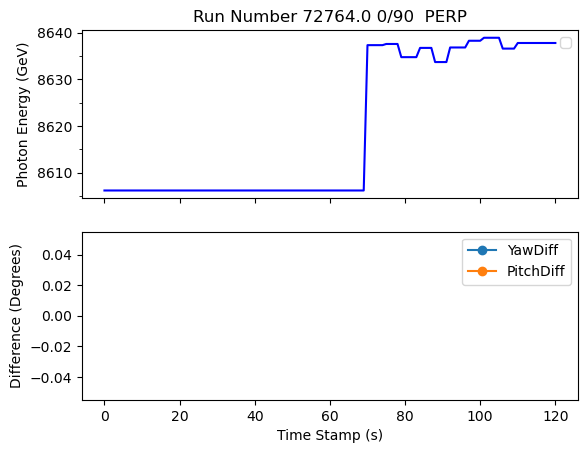

plotting for run  72771.0
Nudge number 4 occurs at time 393.0
Nudge number 6 occurs at time 496.0
Nudge number 7 occurs at time 515.0
Nudge number 8 occurs at time 534.0
Nudge number 9 occurs at time 573.0
Nudge number 10 occurs at time 586.0
daq on at time 546.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    227
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    5738
-10.5      60
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

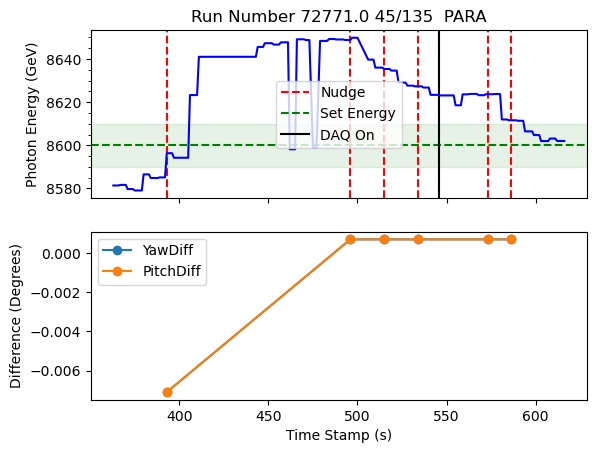

plotting for run  72773.0
Nudge number 2 occurs at time 1354.0
daq on at time 1519.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    188
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7430
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

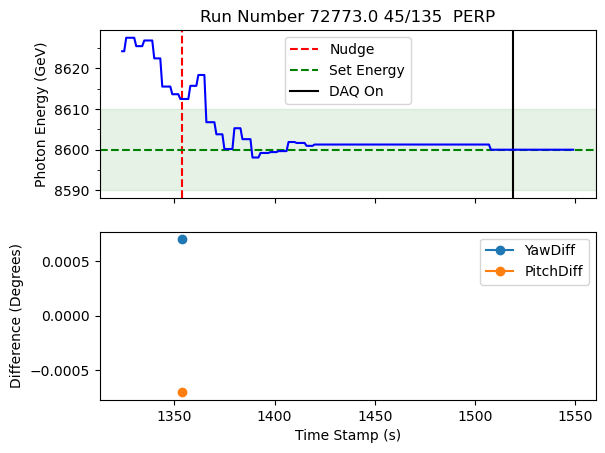

plotting for run  72780.0
Nudge number 1 occurs at time 1347.0
Nudge number 2 occurs at time 1371.0
Nudge number 3 occurs at time 1385.0
Nudge number 4 occurs at time 1386.0
Nudge number 5 occurs at time 1404.0
Nudge number 6 occurs at time 1414.0
daq on at time 185.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    660
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    1439
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

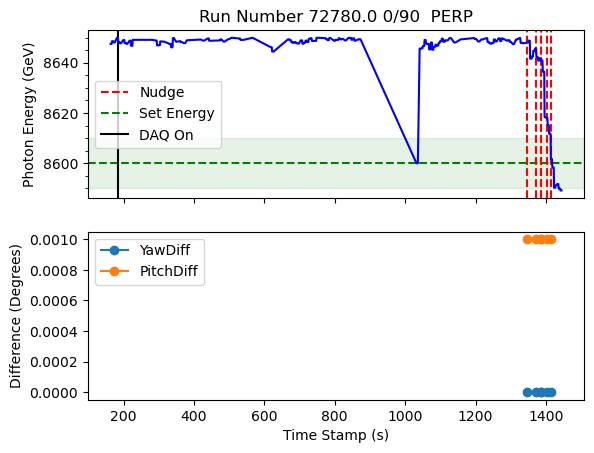

plotting for run  72781.0
Nudge number 1 occurs at time 966.0
daq on at time 41.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    380
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4669
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

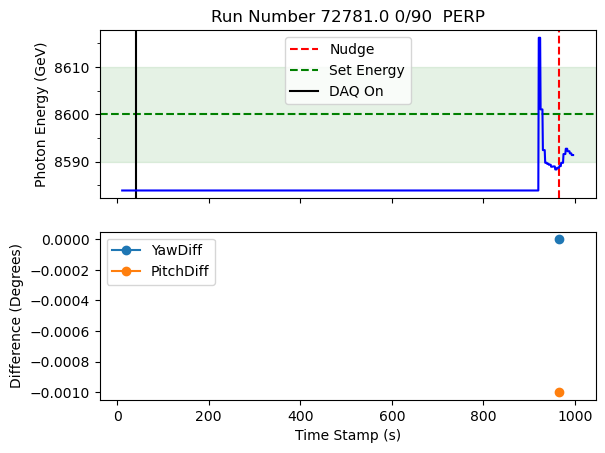

plotting for run  72796.0
Nudge number 2 occurs at time 316.0
Nudge number 3 occurs at time 337.0
Nudge number 4 occurs at time 368.0
daq on at time 400.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    119
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6198
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

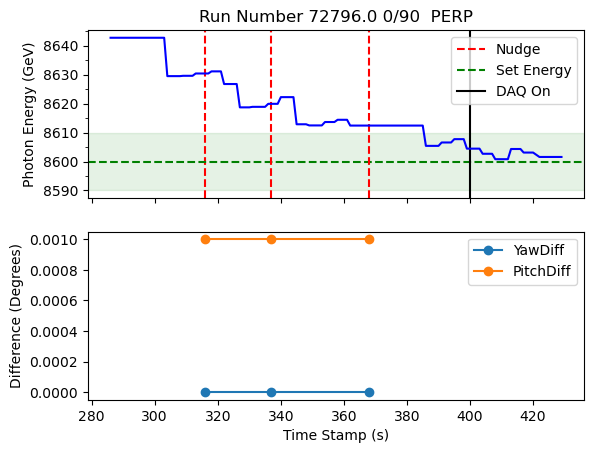

plotting for run  72798.0
daq on at time 559.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    319
-10.5     83
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6492
-10.5      83
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

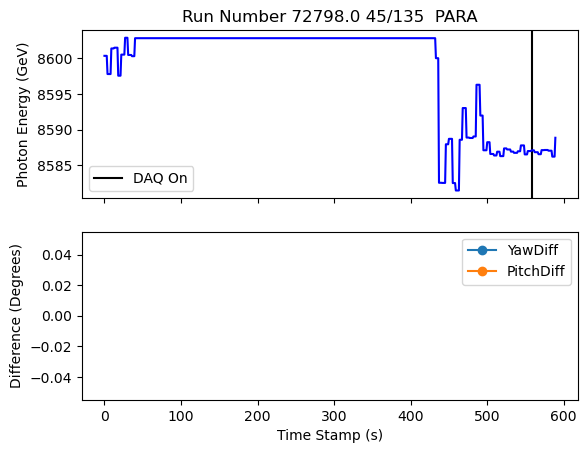

plotting for run  72812.0
Nudge number 3 occurs at time 2197.0
Nudge number 7 occurs at time 2229.0
Nudge number 11 occurs at time 2314.0
Nudge number 15 occurs at time 2591.0
daq on at time 445.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1895
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7295
-10.5      83
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

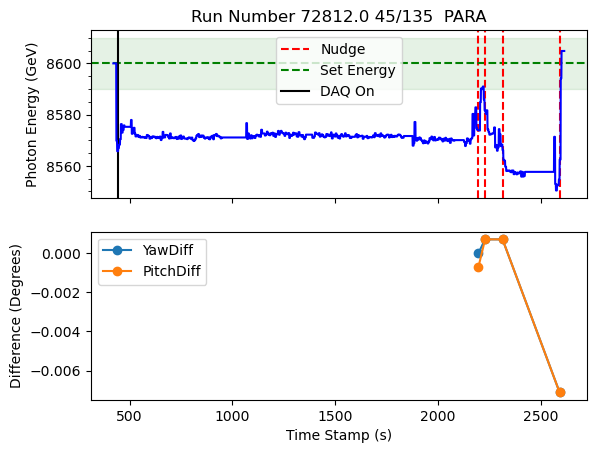

plotting for run  72814.0
daq on at time 142.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    137
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6546
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

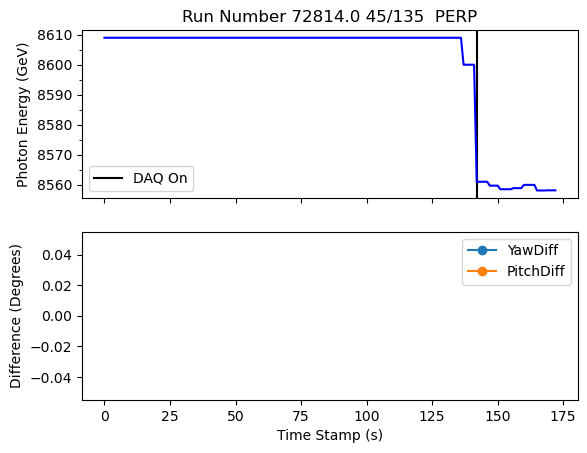

plotting for run  72815.0
Nudge number 1 occurs at time 95.0
Nudge number 2 occurs at time 112.0
Nudge number 3 occurs at time 129.0
Nudge number 4 occurs at time 157.0
Nudge number 5 occurs at time 178.0
Nudge number 6 occurs at time 202.0
Nudge number 7 occurs at time 328.0
Nudge number 11 occurs at time 3139.0
Nudge number 12 occurs at time 3156.0
Nudge number 13 occurs at time 3168.0
Nudge number 14 occurs at time 3185.0
Nudge number 15 occurs at time 3199.0
Nudge number 16 occurs at time 3211.0
Nudge number 17 occurs at time 3227.0
Nudge number 18 occurs at time 3237.0
Nudge number 19 occurs at time 3254.0
Nudge number 20 occurs at time 3270.0
Nudge number 21 occurs at time 3289.0
Nudge number 22 occurs at time 3310.0
daq on at time 344.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1653
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    3183
Name: count, dtype:

<Figure size 640x480 with 0 Axes>

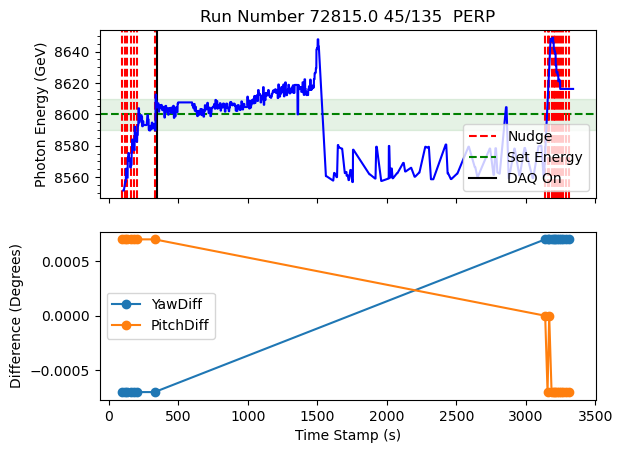

plotting for run  72816.0
Nudge number 4 occurs at time 97.0
Nudge number 5 occurs at time 111.0
daq on at time 219.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    182
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    3196
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

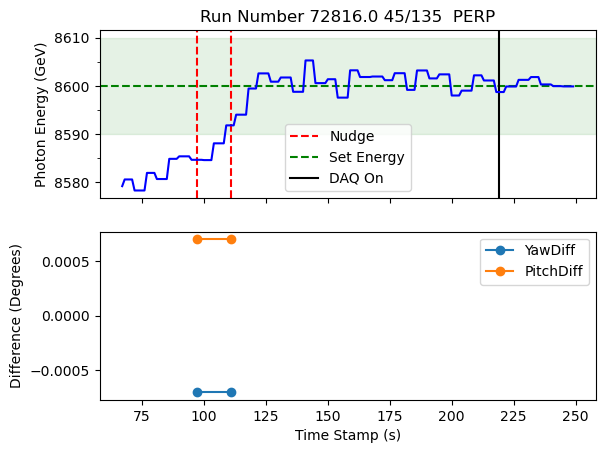

plotting for run  72824.0
Nudge number 2 occurs at time 728.0
Nudge number 3 occurs at time 781.0
Nudge number 4 occurs at time 806.0
Nudge number 5 occurs at time 807.0
daq on at time 954.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    280
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7084
 0.0      231
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

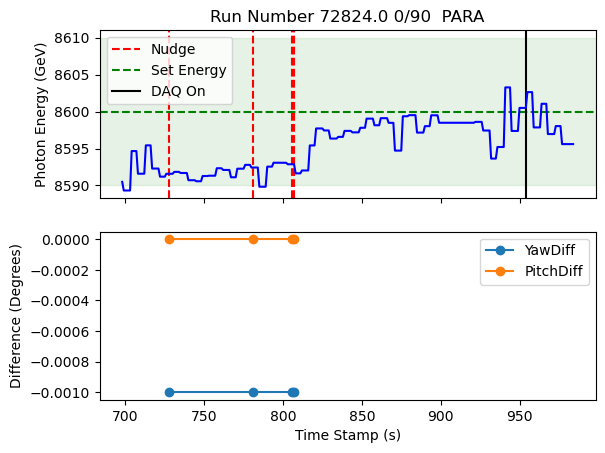

plotting for run  72827.0
Nudge number 1 occurs at time 64.0
Nudge number 2 occurs at time 74.0
Nudge number 3 occurs at time 82.0
Nudge number 4 occurs at time 146.0
daq on at time 204.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    184
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4237
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

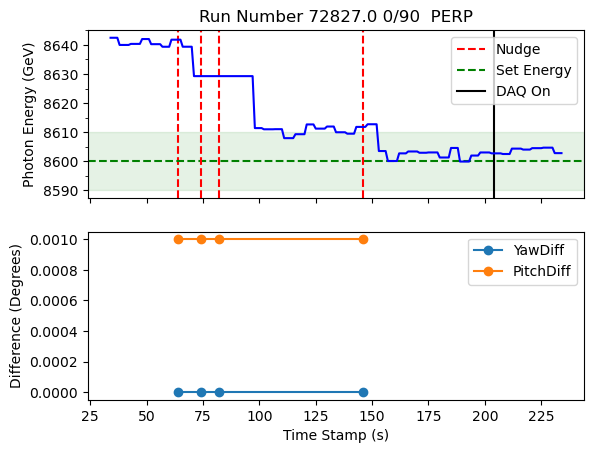

plotting for run  72828.0
daq on at time 490.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    288
-10.5    145
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6079
-10.5     145
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

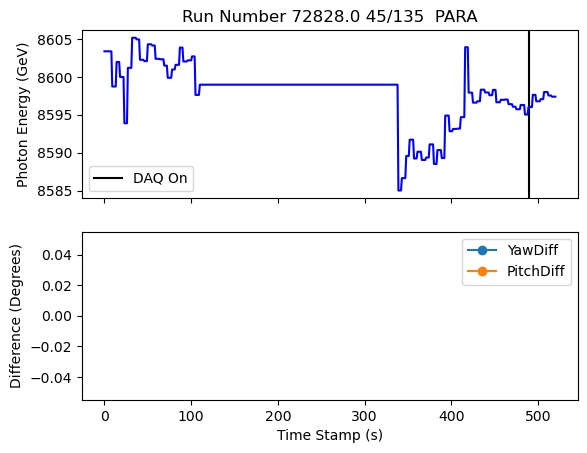

plotting for run  72835.0
Nudge number 2 occurs at time 941.0
Nudge number 3 occurs at time 967.0
Nudge number 4 occurs at time 990.0
daq on at time 281.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    689
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6163
 0.0       85
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

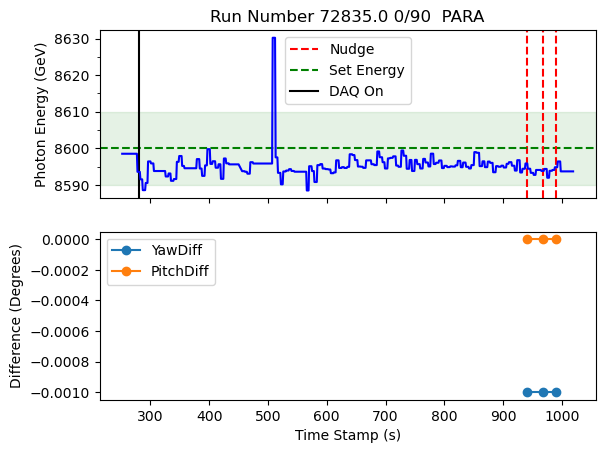

plotting for run  72837.0
Nudge number 2 occurs at time 280.0
Nudge number 3 occurs at time 299.0
Nudge number 4 occurs at time 328.0
Nudge number 5 occurs at time 354.0
daq on at time 558.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    339
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    1471
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

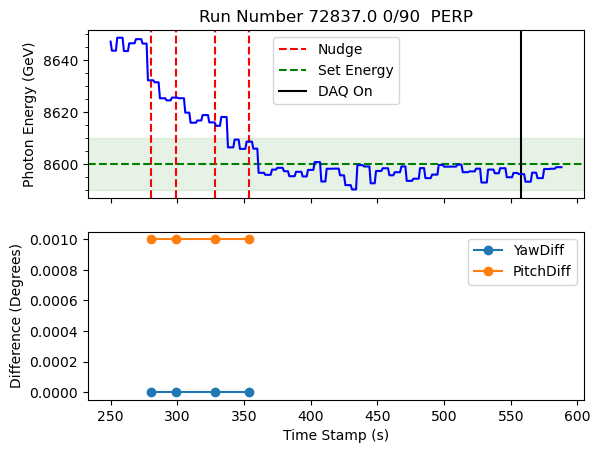

plotting for run  72841.0
Nudge number 2 occurs at time 378.0
Nudge number 3 occurs at time 403.0
Nudge number 4 occurs at time 443.0
Nudge number 8 occurs at time 989.0
Nudge number 9 occurs at time 4637.0
daq on at time 1015.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    3409
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6875
-10.5      82
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

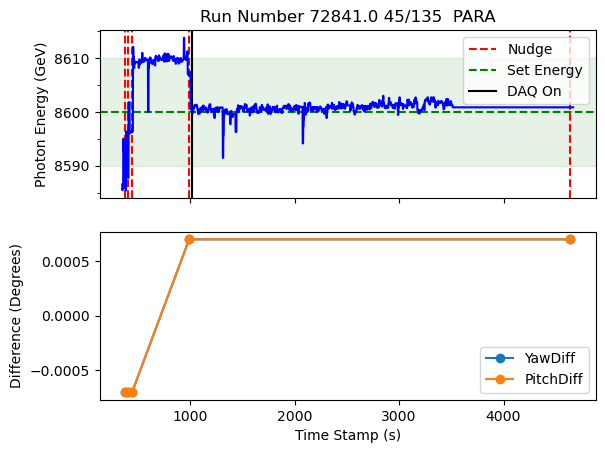

plotting for run  72848.0
Nudge number 2 occurs at time 2260.0
daq on at time 1888.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    433
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6559
 0.0       78
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

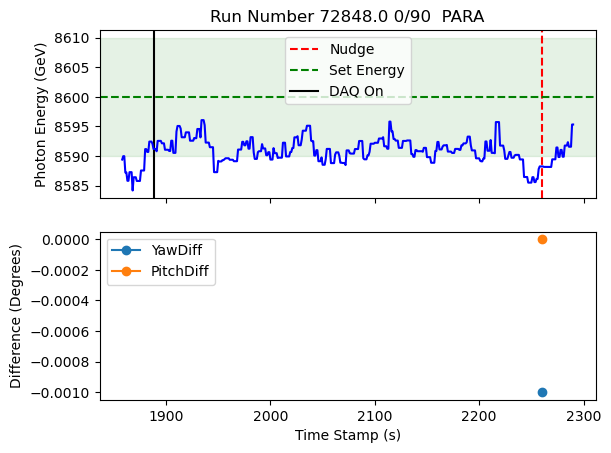

plotting for run  72850.0
Nudge number 2 occurs at time 141.0
Nudge number 3 occurs at time 162.0
Nudge number 4 occurs at time 179.0
daq on at time 275.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    177
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4950
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

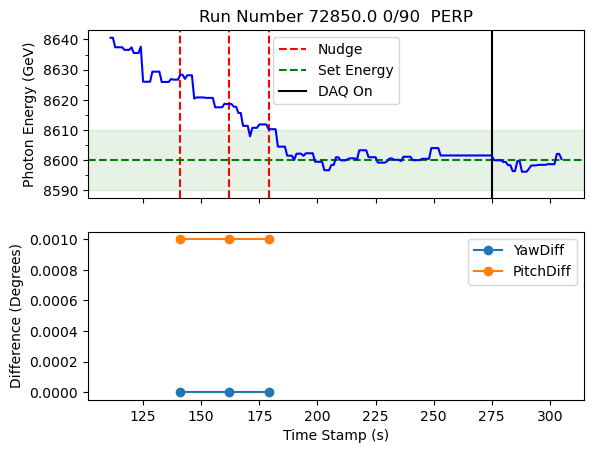

plotting for run  72852.0
Nudge number 4 occurs at time 363.0
Nudge number 5 occurs at time 368.0
Nudge number 9 occurs at time 562.0
Nudge number 10 occurs at time 593.0
daq on at time 667.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    323
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7377
-10.5      23
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

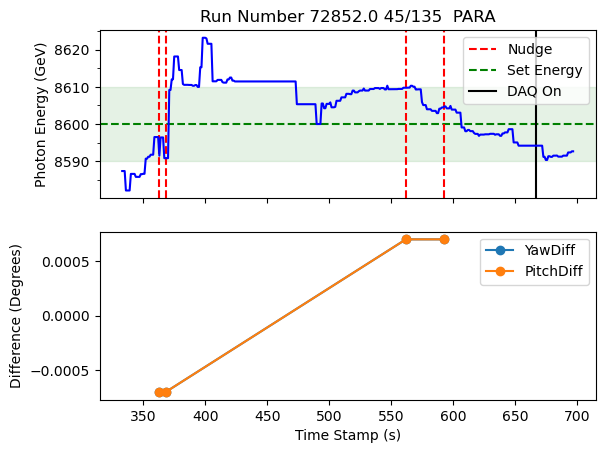

plotting for run  72854.0
Nudge number 4 occurs at time 6897.0
Nudge number 5 occurs at time 6928.0
daq on at time 6979.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    143
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6012
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

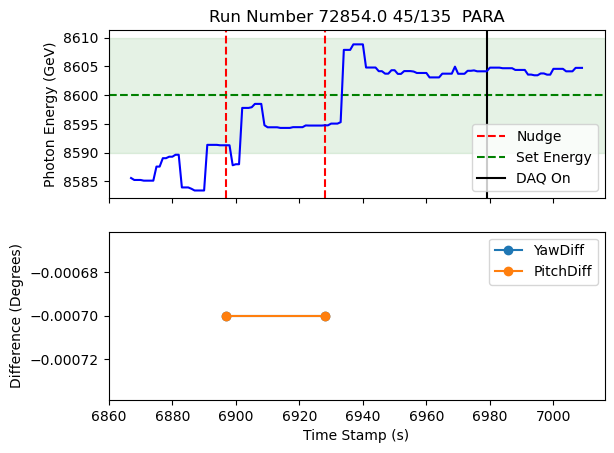

plotting for run  72855.0
daq on at time 173.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    204
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6156
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

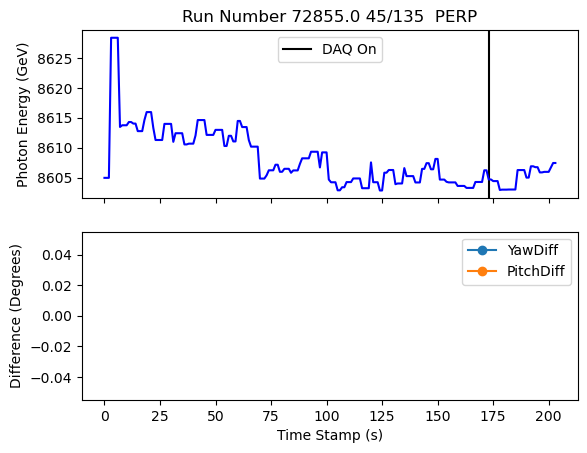

plotting for run  72859.0
daq on at time 198.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    116
 0.0      54
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    656
 0.0      54
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

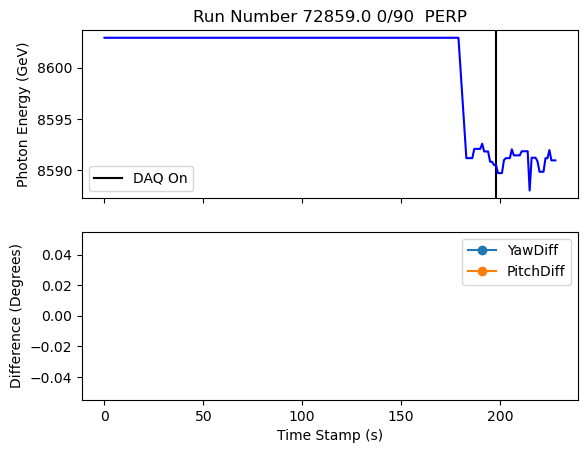

plotting for run  72868.0
daq on at time 505.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    311
-10.5    121
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6875
-10.5     121
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

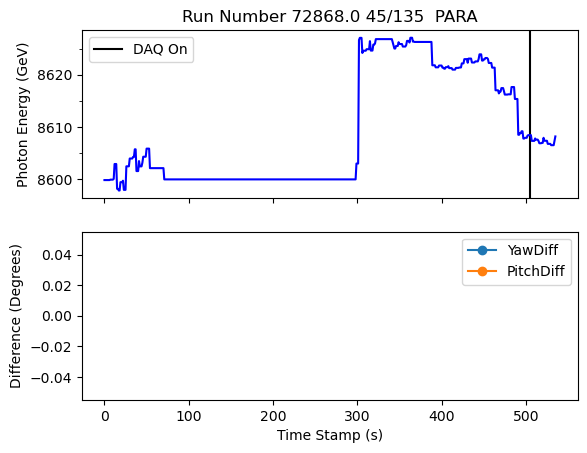

plotting for run  72871.0
daq on at time 783.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    559
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5048
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

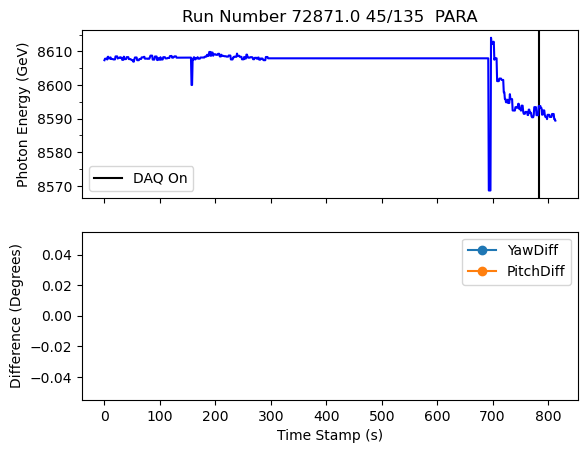

plotting for run  72882.0
daq on at time 641.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    323
-10.5     89
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    5728
-10.5      89
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

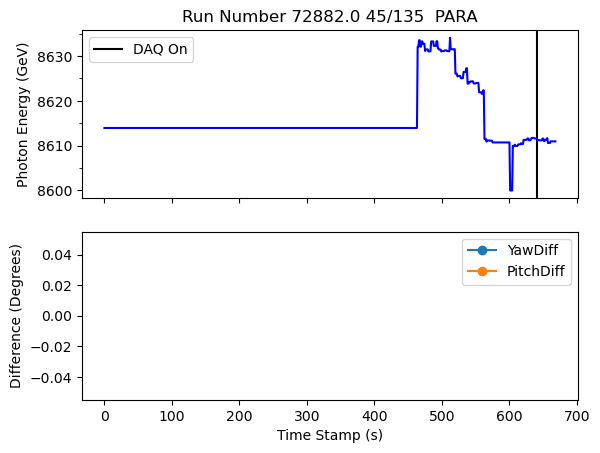

plotting for run  72887.0
Nudge number 1 occurs at time 824.0
daq on at time 153.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    573
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6546
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

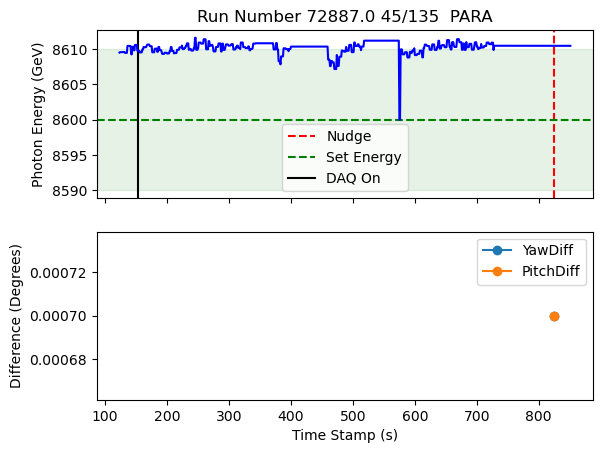

plotting for run  72889.0
Nudge number 2 occurs at time 218.0
Nudge number 3 occurs at time 266.0
daq on at time 124.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    155
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    1243
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

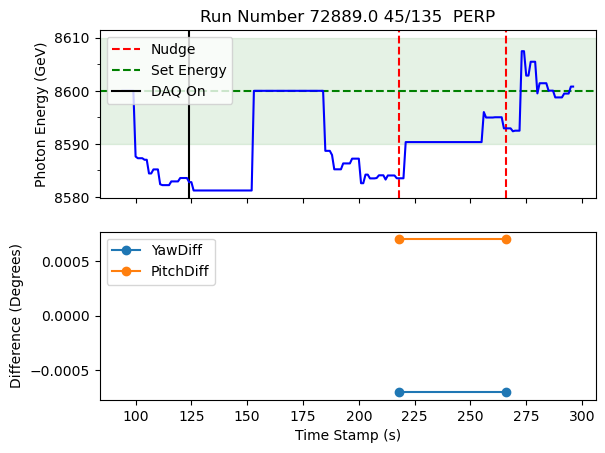

plotting for run  72909.0
daq on at time 2623.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    528
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    1192
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

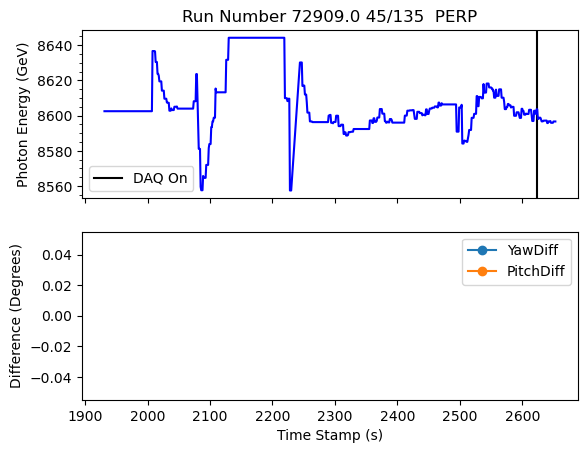

plotting for run  72916.0
Nudge number 7 occurs at time 1405.0
Nudge number 8 occurs at time 1408.0
Nudge number 9 occurs at time 1412.0
Nudge number 10 occurs at time 1422.0
Nudge number 11 occurs at time 1428.0
Nudge number 12 occurs at time 1429.0
Nudge number 13 occurs at time 1450.0
Nudge number 14 occurs at time 1455.0
Nudge number 16 occurs at time 1473.0
Nudge number 20 occurs at time 1504.0
Nudge number 24 occurs at time 1643.0
daq on at time 1544.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    248
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    417
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

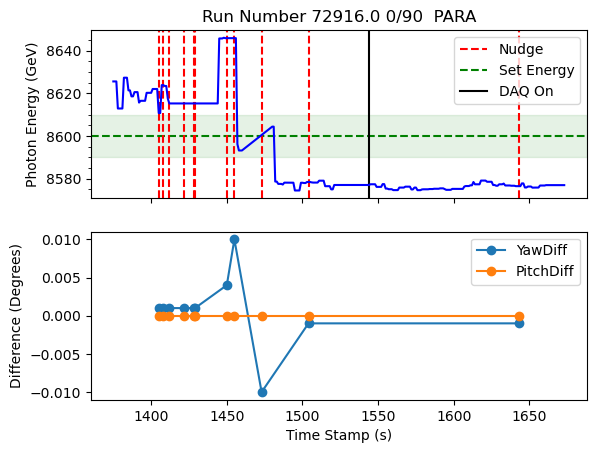

plotting for run  72917.0
Nudge number 1 occurs at time 118.0
Nudge number 2 occurs at time 119.0
Nudge number 3 occurs at time 121.0
Nudge number 4 occurs at time 122.0
Nudge number 5 occurs at time 123.0
Nudge number 6 occurs at time 164.0
Nudge number 9 occurs at time 396.0
Nudge number 10 occurs at time 406.0
Nudge number 16 occurs at time 611.0
Nudge number 17 occurs at time 617.0
Nudge number 21 occurs at time 699.0
Nudge number 22 occurs at time 716.0
Nudge number 23 occurs at time 717.0
Nudge number 27 occurs at time 1020.0
Nudge number 28 occurs at time 1024.0
Nudge number 32 occurs at time 1241.0
Nudge number 36 occurs at time 1276.0
Nudge number 37 occurs at time 1277.0
Nudge number 38 occurs at time 1467.0
Nudge number 39 occurs at time 1468.0
Nudge number 40 occurs at time 2182.0
Nudge number 41 occurs at time 2183.0
daq on at time 143.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values ar

<Figure size 640x480 with 0 Axes>

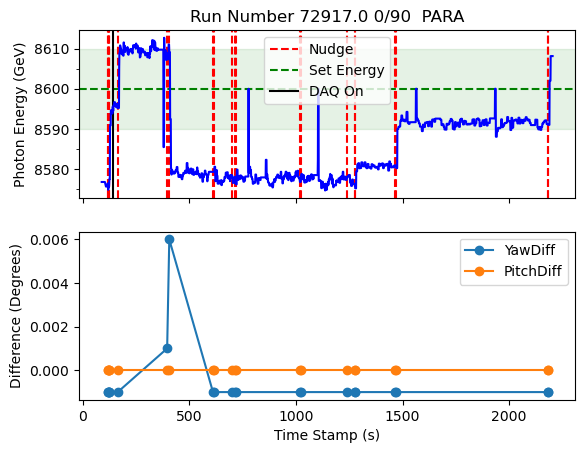

plotting for run  72920.0
daq on at time 240.0
[1. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    128
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6609
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

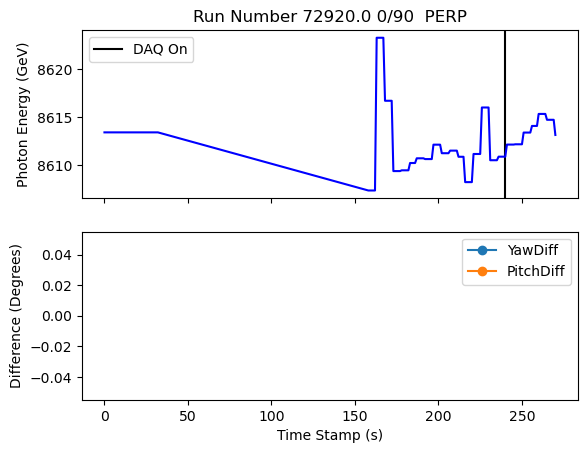

plotting for run  72923.0
daq on at time 540.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    344
-10.5    115
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    4564
-10.5     115
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

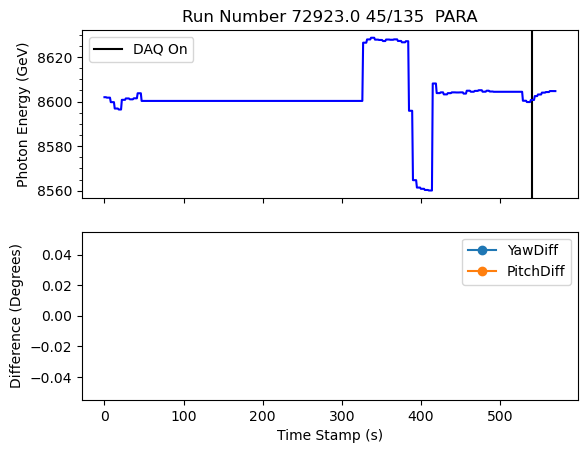

plotting for run  72928.0
daq on at time 316.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    186
0.0      88
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6674
0.0       88
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

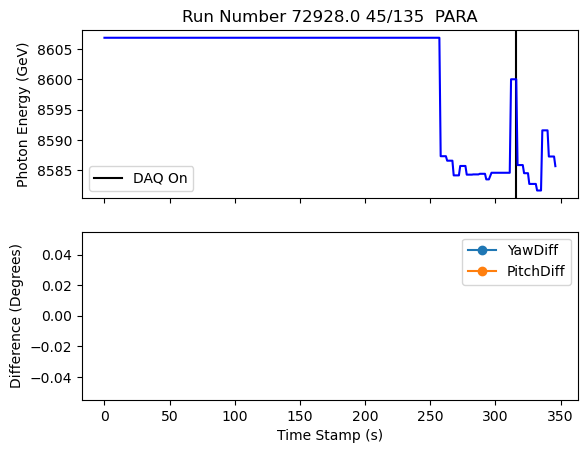

plotting for run  72930.0
daq on at time 242.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    175
 34.5     31
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6592
 34.5      31
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

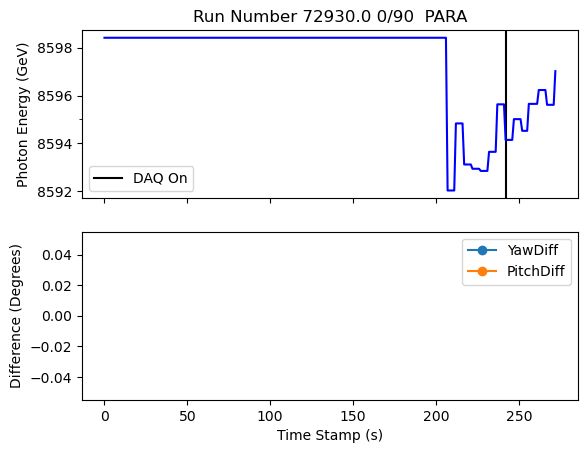

plotting for run  72949.0
Nudge number 1 occurs at time 54595.0
Nudge number 2 occurs at time 54604.0
Nudge number 3 occurs at time 54631.0
Nudge number 4 occurs at time 54682.0
Nudge number 5 occurs at time 54704.0
Nudge number 6 occurs at time 54727.0
Nudge number 7 occurs at time 54733.0
Nudge number 8 occurs at time 54748.0
Nudge number 9 occurs at time 54759.0
Nudge number 10 occurs at time 54766.0
Nudge number 11 occurs at time 54814.0
Nudge number 12 occurs at time 54821.0
Nudge number 13 occurs at time 54844.0
Nudge number 16 occurs at time 54999.0
Nudge number 17 occurs at time 55011.0
Nudge number 18 occurs at time 55016.0
Nudge number 19 occurs at time 55023.0
Nudge number 20 occurs at time 55027.0
Nudge number 21 occurs at time 55029.0
Nudge number 22 occurs at time 55031.0
Nudge number 23 occurs at time 55033.0
Nudge number 24 occurs at time 55037.0
Nudge number 25 occurs at time 55038.0
Nudge number 28 occurs at time 55096.0
Nudge number 29 occurs at time 55101.0
Nudge nu

<Figure size 640x480 with 0 Axes>

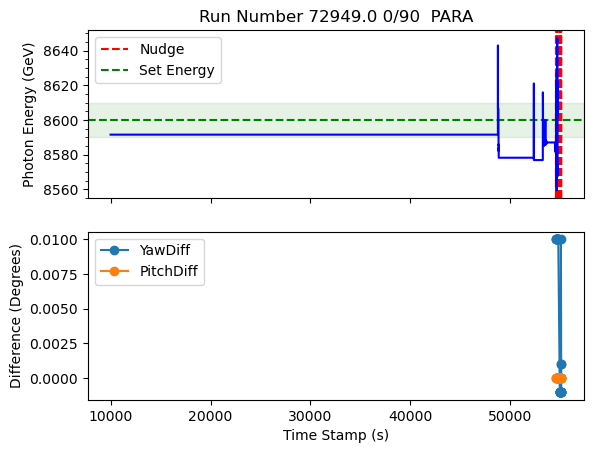

plotting for run  73039.0
Nudge number 3 occurs at time 415.0
Nudge number 4 occurs at time 445.0
Nudge number 5 occurs at time 804.0
daq on at time 310.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    555
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5575
 0.0       11
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

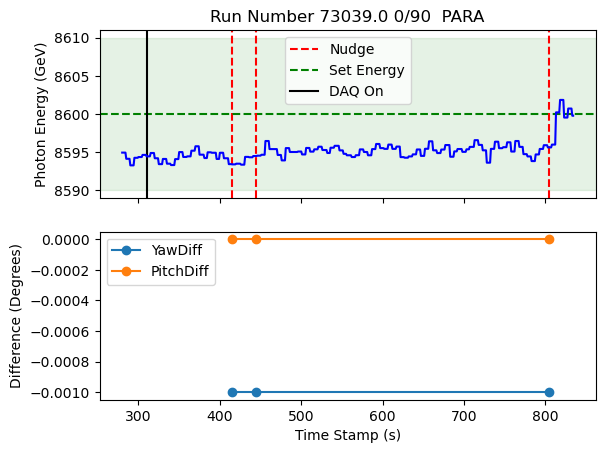

plotting for run  73041.0
Nudge number 1 occurs at time 37671.0
Nudge number 4 occurs at time 37700.0
Nudge number 5 occurs at time 37719.0
Nudge number 6 occurs at time 37720.0
Nudge number 7 occurs at time 37721.0
Nudge number 8 occurs at time 37736.0
Nudge number 9 occurs at time 37737.0
Nudge number 10 occurs at time 37738.0
Nudge number 11 occurs at time 37788.0
Nudge number 12 occurs at time 37792.0
Nudge number 13 occurs at time 37884.0
Nudge number 14 occurs at time 37900.0
daq on at time 38564.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    452
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    13290
 0.0      7468
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

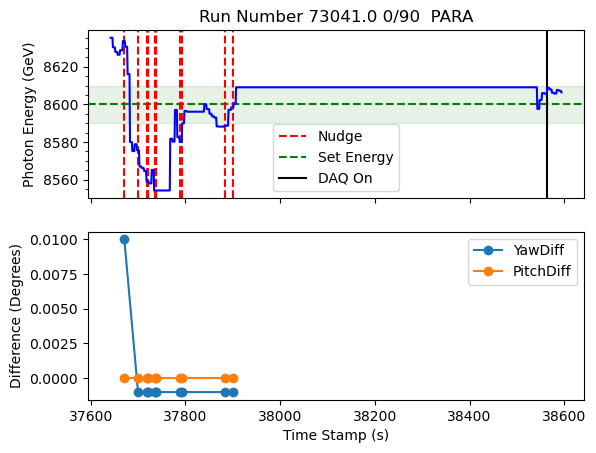

plotting for run  73045.0
daq on at time 15443.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    4813
-10.5      87
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    5919
-10.5      87
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

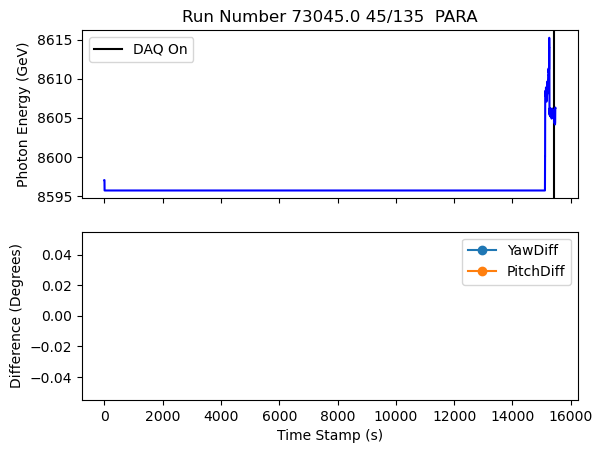

plotting for run  73051.0
Nudge number 4 occurs at time 177.0
daq on at time 252.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    133
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5698
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

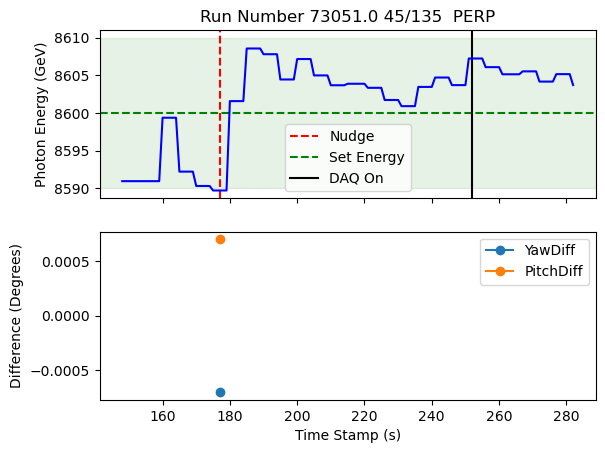

plotting for run  73055.0
Nudge number 2 occurs at time 1801.0
Nudge number 3 occurs at time 1803.0
Nudge number 4 occurs at time 1811.0
Nudge number 5 occurs at time 2944.0
Nudge number 6 occurs at time 2946.0
Nudge number 7 occurs at time 2948.0
daq on at time 183.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    2279
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    2471
 0.0       69
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

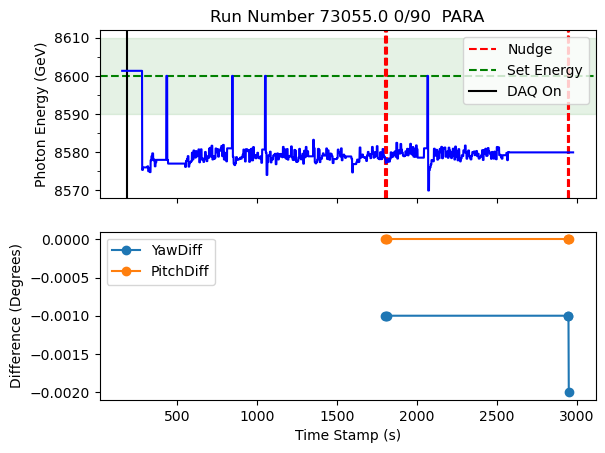

plotting for run  73056.0
Nudge number 1 occurs at time 3068.0
daq on at time 90.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    2809
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4400
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

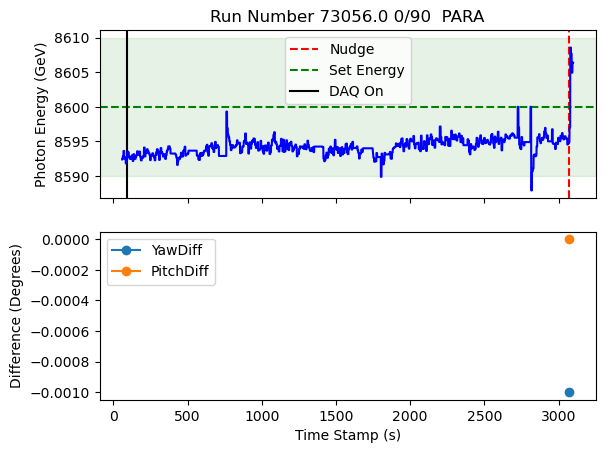

plotting for run  73058.0
Nudge number 2 occurs at time 205.0
daq on at time 298.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    145
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6782
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

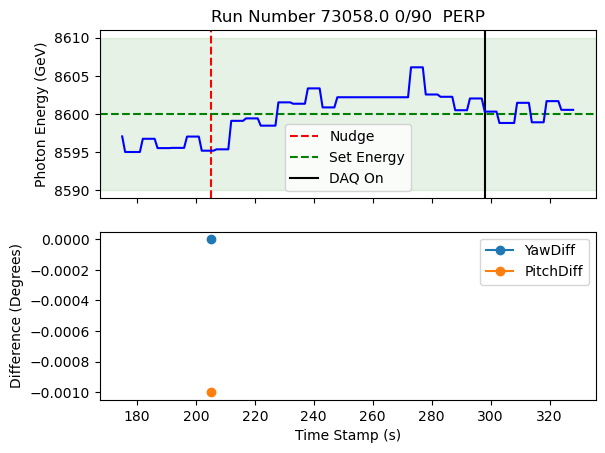

plotting for run  73062.0
Nudge number 4 occurs at time 228.0
daq on at time 290.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    102
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7014
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

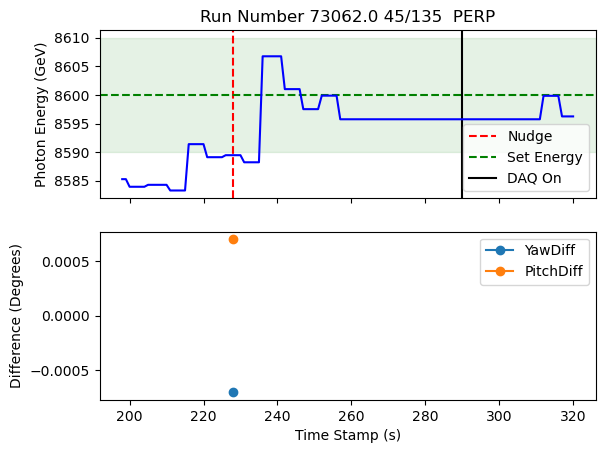

plotting for run  73066.0
Nudge number 2 occurs at time 353.0
Nudge number 3 occurs at time 370.0
Nudge number 4 occurs at time 374.0
Nudge number 5 occurs at time 379.0
Nudge number 6 occurs at time 396.0
Nudge number 7 occurs at time 400.0
Nudge number 8 occurs at time 415.0
Nudge number 9 occurs at time 420.0
Nudge number 10 occurs at time 430.0
Nudge number 11 occurs at time 435.0
Nudge number 14 occurs at time 493.0
Nudge number 15 occurs at time 496.0
Nudge number 16 occurs at time 508.0
Nudge number 17 occurs at time 510.0
Nudge number 18 occurs at time 520.0
Nudge number 21 occurs at time 613.0
Nudge number 22 occurs at time 644.0
Nudge number 23 occurs at time 702.0
daq on at time 270.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    399
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6379
 0.0       71
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

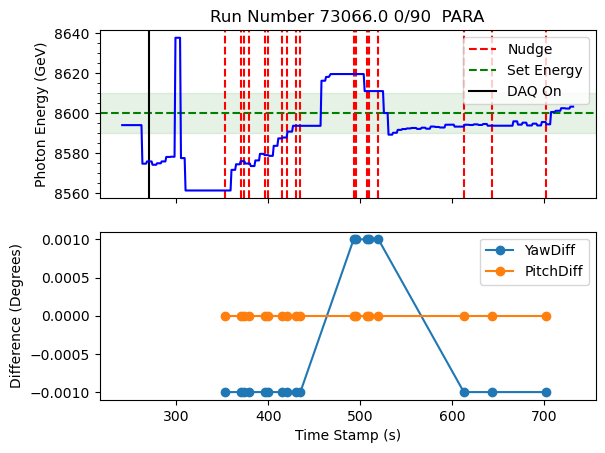

plotting for run  73067.0
daq on at time 222.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    209
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6126
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

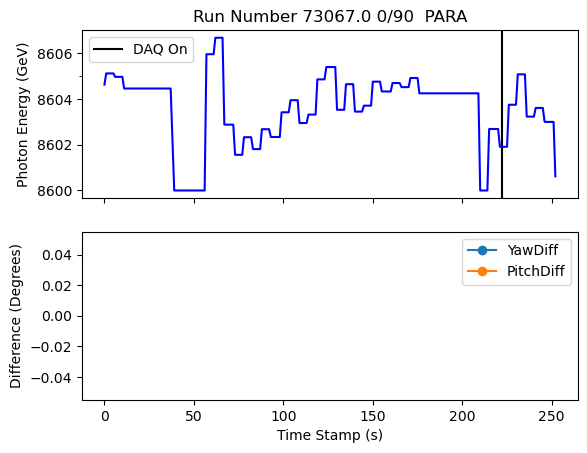

plotting for run  73073.0
Nudge number 2 occurs at time 333.0
daq on at time 143.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    200
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2511
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

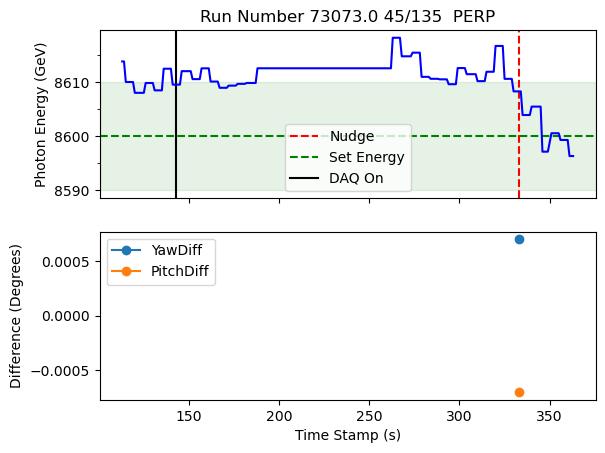

plotting for run  73078.0
Nudge number 3 occurs at time 707.0
Nudge number 4 occurs at time 712.0
Nudge number 5 occurs at time 723.0
Nudge number 6 occurs at time 733.0
Nudge number 7 occurs at time 764.0
Nudge number 8 occurs at time 782.0
Nudge number 9 occurs at time 829.0
daq on at time 283.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    561
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3502
 0.0       79
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

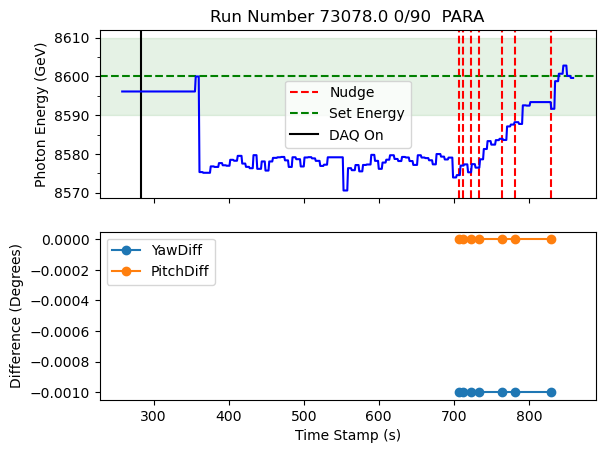

plotting for run  73088.0
Nudge number 2 occurs at time 2198.0
Nudge number 3 occurs at time 2202.0
daq on at time 469.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1626
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2478
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

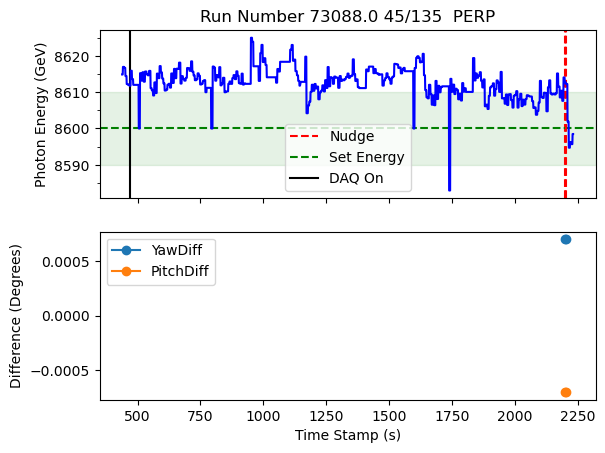

plotting for run  73093.0
Nudge number 3 occurs at time 20439.0
Nudge number 4 occurs at time 20454.0
Nudge number 7 occurs at time 20493.0
Nudge number 8 occurs at time 20494.0
Nudge number 9 occurs at time 20496.0
Nudge number 10 occurs at time 20497.0
Nudge number 11 occurs at time 20521.0
Nudge number 12 occurs at time 20522.0
Nudge number 13 occurs at time 20523.0
daq on at time 7374.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    8536
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    8618
 0.0      115
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

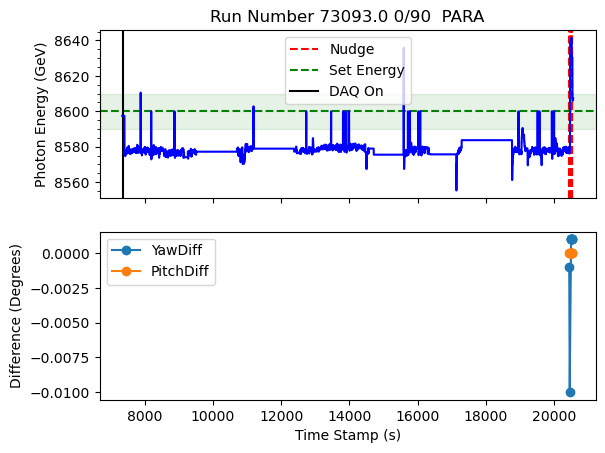

plotting for run  73108.0
daq on at time 9554.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    68
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    3252
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

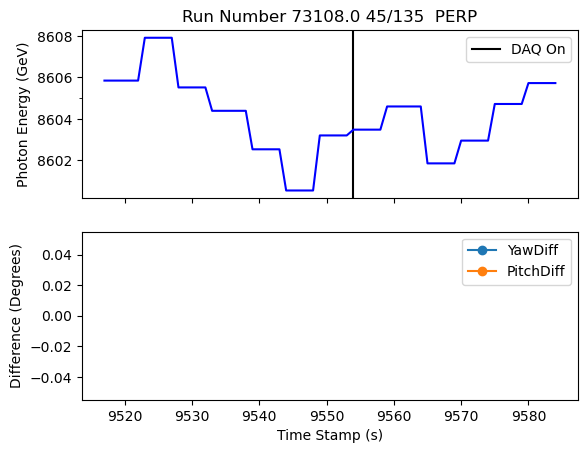

plotting for run  73109.0
Nudge number 1 occurs at time 24686.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    4581
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7616
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

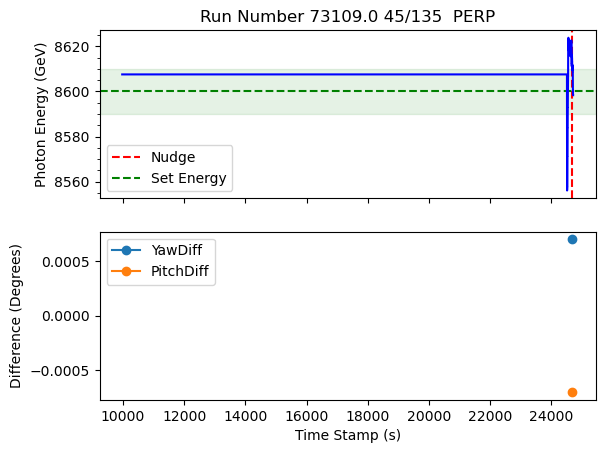

plotting for run  73121.0
daq on at time 457.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 34.5    322
-10.5     49
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6929
-10.5      49
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

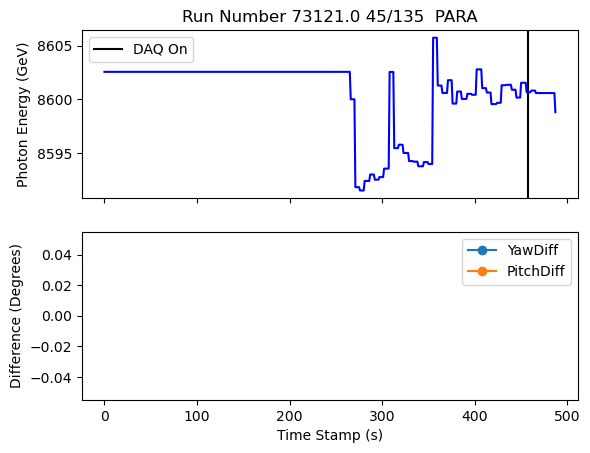

plotting for run  73123.0
daq on at time 331.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    345
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2027
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

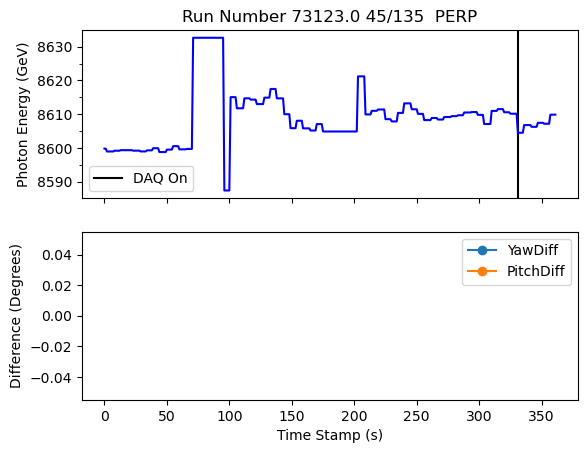

plotting for run  73126.0
Nudge number 1 occurs at time 12827.0
daq on at time 12723.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    152
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7979
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

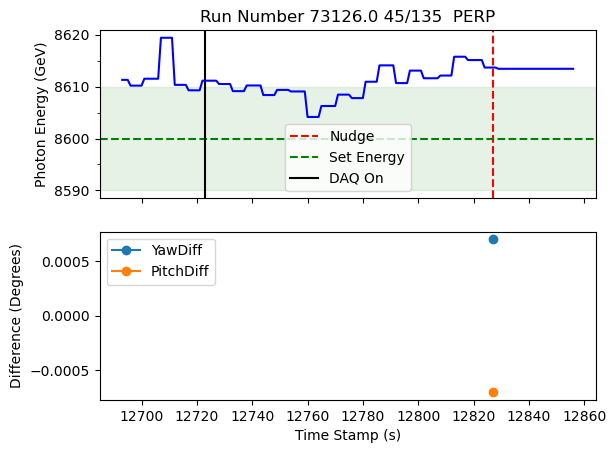

plotting for run  73130.0
Nudge number 3 occurs at time 4488.0
Nudge number 4 occurs at time 4504.0
Nudge number 5 occurs at time 4529.0
Nudge number 6 occurs at time 4552.0
Nudge number 7 occurs at time 4553.0
Nudge number 8 occurs at time 4576.0
daq on at time 4607.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    180
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6508
 0.0      211
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

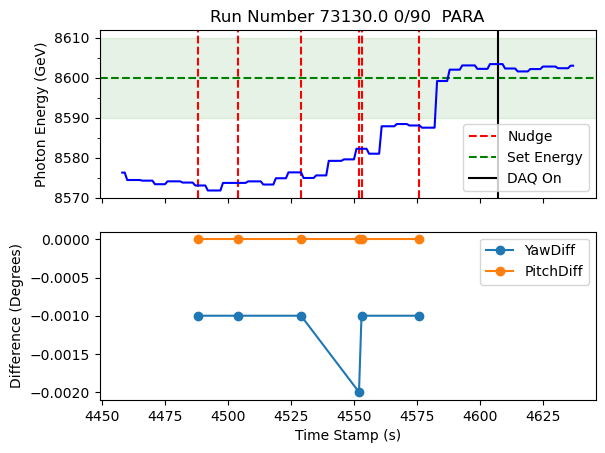

plotting for run  73147.0
daq on at time 19827.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    6781
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    12218
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

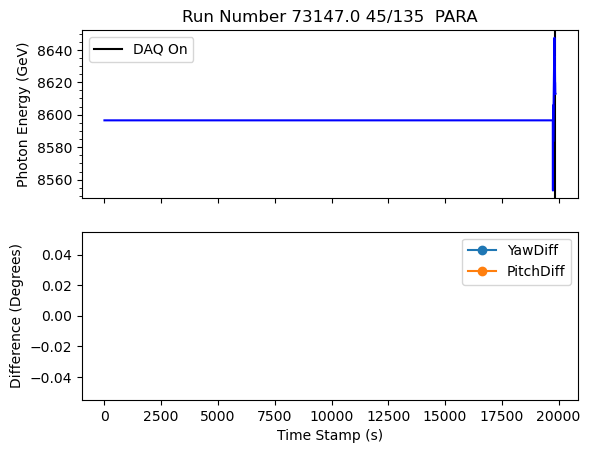

plotting for run  73151.0
Nudge number 2 occurs at time 665.0
Nudge number 3 occurs at time 742.0
Nudge number 4 occurs at time 766.0
Nudge number 5 occurs at time 865.0
Nudge number 6 occurs at time 887.0
Nudge number 7 occurs at time 906.0
Nudge number 8 occurs at time 925.0
Nudge number 9 occurs at time 946.0
daq on at time 1017.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    346
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5962
 0.0      166
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

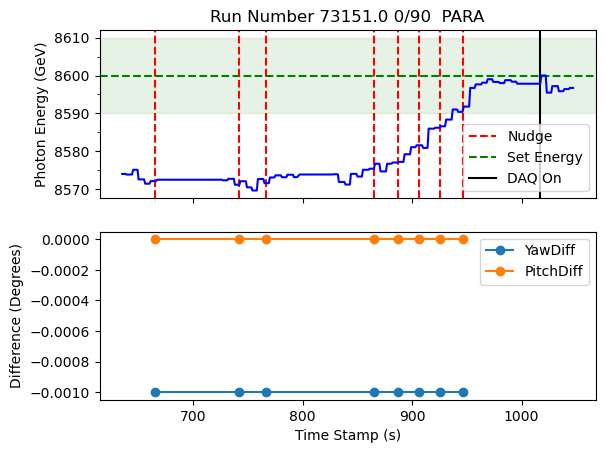

plotting for run  73160.0
Nudge number 1 occurs at time 7911.0
Nudge number 2 occurs at time 7921.0
daq on at time 7887.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    95
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3125
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

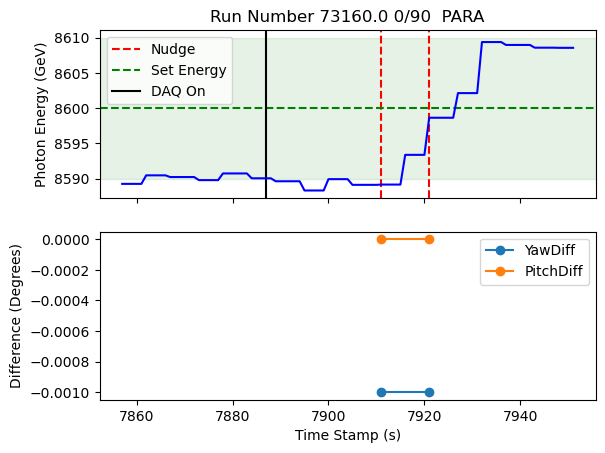

plotting for run  73166.0
daq on at time 2406.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    29.55
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
29.55    1284
34.50     410
Name: count, dtype: int64
roll values are GONI:ROLL
34.50    6347
29.55    1284
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

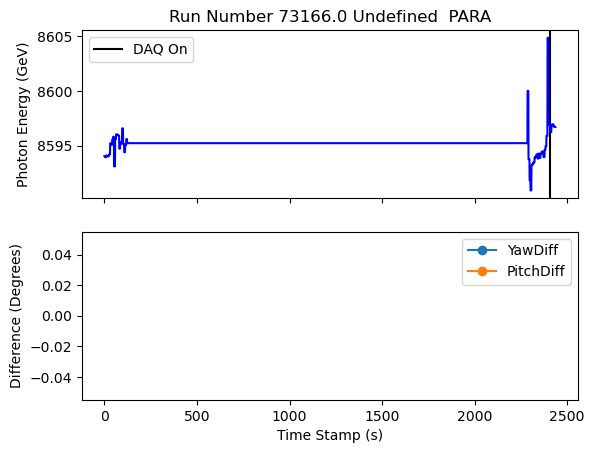

plotting for run  73167.0
daq on at time 291.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    288
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6125
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

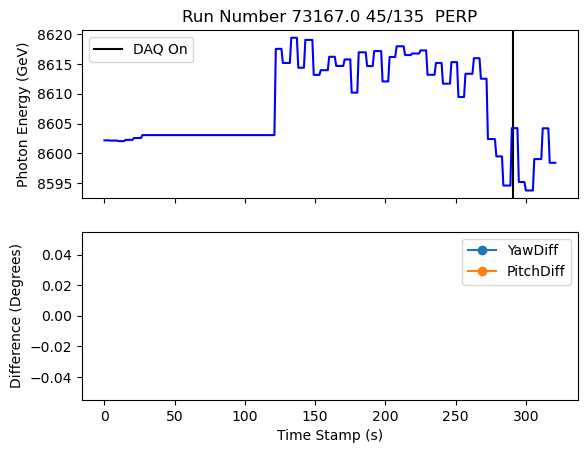

plotting for run  73170.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    83
 0.0     72
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    83
 0.0     72
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

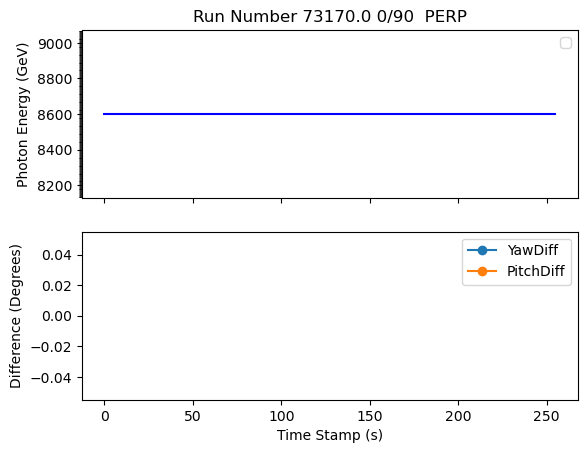

plotting for run  73171.0
daq on at time 12321.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    76
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6294
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

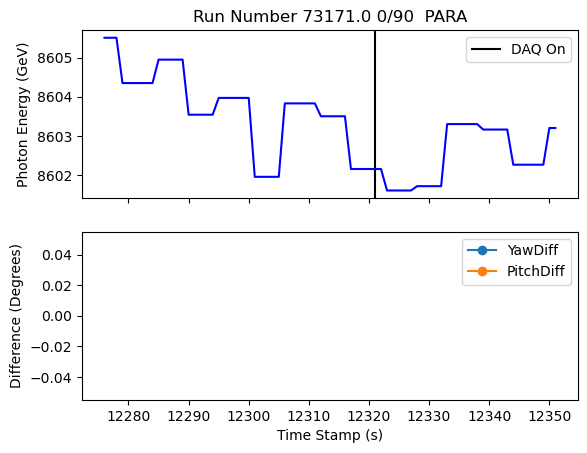

plotting for run  73173.0
Nudge number 3 occurs at time 376.0
Nudge number 5 occurs at time 424.0
Nudge number 6 occurs at time 442.0
daq on at time 477.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    128
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6732
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

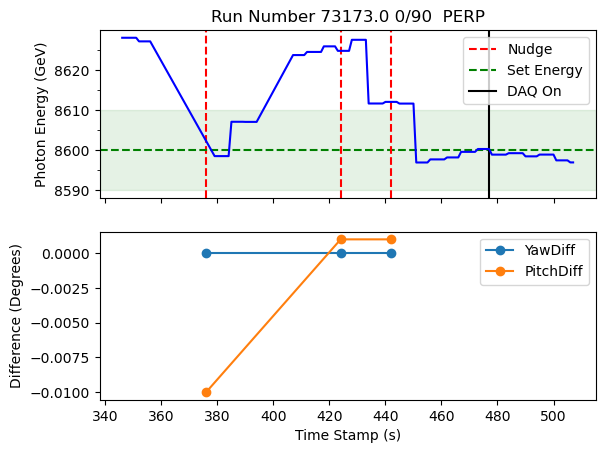

plotting for run  73175.0
Nudge number 4 occurs at time 994.0
Nudge number 5 occurs at time 1413.0
Nudge number 6 occurs at time 1415.0
Nudge number 7 occurs at time 1417.0
Nudge number 8 occurs at time 1428.0
Nudge number 9 occurs at time 1429.0
Nudge number 10 occurs at time 1430.0
Nudge number 11 occurs at time 1802.0
Nudge number 12 occurs at time 1812.0
Nudge number 13 occurs at time 1823.0
Nudge number 14 occurs at time 1840.0
Nudge number 15 occurs at time 1884.0
Nudge number 16 occurs at time 1901.0
Nudge number 17 occurs at time 1916.0
Nudge number 18 occurs at time 1925.0
Nudge number 19 occurs at time 1942.0
daq on at time 304.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    354
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    1788
-10.5      29
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

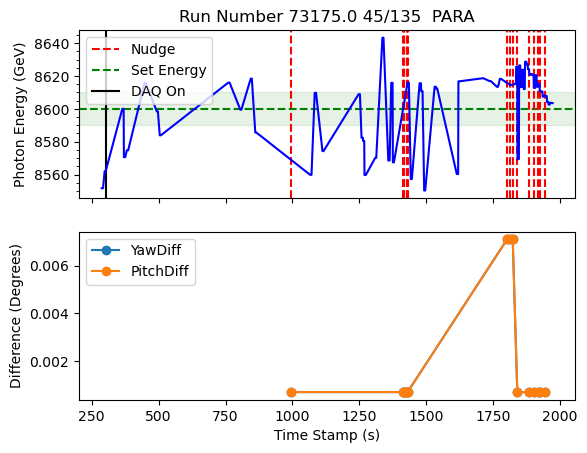

plotting for run  73178.0
Nudge number 1 occurs at time 266.0
Nudge number 2 occurs at time 295.0
Nudge number 3 occurs at time 332.0
Nudge number 4 occurs at time 549.0
Nudge number 5 occurs at time 564.0
Nudge number 6 occurs at time 596.0
Nudge number 7 occurs at time 615.0
Nudge number 8 occurs at time 625.0
Nudge number 9 occurs at time 636.0
Nudge number 10 occurs at time 671.0
Nudge number 11 occurs at time 689.0
daq on at time 780.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    351
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7067
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

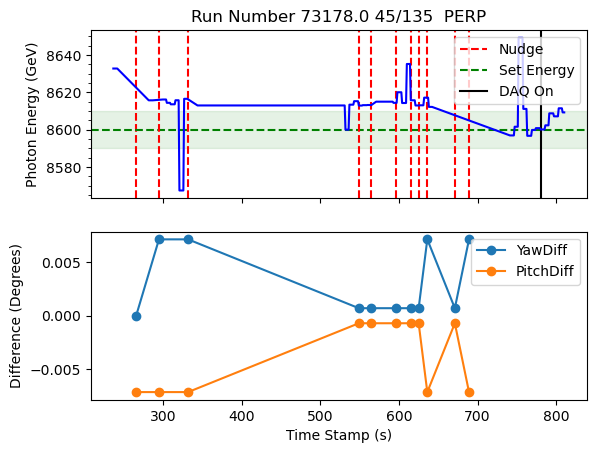

plotting for run  73182.0
Nudge number 32 occurs at time 959.0
Nudge number 33 occurs at time 981.0
Nudge number 34 occurs at time 1054.0
Nudge number 35 occurs at time 1138.0
daq on at time 879.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    290
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3262
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

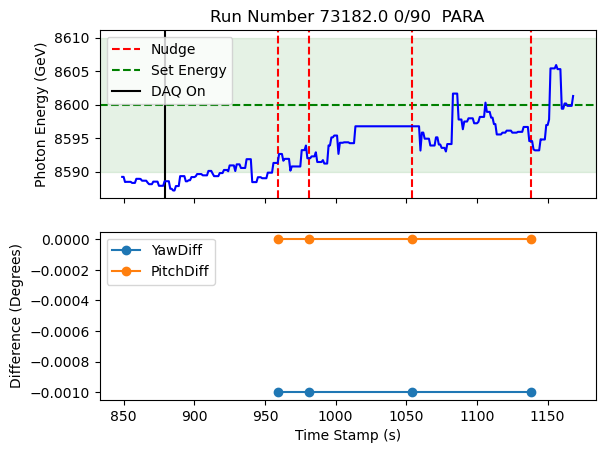

plotting for run  73184.0
Nudge number 1 occurs at time 398.0
Nudge number 2 occurs at time 413.0
Nudge number 3 occurs at time 430.0
daq on at time 114.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    268
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6305
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

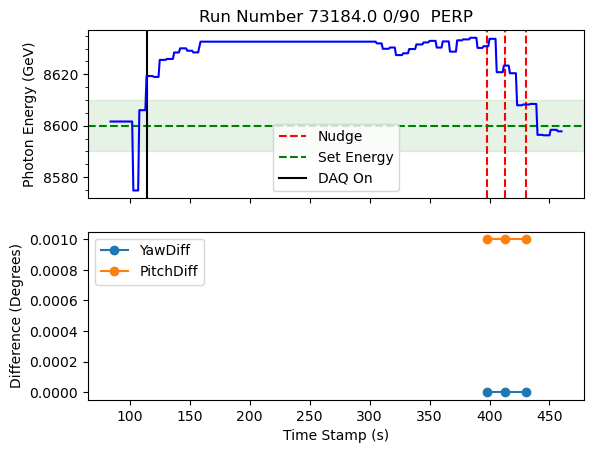

plotting for run  73188.0
Nudge number 4 occurs at time 349.0
Nudge number 5 occurs at time 367.0
daq on at time 464.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    173
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6352
-10.5      63
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

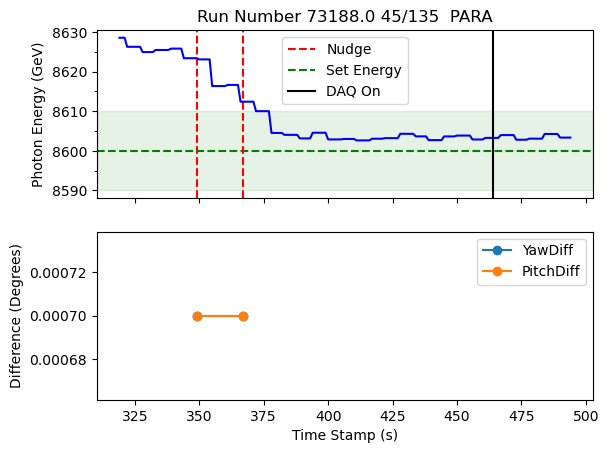

plotting for run  73191.0
Nudge number 5 occurs at time 238.0
Nudge number 6 occurs at time 240.0
Nudge number 7 occurs at time 243.0
Nudge number 8 occurs at time 247.0
Nudge number 9 occurs at time 250.0
Nudge number 10 occurs at time 254.0
Nudge number 11 occurs at time 257.0
Nudge number 12 occurs at time 262.0
Nudge number 13 occurs at time 268.0
Nudge number 14 occurs at time 273.0
Nudge number 15 occurs at time 279.0
Nudge number 16 occurs at time 288.0
Nudge number 17 occurs at time 292.0
Nudge number 18 occurs at time 304.0
Nudge number 19 occurs at time 359.0
Nudge number 20 occurs at time 368.0
Nudge number 24 occurs at time 402.0
Nudge number 25 occurs at time 412.0
Nudge number 29 occurs at time 508.0
Nudge number 30 occurs at time 516.0
Nudge number 31 occurs at time 526.0
Nudge number 32 occurs at time 534.0
Nudge number 33 occurs at time 540.0
Nudge number 34 occurs at time 548.0
Nudge number 35 occurs at time 553.0
daq on at time 591.0
[2.]
plane_values are 0    2.0
Na

<Figure size 640x480 with 0 Axes>

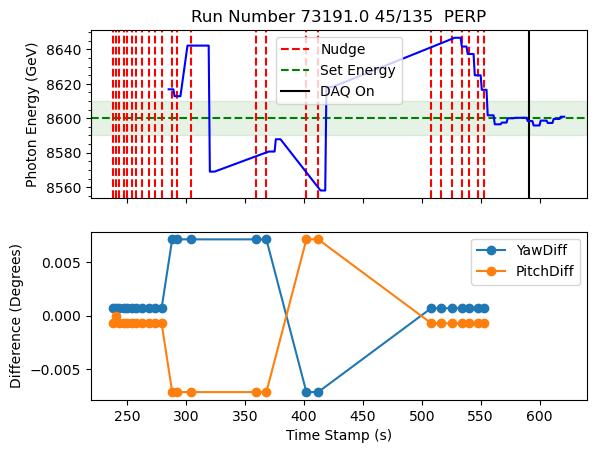

plotting for run  73210.0
Nudge number 1 occurs at time 501.0
Nudge number 2 occurs at time 503.0
Nudge number 3 occurs at time 504.0
Nudge number 4 occurs at time 508.0
Nudge number 5 occurs at time 554.0
daq on at time 577.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    137
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6366
 0.0       82
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

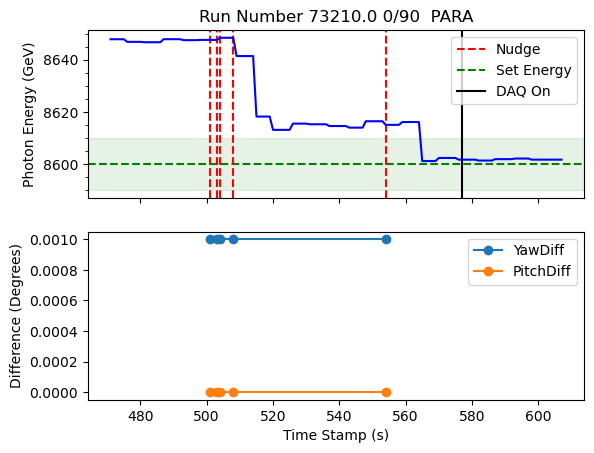

plotting for run  73212.0
daq on at time 580.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    380
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6504
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

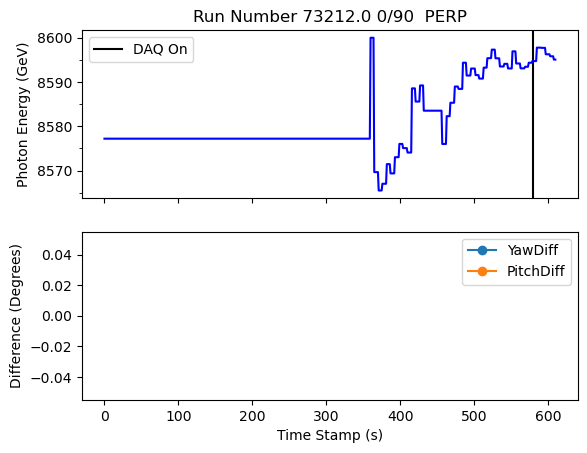

plotting for run  73214.0
Nudge number 6 occurs at time 773.0
Nudge number 7 occurs at time 788.0
daq on at time 858.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    146
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7191
-10.5     143
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

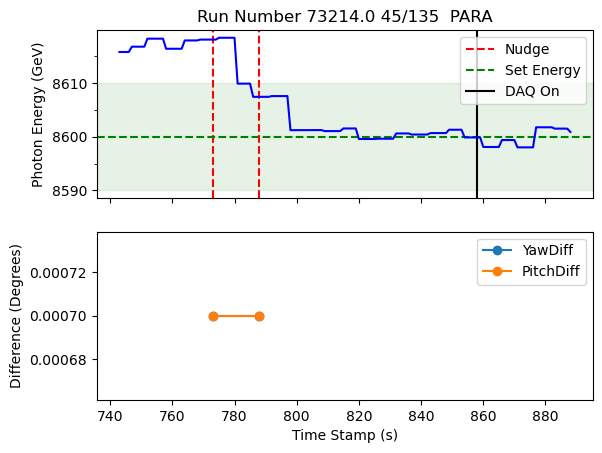

plotting for run  73216.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    124
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    251
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/1369966521.py:154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend()


<Figure size 640x480 with 0 Axes>

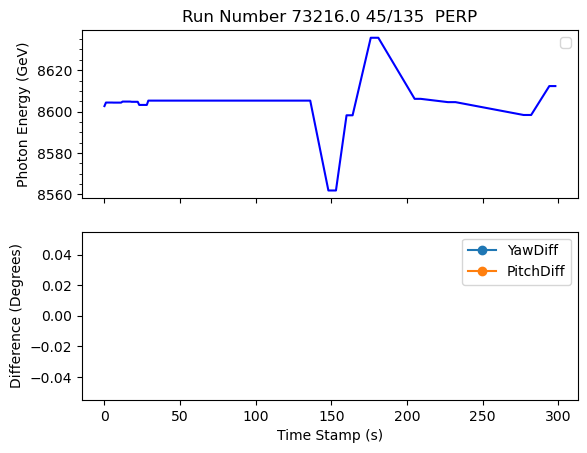

plotting for run  73217.0
daq on at time 164.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    40
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6163
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

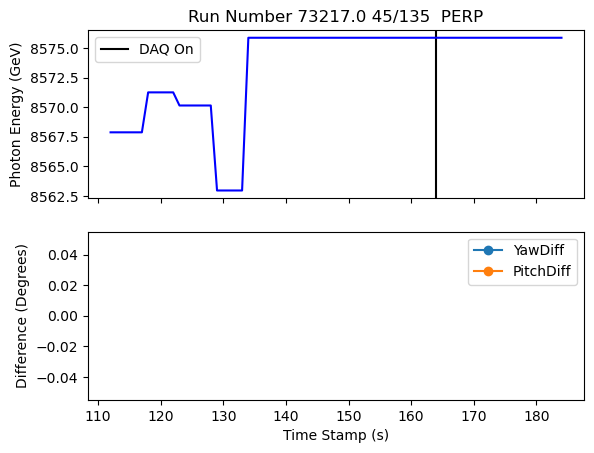

plotting for run  73225.0
daq on at time 300.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    228
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6317
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

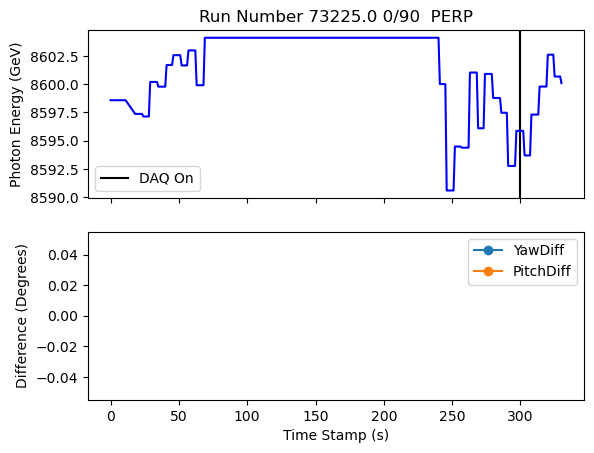

plotting for run  73227.0
Nudge number 2 occurs at time 335.0
Nudge number 3 occurs at time 413.0
Nudge number 4 occurs at time 441.0
Nudge number 5 occurs at time 453.0
Nudge number 6 occurs at time 480.0
daq on at time 579.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    297
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6624
-10.5      37
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

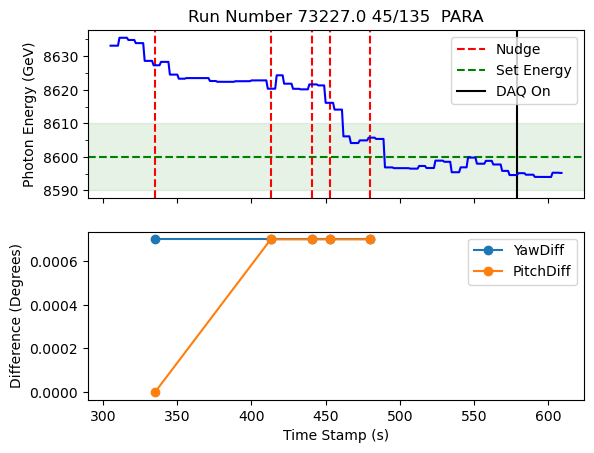

plotting for run  73230.0
Nudge number 2 occurs at time 2546.0
Nudge number 3 occurs at time 2588.0
Nudge number 4 occurs at time 2622.0
Nudge number 5 occurs at time 2692.0
daq on at time 2768.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    144
Name: count, dtype: int64
roll values are GONI:ROLL
34.50    7674
29.55    1339
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

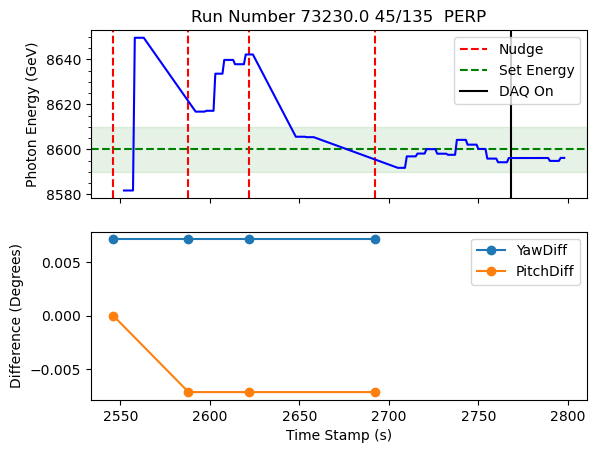

plotting for run  73263.0
Nudge number 1 occurs at time 456.0
Nudge number 2 occurs at time 477.0
Nudge number 3 occurs at time 503.0
Nudge number 7 occurs at time 568.0
Nudge number 8 occurs at time 589.0
daq on at time 344.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    229
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    2408
 0.0       75
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

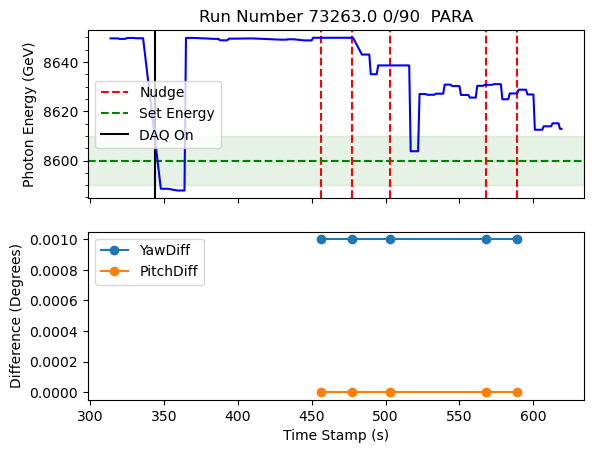

plotting for run  73266.0
daq on at time 348.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    50
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5929
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

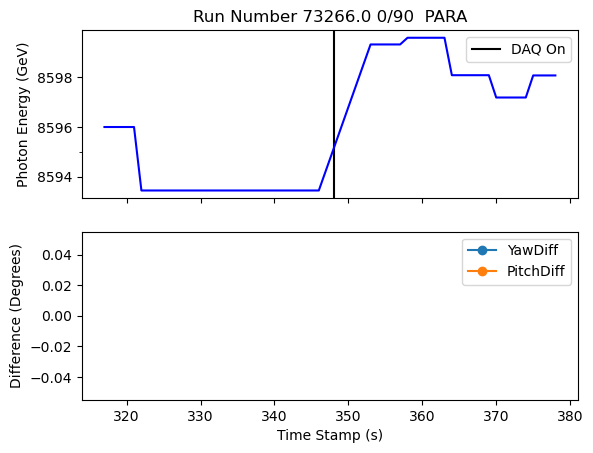

<Figure size 640x480 with 0 Axes>

In [8]:
for runVal in nudge_list_2020:
    plot_run(df_2020_good,runVal)

In [9]:
def save_tmp_df(df_in,runNum,df_name):
    df_new = df_in[(df_in['RunNumber']>=(runNum-1))&(df_in['RunNumber']<=(runNum+1))]
    df_new.to_csv(df_name)

In [10]:
#save_tmp_df(df_2020,72719,'df_72719.csv')


In [11]:
print(df_2020_good.columns)

Index(['Date-Time', 'RunNumber', 'DAQ:STATUS', 'CBREM:PLANE', 'GONI:ROLL',
       'GONI:ROLL.RBV', 'GONI:X', 'GONI:X.RBV', 'GONI:Y', 'GONI:Y.RBV',
       'GONI:PITCH', 'GONI:PITCH.RBV', 'GONI:YAW', 'GONI:YAW.RBV', 'AC:X',
       'AC:Y', 'EBEAM:CURRENT', 'EBEAM:ENERGY', 'EBEAM:X', 'EBEAM:Y',
       'CBREM:SET_ENERGY', 'CBREM:ENERGY_UNC', 'CBREM:ENERGY', 'RADIATOR:ID',
       'RADIATOR:NAME', 'goodRun', 'TimeStamp', 'NudgeDuringRun',
       'RunHasNudge', 'NudgeOccurred', 'TotalNudgeSize_thisRun',
       'NudgeSequence', 'NudgeSequenceReduced_Correct',
       'NudgeSequenceReduced_Naive', 'TotalNudges_thisRun',
       'RunHasAbnormalNudge', 'RunHasBacklash', 'BacklashNudge', 'NudgeNumber',
       'NudgePitchSize', 'NudgeYawSize', 'PitchMotionSize', 'YawMotionSize',
       'MotionDone', 'NudgeEnSize_10s', 'CBREM:ENERGY_LAG_ADJUSTED'],
      dtype='object')


plotting for run  72109
Nudge number 4 occurs at time 211.0
Nudge number 5 occurs at time 216.0
daq on at time 252.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    99
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6189
Name: count, dtype: int64


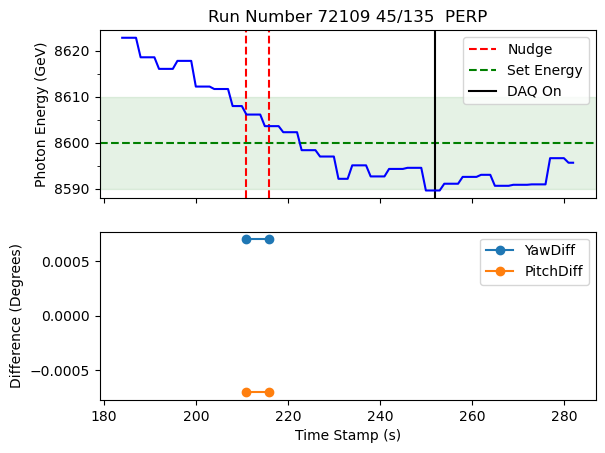

should have  [8] nudges for run 72109
energy change is 12.381999999999607
num_nudges_better is 2.0
energy change per nudge for run  72109 is 6.1909999999998035
plotting for run  72274
Nudge number 1 occurs at time 268.0
daq on at time 142.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    185
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5079
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

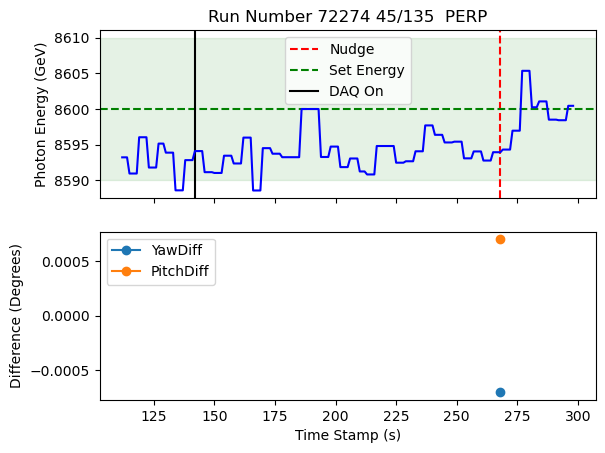

should have  [1] nudges for run 72274
energy change is 5.802000000001499
num_nudges_better is 1.0
energy change per nudge for run  72274 is 5.802000000001499
plotting for run  72297
Nudge number 2 occurs at time 3520.0
Nudge number 3 occurs at time 3566.0
daq on at time 1763.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1613
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7037
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

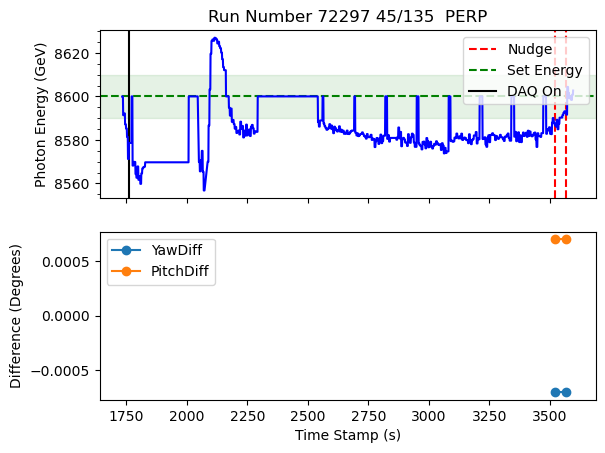

should have  [3] nudges for run 72297
energy change is 13.127999999998792
num_nudges_better is 2.0
energy change per nudge for run  72297 is 6.563999999999396
plotting for run  72410
Nudge number 2 occurs at time 416.0
Nudge number 3 occurs at time 430.0
Nudge number 4 occurs at time 444.0
Nudge number 5 occurs at time 451.0
Nudge number 6 occurs at time 475.0
Nudge number 7 occurs at time 483.0
daq on at time 299.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    234
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    6726
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

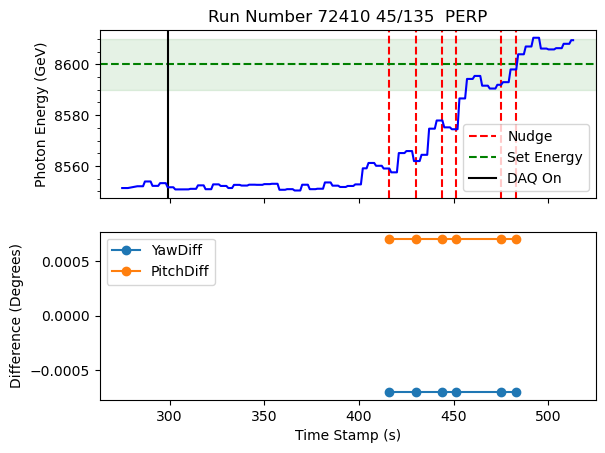

should have  [7] nudges for run 72410
energy change is 48.24200000000019
num_nudges_better is 5.9
energy change per nudge for run  72410 is 8.176610169491557
plotting for run  72417
Nudge number 2 occurs at time 417.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    58
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    251
-10.5     86
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

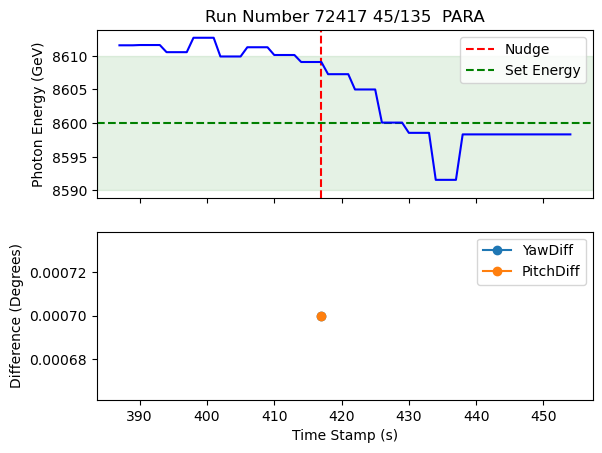

should have  [2] nudges for run 72417
energy change is 12.923333333332266
num_nudges_better is 1.0
energy change per nudge for run  72417 is 12.923333333332266
plotting for run  72657
Nudge number 4 occurs at time 686.0
Nudge number 5 occurs at time 697.0
Nudge number 6 occurs at time 705.0
Nudge number 7 occurs at time 708.0
Nudge number 8 occurs at time 723.0
daq on at time 502.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    114
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6675
-10.5      80
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

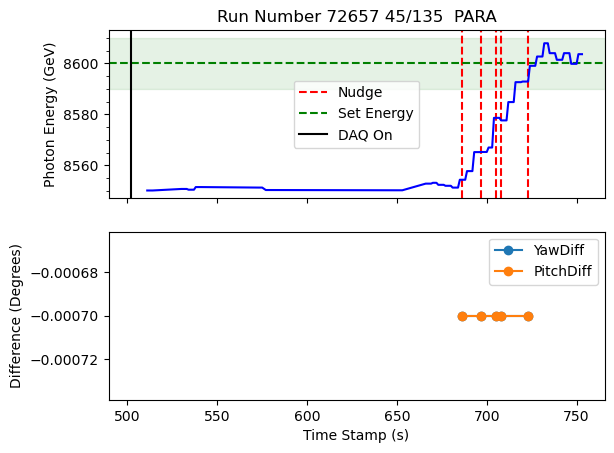

should have  [8] nudges for run 72657
energy change is 47.844999999999345
num_nudges_better is 4.9
energy change per nudge for run  72657 is 9.76428571428558
plotting for run  72745
Nudge number 2 occurs at time 1800.0
daq on at time 411.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    540
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    5979
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

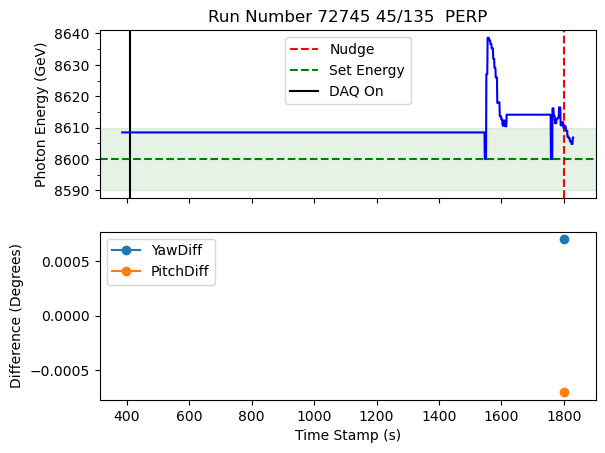

should have  [2] nudges for run 72745
energy change is 3.7660000000014406
num_nudges_better is 1.0
energy change per nudge for run  72745 is 3.7660000000014406
plotting for run  72773
Nudge number 2 occurs at time 1354.0
daq on at time 1519.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    188
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    7430
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

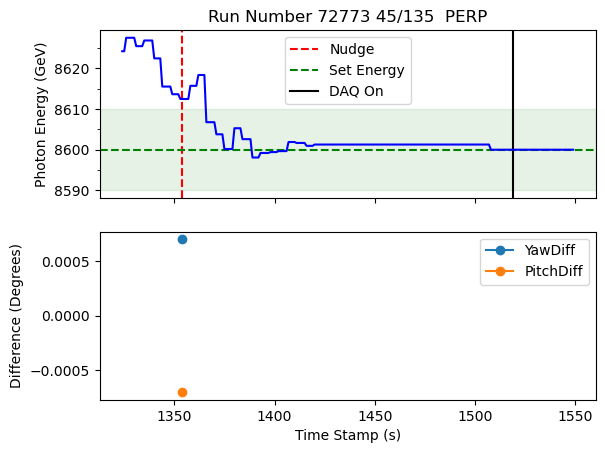

should have  [2] nudges for run 72773
energy change is 8.728000000000975
num_nudges_better is 1.0
energy change per nudge for run  72773 is 8.728000000000975
plotting for run  72816
Nudge number 4 occurs at time 97.0
Nudge number 5 occurs at time 111.0
daq on at time 219.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    182
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    3196
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

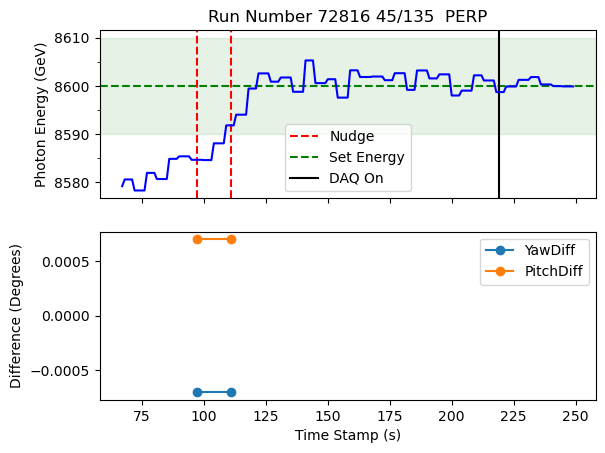

should have  [5] nudges for run 72816
energy change is 17.200000000000728
num_nudges_better is 2.0
energy change per nudge for run  72816 is 8.600000000000364
plotting for run  73073
Nudge number 2 occurs at time 333.0
daq on at time 143.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    200
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2511
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

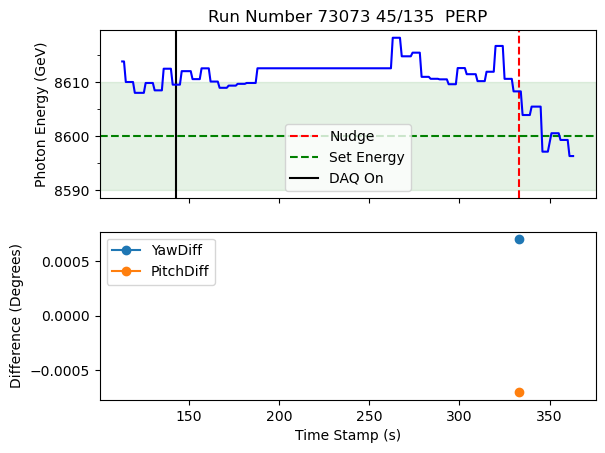

should have  [2] nudges for run 73073
energy change is 9.9325000000008
num_nudges_better is 1.0
energy change per nudge for run  73073 is 9.9325000000008
plotting for run  73088
Nudge number 2 occurs at time 2198.0
Nudge number 3 occurs at time 2202.0
daq on at time 469.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    1626
Name: count, dtype: int64
roll values are GONI:ROLL
34.5    2478
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

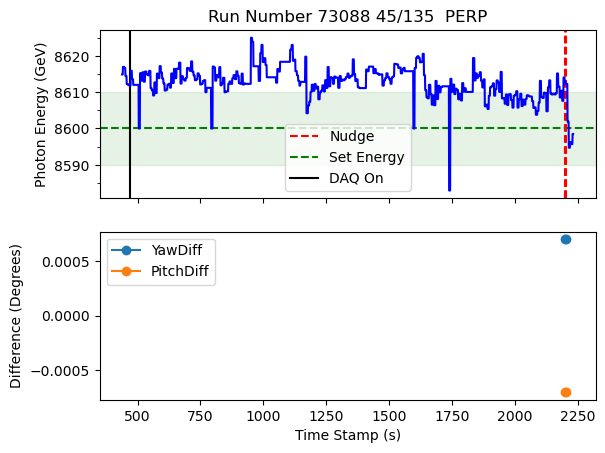

should have  [3] nudges for run 73088
energy change is 17.774999999999636
num_nudges_better is 2.0
energy change per nudge for run  73088 is 8.887499999999818
plotting for run  73188
Nudge number 4 occurs at time 349.0
Nudge number 5 occurs at time 367.0
daq on at time 464.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    173
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    6352
-10.5      63
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

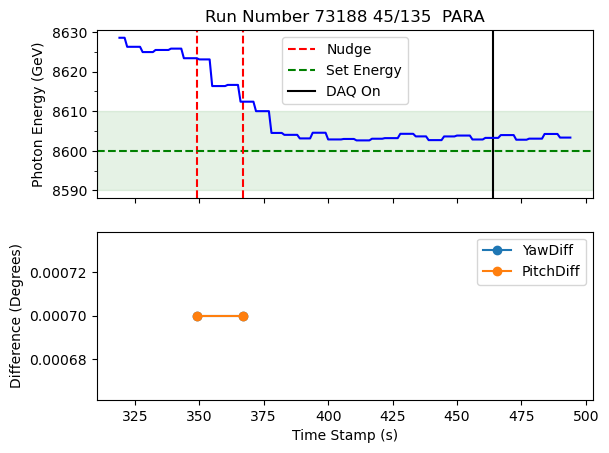

should have  [5] nudges for run 73188
energy change is 19.292500000001382
num_nudges_better is 2.0
energy change per nudge for run  73188 is 9.646250000000691
plotting for run  73214
Nudge number 6 occurs at time 773.0
Nudge number 7 occurs at time 788.0
daq on at time 858.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    34.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
34.5    146
Name: count, dtype: int64
roll values are GONI:ROLL
 34.5    7191
-10.5     143
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

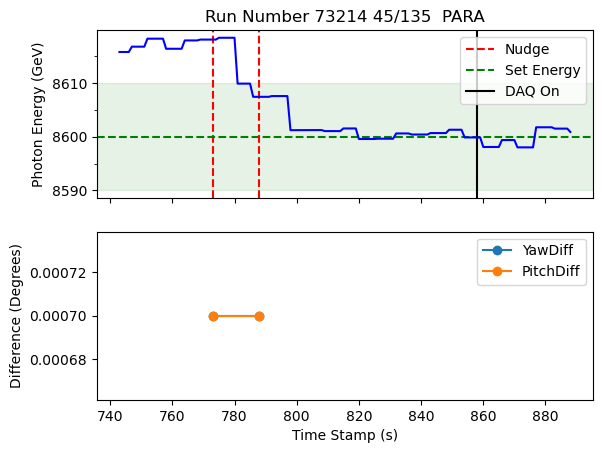

should have  [7] nudges for run 73214
energy change is 16.813333333335322
num_nudges_better is 2.0
energy change per nudge for run  73214 is 8.406666666667661
plotting for run  72105
Nudge number 2 occurs at time 192.0
daq on at time 270.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6616
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

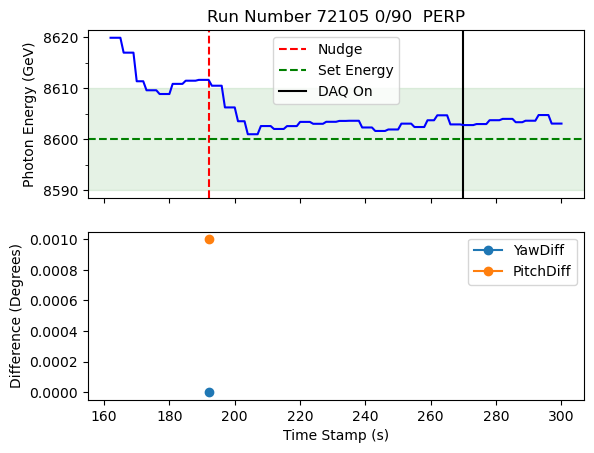

should have  [2] nudges for run 72105
energy change is 9.293999999999869
num_nudges_better is 1.0
energy change per nudge for run  72105 is 9.293999999999869
plotting for run  72142
Nudge number 1 occurs at time 50.0
Nudge number 2 occurs at time 74.0
Nudge number 3 occurs at time 93.0
daq on at time 200.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    200
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6559
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

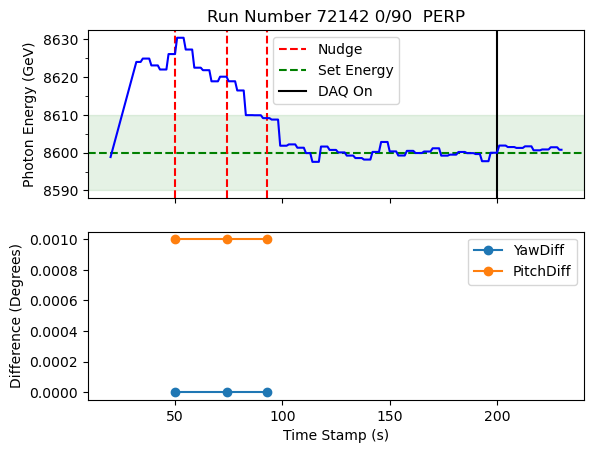

should have  [3] nudges for run 72142
energy change is 25.833999999998923
num_nudges_better is 3.0
energy change per nudge for run  72142 is 8.611333333332974
plotting for run  72158
Nudge number 2 occurs at time 1453.0
Nudge number 3 occurs at time 1471.0
daq on at time 1591.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    193
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7572
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

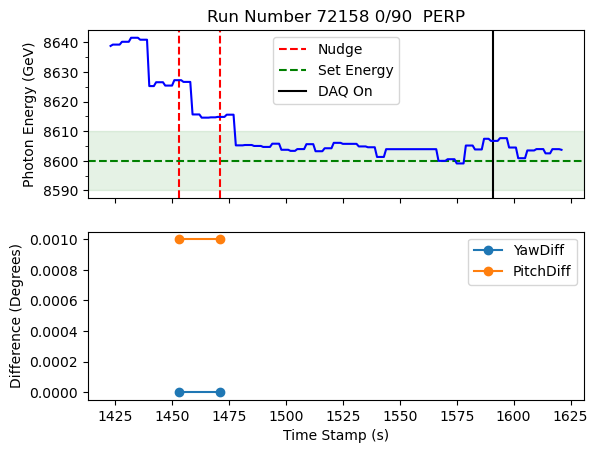

should have  [3] nudges for run 72158
energy change is 22.424999999999272
num_nudges_better is 2.0
energy change per nudge for run  72158 is 11.212499999999636
plotting for run  72173
Nudge number 2 occurs at time 221.0
Nudge number 3 occurs at time 232.0
daq on at time 329.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    169
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6827
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

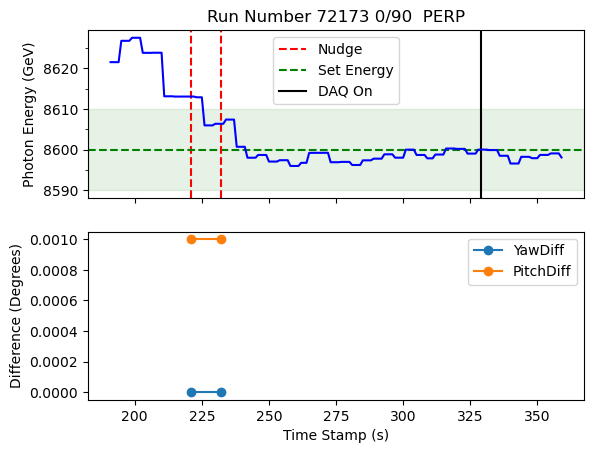

should have  [3] nudges for run 72173
energy change is 15.82799999999952
num_nudges_better is 2.0
energy change per nudge for run  72173 is 7.91399999999976
plotting for run  72187
Nudge number 2 occurs at time 645.0
Nudge number 3 occurs at time 671.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    98
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    307
 0.0     164
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

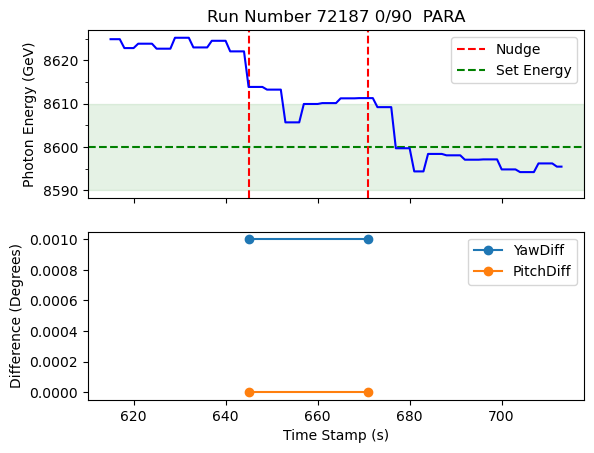

should have  [3] nudges for run 72187
energy change is 16.745999999999185
num_nudges_better is 2.0
energy change per nudge for run  72187 is 8.372999999999593
plotting for run  72190
Nudge number 1 occurs at time 123.0
Nudge number 2 occurs at time 134.0
daq on at time 185.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    118
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6967
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

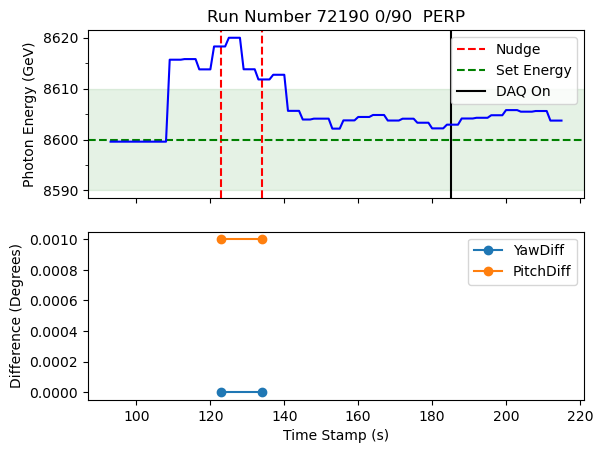

should have  [2] nudges for run 72190
energy change is 14.430000000000291
num_nudges_better is 2.0
energy change per nudge for run  72190 is 7.2150000000001455
plotting for run  72266
Nudge number 2 occurs at time 366.0
daq on at time 344.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    83
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6860
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

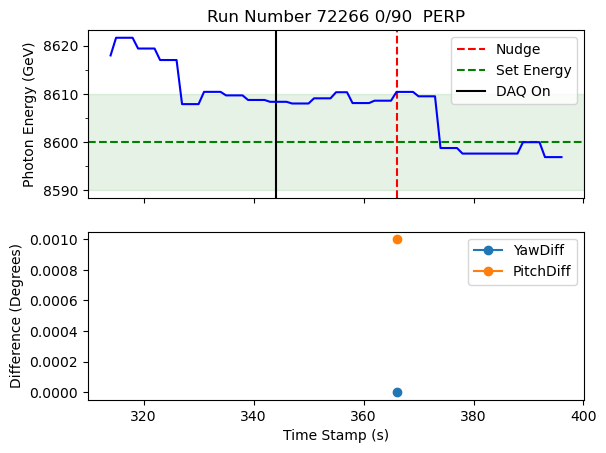

should have  [2] nudges for run 72266
energy change is 12.22666666666737
num_nudges_better is 1.0
energy change per nudge for run  72266 is 12.22666666666737
plotting for run  72285
Nudge number 2 occurs at time 197.0
daq on at time 341.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    205
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    7561
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

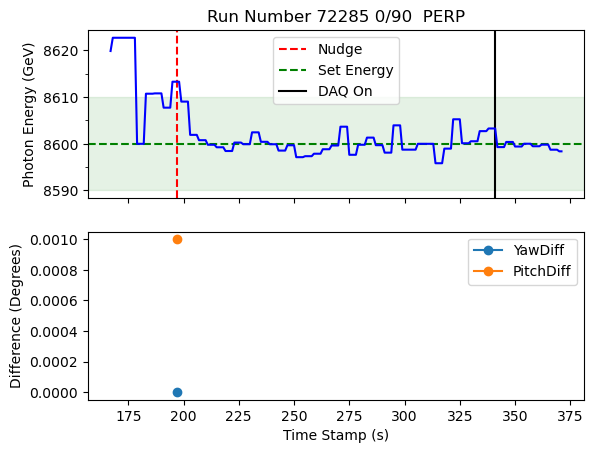

should have  [2] nudges for run 72285
energy change is 13.768000000001848
num_nudges_better is 1.0
energy change per nudge for run  72285 is 13.768000000001848
plotting for run  72367
Nudge number 1 occurs at time 3966.0
daq on at time 4332.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    427
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    9414
 0.0      280
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

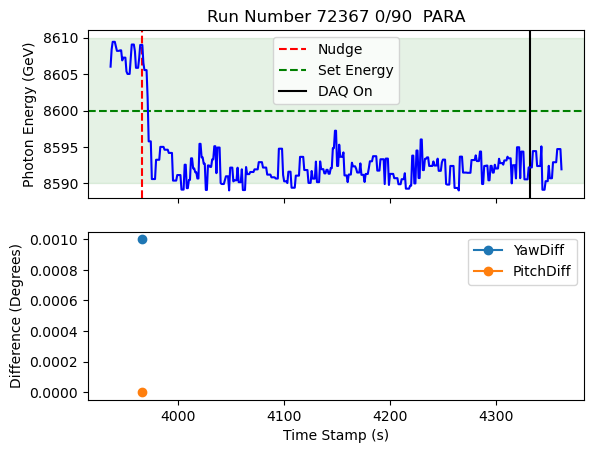

should have  [1] nudges for run 72367
energy change is 15.523999999999432
num_nudges_better is 1.0
energy change per nudge for run  72367 is 15.523999999999432
plotting for run  72406
Nudge number 2 occurs at time 286.0
Nudge number 3 occurs at time 338.0
daq on at time 366.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6873
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

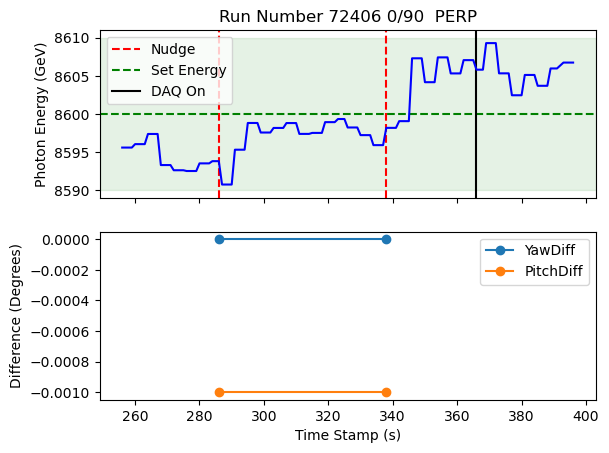

should have  [3] nudges for run 72406
energy change is 12.126000000000204
num_nudges_better is 2.0
energy change per nudge for run  72406 is 6.063000000000102
plotting for run  72434
Nudge number 3 occurs at time 246.0
Nudge number 4 occurs at time 260.0
daq on at time 289.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    102
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5993
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

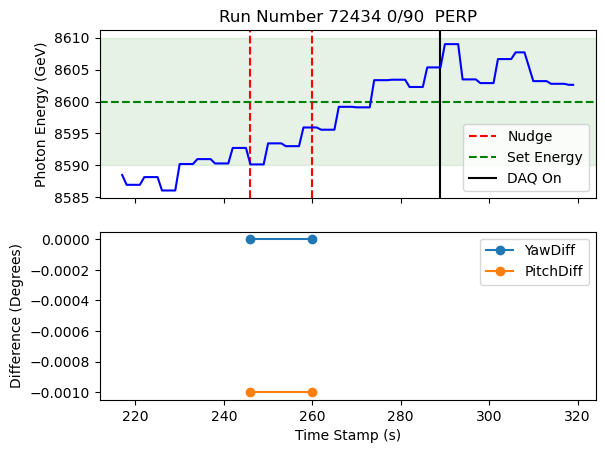

should have  [4] nudges for run 72434
energy change is 14.540000000000873
num_nudges_better is 2.0
energy change per nudge for run  72434 is 7.270000000000437
plotting for run  72650
Nudge number 1 occurs at time 2951.0
Nudge number 2 occurs at time 2961.0
daq on at time 642.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    1985
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4345
 0.0      114
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

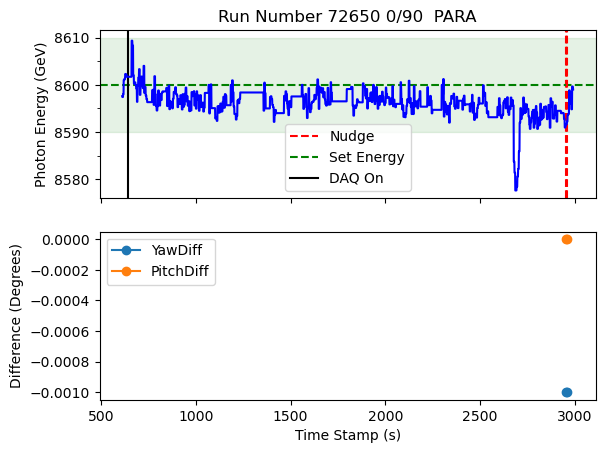

should have  [2] nudges for run 72650
energy change is 6.145999999998821
num_nudges_better is 2.0
energy change per nudge for run  72650 is 3.0729999999994106
plotting for run  72703
Nudge number 1 occurs at time 52.0
Nudge number 2 occurs at time 123.0
daq on at time 198.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    196
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6326
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

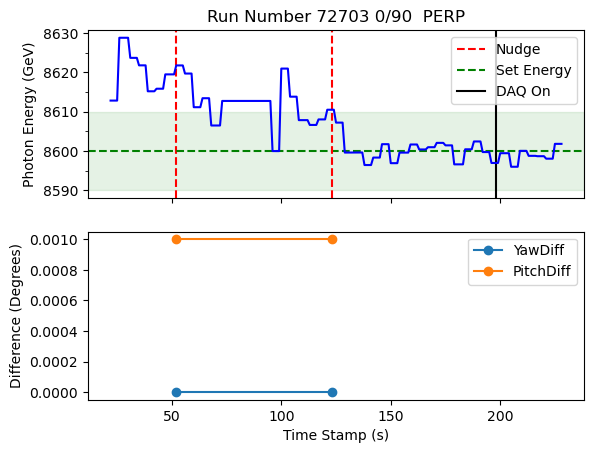

should have  [2] nudges for run 72703
energy change is 23.357500000000073
num_nudges_better is 2.0
energy change per nudge for run  72703 is 11.678750000000036
plotting for run  72707
Nudge number 1 occurs at time 549.0
daq on at time 242.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    368
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3284
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

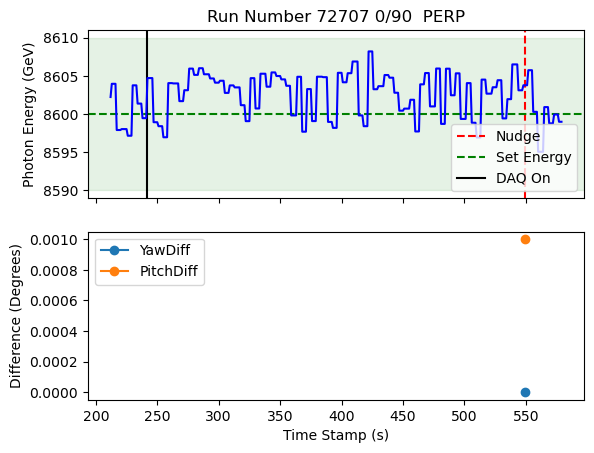

should have  [1] nudges for run 72707
energy change is 5.03400000000147
num_nudges_better is 1.0
energy change per nudge for run  72707 is 5.03400000000147
plotting for run  72725
Nudge number 2 occurs at time 123.0
Nudge number 3 occurs at time 138.0
daq on at time 160.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    92
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    569
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

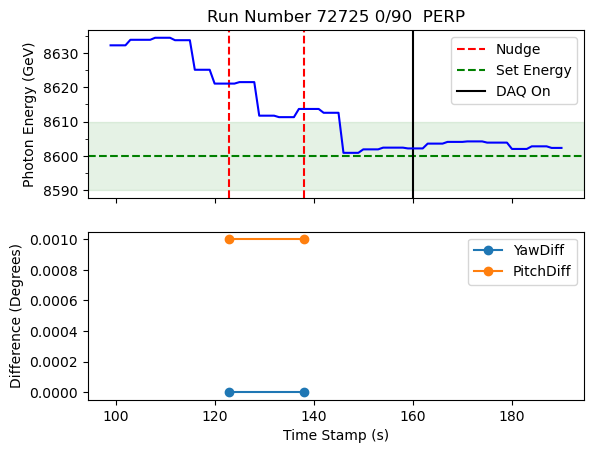

should have  [3] nudges for run 72725
energy change is 18.187999999998283
num_nudges_better is 2.0
energy change per nudge for run  72725 is 9.093999999999141
plotting for run  72739
Nudge number 2 occurs at time 1190.0
Nudge number 3 occurs at time 1800.0
daq on at time 1857.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    462
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3446
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

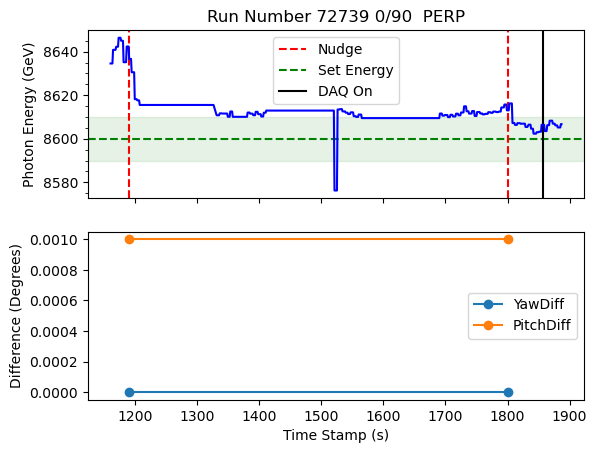

should have  [3] nudges for run 72739
energy change is 30.126000000002023
num_nudges_better is 2.0
energy change per nudge for run  72739 is 15.063000000001011
plotting for run  72749
Nudge number 1 occurs at time 270.0
Nudge number 2 occurs at time 271.0
Nudge number 3 occurs at time 285.0
Nudge number 4 occurs at time 302.0
daq on at time 383.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    139
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    5612
 0.0      113
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

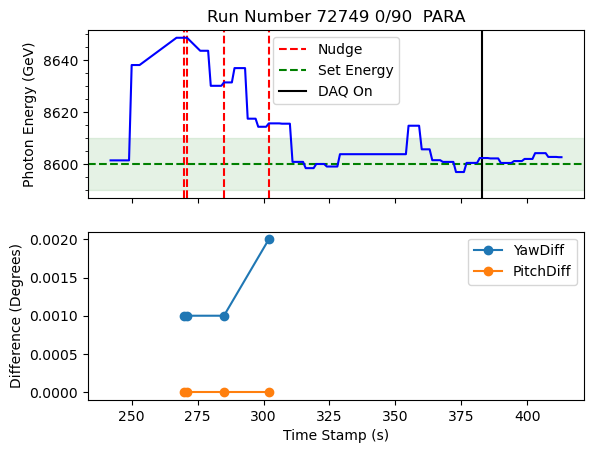

should have  [4] nudges for run 72749
energy change is 48.1200000000008
num_nudges_better is 4.0
energy change per nudge for run  72749 is 12.0300000000002
plotting for run  72780
Nudge number 1 occurs at time 1347.0
Nudge number 2 occurs at time 1371.0
Nudge number 3 occurs at time 1385.0
Nudge number 4 occurs at time 1386.0
Nudge number 5 occurs at time 1404.0
Nudge number 6 occurs at time 1414.0
daq on at time 185.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    660
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    1439
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

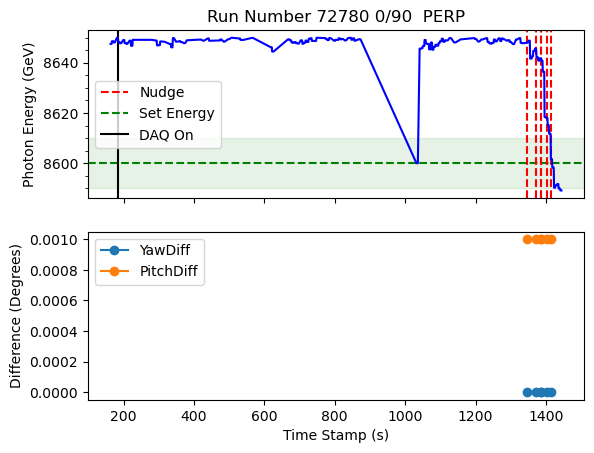

should have  [7] nudges for run 72780
energy change is 57.66749999999956
num_nudges_better is 6.0
energy change per nudge for run  72780 is 9.611249999999927
plotting for run  72781
Nudge number 1 occurs at time 966.0
daq on at time 41.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    380
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4669
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

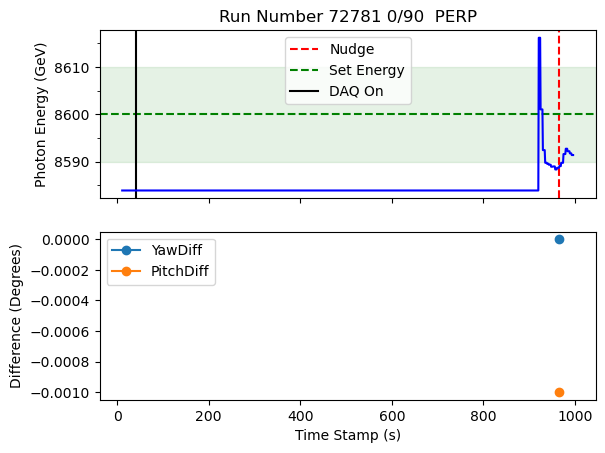

should have  [1] nudges for run 72781
energy change is 2.960000000000946
num_nudges_better is 1.0
energy change per nudge for run  72781 is 2.960000000000946
plotting for run  72796
Nudge number 2 occurs at time 316.0
Nudge number 3 occurs at time 337.0
Nudge number 4 occurs at time 368.0
daq on at time 400.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    119
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6198
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

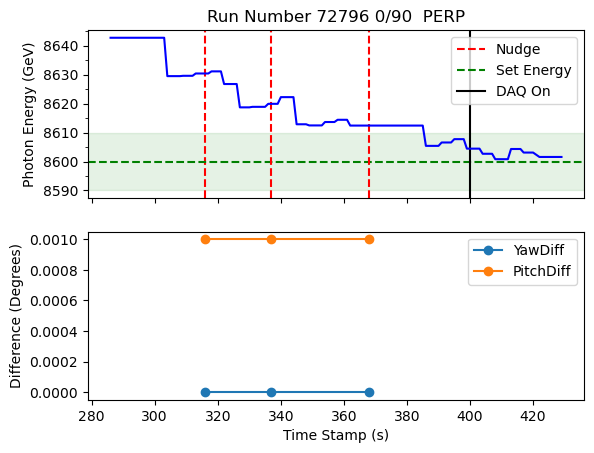

should have  [4] nudges for run 72796
energy change is 22.375
num_nudges_better is 3.0
energy change per nudge for run  72796 is 7.458333333333333
plotting for run  72837
Nudge number 2 occurs at time 280.0
Nudge number 3 occurs at time 299.0
Nudge number 4 occurs at time 328.0
Nudge number 5 occurs at time 354.0
daq on at time 558.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    339
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    1471
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

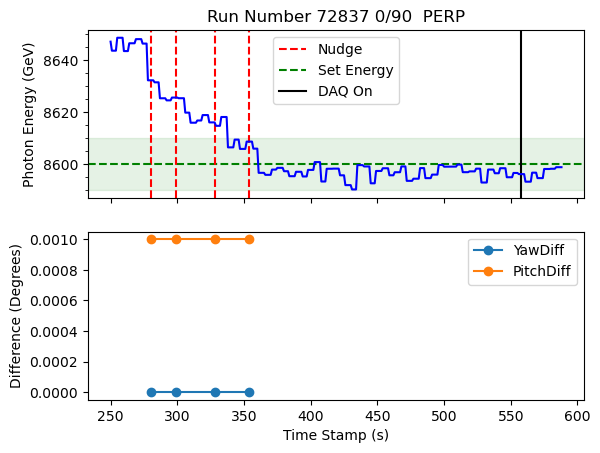

should have  [6] nudges for run 72837
energy change is 35.08800000000156
num_nudges_better is 4.0
energy change per nudge for run  72837 is 8.77200000000039
plotting for run  72848
Nudge number 2 occurs at time 2260.0
daq on at time 1888.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    433
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6559
 0.0       78
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

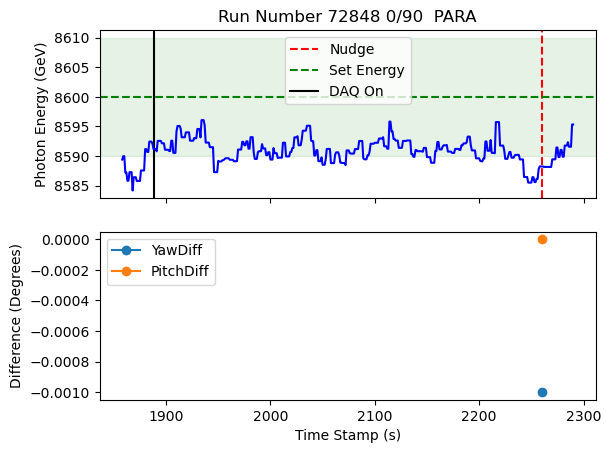

should have  [2] nudges for run 72848
energy change is 3.4087500000005093
num_nudges_better is 1.0
energy change per nudge for run  72848 is 3.4087500000005093
plotting for run  72850
Nudge number 2 occurs at time 141.0
Nudge number 3 occurs at time 162.0
Nudge number 4 occurs at time 179.0
daq on at time 275.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    177
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    4950
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

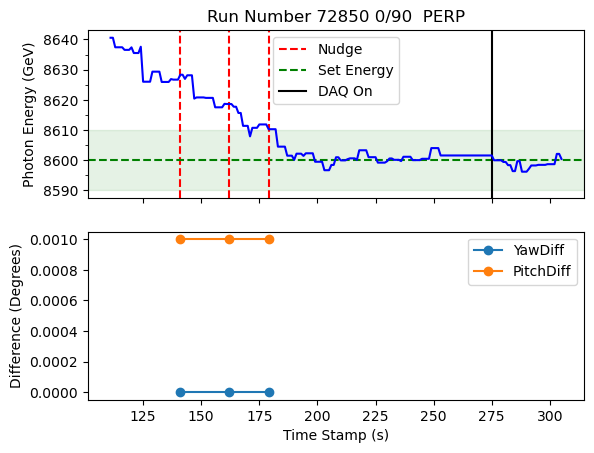

should have  [4] nudges for run 72850
energy change is 28.40333333333183
num_nudges_better is 3.0
energy change per nudge for run  72850 is 9.467777777777277
plotting for run  73058
Nudge number 2 occurs at time 205.0
daq on at time 298.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    145
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6782
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

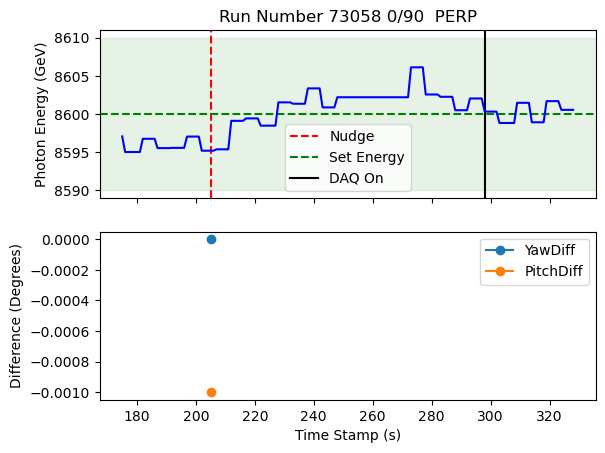

should have  [2] nudges for run 73058
energy change is 4.99750000000131
num_nudges_better is 1.0
energy change per nudge for run  73058 is 4.99750000000131
plotting for run  73160
Nudge number 1 occurs at time 7911.0
Nudge number 2 occurs at time 7921.0
daq on at time 7887.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    95
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    3125
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

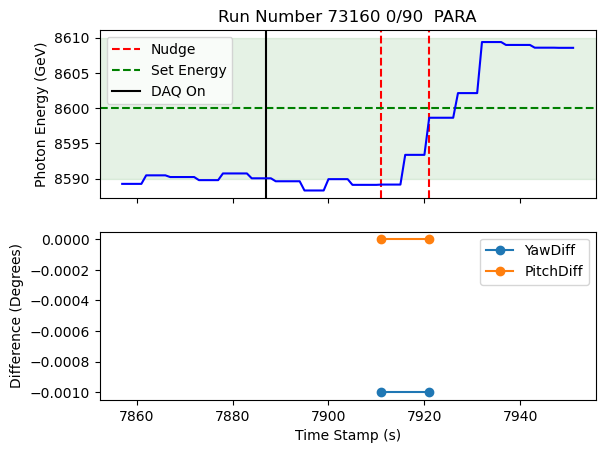

should have  [2] nudges for run 73160
energy change is 19.732500000000073
num_nudges_better is 2.0
energy change per nudge for run  73160 is 9.866250000000036
plotting for run  73184
Nudge number 1 occurs at time 398.0
Nudge number 2 occurs at time 413.0
Nudge number 3 occurs at time 430.0
daq on at time 114.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -10.5
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-10.5    268
Name: count, dtype: int64
roll values are GONI:ROLL
-10.5    6305
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

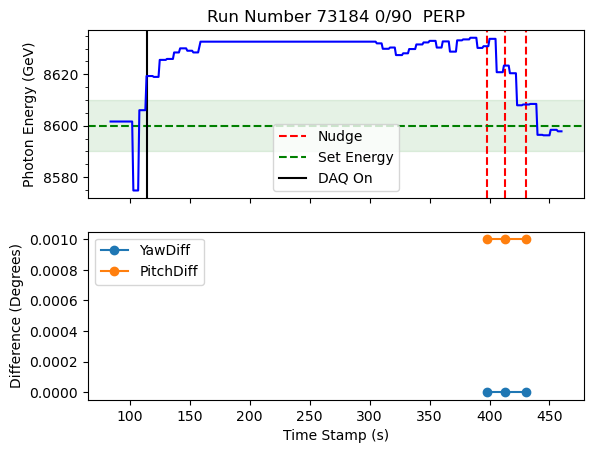

should have  [3] nudges for run 73184
energy change is 33.4333333333343
num_nudges_better is 3.0
energy change per nudge for run  73184 is 11.144444444444767


<Figure size 640x480 with 0 Axes>

In [12]:
number_nudges = []
energy_changes = []

number_nudges_0_90 = []
energy_changes_0_90 = []

number_nudges_45_135 = []
energy_changes_45_135 = []

# run lists determined by manually looking through plots of all runs, output in cell above
runs_45_135 = [72109, 72274, 72297, 72410, 72417, 72420, 72657, 72730, 72742, 72745, 72773, 72816, 73073, 73088, 73188, 73214]
runs_0_90 = [72105, 72142, 72158, 72173, 72187, 72190, 72246, 72266, 72285, 72367, 72406, 72434, 72650, 72703, 72707, 72725, 72739, 72749, 72761, 72780, 72781, 72796, 72824, 72827, 72835, 72837, 72848, 72850, 73039, 73058, 73078, 73130, 73151, 73160, 73184, 73210]
good_run_list = runs_45_135+runs_0_90

# some of the runs listed above have unreliable behavior, ie nudges that do nothing, but aren't labeled as backlash
exclude_runs = [72420, 72730, 72742, 72246, 72761, 72824, 72827, 72835, 723039, 73039, 73078, 73130, 73151, 73210]
for runNum in good_run_list:
    if runNum in exclude_runs:
        continue

    plot_run(df_2020_good,runNum)

    df_tmp = df_2020_good[(df_2020_good['RunNumber']==runNum)&(df_2020_good['NudgeOccurred'])&(~df_2020_good['BacklashNudge'])]
    df_tmp.reset_index(inplace=True)


    print('should have ',df_tmp['TotalNudges_thisRun'].unique(),'nudges for run',runNum)

    # we are looking at the subset of nudges that are not backlash, so none of these methods work for us
    #num_nudges = df_tmp['TotalNudgeSize_thisRun'].unique()[0]/0.001
    #num_nudges_alt = df_tmp['TotalNudges_thisRun'].unique()[0]
    
    # need to loop over nudge sizes, add in quadrature, and divide by 0.001
    num_nudges_fixed = 0
    for nudgeVal in df_tmp['NudgeNumber'].unique():
        df_tmp2 = df_tmp[df_tmp['NudgeNumber']==nudgeVal]
        num_nudges_fixed += (df_tmp['NudgePitchSize'].mode()[0]**2+df_tmp['NudgeYawSize'].mode()[0]**2)**0.5
    num_nudges_fixed = round(num_nudges_fixed/0.001,1)



    # look at energy at first nudge, compare to avg of last 5 energies
    nudge_list = df_tmp['NudgeNumber'].unique()
    df_first_nudge = df_tmp[df_tmp['NudgeNumber']==min(nudge_list)]
    df_first_nudge.reset_index()
    initial_energy = df_first_nudge.loc[0,'CBREM:ENERGY']


    # look 15-30 seconds after last nudge, take avg time
    df_last_nudge = df_tmp[df_tmp['NudgeNumber']==max(nudge_list)]
    df_last_nudge.reset_index(inplace=True)

    last_nudge_time = df_last_nudge.loc[0,'TimeStamp']

    df_end = df_2020_good[(df_2020_good['RunNumber']==runNum)&(df_2020_good['TimeStamp']>=(last_nudge_time+15))&(df_2020_good['TimeStamp']<=(last_nudge_time+30))]
    end_energies = df_end['CBREM:ENERGY'].unique()

    final_energy = np.mean(end_energies)

    energy_change = abs(final_energy - initial_energy)

    energy_changes.append(energy_change)
    number_nudges.append(num_nudges_fixed)

    print('energy change is',energy_change)
    print('num_nudges_better is',num_nudges_fixed)
    print('energy change per nudge for run ',runNum,'is',energy_change/num_nudges_fixed)

    if runNum in runs_45_135:
        energy_changes_45_135.append(energy_change)
        number_nudges_45_135.append(num_nudges_fixed)
    else:
        energy_changes_0_90.append(energy_change)
        number_nudges_0_90.append(num_nudges_fixed)


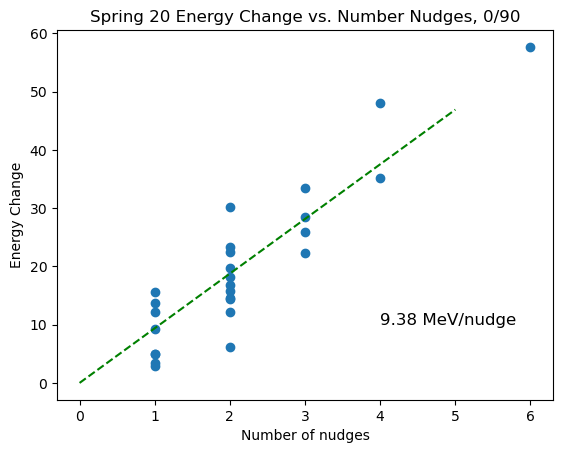

In [15]:
plt.scatter(number_nudges_0_90,energy_changes_0_90)
plt.title("Spring 20 Energy Change vs. Number Nudges, 0/90")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,50)
plt.ylabel("Energy Change")

from sklearn.linear_model import LinearRegression 
lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_0_90).reshape(-1,1)
y = energy_changes_0_90
lr.fit(X,y)

x_vals = np.array(np.arange(0,6,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_0_90_Spring20.pdf')

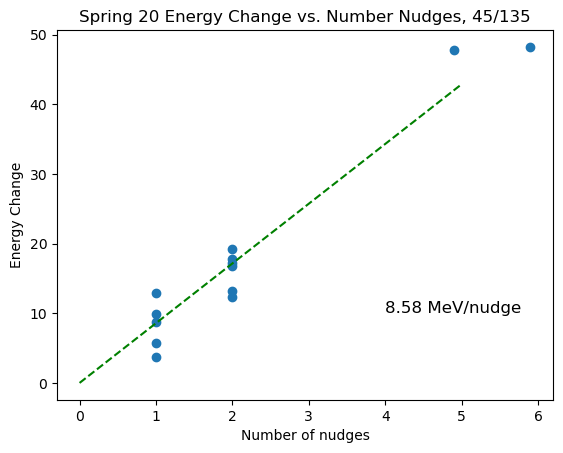

In [14]:
plt.scatter(number_nudges_45_135,energy_changes_45_135)
plt.title("Spring 20 Energy Change vs. Number Nudges, 45/135")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,30)
plt.ylabel("Energy Change")

lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_45_135).reshape(-1,1)
y = energy_changes_45_135
lr.fit(X,y)

x_vals = np.array(np.arange(0,6,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_45_135_Spring20.pdf')

plotting for run  120313.0
Nudge number 1 occurs at time 2522.0
daq on at time 152.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    1975
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6114
Name: count, dtype: int64


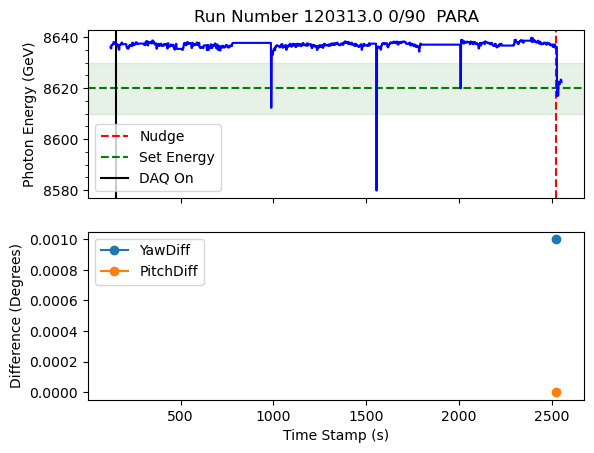

plotting for run  120315.0
daq on at time 1976.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    1735
 162.0      71
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    8205
 162.0      71
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

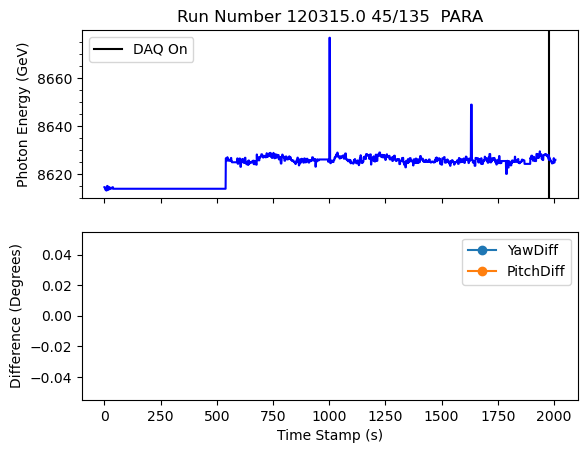

plotting for run  120322.0
daq on at time 640.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    305
 162.0    187
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5988
 162.0     187
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

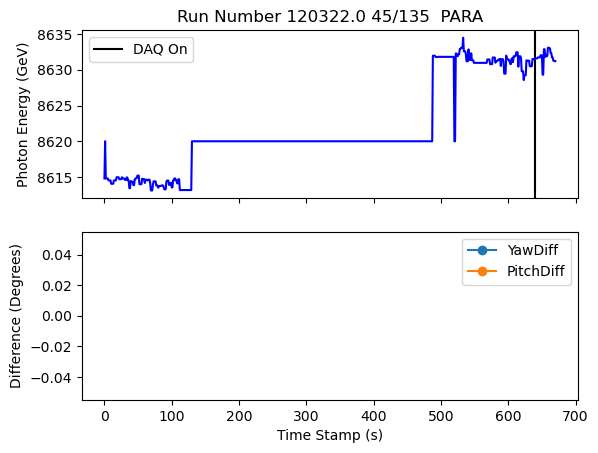

plotting for run  120353.0
Nudge number 1 occurs at time 140.0
daq on at time 587.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    255
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6849
 162.0      78
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

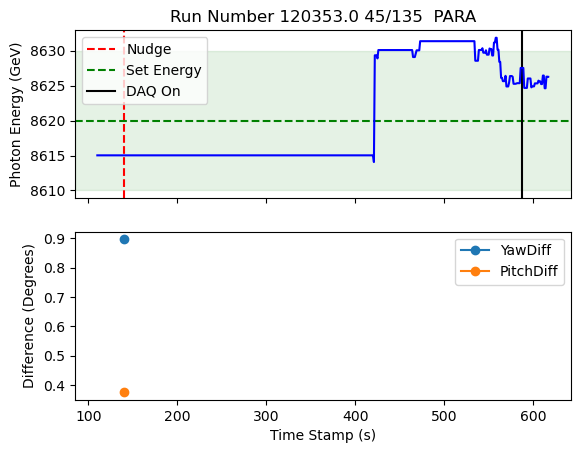

plotting for run  120372.0
daq on at time 1539.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    774
 162.0    135
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5466
 162.0     135
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

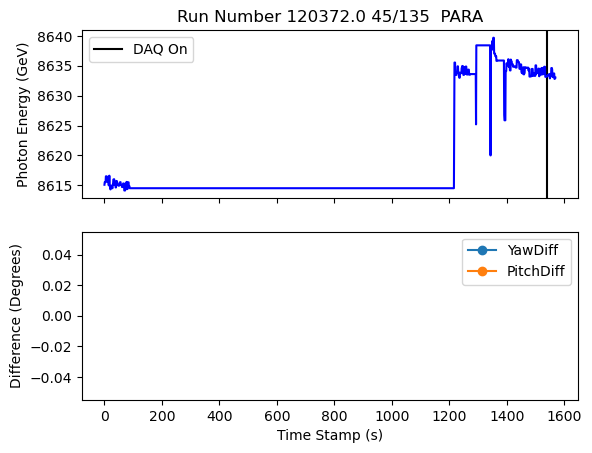

plotting for run  120398.0
daq on at time 1403.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    673
 162.0    151
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6488
 162.0     151
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

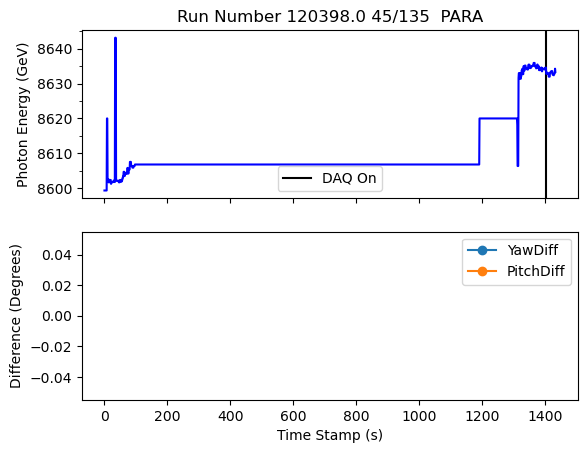

plotting for run  120404.0
daq on at time 896.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    554
0.0       69
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3489
0.0        69
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

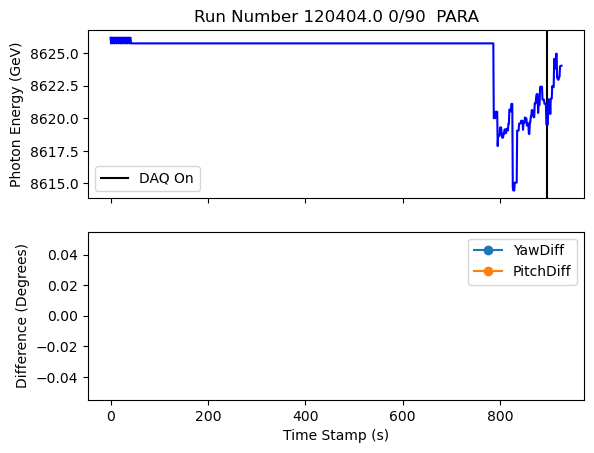

plotting for run  120406.0
Nudge number 1 occurs at time 2797.0
Nudge number 2 occurs at time 2804.0
Nudge number 3 occurs at time 2808.0
Nudge number 4 occurs at time 2812.0
Nudge number 5 occurs at time 2816.0
Nudge number 8 occurs at time 2852.0
Nudge number 9 occurs at time 2865.0
Nudge number 10 occurs at time 2880.0
Nudge number 11 occurs at time 3003.0
daq on at time 2207.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    829
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    4048
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

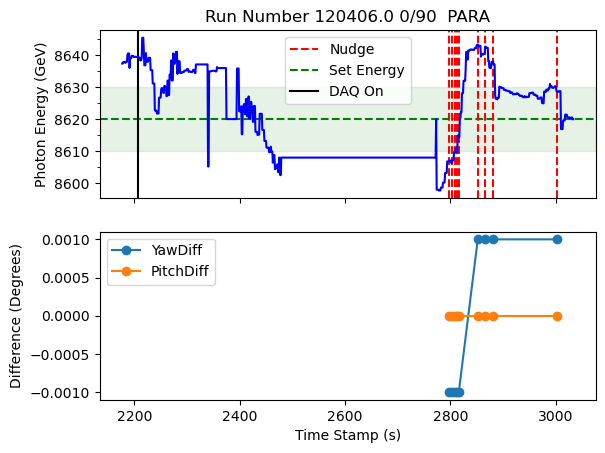

plotting for run  120411.0
daq on at time 548.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    355
 162.0    103
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5883
 162.0     103
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

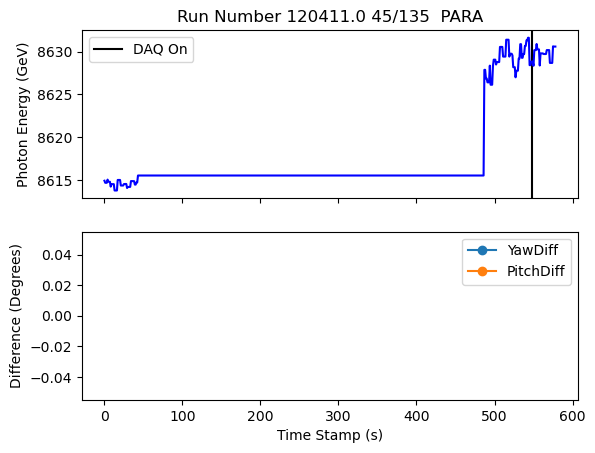

plotting for run  120412.0
Nudge number 1 occurs at time 117.0
daq on at time 97.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    81
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5823
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

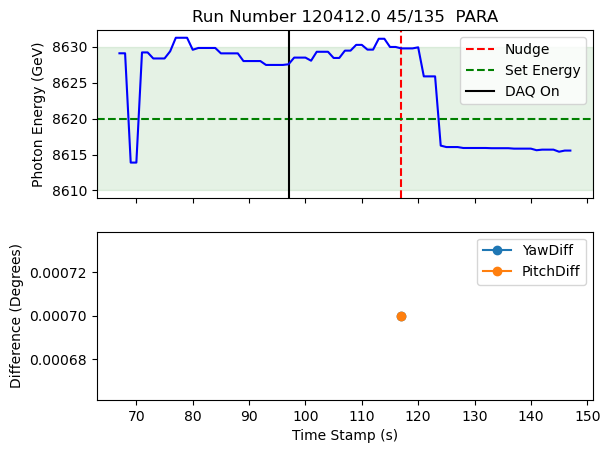

plotting for run  120420.0
Nudge number 2 occurs at time 373.0
Nudge number 3 occurs at time 388.0
daq on at time 289.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    157
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3152
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

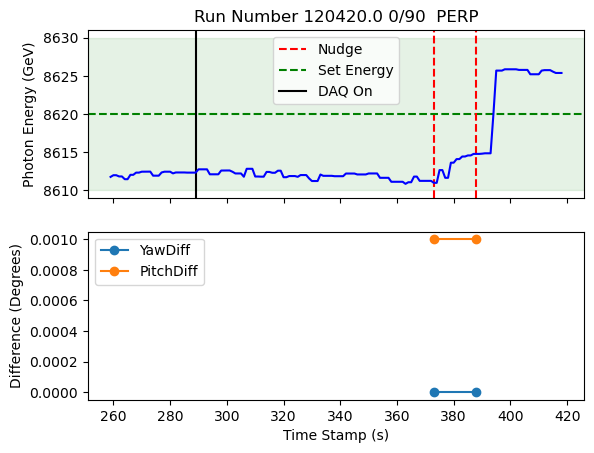

plotting for run  120437.0
daq on at time 726.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    277
 162.0    167
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6000
 162.0     167
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

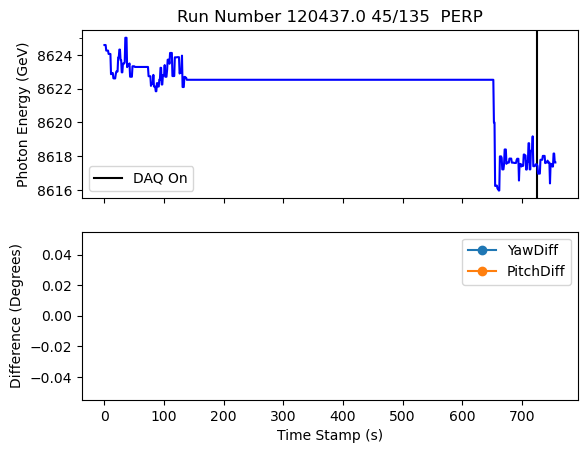

plotting for run  120451.0
daq on at time 571.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    323
 0.0       21
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6504
 0.0        21
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

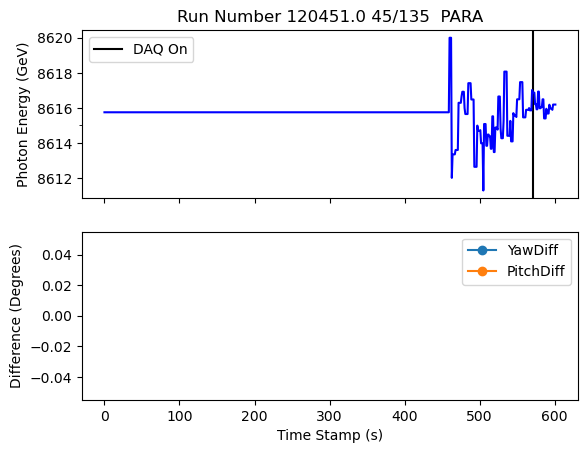

plotting for run  120470.0
daq on at time 1440.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    173
 0.0       19
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    487
 0.0       19
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

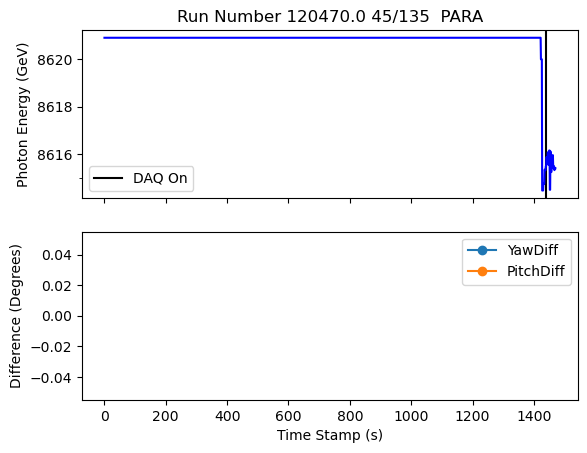

plotting for run  120536.0
daq on at time 602.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    393
 162.0     92
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5442
 162.0      92
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

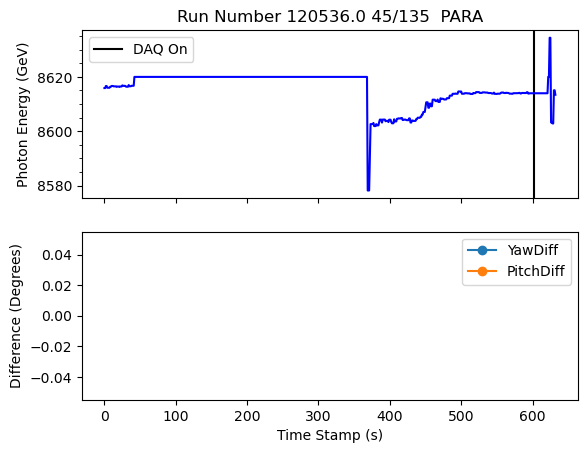

plotting for run  120541.0
daq on at time 852.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    350
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3155
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

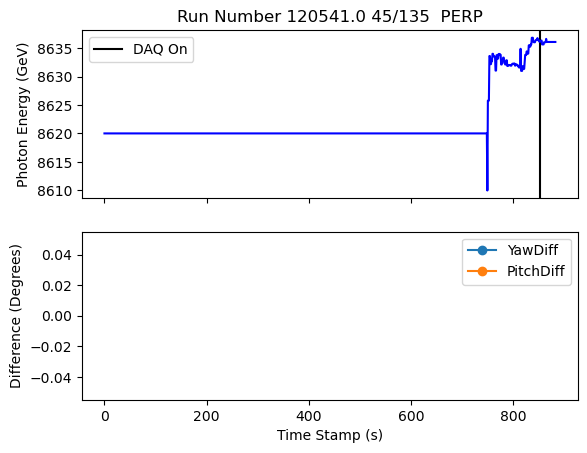

plotting for run  120562.0
daq on at time 535.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    218
 162.0     60
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    1986
 162.0      60
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

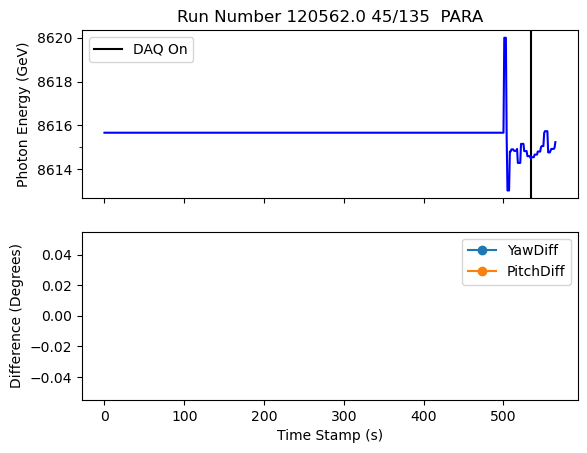

plotting for run  120566.0
daq on at time 276.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    230
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    457
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

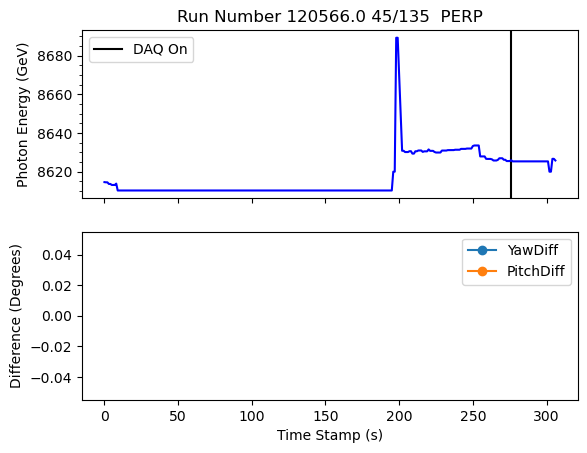

plotting for run  120606.0
daq on at time 388.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    164
 162.0     65
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6047
 162.0      65
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

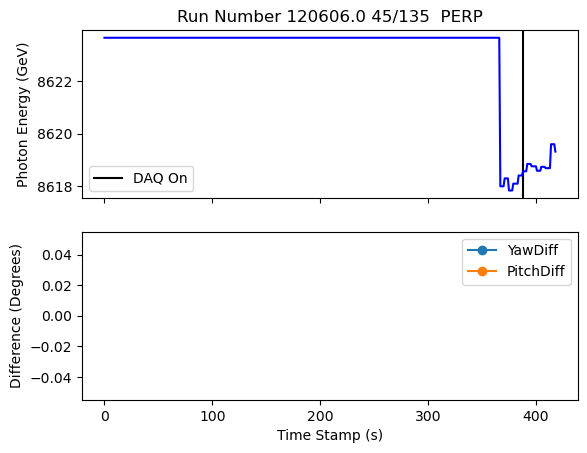

plotting for run  120643.0
Nudge number 1 occurs at time 576.0
daq on at time 955.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    221
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3229
 162.0     200
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

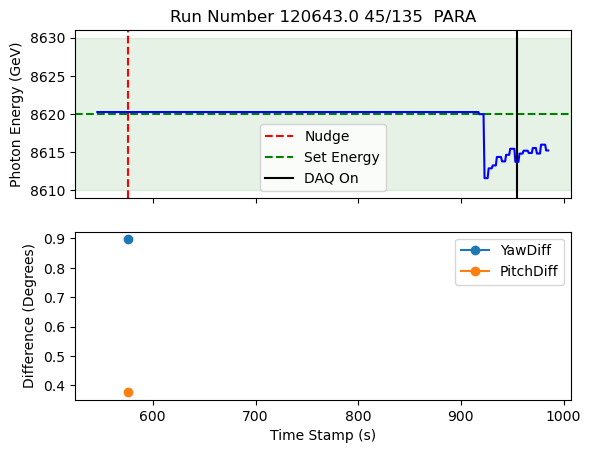

plotting for run  120663.0
daq on at time 630.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    313
 162.0    152
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    2732
 162.0     152
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

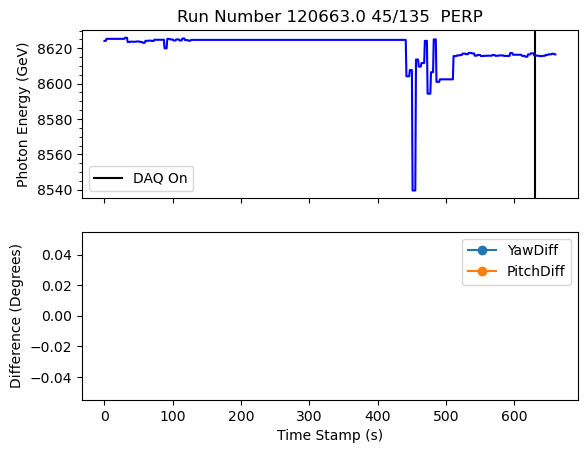

plotting for run  120687.0
daq on at time 598.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    306
 162.0    145
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6158
 162.0     145
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

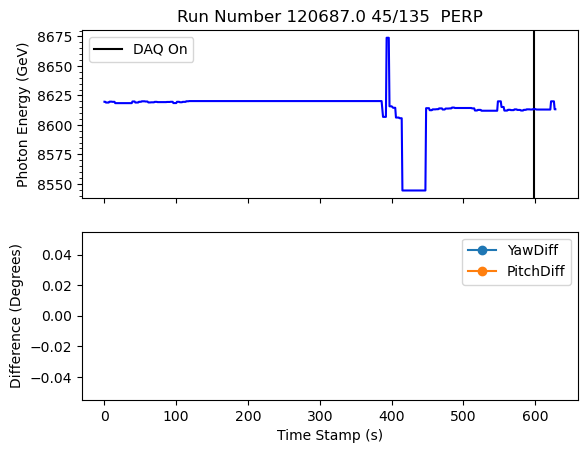

plotting for run  120710.0
Nudge number 4 occurs at time 56246.0
Nudge number 5 occurs at time 56260.0
Nudge number 6 occurs at time 56271.0
daq on at time 7545.0
[1. 0.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    12236
 0.0       4126
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    14583
 0.0       4126
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

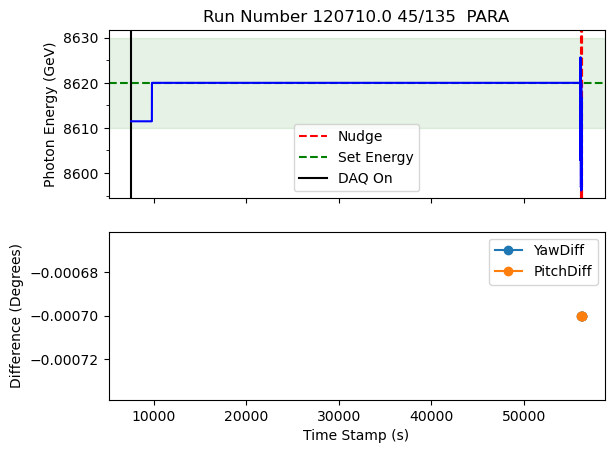

plotting for run  120722.0
daq on at time 479.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    503
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6027
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

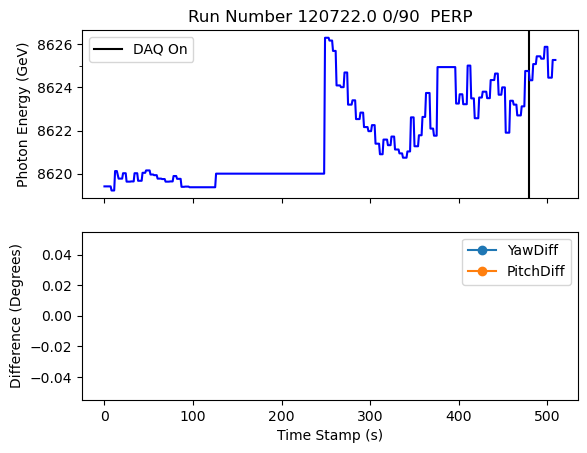

plotting for run  120724.0
daq on at time 479.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    168
 162.0     86
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5641
 162.0      86
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

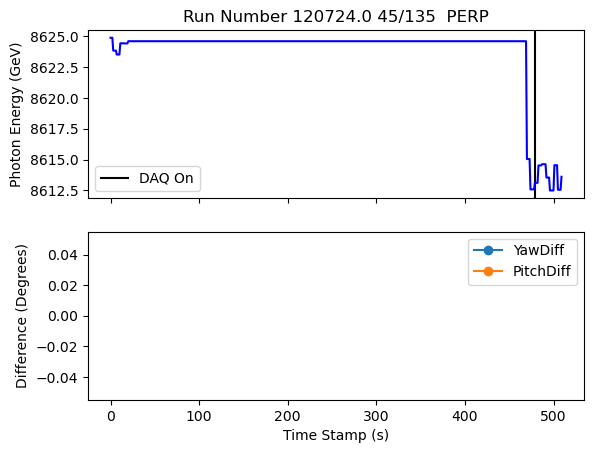

plotting for run  120740.0
Nudge number 11 occurs at time 1621.0
Nudge number 18 occurs at time 1984.0
Nudge number 19 occurs at time 2001.0
Nudge number 20 occurs at time 2017.0
Nudge number 21 occurs at time 2032.0
Nudge number 22 occurs at time 2045.0
Nudge number 23 occurs at time 2060.0
Nudge number 24 occurs at time 2079.0
daq on at time 2457.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    850
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    8525
 162.0      94
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

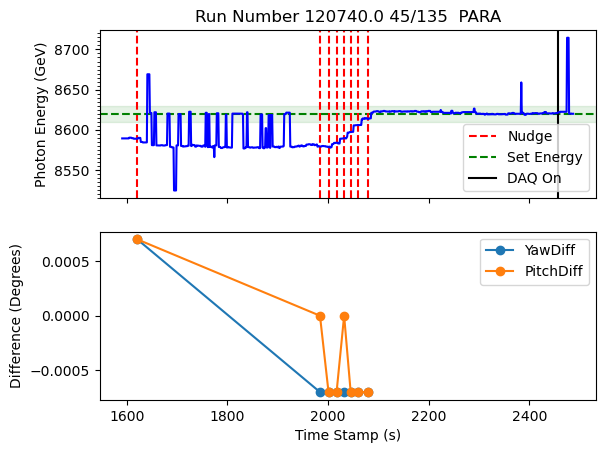

plotting for run  120753.0
Nudge number 2 occurs at time 571.0
Nudge number 3 occurs at time 587.0
Nudge number 4 occurs at time 669.0
Nudge number 8 occurs at time 785.0
Nudge number 9 occurs at time 806.0
daq on at time 1068.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    551
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    7203
 162.0     100
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

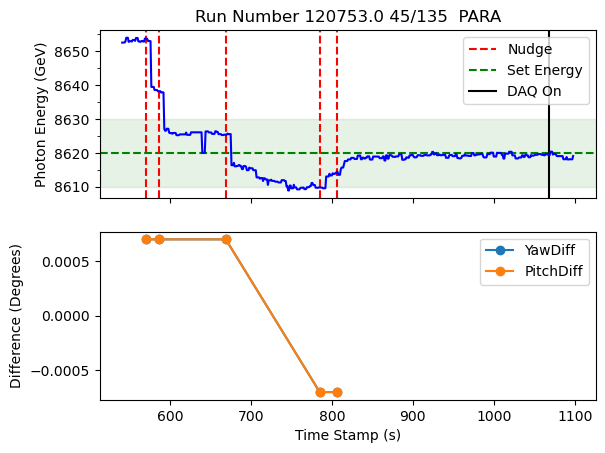

plotting for run  120762.0
daq on at time 751.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    354
0.0       58
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5980
0.0        58
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

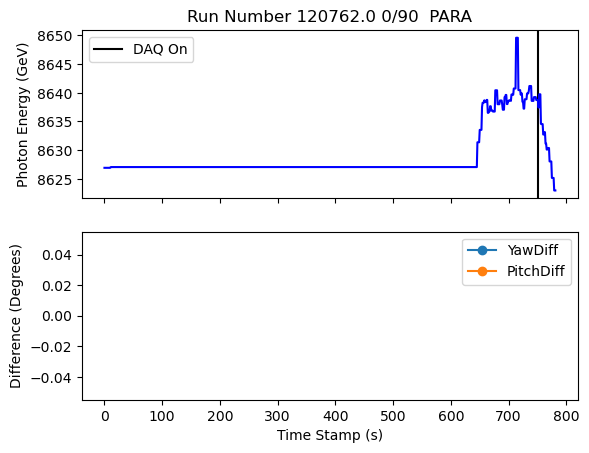

plotting for run  120768.0
Nudge number 5 occurs at time 746.0
Nudge number 6 occurs at time 762.0
Nudge number 7 occurs at time 776.0
Nudge number 8 occurs at time 932.0
daq on at time 1115.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    409
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    7143
 162.0     195
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

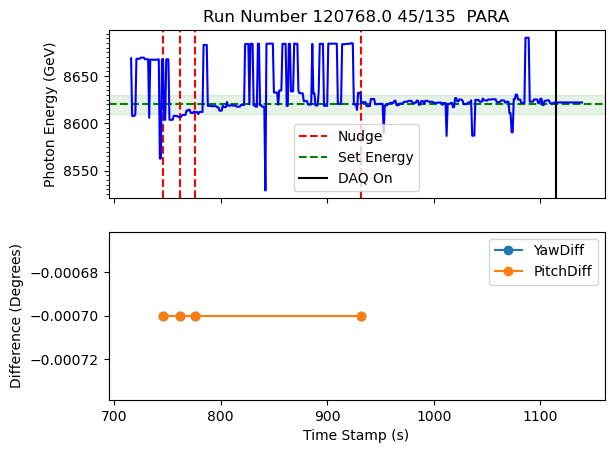

plotting for run  120782.0
daq on at time 441.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    226
 162.0     70
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3869
 162.0      70
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

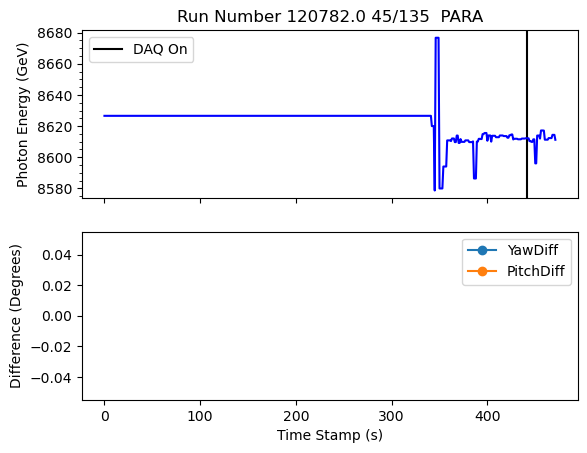

plotting for run  120784.0
Nudge number 1 occurs at time 3454.0
Nudge number 2 occurs at time 3473.0
Nudge number 3 occurs at time 3484.0
Nudge number 4 occurs at time 3497.0
daq on at time 3581.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    185
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    2706
 0.0      1854
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

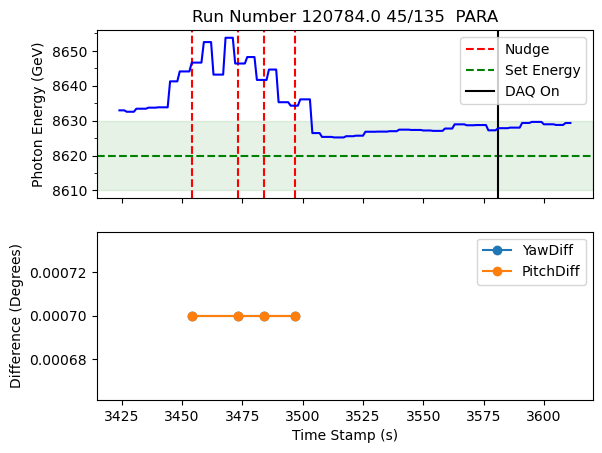

plotting for run  120787.0
daq on at time 459.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    456
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6970
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

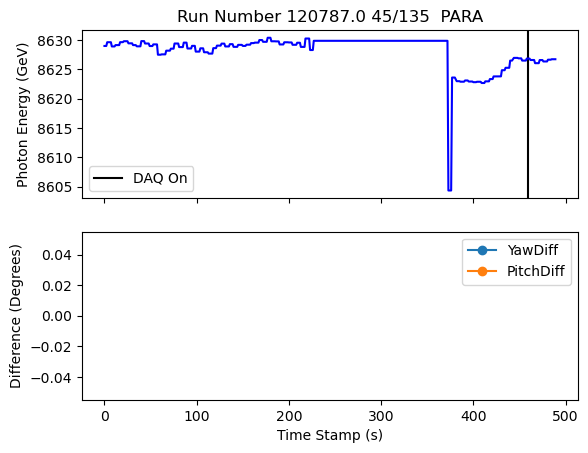

plotting for run  120798.0
daq on at time 933.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 162.0    476
-153.0    243
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5317
 162.0     476
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

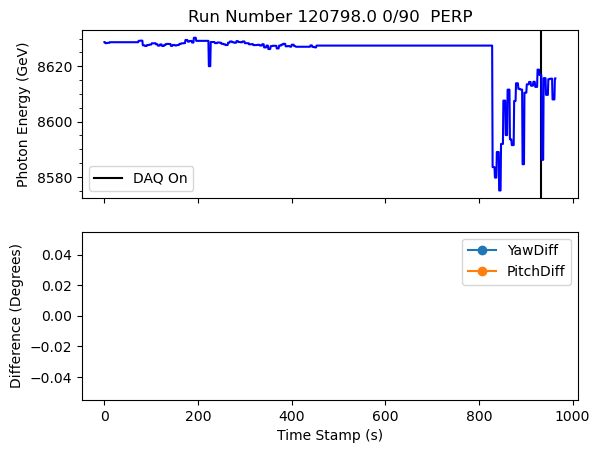

plotting for run  120801.0
daq on at time 11956.0
[0. 1.]
plane_values are 0    0.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    0.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 0.0      4645
-153.0     357
Name: count, dtype: int64
roll values are GONI:ROLL
 0.0      4645
-153.0    3303
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

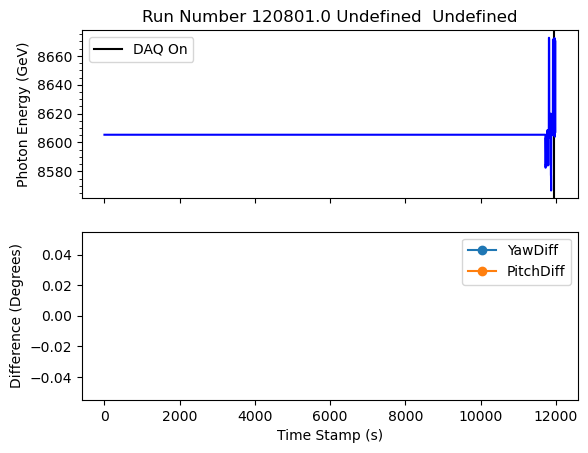

plotting for run  120813.0
daq on at time 831.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    272
 162.0    116
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    437
 162.0    116
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

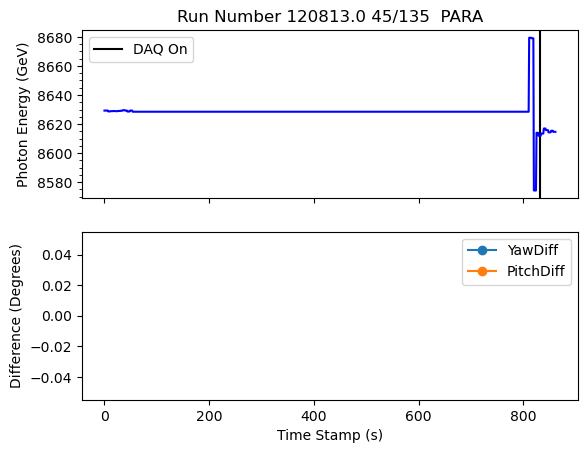

plotting for run  120817.0
Nudge number 1 occurs at time 5583.0
Nudge number 2 occurs at time 5593.0
Nudge number 3 occurs at time 5597.0
Nudge number 4 occurs at time 5603.0
Nudge number 5 occurs at time 5608.0
daq on at time 2618.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    2656
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6694
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

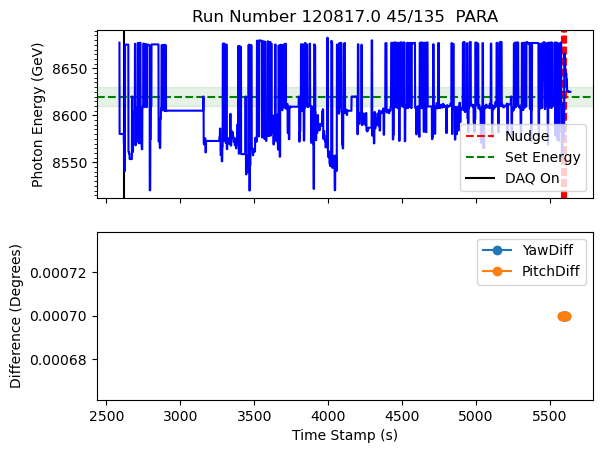

plotting for run  120821.0
daq on at time 92.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    122
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3125
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

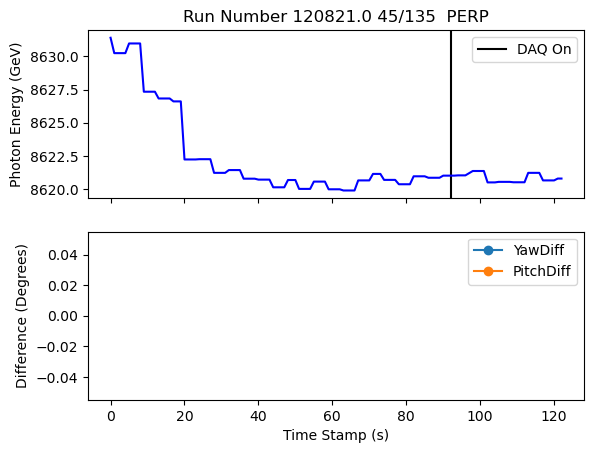

plotting for run  120826.0
Nudge number 2 occurs at time 34268.0
Nudge number 3 occurs at time 34277.0
Nudge number 4 occurs at time 34288.0
Nudge number 5 occurs at time 34289.0
Nudge number 6 occurs at time 34297.0
Nudge number 7 occurs at time 34298.0
Nudge number 8 occurs at time 34299.0
Nudge number 9 occurs at time 36366.0
daq on at time 88.0
[2. 0.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    8986
 0.0        65
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    13337
 0.0       3167
 5.0          2
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

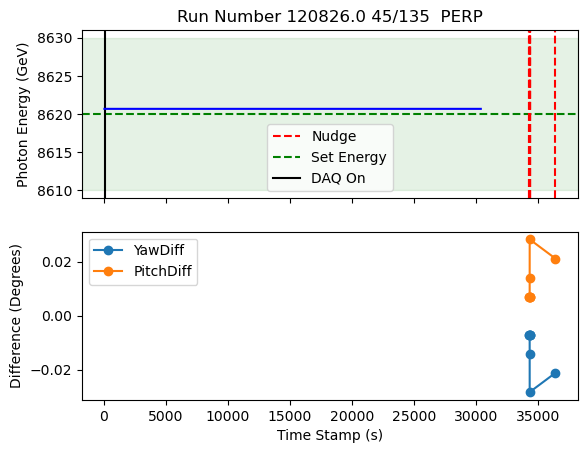

plotting for run  120827.0
Nudge number 2 occurs at time 4207.0
Nudge number 3 occurs at time 4220.0
Nudge number 4 occurs at time 4242.0
Nudge number 5 occurs at time 4260.0
Nudge number 6 occurs at time 4264.0
Nudge number 7 occurs at time 4275.0
Nudge number 8 occurs at time 4288.0
Nudge number 9 occurs at time 4301.0
Nudge number 10 occurs at time 4306.0
Nudge number 11 occurs at time 4358.0
Nudge number 12 occurs at time 4379.0
Nudge number 13 occurs at time 4382.0
Nudge number 14 occurs at time 4383.0
Nudge number 15 occurs at time 4387.0
Nudge number 17 occurs at time 4569.0
Nudge number 18 occurs at time 4586.0
Nudge number 19 occurs at time 4595.0
Nudge number 20 occurs at time 4602.0
Nudge number 21 occurs at time 4607.0
Nudge number 22 occurs at time 4613.0
Nudge number 23 occurs at time 4619.0
Nudge number 24 occurs at time 4624.0
Nudge number 25 occurs at time 4628.0
Nudge number 26 occurs at time 4634.0
Nudge number 27 occurs at time 4641.0
Nudge number 28 occurs at time 

<Figure size 640x480 with 0 Axes>

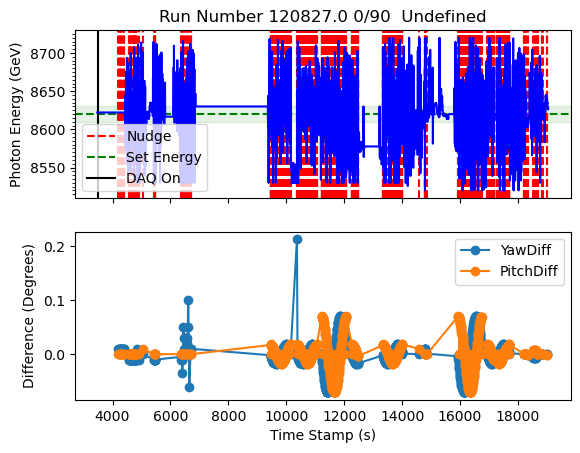

plotting for run  120828.0
Nudge number 2 occurs at time 281.0
daq on at time 325.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    101
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5550
 0.0        56
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

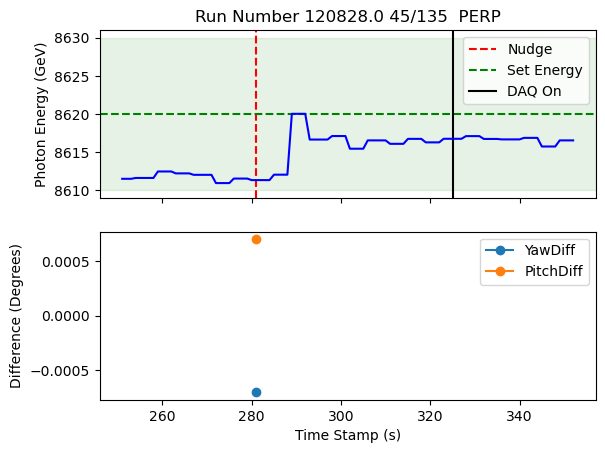

plotting for run  120837.0
Nudge number 1 occurs at time 146.0
Nudge number 2 occurs at time 307.0
Nudge number 3 occurs at time 310.0
Nudge number 7 occurs at time 494.0
Nudge number 8 occurs at time 518.0
daq on at time 540.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    362
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6797
 162.0      70
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

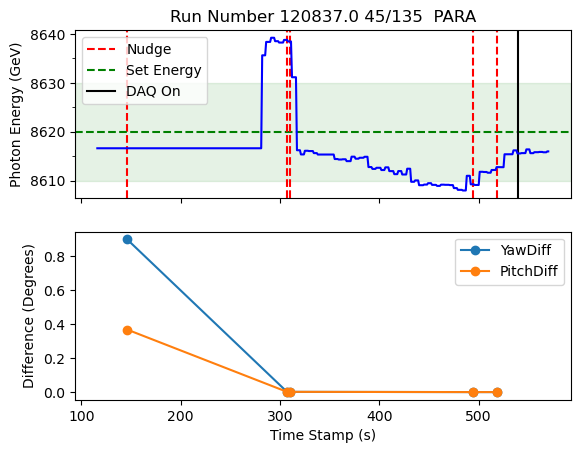

plotting for run  120839.0
Nudge number 1 occurs at time 121.0
daq on at time 295.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    212
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5938
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

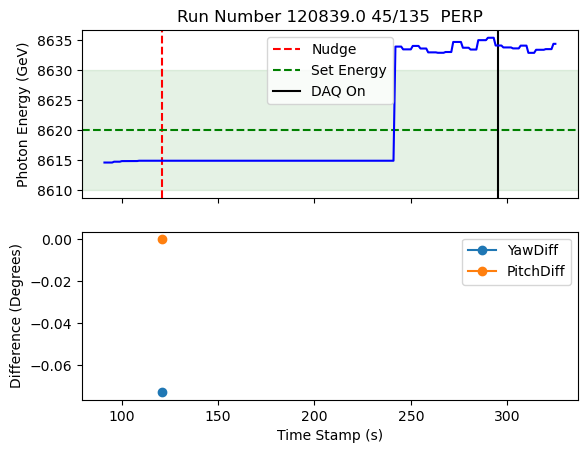

plotting for run  120843.0
daq on at time 605.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    310
0.0       31
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    4359
0.0        31
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

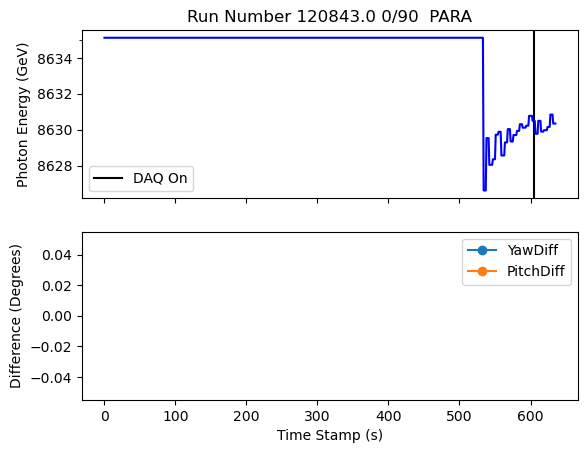

plotting for run  120848.0
Nudge number 2 occurs at time 177.0
Nudge number 3 occurs at time 197.0
Nudge number 4 occurs at time 210.0
daq on at time 286.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    169
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5695
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

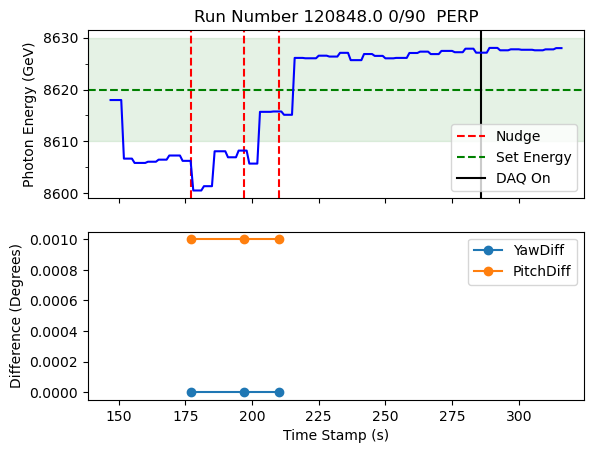

plotting for run  120850.0
Nudge number 2 occurs at time 367.0
Nudge number 3 occurs at time 370.0
Nudge number 7 occurs at time 457.0
Nudge number 8 occurs at time 477.0
daq on at time 503.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    195
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5742
 162.0      67
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

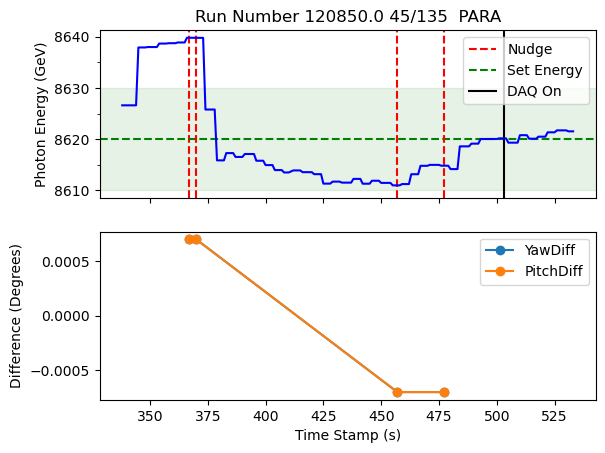

plotting for run  120852.0
daq on at time 165.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    194
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5340
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

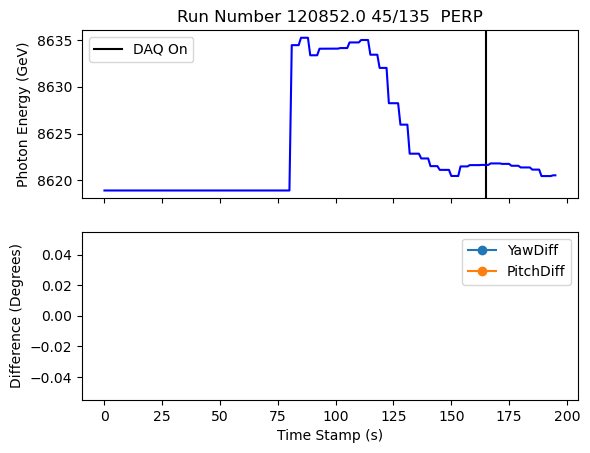

plotting for run  120857.0
Nudge number 2 occurs at time 251.0
Nudge number 3 occurs at time 291.0
Nudge number 4 occurs at time 461.0
daq on at time 572.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    314
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3307
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

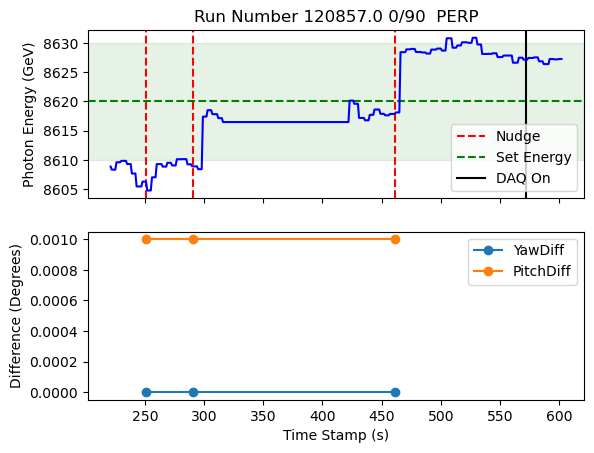

plotting for run  120885.0
daq on at time 2539.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    304
 162.0    187
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6157
 162.0     187
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

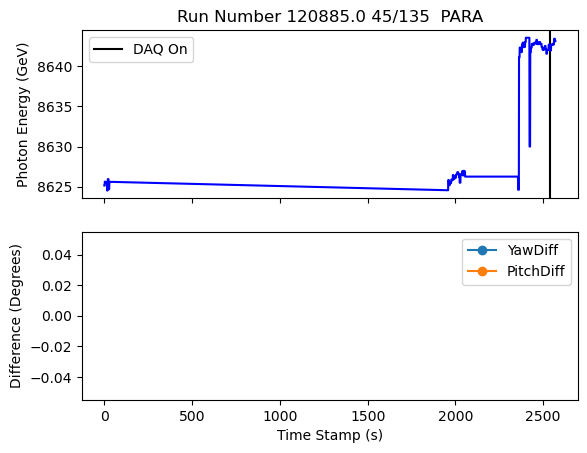

plotting for run  120886.0
Nudge number 1 occurs at time 1272.0
Nudge number 2 occurs at time 1286.0
Nudge number 6 occurs at time 1361.0
Nudge number 7 occurs at time 1382.0
daq on at time 1464.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    244
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6627
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

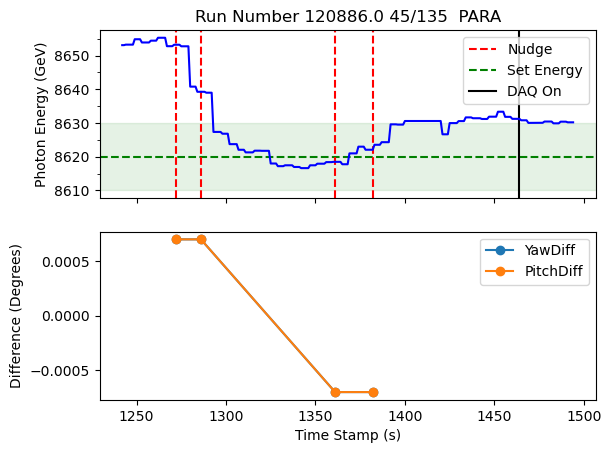

plotting for run  120894.0
Nudge number 2 occurs at time 1539.0
Nudge number 3 occurs at time 1555.0
daq on at time 1115.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    407
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6595
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

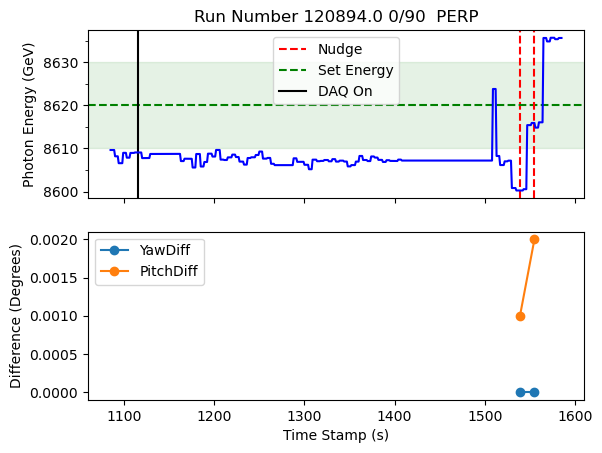

plotting for run  120916.0
daq on at time 403.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    187
 0.0      110
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5576
 0.0       110
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

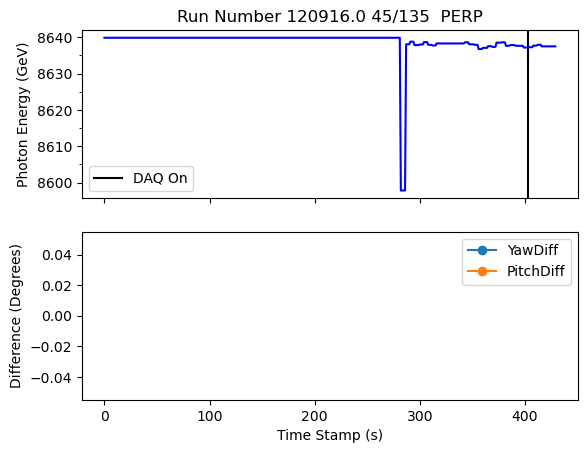

plotting for run  120930.0
daq on at time 0.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    2
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    509
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

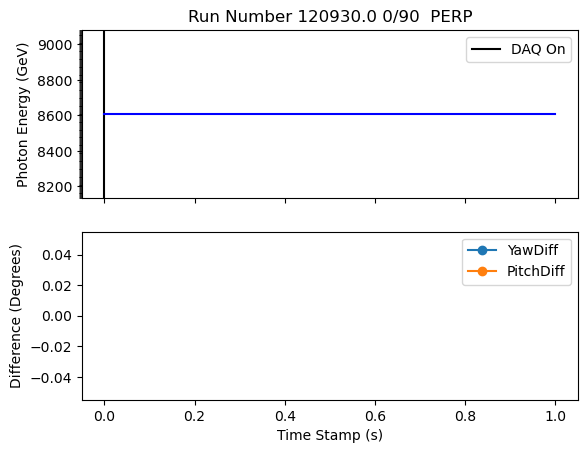

plotting for run  120931.0
Nudge number 1 occurs at time 651.0
Nudge number 2 occurs at time 1160.0
Nudge number 3 occurs at time 1170.0
daq on at time 1191.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    275
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    2132
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

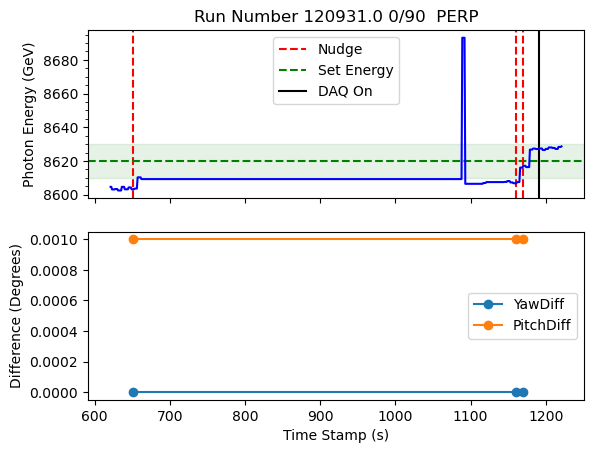

plotting for run  120936.0
daq on at time 550.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    256
 162.0    168
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5689
 162.0     168
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

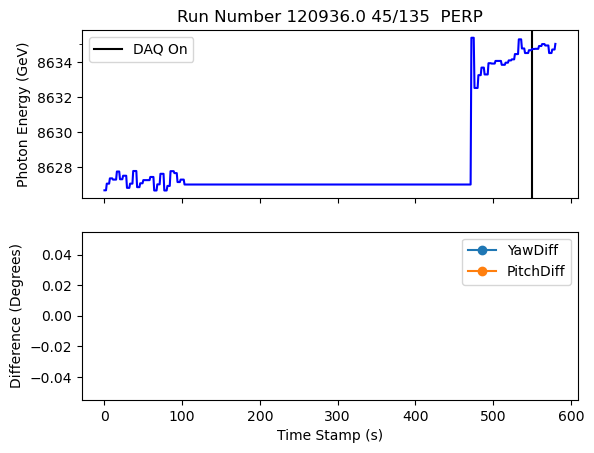

plotting for run  120938.0
daq on at time 252.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    263
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5624
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

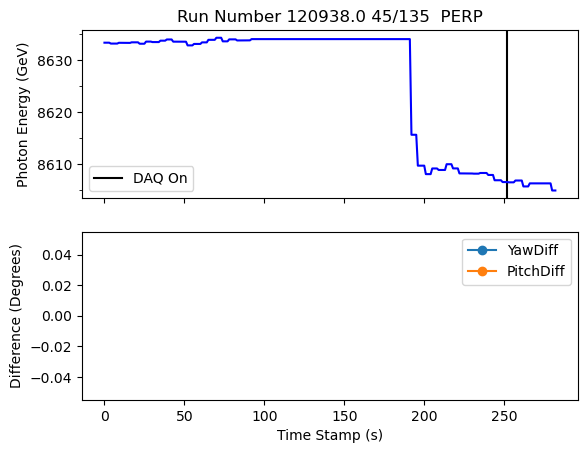

plotting for run  120989.0
daq on at time 713.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 162.0    431
-153.0    200
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6275
 162.0     431
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

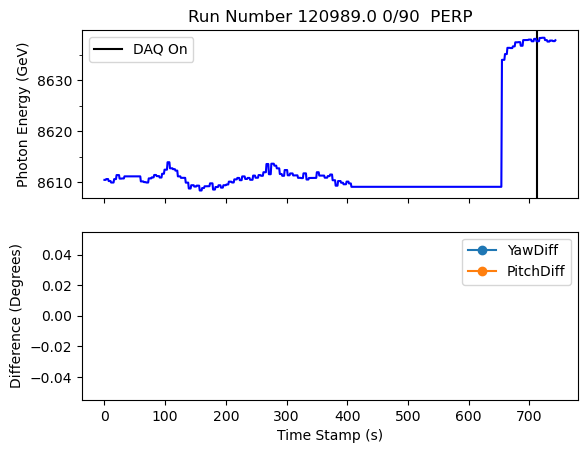

plotting for run  120991.0
daq on at time 451.0
[1. 0. 2.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    370
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5062
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

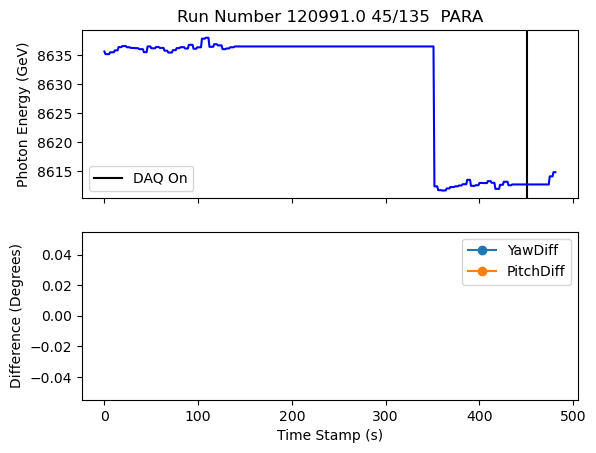

plotting for run  120998.0
Nudge number 3 occurs at time 336.0
Nudge number 6 occurs at time 362.0
Nudge number 7 occurs at time 365.0
Nudge number 8 occurs at time 371.0
Nudge number 11 occurs at time 447.0
daq on at time 39.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    455
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5146
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

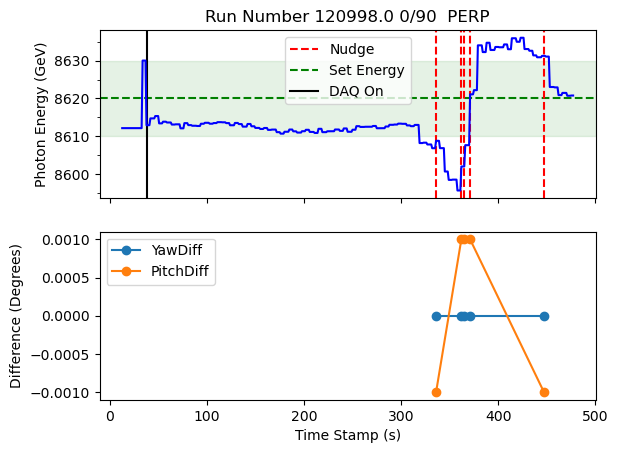

plotting for run  121006.0
daq on at time 425.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    418
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5885
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

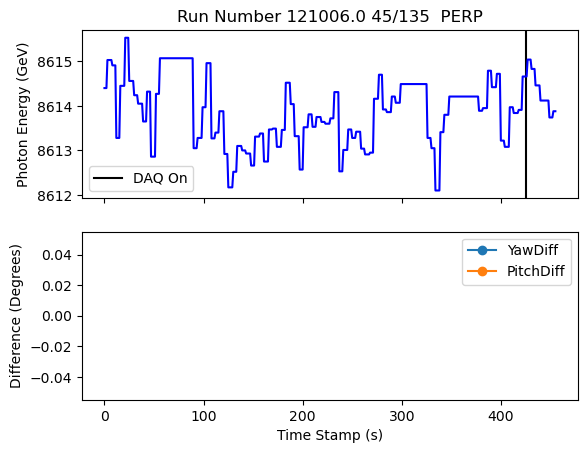

plotting for run  121009.0
Nudge number 1 occurs at time 3115.0
Nudge number 2 occurs at time 3157.0
Nudge number 3 occurs at time 3175.0
Nudge number 4 occurs at time 3251.0
daq on at time 3195.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    193
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    2777
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

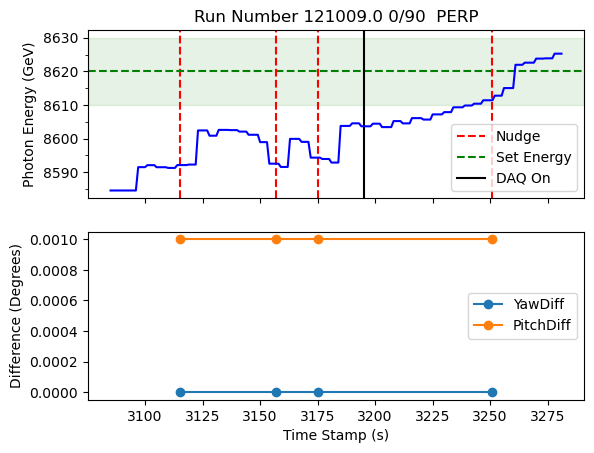

plotting for run  121025.0
Nudge number 1 occurs at time 3242.0
Nudge number 2 occurs at time 3255.0
daq on at time 2938.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    354
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3020
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

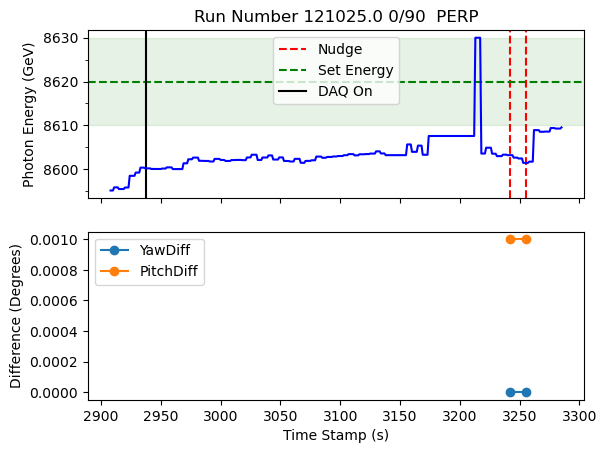

plotting for run  121029.0
Nudge number 5 occurs at time 684.0
Nudge number 6 occurs at time 693.0
daq on at time 576.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    113
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5931
 162.0      77
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

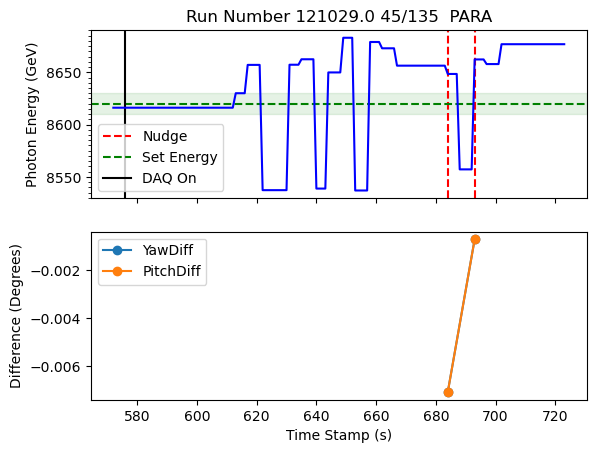

plotting for run  121036.0
Nudge number 2 occurs at time 1793.0
Nudge number 3 occurs at time 1801.0
daq on at time 1648.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    214
Name: count, dtype: int64
roll values are GONI:ROLL
 162.0    2238
-153.0     542
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

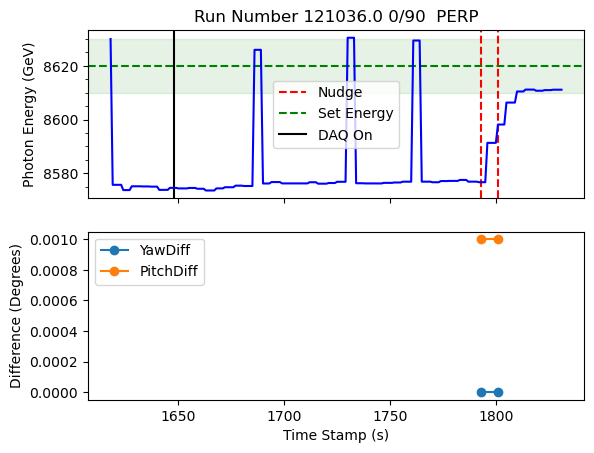

plotting for run  121051.0
Nudge number 2 occurs at time 696.0
Nudge number 3 occurs at time 1448.0
daq on at time 177.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    1290
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5966
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

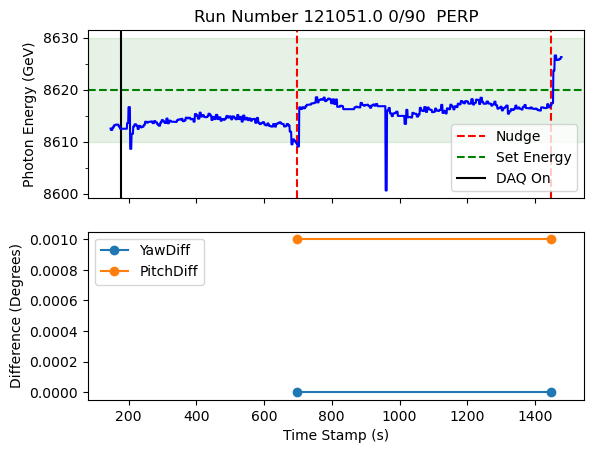

plotting for run  121053.0
Nudge number 2 occurs at time 763.0
Nudge number 5 occurs at time 947.0
Nudge number 6 occurs at time 1012.0
Nudge number 7 occurs at time 1083.0
daq on at time 530.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    609
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5779
 162.0     108
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

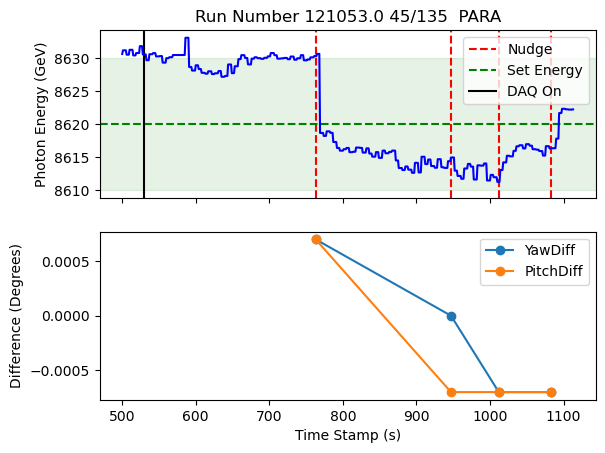

plotting for run  121062.0
Nudge number 1 occurs at time 160.0
daq on at time 287.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    172
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6133
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

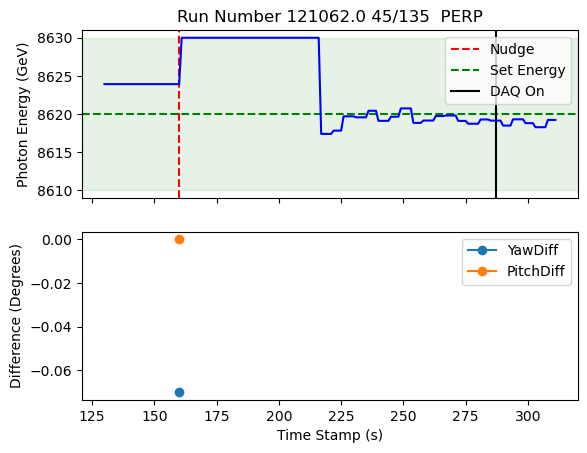

plotting for run  121068.0
Nudge number 2 occurs at time 281.0
Nudge number 3 occurs at time 286.0
Nudge number 4 occurs at time 291.0
daq on at time 139.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    192
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6100
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

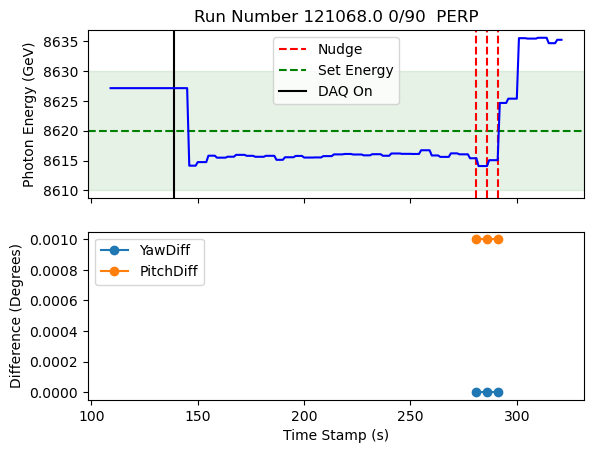

plotting for run  121070.0
daq on at time 194.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    96
 162.0    52
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5633
 162.0      52
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

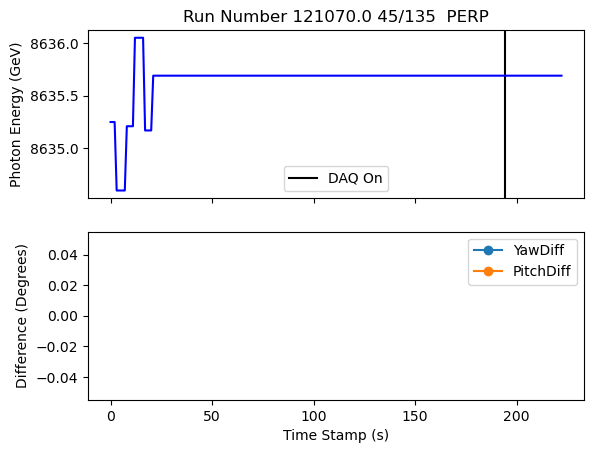

plotting for run  121084.0
daq on at time 1366.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    961
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6940
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

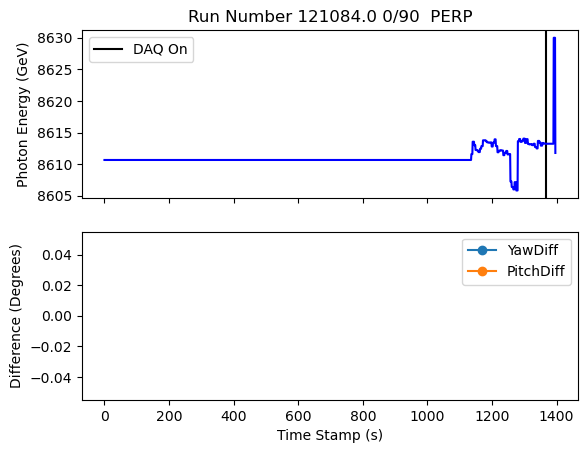

plotting for run  121086.0
daq on at time 392.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    196
 162.0    155
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3559
 162.0     155
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

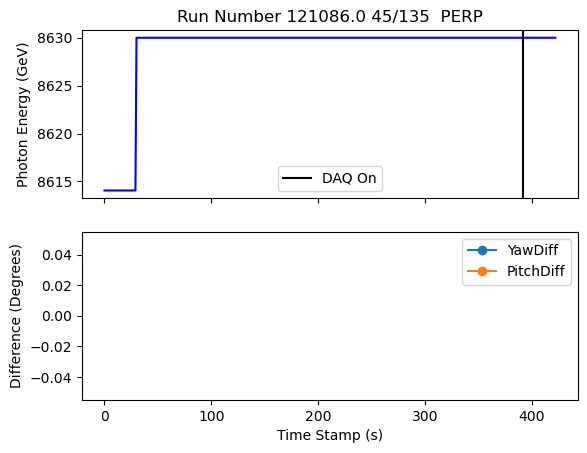

plotting for run  121097.0
Nudge number 2 occurs at time 435.0
daq on at time 467.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    93
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6010
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

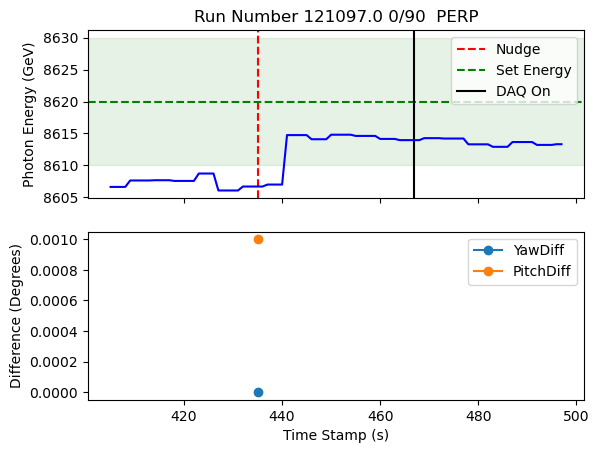

plotting for run  121099.0
Nudge number 2 occurs at time 650.0
daq on at time 817.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    214
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5791
 162.0     118
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

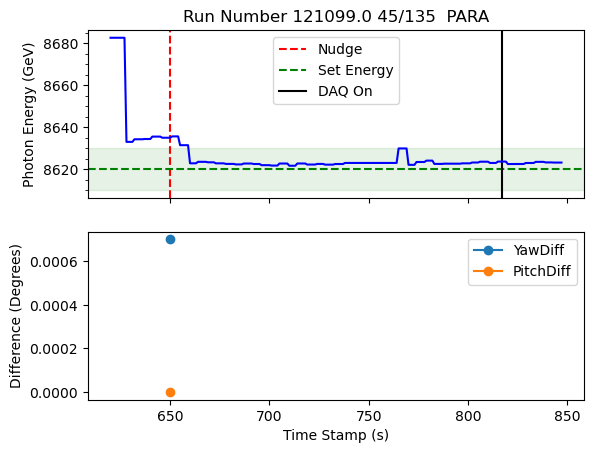

plotting for run  121102.0
Nudge number 4 occurs at time 4207.0
Nudge number 5 occurs at time 4217.0
Nudge number 7 occurs at time 4441.0
Nudge number 8 occurs at time 4452.0
Nudge number 9 occurs at time 4459.0
Nudge number 10 occurs at time 4523.0
Nudge number 14 occurs at time 4748.0
Nudge number 15 occurs at time 5357.0
Nudge number 16 occurs at time 5391.0
Nudge number 17 occurs at time 5769.0
Nudge number 18 occurs at time 5784.0
Nudge number 19 occurs at time 5798.0
Nudge number 20 occurs at time 5815.0
Nudge number 21 occurs at time 5867.0
daq on at time 4915.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    1551
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3167
 0.0       445
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

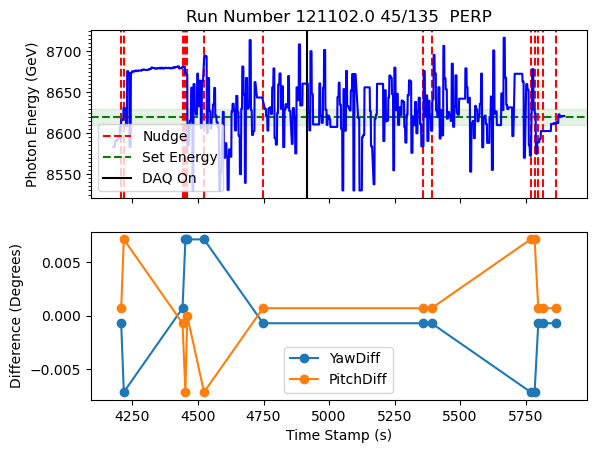

plotting for run  121130.0
daq on at time 676.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    371
 162.0     59
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5890
 162.0      59
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

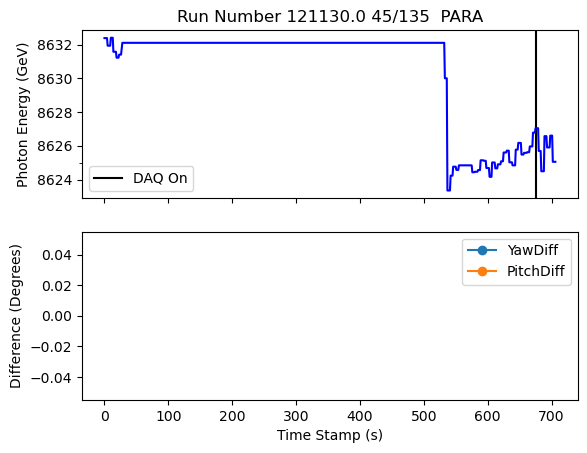

plotting for run  121132.0
Nudge number 2 occurs at time 282.0
Nudge number 3 occurs at time 289.0
Nudge number 4 occurs at time 296.0
daq on at time 486.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    265
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3149
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

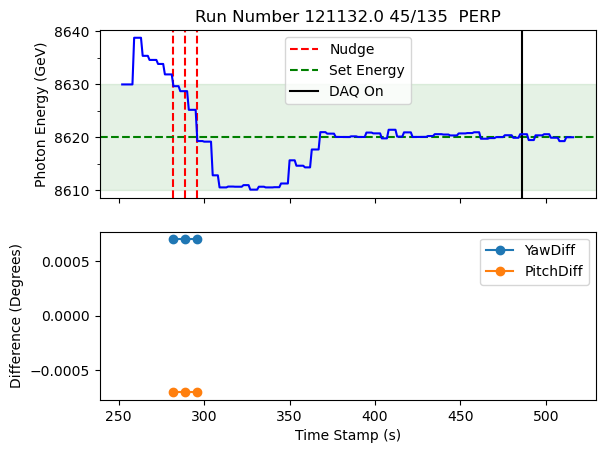

plotting for run  121143.0
daq on at time 592.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    331
 162.0    137
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5648
 162.0     137
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

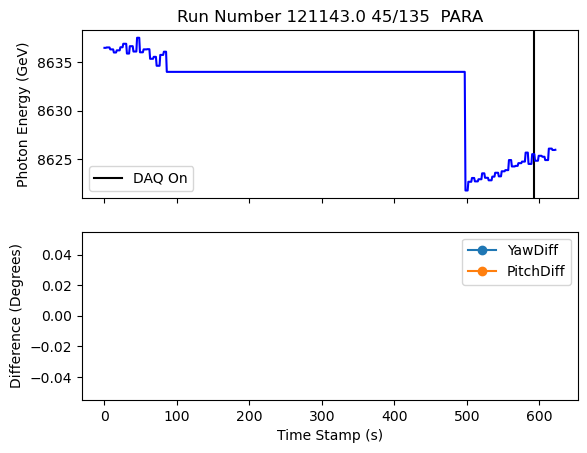

plotting for run  121148.0
Nudge number 2 occurs at time 30771.0
daq on at time 26440.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    3487
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6265
 162.0    4939
 0.0      3449
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

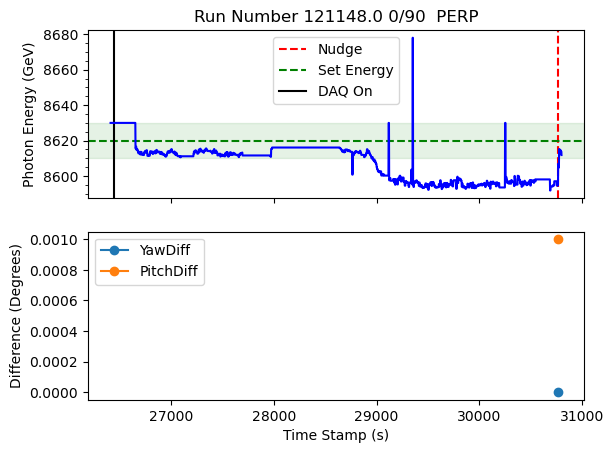

plotting for run  121157.0
daq on at time 6484.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    2070
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5840
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

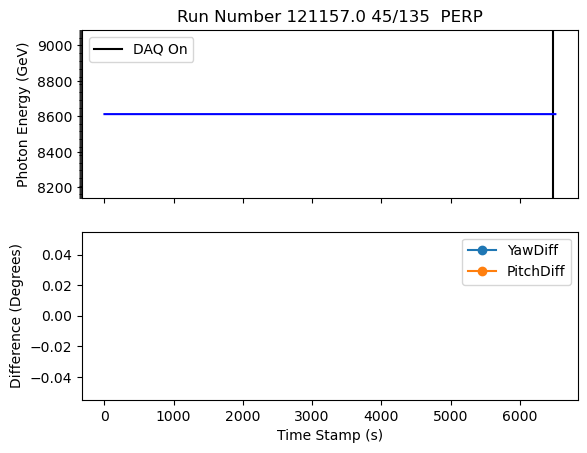

plotting for run  121160.0
daq on at time 1180.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    152
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    979
0.0      184
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

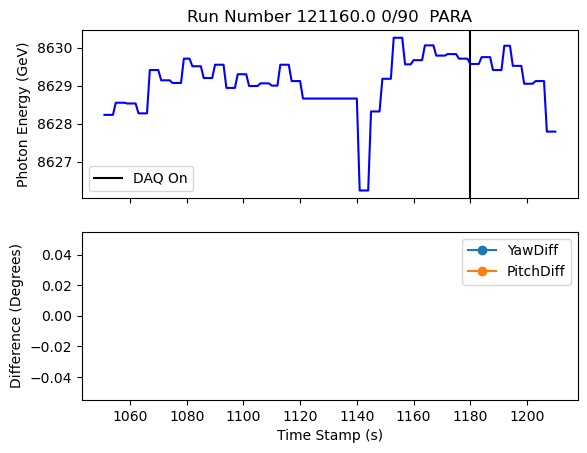

plotting for run  121169.0
Nudge number 1 occurs at time 6519.0
Nudge number 2 occurs at time 6604.0
Nudge number 3 occurs at time 6622.0
Nudge number 4 occurs at time 6765.0
Nudge number 5 occurs at time 6788.0
Nudge number 6 occurs at time 6828.0
Nudge number 7 occurs at time 6858.0
Nudge number 8 occurs at time 6859.0
Nudge number 11 occurs at time 7022.0
Nudge number 12 occurs at time 7025.0
Nudge number 13 occurs at time 7027.0
Nudge number 14 occurs at time 7029.0
Nudge number 15 occurs at time 7122.0
Nudge number 16 occurs at time 7127.0
Nudge number 17 occurs at time 7179.0
Nudge number 18 occurs at time 7180.0
Nudge number 19 occurs at time 7181.0
Nudge number 22 occurs at time 7249.0
Nudge number 23 occurs at time 7280.0
daq on at time 1279.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    5735
Name: count, dtype: int64
roll values are GONI:ROLL
162.00    6469
29.55 

<Figure size 640x480 with 0 Axes>

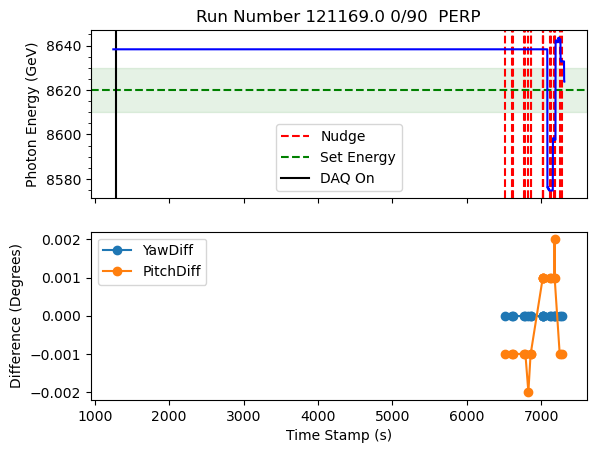

plotting for run  121171.0
daq on at time 918.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 162.0    576
-153.0    240
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5775
 162.0     576
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

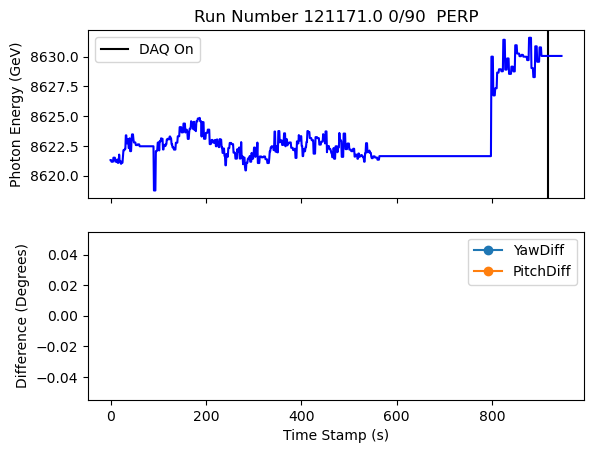

plotting for run  121174.0
Nudge number 2 occurs at time 120.0
Nudge number 3 occurs at time 133.0
daq on at time 147.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    88
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5578
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

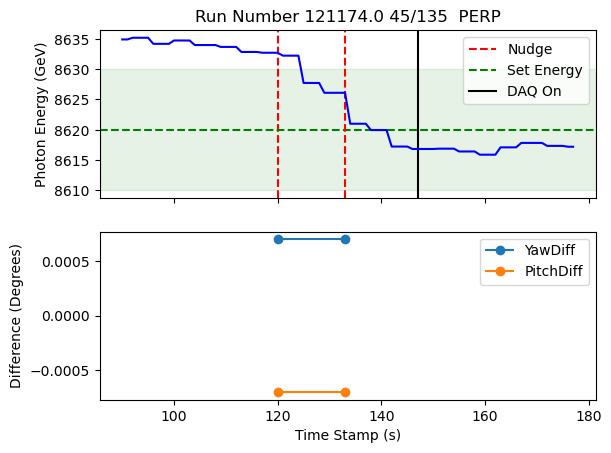

plotting for run  121182.0
daq on at time 203.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    193
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5848
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

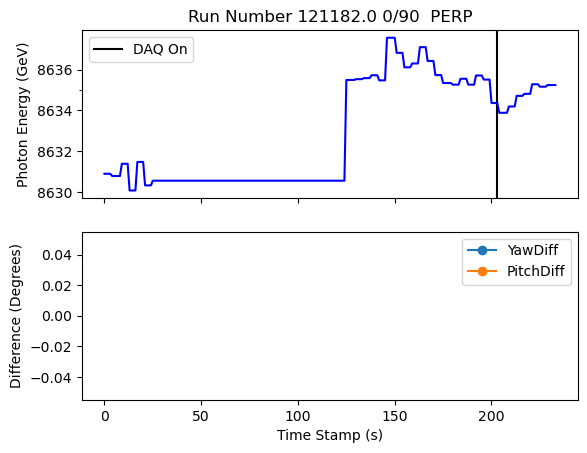

plotting for run  121183.0
Nudge number 1 occurs at time 1347.0
daq on at time 543.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    852
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6036
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

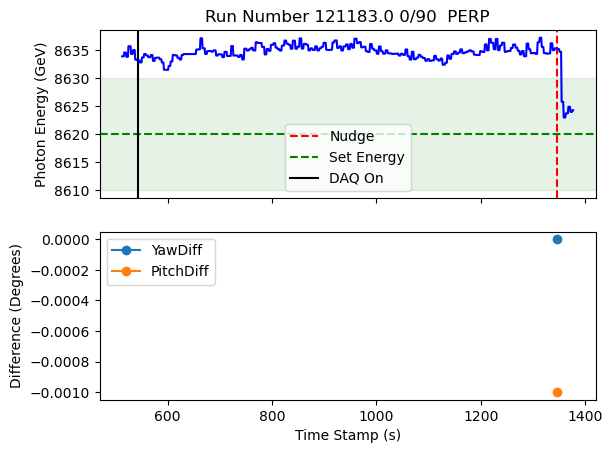

plotting for run  121185.0
daq on at time 15659.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    4439
 162.0    1195
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    9886
 162.0    1195
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

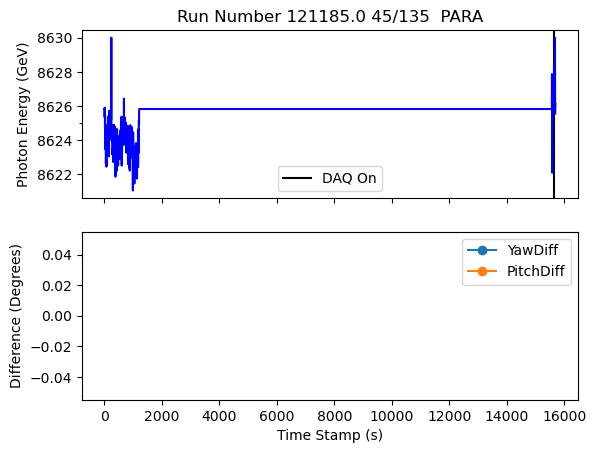

plotting for run  121187.0
Nudge number 2 occurs at time 166.0
daq on at time 234.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    129
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5787
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

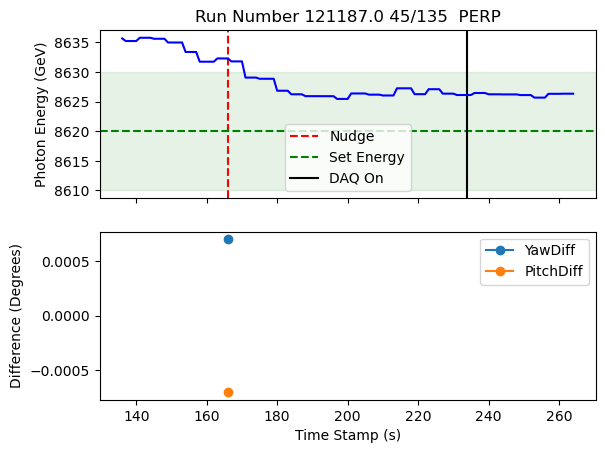

plotting for run  121203.0
daq on at time 2068.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    964
 162.0     36
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6703
 162.0      36
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

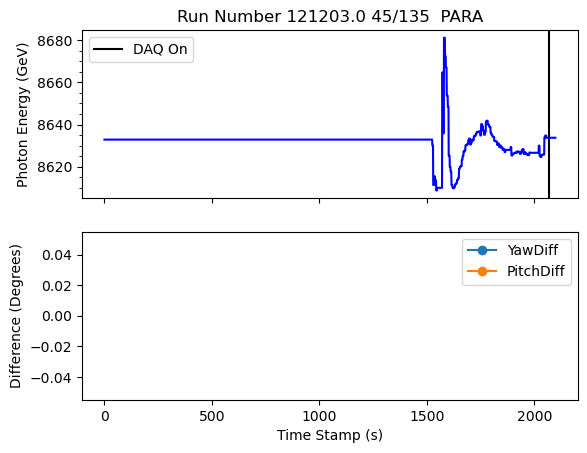

plotting for run  121205.0
Nudge number 2 occurs at time 733.0
Nudge number 3 occurs at time 802.0
daq on at time 918.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    145
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    942
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

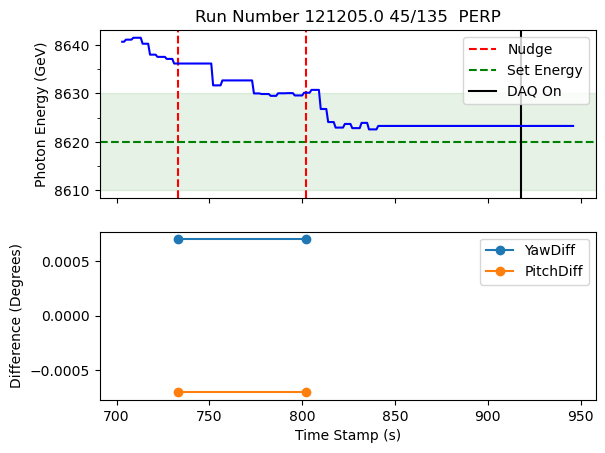

<Figure size 640x480 with 0 Axes>

In [16]:
# now for Spring 23
for runVal in nudge_list_2023:
    plot_run(df_2023_good,runVal)

plotting for run  120784
Nudge number 1 occurs at time 3454.0
Nudge number 2 occurs at time 3473.0
Nudge number 3 occurs at time 3484.0
Nudge number 4 occurs at time 3497.0
daq on at time 3581.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    185
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    2706
 0.0      1854
Name: count, dtype: int64


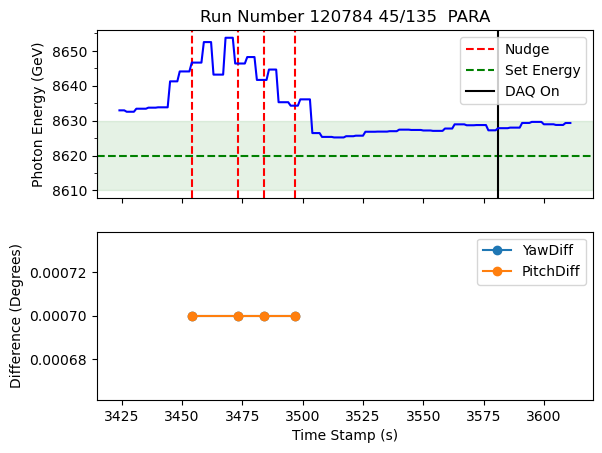

should have  [4] nudges for run 120784
energy change is 20.91399999999885
num_nudges_better is 4.0
energy change per nudge for run  120784 is 5.228499999999713
plotting for run  120828
Nudge number 2 occurs at time 281.0
daq on at time 325.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    101
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5550
 0.0        56
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

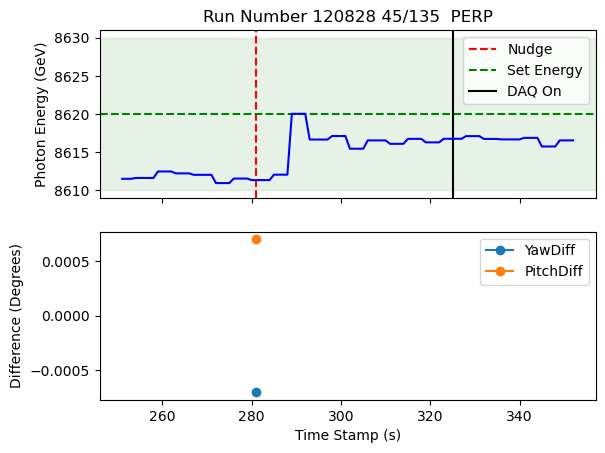

should have  [2] nudges for run 120828
energy change is 5.027999999998428
num_nudges_better is 1.0
energy change per nudge for run  120828 is 5.027999999998428
plotting for run  121099
Nudge number 2 occurs at time 650.0
daq on at time 817.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    214
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5791
 162.0     118
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

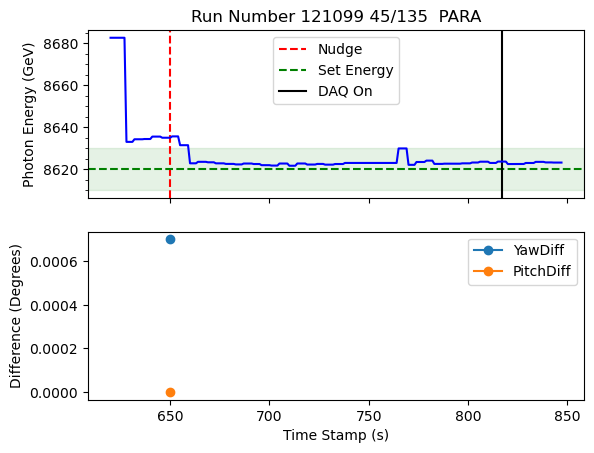

should have  [2] nudges for run 121099
energy change is 11.942500000001019
num_nudges_better is 0.0
energy change per nudge for run  121099 is inf
plotting for run  121132
Nudge number 2 occurs at time 282.0
Nudge number 3 occurs at time 289.0
Nudge number 4 occurs at time 296.0
daq on at time 486.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    265
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    3149
Name: count, dtype: int64


/var/folders/tp/y19c81b92lsc5dbbpwb5b0wh0000gn/T/ipykernel_39968/3924743498.py:67: RuntimeWarning: divide by zero encountered in scalar divide
  print('energy change per nudge for run ',runNum,'is',energy_change/num_nudges_fixed)


<Figure size 640x480 with 0 Axes>

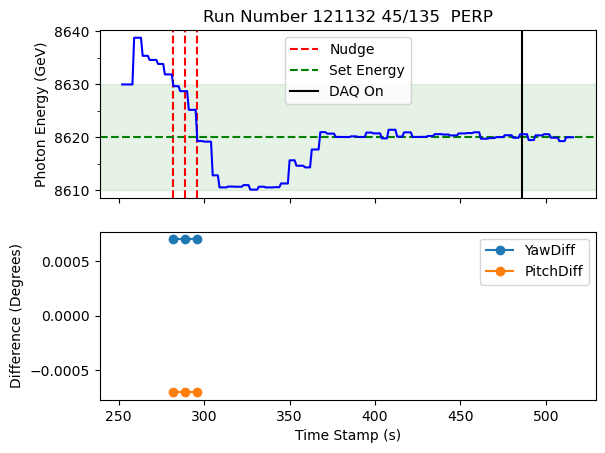

should have  [7] nudges for run 121132
energy change is 18.909999999999854
num_nudges_better is 3.0
energy change per nudge for run  121132 is 6.303333333333285
plotting for run  121174
Nudge number 2 occurs at time 120.0
Nudge number 3 occurs at time 133.0
daq on at time 147.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    88
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5578
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

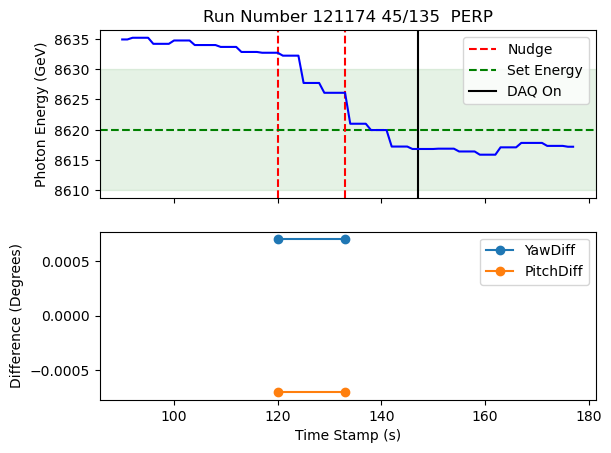

should have  [4] nudges for run 121174
energy change is 16.066000000000713
num_nudges_better is 2.0
energy change per nudge for run  121174 is 8.033000000000357
plotting for run  121187
Nudge number 2 occurs at time 166.0
daq on at time 234.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    129
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    5787
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

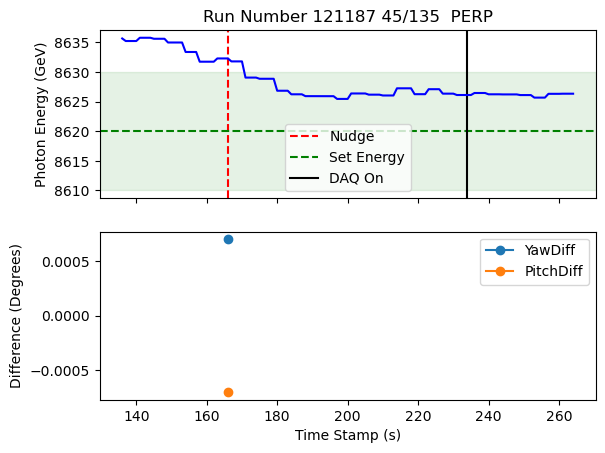

should have  [2] nudges for run 121187
energy change is 6.0575000000008
num_nudges_better is 1.0
energy change per nudge for run  121187 is 6.0575000000008
plotting for run  121205
Nudge number 2 occurs at time 733.0
Nudge number 3 occurs at time 802.0
daq on at time 918.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -153.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-153.0    145
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    942
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

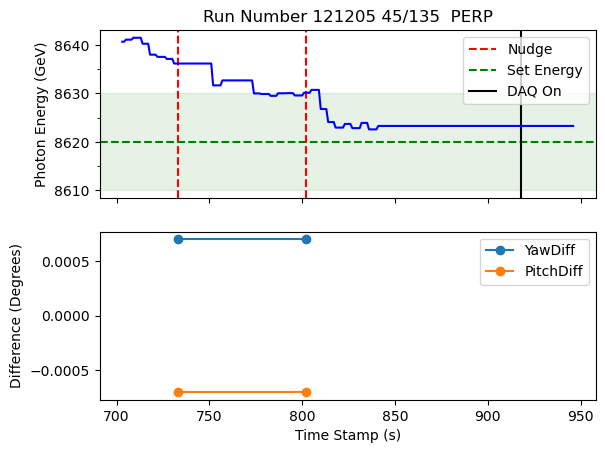

should have  [3] nudges for run 121205
energy change is 12.650000000001455
num_nudges_better is 2.0
energy change per nudge for run  121205 is 6.325000000000728
plotting for run  120420
Nudge number 2 occurs at time 373.0
Nudge number 3 occurs at time 388.0
daq on at time 289.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    157
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3152
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

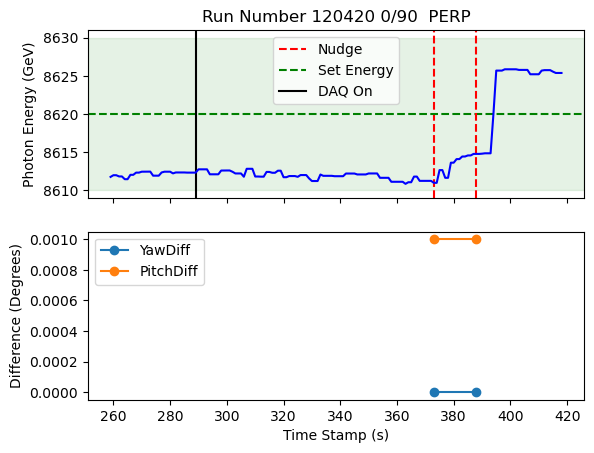

should have  [5] nudges for run 120420
energy change is 14.569999999999709
num_nudges_better is 2.0
energy change per nudge for run  120420 is 7.2849999999998545
plotting for run  120848
Nudge number 2 occurs at time 177.0
Nudge number 3 occurs at time 197.0
Nudge number 4 occurs at time 210.0
daq on at time 286.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    169
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5695
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

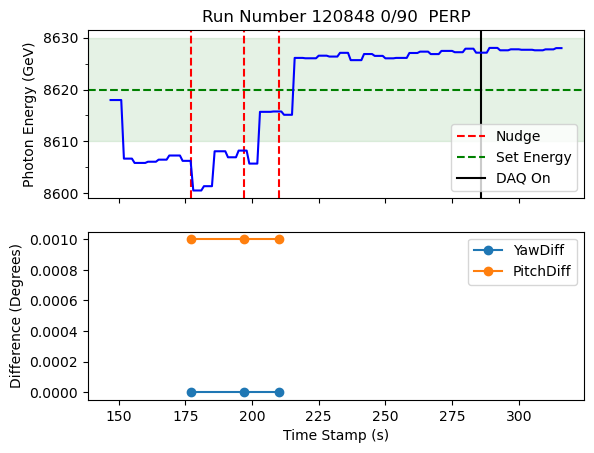

should have  [4] nudges for run 120848
energy change is 20.18000000000211
num_nudges_better is 3.0
energy change per nudge for run  120848 is 6.72666666666737
plotting for run  120857
Nudge number 2 occurs at time 251.0
Nudge number 3 occurs at time 291.0
Nudge number 4 occurs at time 461.0
daq on at time 572.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    314
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    3307
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

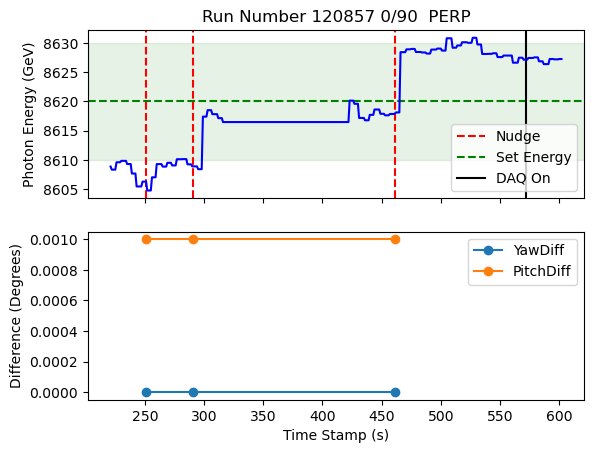

should have  [4] nudges for run 120857
energy change is 22.19250000000102
num_nudges_better is 3.0
energy change per nudge for run  120857 is 7.397500000000339
plotting for run  120894
Nudge number 2 occurs at time 1539.0
Nudge number 3 occurs at time 1555.0
daq on at time 1115.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    407
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6595
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

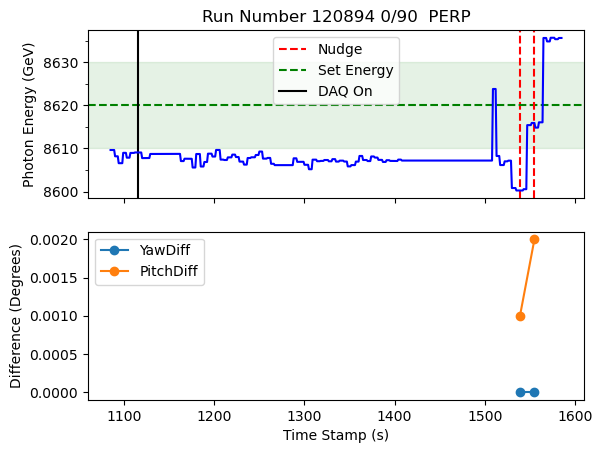

should have  [4] nudges for run 120894
energy change is 35.11249999999927
num_nudges_better is 2.0
energy change per nudge for run  120894 is 17.556249999999636
plotting for run  120931
Nudge number 1 occurs at time 651.0
Nudge number 2 occurs at time 1160.0
Nudge number 3 occurs at time 1170.0
daq on at time 1191.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    275
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    2132
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

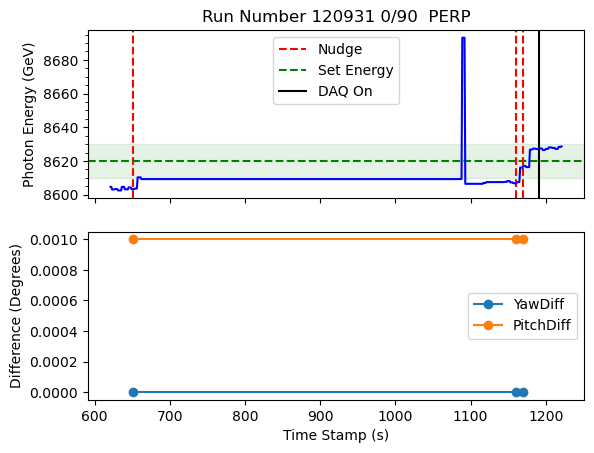

should have  [3] nudges for run 120931
energy change is 23.86200000000099
num_nudges_better is 3.0
energy change per nudge for run  120931 is 7.95400000000033
plotting for run  121036
Nudge number 2 occurs at time 1793.0
Nudge number 3 occurs at time 1801.0
daq on at time 1648.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    214
Name: count, dtype: int64
roll values are GONI:ROLL
 162.0    2238
-153.0     542
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

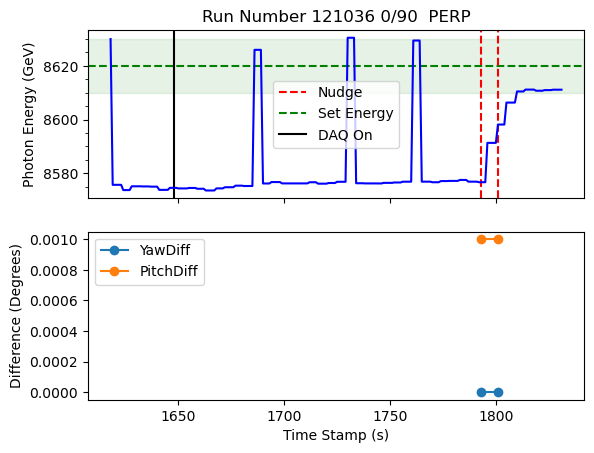

should have  [3] nudges for run 121036
energy change is 34.344999999999345
num_nudges_better is 2.0
energy change per nudge for run  121036 is 17.172499999999673
plotting for run  121051
Nudge number 2 occurs at time 696.0
Nudge number 3 occurs at time 1448.0
daq on at time 177.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    1290
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    5966
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

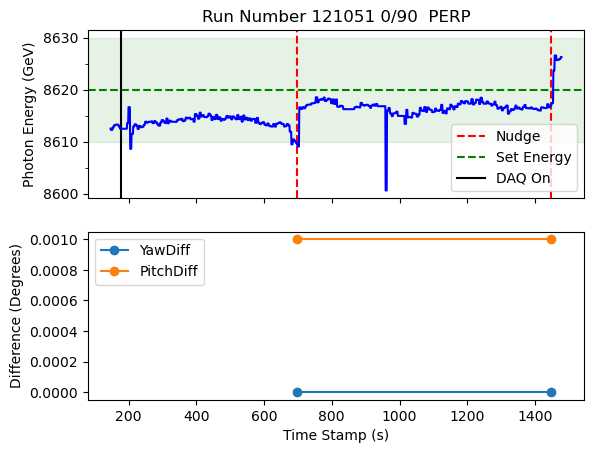

should have  [3] nudges for run 121051
energy change is 16.25250000000051
num_nudges_better is 2.0
energy change per nudge for run  121051 is 8.126250000000255
plotting for run  121068
Nudge number 2 occurs at time 281.0
Nudge number 3 occurs at time 286.0
Nudge number 4 occurs at time 291.0
daq on at time 139.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    192
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6100
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

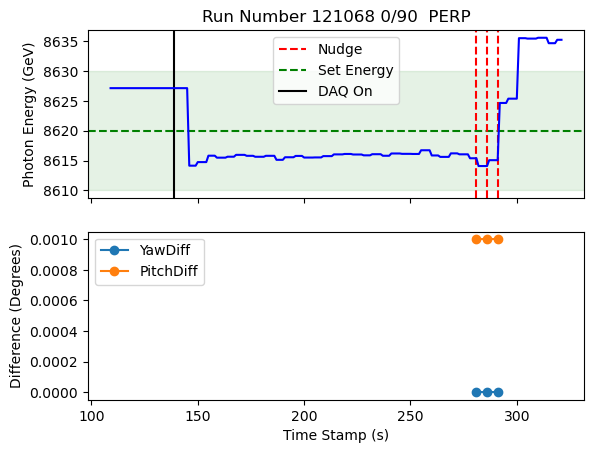

should have  [4] nudges for run 121068
energy change is 19.8125
num_nudges_better is 3.0
energy change per nudge for run  121068 is 6.604166666666667
plotting for run  121097
Nudge number 2 occurs at time 435.0
daq on at time 467.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    93
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6010
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

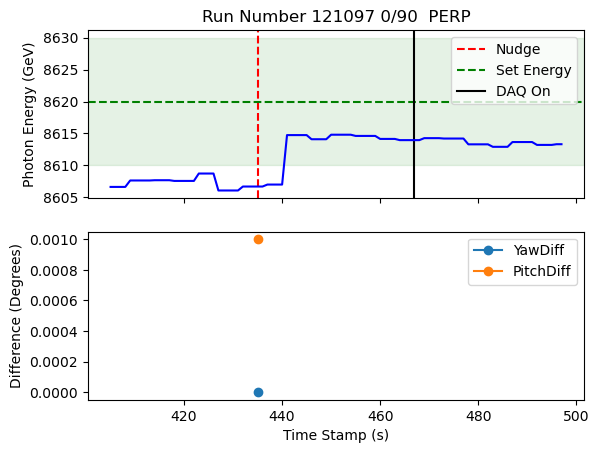

should have  [2] nudges for run 121097
energy change is 7.704999999999927
num_nudges_better is 1.0
energy change per nudge for run  121097 is 7.704999999999927
plotting for run  121148
Nudge number 2 occurs at time 30771.0
daq on at time 26440.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    3487
Name: count, dtype: int64
roll values are GONI:ROLL
-153.0    6265
 162.0    4939
 0.0      3449
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

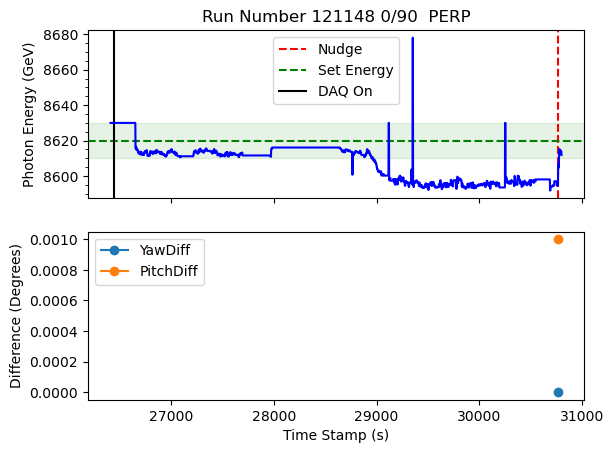

should have  [2] nudges for run 121148
energy change is 6.257499999999709
num_nudges_better is 1.0
energy change per nudge for run  121148 is 6.257499999999709
plotting for run  121183
Nudge number 1 occurs at time 1347.0
daq on at time 543.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    162.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
162.0    852
Name: count, dtype: int64
roll values are GONI:ROLL
162.0    6036
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

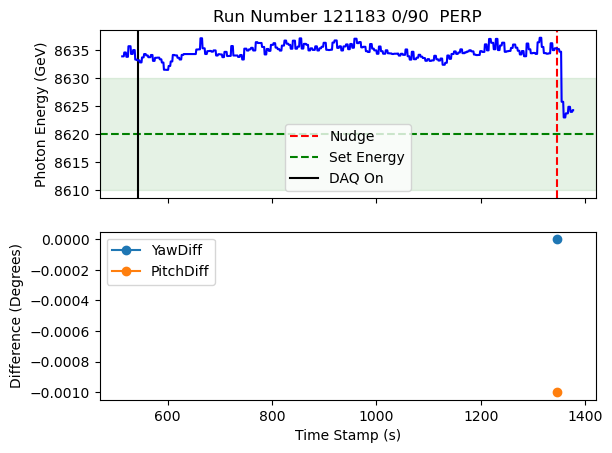

should have  [1] nudges for run 121183
energy change is 11.213999999998123
num_nudges_better is 1.0
energy change per nudge for run  121183 is 11.213999999998123


<Figure size 640x480 with 0 Axes>

In [17]:
number_nudges = []
energy_changes = []

number_nudges_0_90 = []
energy_changes_0_90 = []

number_nudges_45_135 = []
energy_changes_45_135 = []

# run lists determined by manually looking through plots of all runs, output in cell above
runs_45_135 = [120784, 120828, 121099, 121132, 121174, 121187, 121205]
runs_0_90 = [120420, 120848, 120857, 120894, 120931, 121036, 121051, 121068, 121097, 121148, 121183]
good_run_list = runs_45_135+runs_0_90

# some of the runs listed above have unreliable behavior, ie nudges that do nothing, but aren't labeled as backlash
exclude_runs = []
for runNum in good_run_list:
    if runNum in exclude_runs:
        continue

    plot_run(df_2023_good,runNum)

    df_tmp = df_2023_good[(df_2023_good['RunNumber']==runNum)&(df_2023_good['NudgeOccurred'])&(~df_2023_good['BacklashNudge'])]
    df_tmp.reset_index(inplace=True)


    print('should have ',df_tmp['TotalNudges_thisRun'].unique(),'nudges for run',runNum)

    # we are looking at the subset of nudges that are not backlash, so none of these methods work for us
    #num_nudges = df_tmp['TotalNudgeSize_thisRun'].unique()[0]/0.001
    #num_nudges_alt = df_tmp['TotalNudges_thisRun'].unique()[0]
    
    # need to loop over nudge sizes, add in quadrature, and divide by 0.001
    num_nudges_fixed = 0
    for nudgeVal in df_tmp['NudgeNumber'].unique():
        df_tmp2 = df_tmp[df_tmp['NudgeNumber']==nudgeVal]
        num_nudges_fixed += (df_tmp['NudgePitchSize'].mode()[0]**2+df_tmp['NudgeYawSize'].mode()[0]**2)**0.5
    num_nudges_fixed = round(num_nudges_fixed/0.001,1)



    # look at energy at first nudge, compare to avg of last 5 energies
    nudge_list = df_tmp['NudgeNumber'].unique()
    df_first_nudge = df_tmp[df_tmp['NudgeNumber']==min(nudge_list)]
    df_first_nudge.reset_index()
    initial_energy = df_first_nudge.loc[0,'CBREM:ENERGY']


    # look 15-30 seconds after last nudge, take avg time
    df_last_nudge = df_tmp[df_tmp['NudgeNumber']==max(nudge_list)]
    df_last_nudge.reset_index(inplace=True)

    last_nudge_time = df_last_nudge.loc[0,'TimeStamp']

    df_end = df_2023_good[(df_2023_good['RunNumber']==runNum)&(df_2023_good['TimeStamp']>=(last_nudge_time+15))&(df_2023_good['TimeStamp']<=(last_nudge_time+30))]
    end_energies = df_end['CBREM:ENERGY'].unique()

    final_energy = np.mean(end_energies)

    energy_change = abs(final_energy - initial_energy)

    energy_changes.append(energy_change)
    number_nudges.append(num_nudges_fixed)

    print('energy change is',energy_change)
    print('num_nudges_better is',num_nudges_fixed)
    print('energy change per nudge for run ',runNum,'is',energy_change/num_nudges_fixed)

    if runNum in runs_45_135:
        energy_changes_45_135.append(energy_change)
        number_nudges_45_135.append(num_nudges_fixed)
    else:
        energy_changes_0_90.append(energy_change)
        number_nudges_0_90.append(num_nudges_fixed)


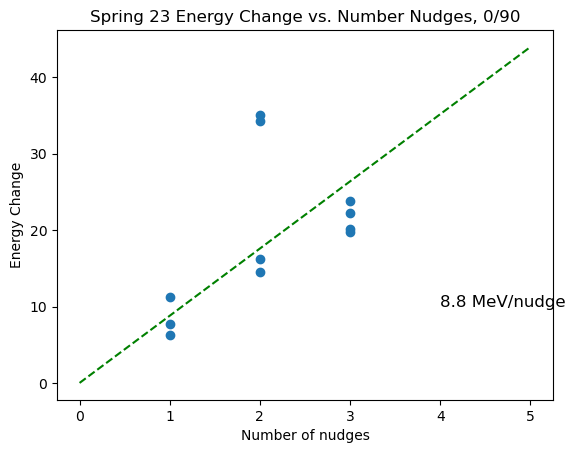

In [18]:
plt.scatter(number_nudges_0_90,energy_changes_0_90)
plt.title("Spring 23 Energy Change vs. Number Nudges, 0/90")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,50)
plt.ylabel("Energy Change")

from sklearn.linear_model import LinearRegression 
lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_0_90).reshape(-1,1)
y = energy_changes_0_90
lr.fit(X,y)

x_vals = np.array(np.arange(0,6,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_0_90_Spring23.pdf')

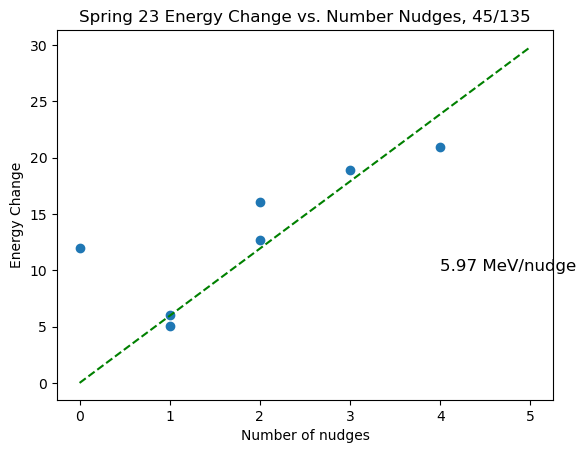

In [19]:
plt.scatter(number_nudges_45_135,energy_changes_45_135)
plt.title("Spring 23 Energy Change vs. Number Nudges, 45/135")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,30)
plt.ylabel("Energy Change")

lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_45_135).reshape(-1,1)
y = energy_changes_45_135
lr.fit(X,y)

x_vals = np.array(np.arange(0,6,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_45_135_Spring23.pdf')

plotting for run  131407.0
Nudge number 7 occurs at time 2084.0
Nudge number 8 occurs at time 2094.0
Nudge number 12 occurs at time 2445.0
Nudge number 13 occurs at time 2446.0
Nudge number 14 occurs at time 2455.0
Nudge number 15 occurs at time 2476.0
Nudge number 16 occurs at time 2495.0
Nudge number 17 occurs at time 2509.0
Nudge number 18 occurs at time 2516.0
Nudge number 19 occurs at time 2550.0
Nudge number 20 occurs at time 2571.0
Nudge number 27 occurs at time 2700.0
Nudge number 28 occurs at time 2704.0
Nudge number 29 occurs at time 2712.0
Nudge number 33 occurs at time 2796.0
daq on at time 2966.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    929
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6770
Name: count, dtype: int64


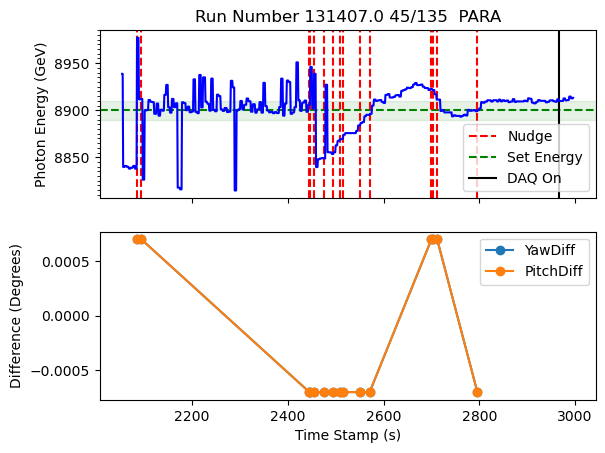

plotting for run  131409.0
Nudge number 5 occurs at time 200.0
Nudge number 6 occurs at time 206.0
Nudge number 7 occurs at time 212.0
Nudge number 8 occurs at time 226.0
Nudge number 9 occurs at time 234.0
Nudge number 10 occurs at time 243.0
Nudge number 11 occurs at time 268.0
daq on at time 521.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    355
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    1390
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

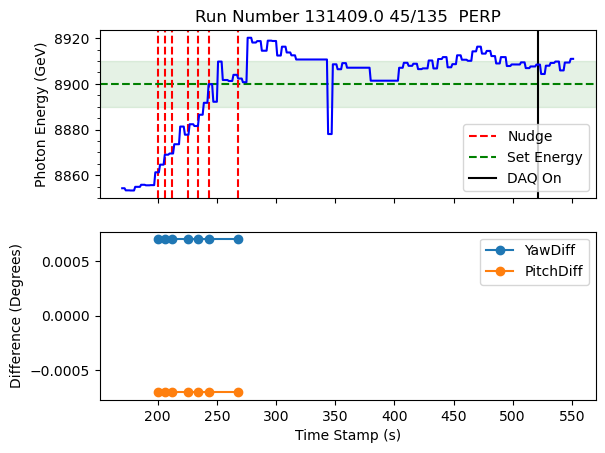

plotting for run  131416.0
Nudge number 2 occurs at time 885.0
Nudge number 3 occurs at time 892.0
Nudge number 4 occurs at time 958.0
Nudge number 5 occurs at time 962.0
Nudge number 6 occurs at time 966.0
Nudge number 9 occurs at time 977.0
Nudge number 14 occurs at time 1005.0
Nudge number 19 occurs at time 1161.0
Nudge number 20 occurs at time 1165.0
Nudge number 21 occurs at time 1168.0
Nudge number 22 occurs at time 1171.0
Nudge number 25 occurs at time 6829.0
daq on at time 409.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    6199
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6902
 0.0      141
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

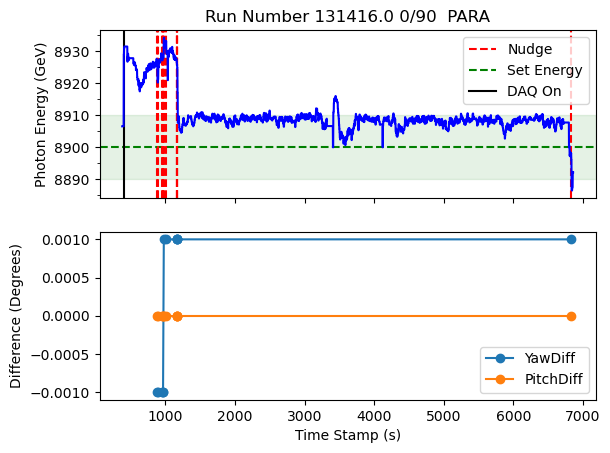

plotting for run  131421.0
Nudge number 1 occurs at time 2165.0
Nudge number 2 occurs at time 2328.0
Nudge number 3 occurs at time 2374.0
Nudge number 4 occurs at time 2389.0
Nudge number 5 occurs at time 2406.0
Nudge number 6 occurs at time 2425.0
daq on at time 777.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    1514
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6023
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

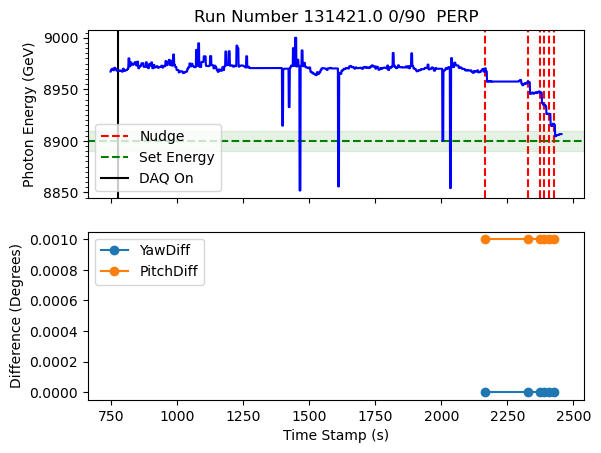

plotting for run  131429.0
Nudge number 1 occurs at time 201.0
Nudge number 2 occurs at time 219.0
Nudge number 3 occurs at time 237.0
Nudge number 4 occurs at time 243.0
Nudge number 5 occurs at time 266.0
Nudge number 8 occurs at time 422.0
daq on at time 620.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    433
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5930
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

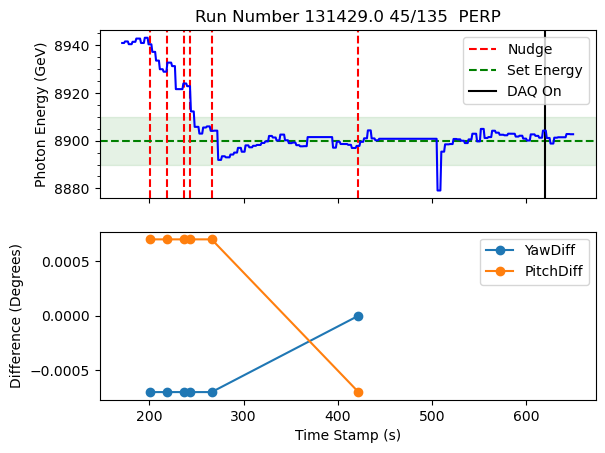

plotting for run  131438.0
Nudge number 2 occurs at time 850.0
Nudge number 3 occurs at time 855.0
Nudge number 4 occurs at time 862.0
Nudge number 5 occurs at time 903.0
Nudge number 8 occurs at time 948.0
Nudge number 9 occurs at time 957.0
Nudge number 10 occurs at time 1019.0
Nudge number 11 occurs at time 1045.0
Nudge number 12 occurs at time 1064.0
Nudge number 13 occurs at time 1088.0
daq on at time 818.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    304
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    689
 0.0     123
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

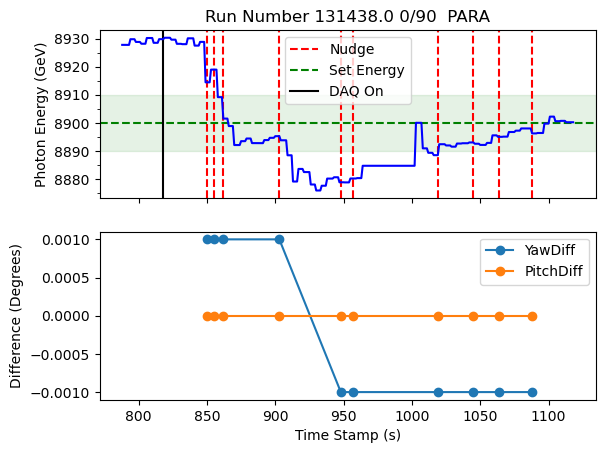

plotting for run  131443.0
Nudge number 1 occurs at time 570.0
Nudge number 2 occurs at time 580.0
Nudge number 3 occurs at time 592.0
Nudge number 4 occurs at time 603.0
Nudge number 5 occurs at time 622.0
Nudge number 6 occurs at time 652.0
Nudge number 9 occurs at time 728.0
daq on at time 858.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    345
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4455
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

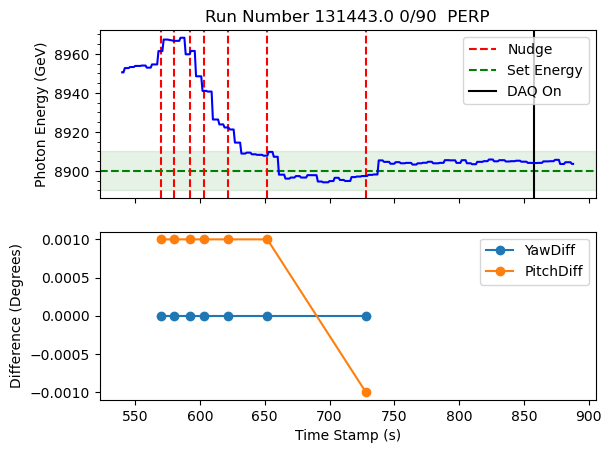

plotting for run  131447.0
Nudge number 2 occurs at time 2112.0
Nudge number 6 occurs at time 2164.0
Nudge number 7 occurs at time 2664.0
Nudge number 8 occurs at time 2674.0
Nudge number 9 occurs at time 2689.0
Nudge number 10 occurs at time 2734.0
Nudge number 11 occurs at time 2748.0
Nudge number 12 occurs at time 2774.0
Nudge number 13 occurs at time 2808.0
Nudge number 17 occurs at time 3661.0
Nudge number 18 occurs at time 3696.0
Nudge number 19 occurs at time 3734.0
Nudge number 20 occurs at time 3763.0
daq on at time 1406.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    2085
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    5529
-16.6     941
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

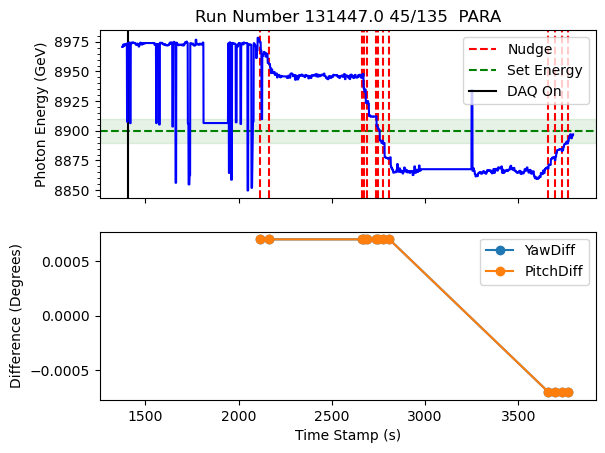

plotting for run  131449.0
daq on at time 11229.0
[1. 0.]
plane_values are 0    0.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    0.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
0.0     2484
28.4    1328
Name: count, dtype: int64
roll values are GONI:ROLL
0.0     2484
28.4    1394
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

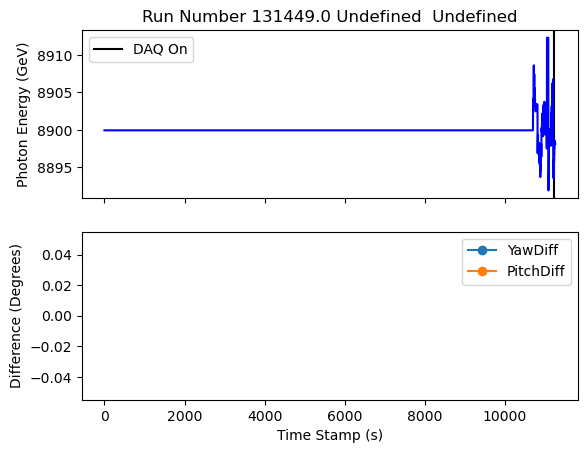

plotting for run  131456.0
daq on at time 900.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    792
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    1142
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

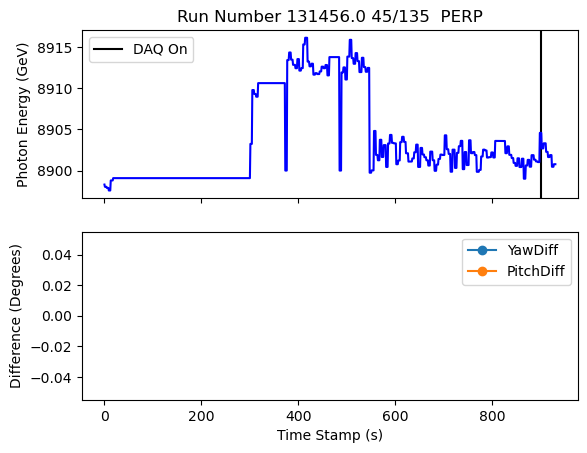

plotting for run  131491.0
Nudge number 1 occurs at time 4646.0
Nudge number 2 occurs at time 4682.0
Nudge number 3 occurs at time 4694.0
Nudge number 4 occurs at time 4836.0
Nudge number 5 occurs at time 4837.0
Nudge number 8 occurs at time 5079.0
daq on at time 5125.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    506
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4394
 0.0      885
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

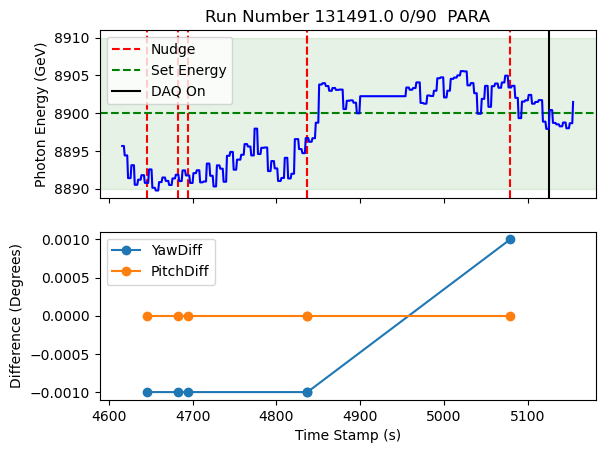

plotting for run  131581.0
Nudge number 1 occurs at time 8361.0
Nudge number 4 occurs at time 8806.0
Nudge number 5 occurs at time 8820.0
daq on at time 9031.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    473
Name: count, dtype: int64
roll values are GONI:ROLL
 0.0     7262
-16.6     794
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

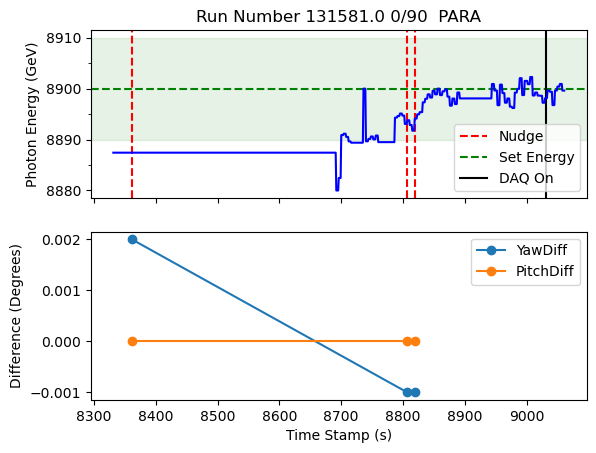

plotting for run  131600.0
daq on at time 668.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    589
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4066
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

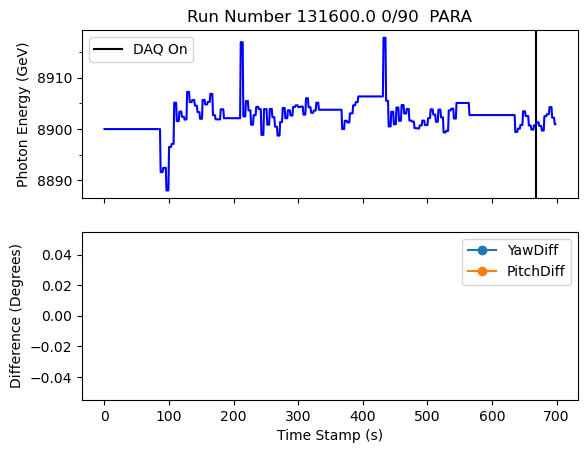

plotting for run  131602.0
Nudge number 2 occurs at time 2449.0
daq on at time 890.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    1408
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    2739
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

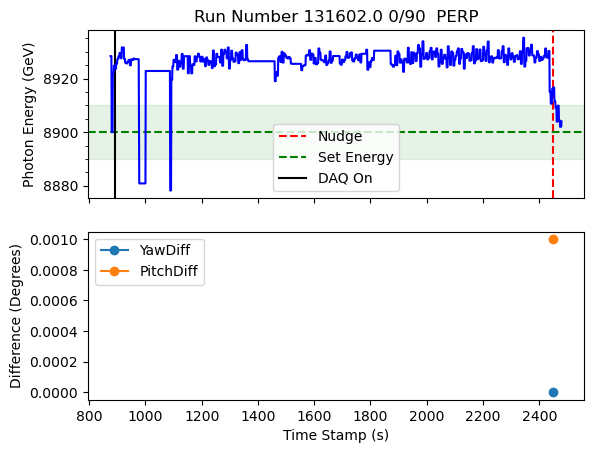

plotting for run  131620.0
daq on at time 665.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    290
-16.6    141
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    6930
-16.6     141
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

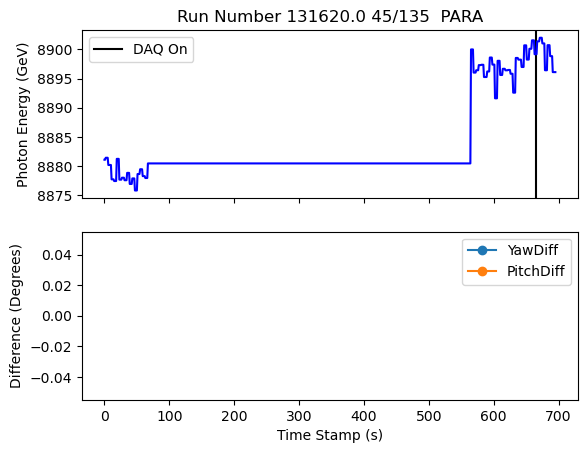

plotting for run  131622.0
Nudge number 4 occurs at time 258.0
daq on at time 402.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    168
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    541
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

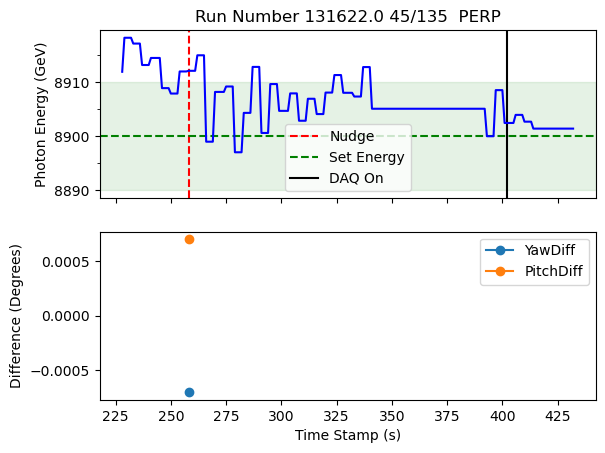

plotting for run  131634.0
Nudge number 2 occurs at time 289.0
Nudge number 3 occurs at time 309.0
Nudge number 4 occurs at time 312.0
Nudge number 5 occurs at time 326.0
Nudge number 6 occurs at time 346.0
Nudge number 7 occurs at time 347.0
daq on at time 459.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    200
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7007
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

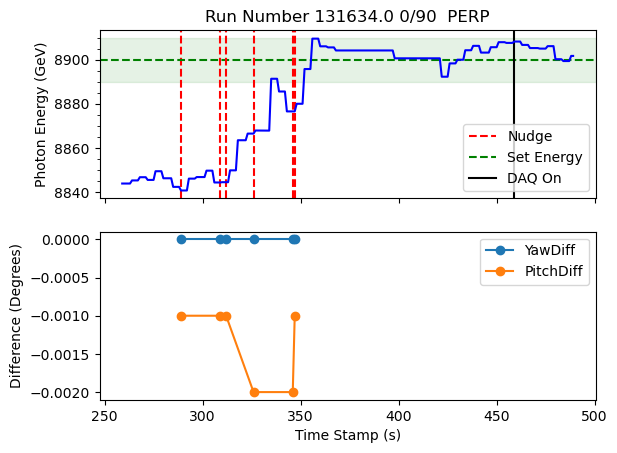

plotting for run  131658.0
daq on at time 694.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    665
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    1736
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

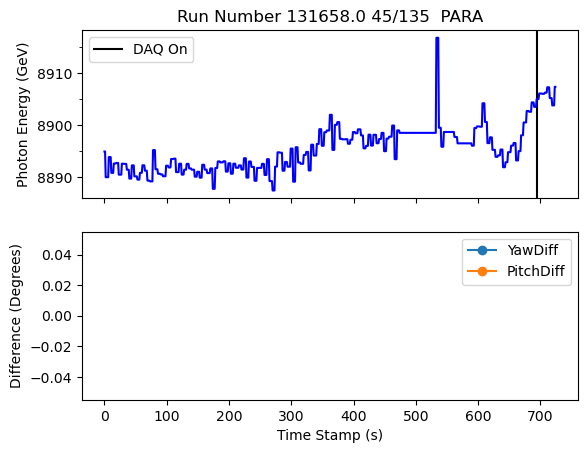

plotting for run  131662.0
Nudge number 4 occurs at time 970.0
Nudge number 5 occurs at time 972.0
Nudge number 6 occurs at time 973.0
daq on at time 585.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    398
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4350
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

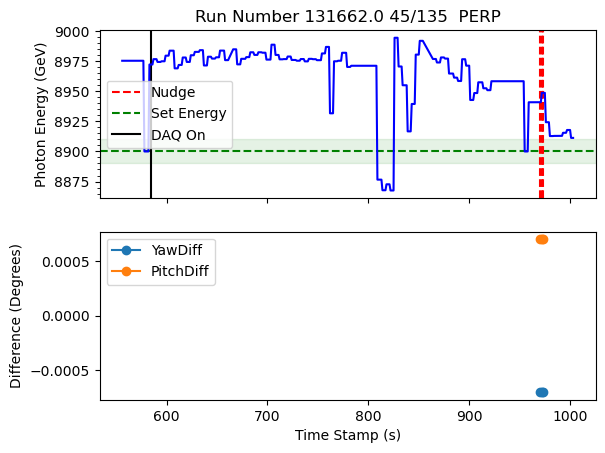

plotting for run  131672.0
Nudge number 2 occurs at time 3437.0
Nudge number 3 occurs at time 3439.0
Nudge number 4 occurs at time 3440.0
Nudge number 5 occurs at time 3446.0
Nudge number 6 occurs at time 3447.0
Nudge number 7 occurs at time 3448.0
Nudge number 8 occurs at time 3451.0
Nudge number 9 occurs at time 3453.0
Nudge number 12 occurs at time 3473.0
Nudge number 13 occurs at time 3477.0
Nudge number 14 occurs at time 3486.0
Nudge number 15 occurs at time 3489.0
Nudge number 16 occurs at time 3493.0
Nudge number 17 occurs at time 3496.0
Nudge number 20 occurs at time 3508.0
Nudge number 21 occurs at time 3520.0
Nudge number 22 occurs at time 3543.0
Nudge number 23 occurs at time 3554.0
Nudge number 24 occurs at time 3557.0
Nudge number 25 occurs at time 3558.0
Nudge number 26 occurs at time 3562.0
Nudge number 27 occurs at time 3567.0
Nudge number 28 occurs at time 3597.0
Nudge number 29 occurs at time 3602.0
Nudge number 30 occurs at time 3658.0
Nudge number 33 occurs at time 

<Figure size 640x480 with 0 Axes>

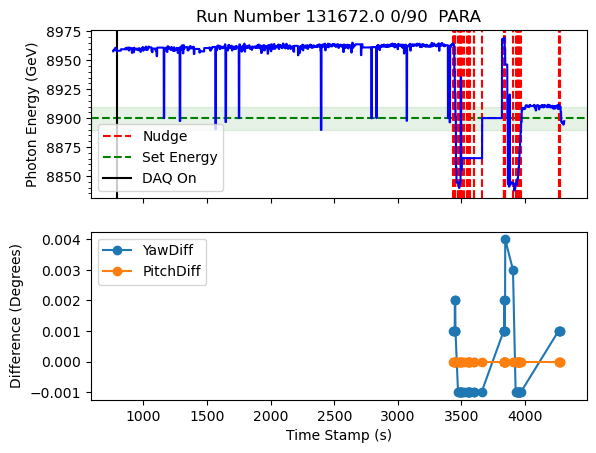

plotting for run  131677.0
Nudge number 1 occurs at time 59.0
Nudge number 2 occurs at time 72.0
Nudge number 3 occurs at time 73.0
daq on at time 261.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    242
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

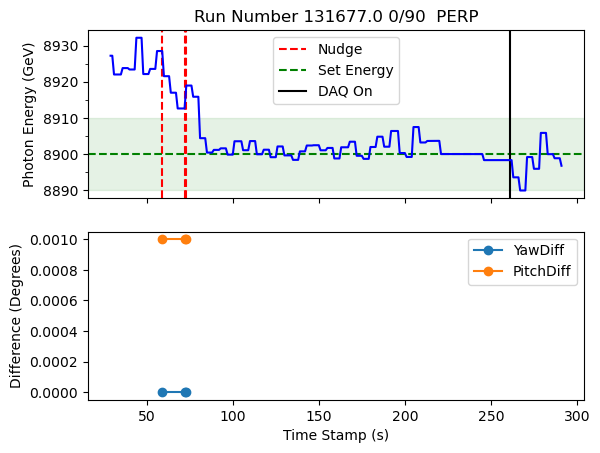

plotting for run  131703.0
Nudge number 2 occurs at time 4226.0
Nudge number 3 occurs at time 4228.0
Nudge number 4 occurs at time 4229.0
Nudge number 5 occurs at time 4232.0
Nudge number 6 occurs at time 4234.0
Nudge number 7 occurs at time 4236.0
Nudge number 8 occurs at time 4239.0
daq on at time 4302.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    137
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6205
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

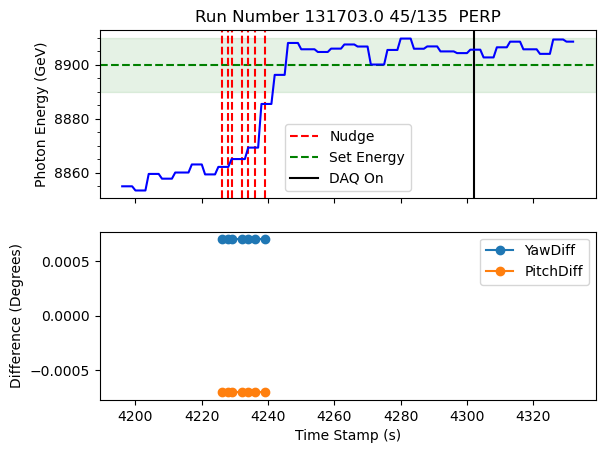

plotting for run  131709.0
Nudge number 2 occurs at time 238.0
Nudge number 3 occurs at time 241.0
Nudge number 6 occurs at time 299.0
Nudge number 7 occurs at time 328.0
daq on at time 451.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    270
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6727
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

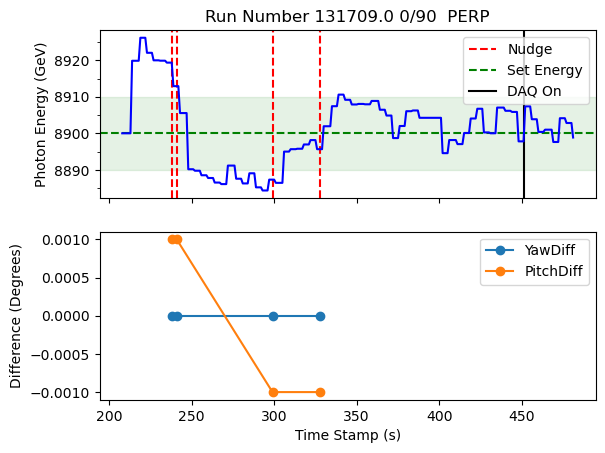

plotting for run  131714.0
Nudge number 2 occurs at time 269.0
Nudge number 3 occurs at time 293.0
Nudge number 4 occurs at time 294.0
daq on at time 416.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    208
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6296
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

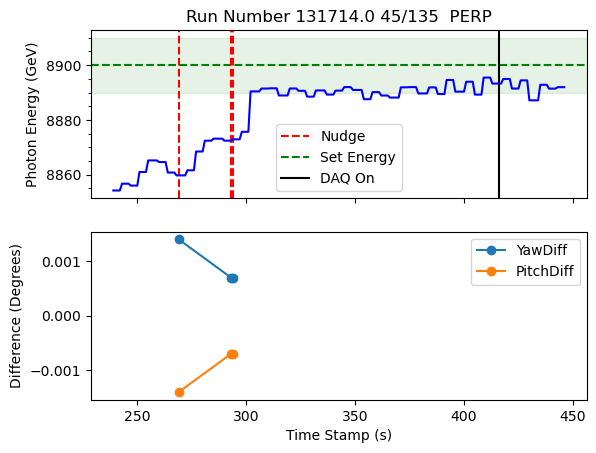

plotting for run  131720.0
Nudge number 3 occurs at time 1868.0
Nudge number 4 occurs at time 1909.0
Nudge number 5 occurs at time 1919.0
Nudge number 6 occurs at time 1929.0
Nudge number 7 occurs at time 1942.0
Nudge number 8 occurs at time 1950.0
Nudge number 9 occurs at time 1964.0
Nudge number 10 occurs at time 1976.0
Nudge number 11 occurs at time 1992.0
Nudge number 12 occurs at time 2003.0
daq on at time 189.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    1848
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5913
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

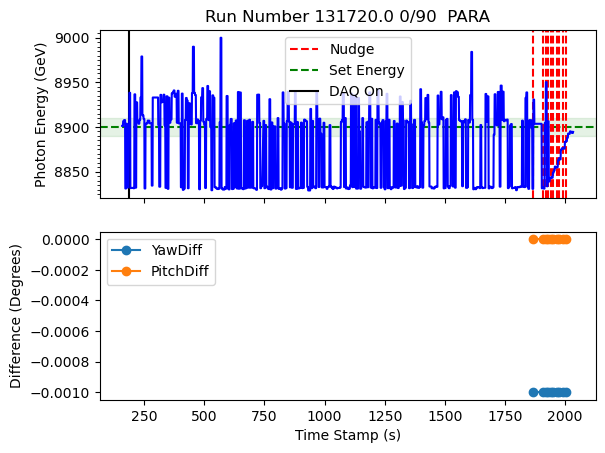

plotting for run  131726.0
Nudge number 2 occurs at time 2771.0
Nudge number 3 occurs at time 2773.0
daq on at time 440.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    2238
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3556
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

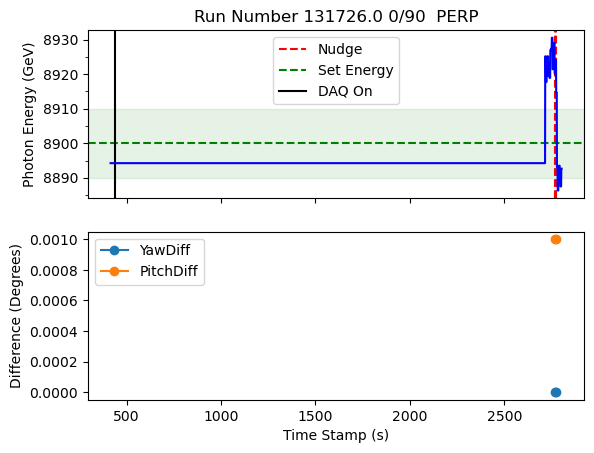

plotting for run  131734.0
Nudge number 4 occurs at time 1073.0
Nudge number 5 occurs at time 1090.0
Nudge number 6 occurs at time 1098.0
Nudge number 7 occurs at time 1114.0
daq on at time 394.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    776
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    7529
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

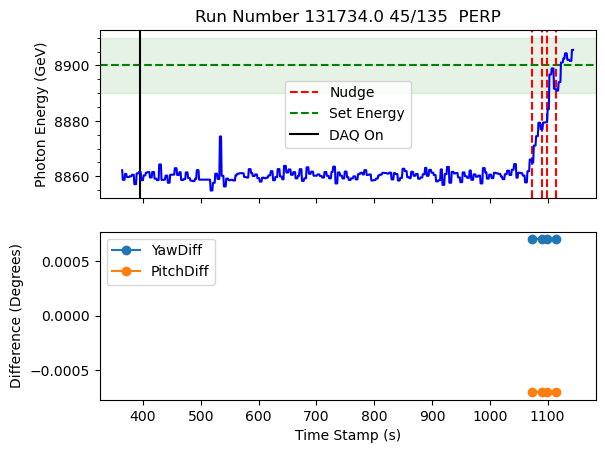

plotting for run  131741.0
Nudge number 1 occurs at time 2720.0
Nudge number 2 occurs at time 2735.0
Nudge number 3 occurs at time 2738.0
Nudge number 4 occurs at time 2741.0
Nudge number 5 occurs at time 2744.0
Nudge number 6 occurs at time 2759.0
Nudge number 7 occurs at time 2768.0
daq on at time 49.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    2759
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5595
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

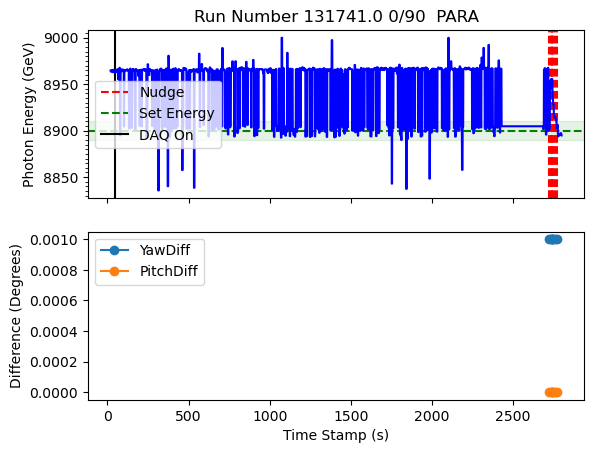

plotting for run  131744.0
daq on at time 406.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    340
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3427
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

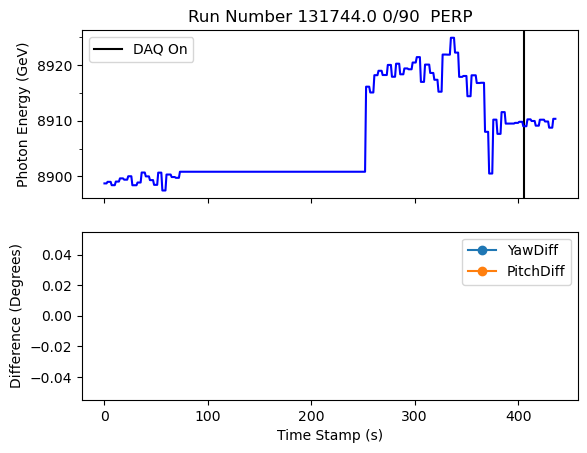

plotting for run  131745.0
Nudge number 1 occurs at time 9586.0
daq on at time 3640.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    5776
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7045
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

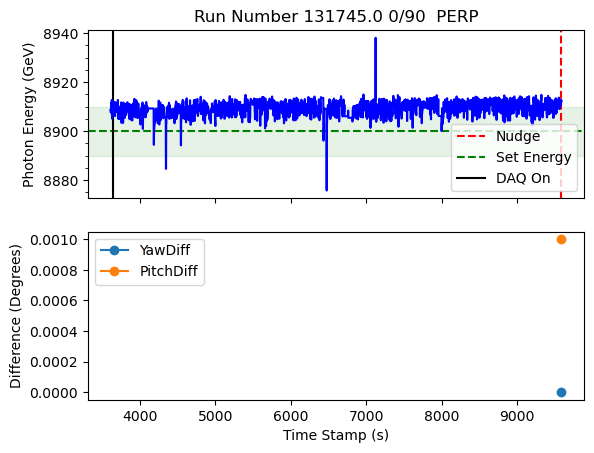

plotting for run  131749.0
daq on at time 559.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    331
-16.6    181
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    5800
-16.6     181
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

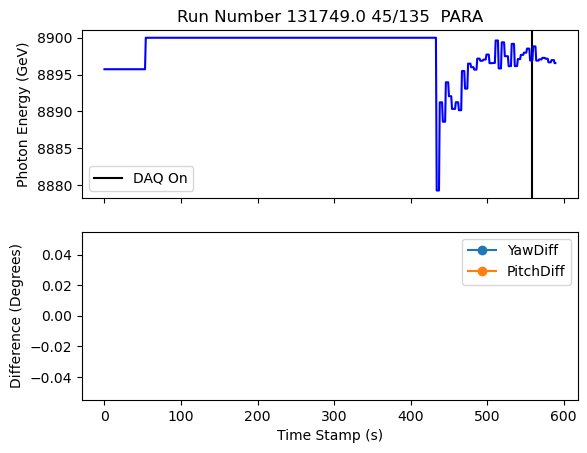

plotting for run  131751.0
Nudge number 4 occurs at time 554.0
daq on at time 661.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    168
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    2455
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

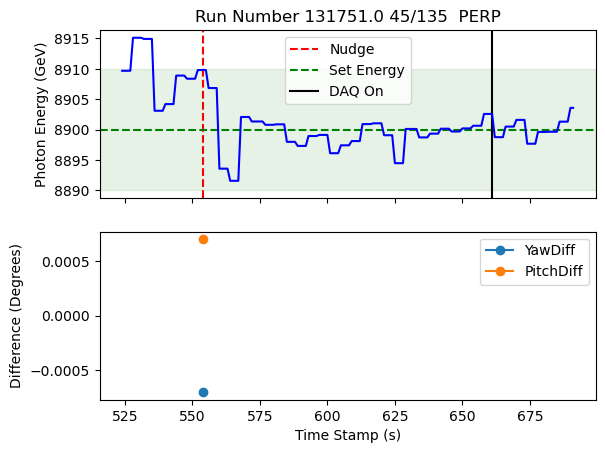

plotting for run  131771.0
Nudge number 1 occurs at time 347.0
Nudge number 2 occurs at time 370.0
daq on at time 991.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    705
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3011
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

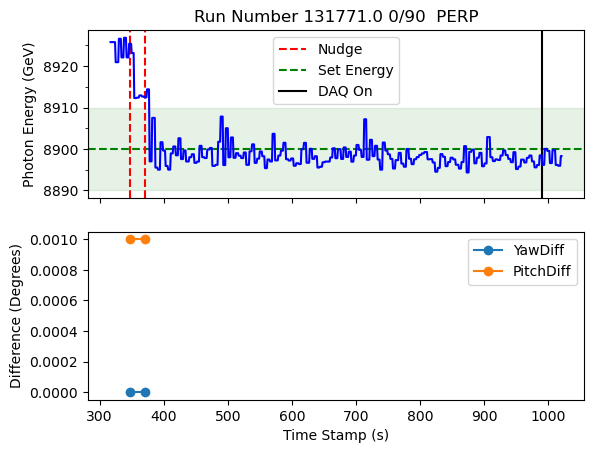

plotting for run  131774.0
daq on at time 517.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    316
-16.6    128
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    1335
-16.6     128
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

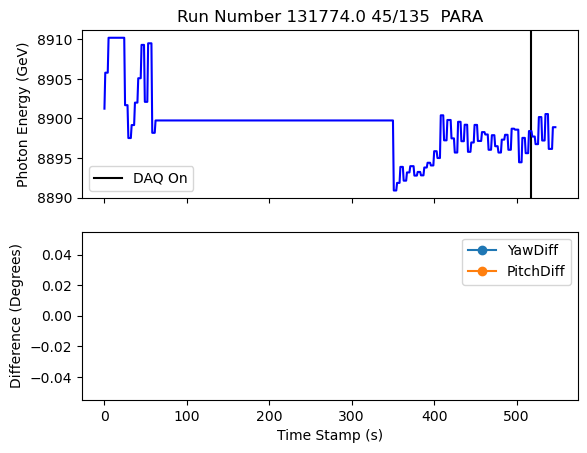

plotting for run  131777.0
Nudge number 4 occurs at time 319.0
daq on at time 357.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    99
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    2489
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

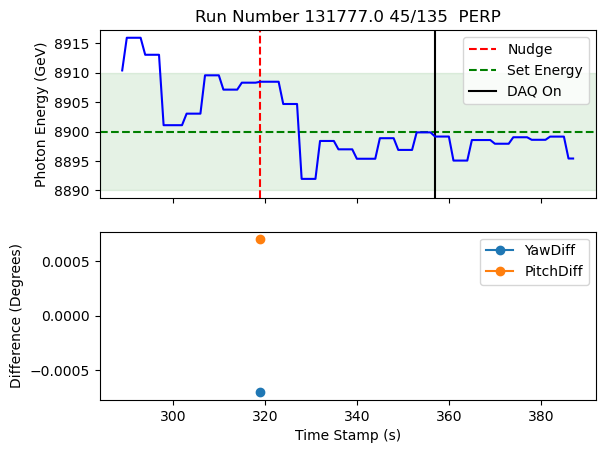

plotting for run  131801.0
Nudge number 2 occurs at time 229.0
daq on at time 266.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    98
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4913
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

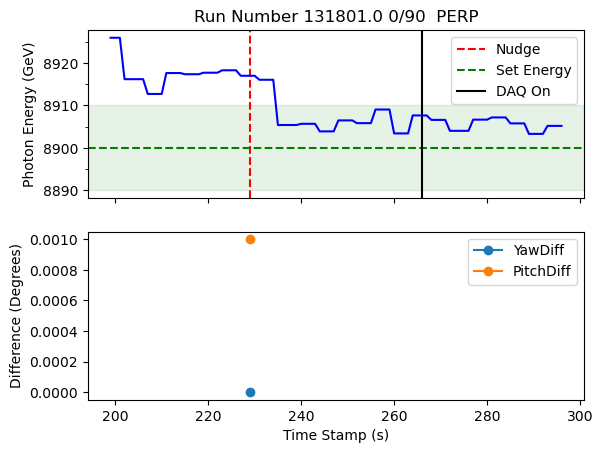

plotting for run  131807.0
Nudge number 2 occurs at time 227.0
Nudge number 3 occurs at time 249.0
Nudge number 4 occurs at time 259.0
Nudge number 5 occurs at time 280.0
Nudge number 6 occurs at time 300.0
daq on at time 133.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    189
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6813
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

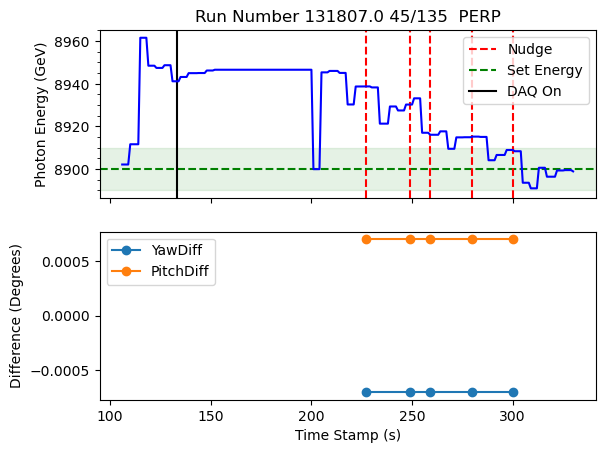

plotting for run  131816.0
Nudge number 2 occurs at time 341.0
Nudge number 3 occurs at time 348.0
Nudge number 4 occurs at time 351.0
Nudge number 5 occurs at time 362.0
Nudge number 6 occurs at time 364.0
Nudge number 7 occurs at time 369.0
Nudge number 8 occurs at time 371.0
Nudge number 9 occurs at time 914.0
daq on at time 397.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    590
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5749
 0.0       88
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

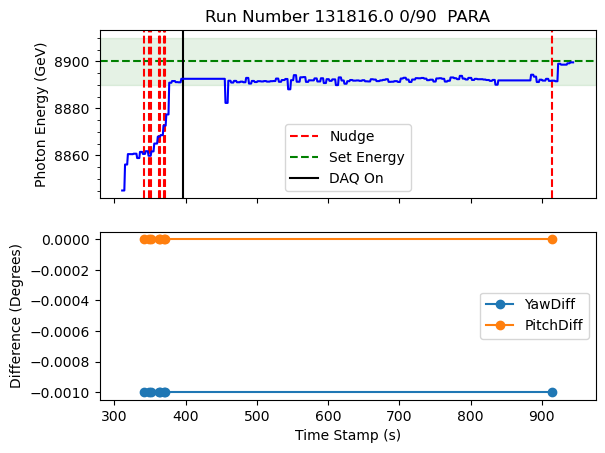

plotting for run  131819.0
Nudge number 1 occurs at time 206.0
Nudge number 2 occurs at time 208.0
Nudge number 3 occurs at time 216.0
Nudge number 4 occurs at time 222.0
daq on at time 182.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    101
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6267
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

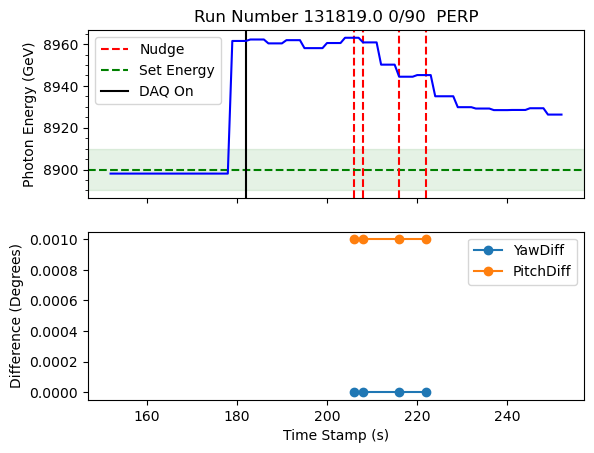

plotting for run  131820.0
Nudge number 1 occurs at time 121.0
Nudge number 2 occurs at time 122.0
daq on at time 113.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    70
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4814
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

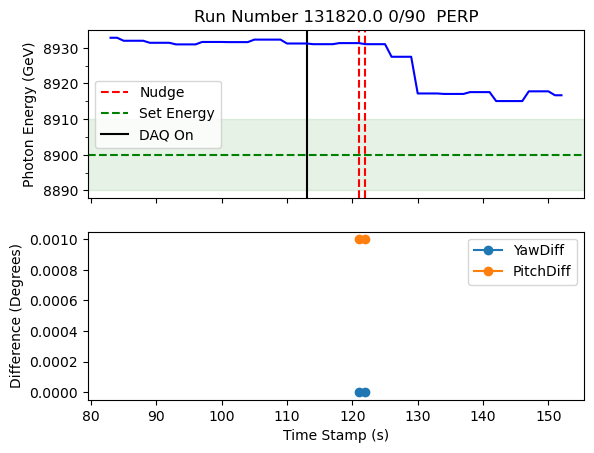

plotting for run  131825.0
Nudge number 5 occurs at time 235.0
Nudge number 6 occurs at time 249.0
Nudge number 7 occurs at time 257.0
Nudge number 8 occurs at time 265.0
Nudge number 9 occurs at time 283.0
Nudge number 10 occurs at time 334.0
daq on at time 470.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    285
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    2573
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

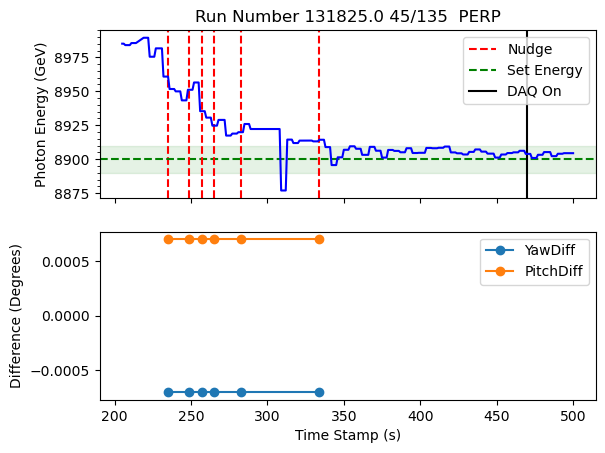

plotting for run  131829.0
Nudge number 0 occurs at time 114.0
Nudge number 2 occurs at time 651.0
Nudge number 3 occurs at time 663.0
daq on at time 686.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    321
 0.0      12
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    2021
 0.0       70
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

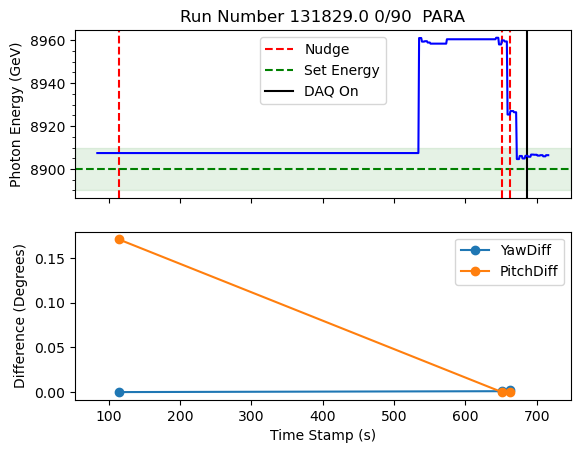

plotting for run  131835.0
Nudge number 2 occurs at time 298.0
Nudge number 3 occurs at time 302.0
Nudge number 4 occurs at time 318.0
Nudge number 5 occurs at time 336.0
Nudge number 6 occurs at time 349.0
Nudge number 7 occurs at time 362.0
Nudge number 8 occurs at time 457.0
Nudge number 9 occurs at time 479.0
Nudge number 10 occurs at time 609.0
Nudge number 11 occurs at time 612.0
Nudge number 12 occurs at time 624.0
Nudge number 13 occurs at time 646.0
Nudge number 14 occurs at time 670.0
Nudge number 15 occurs at time 695.0
Nudge number 16 occurs at time 703.0
Nudge number 20 occurs at time 742.0
Nudge number 22 occurs at time 12500.0
Nudge number 23 occurs at time 12506.0
Nudge number 24 occurs at time 12515.0
Nudge number 25 occurs at time 12606.0
Nudge number 26 occurs at time 12608.0
Nudge number 27 occurs at time 12610.0
Nudge number 28 occurs at time 12613.0
Nudge number 29 occurs at time 12620.0
Nudge number 30 occurs at time 12638.0
Nudge number 31 occurs at time 12647.0

<Figure size 640x480 with 0 Axes>

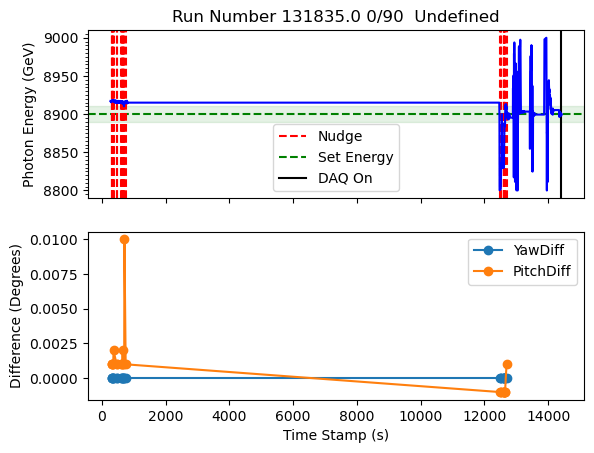

plotting for run  131840.0
daq on at time 0.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    1
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5067
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

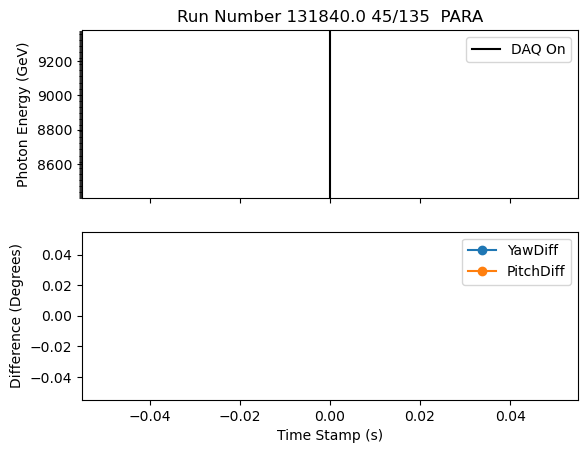

plotting for run  131863.0
Nudge number 2 occurs at time 165.0
Nudge number 3 occurs at time 183.0
Nudge number 4 occurs at time 223.0
Nudge number 5 occurs at time 247.0
daq on at time 418.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    314
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    3412
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

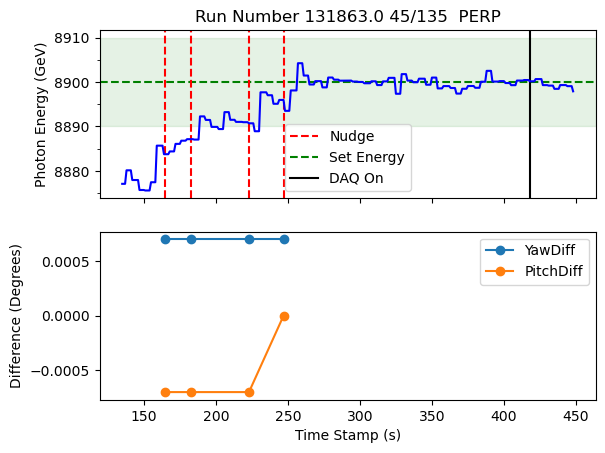

plotting for run  131866.0
Nudge number 1 occurs at time 689.0
daq on at time 44.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    645
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    690
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

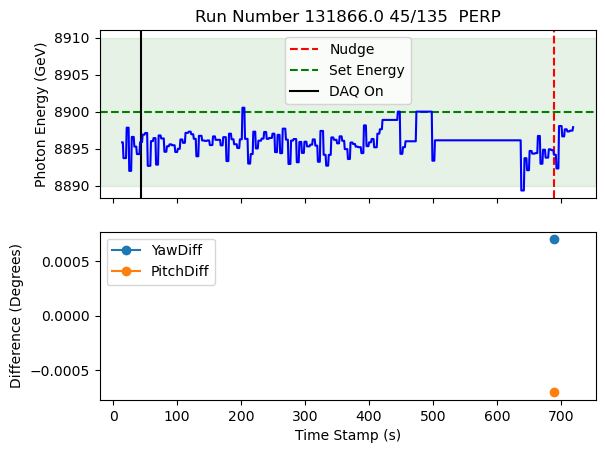

plotting for run  131870.0
Nudge number 1 occurs at time 171.0
daq on at time 95.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    137
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    1101
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

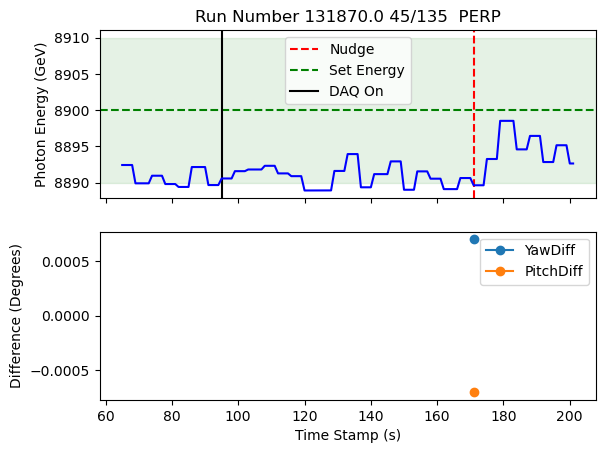

plotting for run  131874.0
Nudge number 2 occurs at time 343.0
daq on at time 391.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    109
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    2506
 0.0      129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

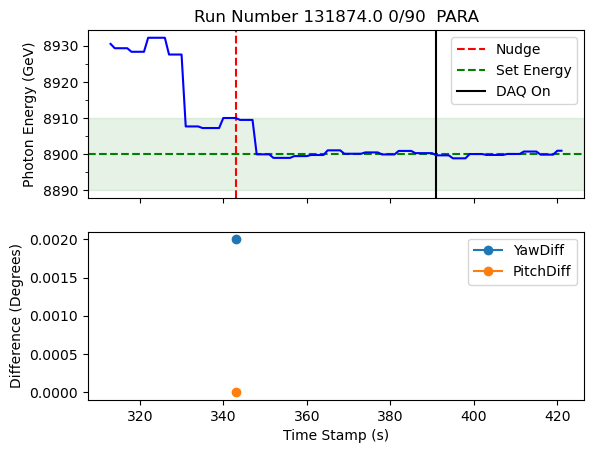

plotting for run  131881.0
Nudge number 2 occurs at time 233.0
daq on at time 168.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    105
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7259
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

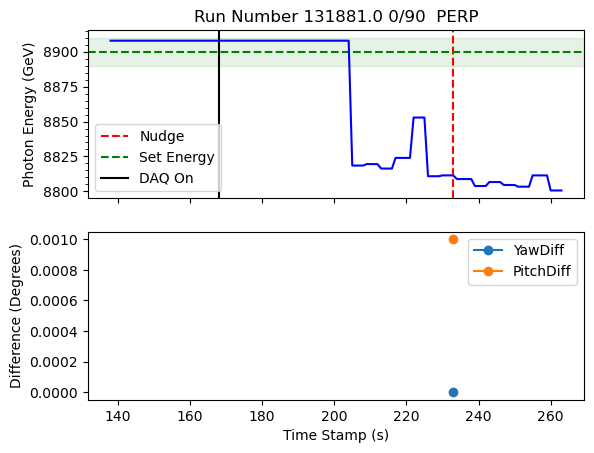

plotting for run  131887.0
Nudge number 2 occurs at time 257.0
Nudge number 3 occurs at time 261.0
Nudge number 4 occurs at time 262.0
Nudge number 5 occurs at time 267.0
Nudge number 6 occurs at time 268.0
Nudge number 7 occurs at time 274.0
Nudge number 8 occurs at time 278.0
Nudge number 9 occurs at time 280.0
Nudge number 10 occurs at time 282.0
daq on at time 275.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    86
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6111
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

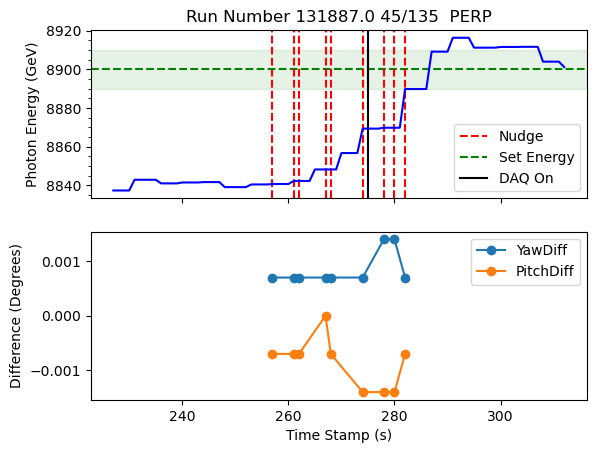

plotting for run  131890.0
Nudge number 3 occurs at time 368.0
Nudge number 4 occurs at time 373.0
daq on at time 478.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    171
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    1297
 0.0       72
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

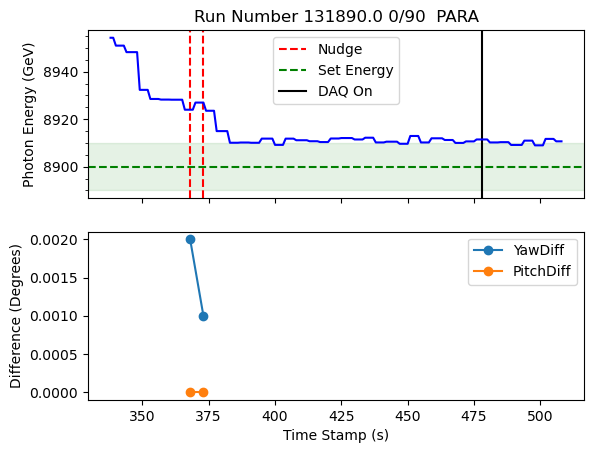

plotting for run  131891.0
Nudge number 1 occurs at time 7577.0
daq on at time 143.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    7399
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7635
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

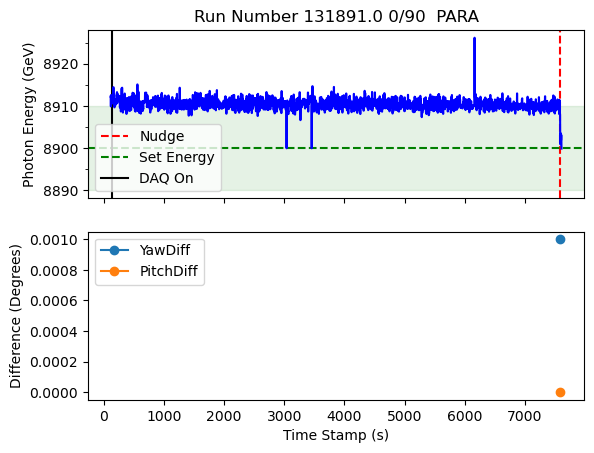

plotting for run  131894.0
daq on at time 278.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    309
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7693
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

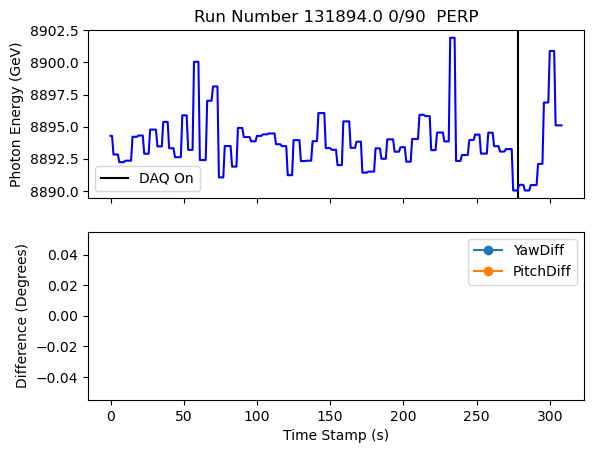

plotting for run  131904.0
Nudge number 2 occurs at time 448.0
Nudge number 3 occurs at time 454.0
Nudge number 4 occurs at time 457.0
Nudge number 8 occurs at time 543.0
Nudge number 9 occurs at time 555.0
Nudge number 10 occurs at time 556.0
Nudge number 11 occurs at time 570.0
Nudge number 12 occurs at time 594.0
Nudge number 13 occurs at time 617.0
daq on at time 414.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    264
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4419
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

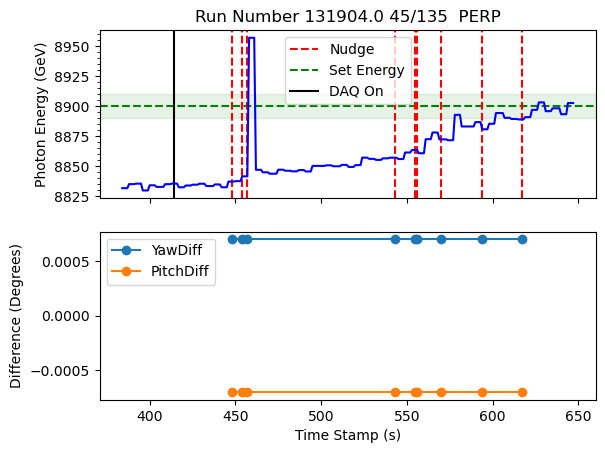

plotting for run  131905.0
Nudge number 1 occurs at time 6119.0
daq on at time 2490.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    3604
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6050
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

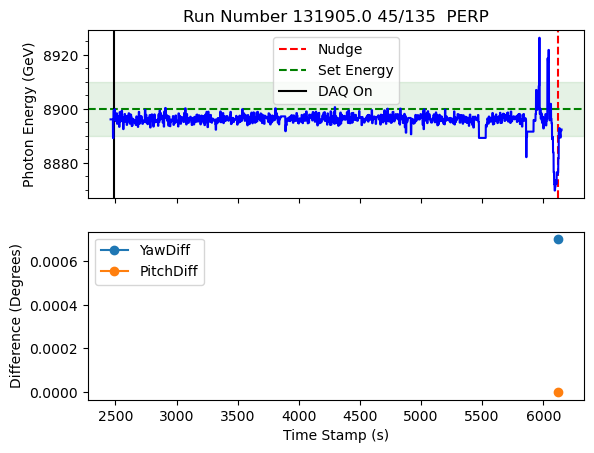

plotting for run  131908.0
Nudge number 2 occurs at time 672.0
Nudge number 3 occurs at time 698.0
Nudge number 4 occurs at time 729.0
daq on at time 848.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    202
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3316
 0.0      221
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

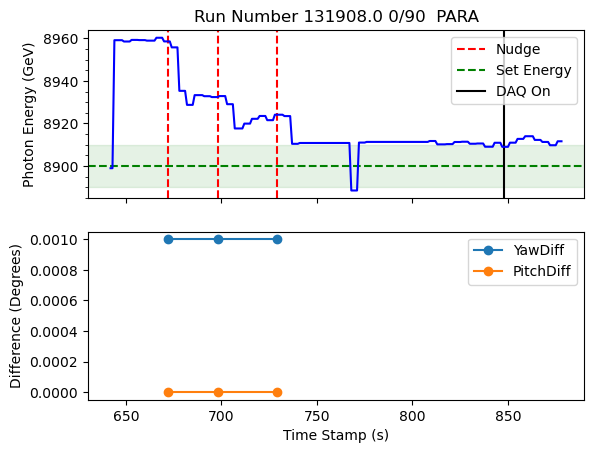

plotting for run  131918.0
Nudge number 2 occurs at time 159.0
Nudge number 3 occurs at time 178.0
Nudge number 4 occurs at time 207.0
daq on at time 285.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    187
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    502
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

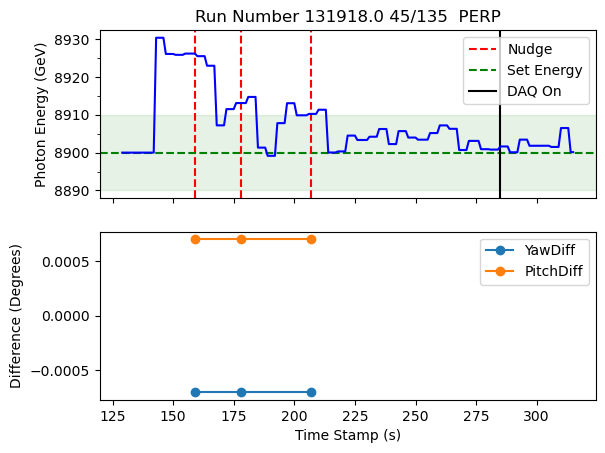

plotting for run  131921.0
daq on at time 221.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    201
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    3726
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

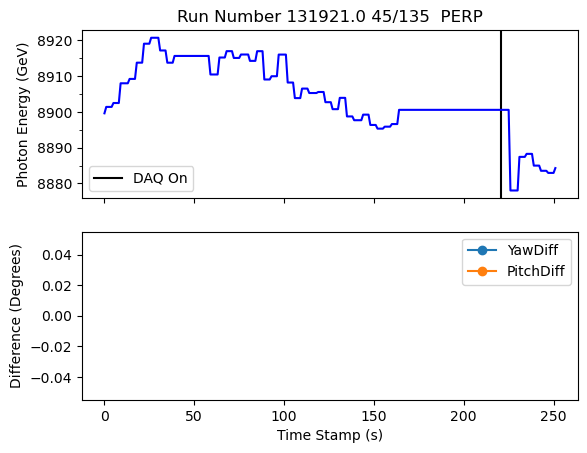

plotting for run  131925.0
Nudge number 2 occurs at time 1700.0
Nudge number 3 occurs at time 1701.0
Nudge number 4 occurs at time 1702.0
Nudge number 5 occurs at time 1703.0
daq on at time 1614.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    108
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5505
 0.0      143
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

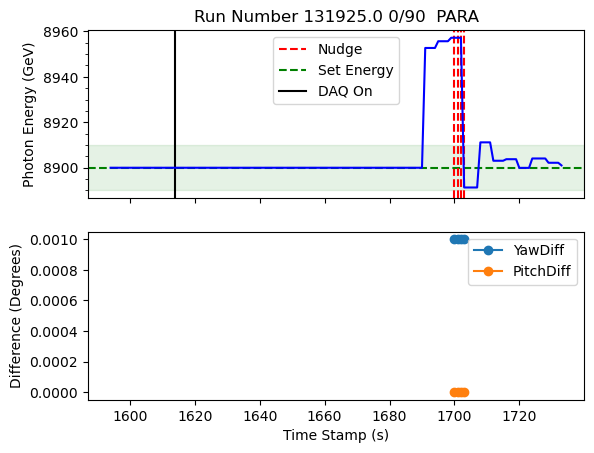

plotting for run  131932.0
Nudge number 5 occurs at time 218.0
Nudge number 6 occurs at time 236.0
Nudge number 7 occurs at time 258.0
Nudge number 8 occurs at time 280.0
daq on at time 333.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    176
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    7358
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

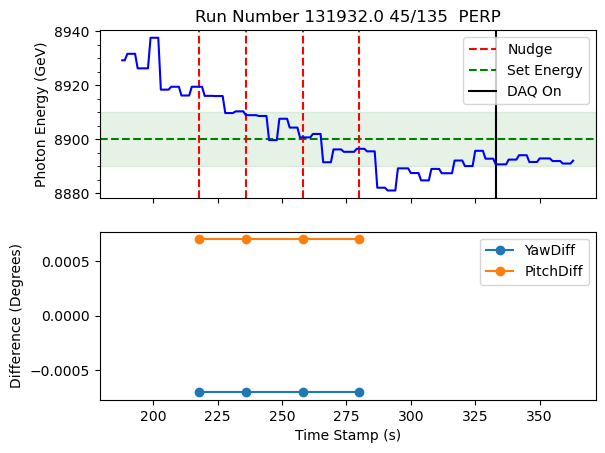

plotting for run  131937.0
daq on at time 341.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    339
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6900
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

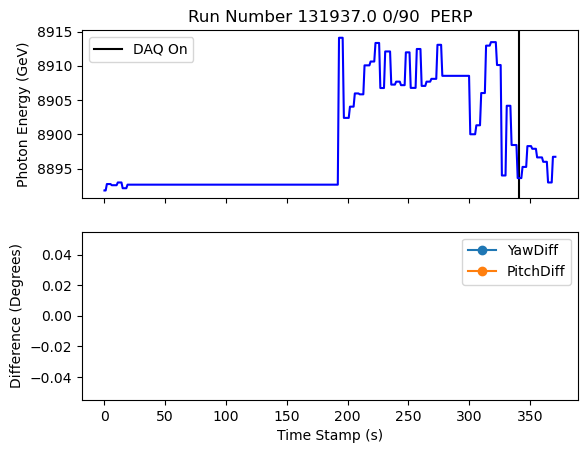

plotting for run  131946.0
daq on at time 7639.0
[0. 1.]
plane_values are 0    0.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    0.0
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
0.0     3656
28.4     447
Name: count, dtype: int64
roll values are GONI:ROLL
0.0     3656
28.4     906
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

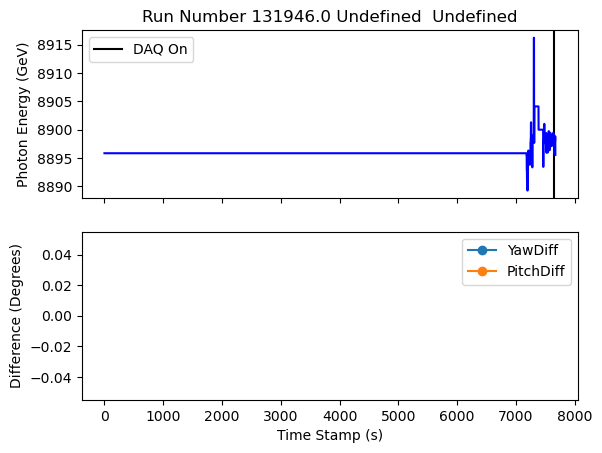

plotting for run  131953.0
Nudge number 2 occurs at time 616.0
Nudge number 3 occurs at time 619.0
Nudge number 4 occurs at time 625.0
Nudge number 7 occurs at time 652.0
Nudge number 8 occurs at time 657.0
Nudge number 9 occurs at time 669.0
Nudge number 10 occurs at time 672.0
Nudge number 11 occurs at time 680.0
Nudge number 12 occurs at time 684.0
Nudge number 13 occurs at time 692.0
Nudge number 16 occurs at time 749.0
Nudge number 17 occurs at time 773.0
daq on at time 829.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    274
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5314
 0.0      107
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

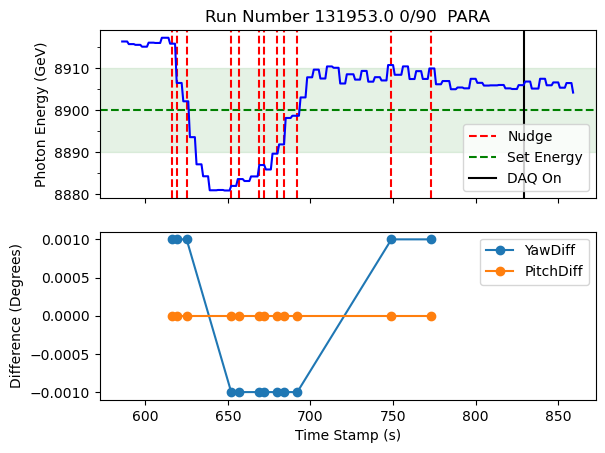

plotting for run  131956.0
Nudge number 1 occurs at time 2133.0
daq on at time 112.0
[1. 0.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    799
-16.6     65
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    822
-16.6     65
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

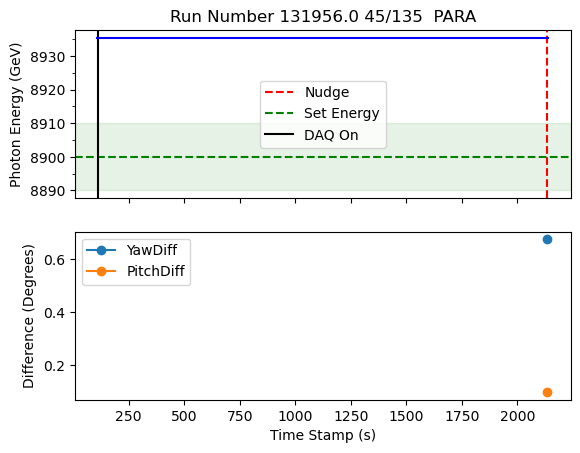

plotting for run  131964.0
Nudge number 5 occurs at time 300.0
daq on at time 0.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    282
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    678
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

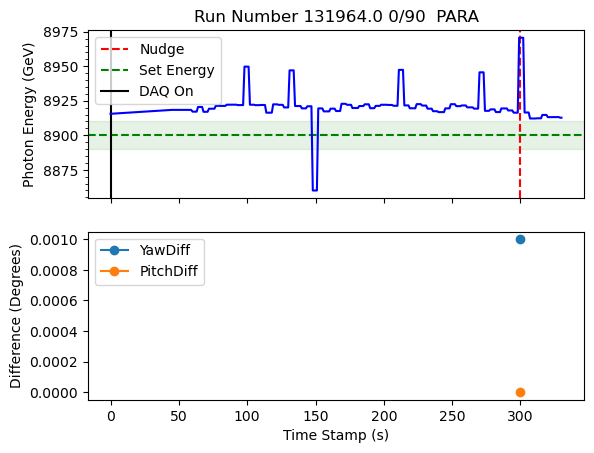

plotting for run  131968.0
Nudge number 2 occurs at time 207.0
Nudge number 5 occurs at time 304.0
daq on at time 434.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    288
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7319
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

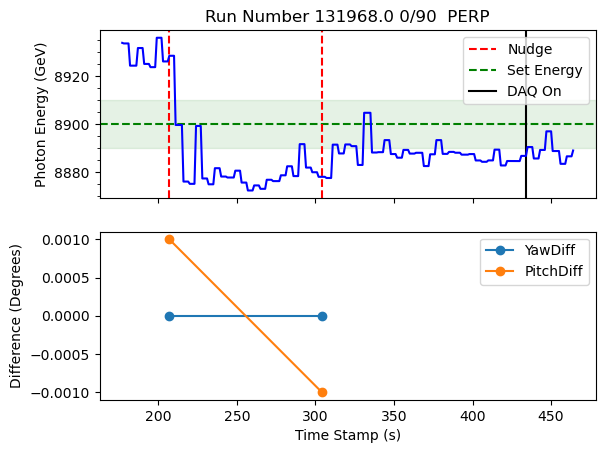

plotting for run  131974.0
Nudge number 5 occurs at time 406.0
Nudge number 6 occurs at time 417.0
Nudge number 7 occurs at time 418.0
Nudge number 8 occurs at time 437.0
daq on at time 540.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    188
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4260
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

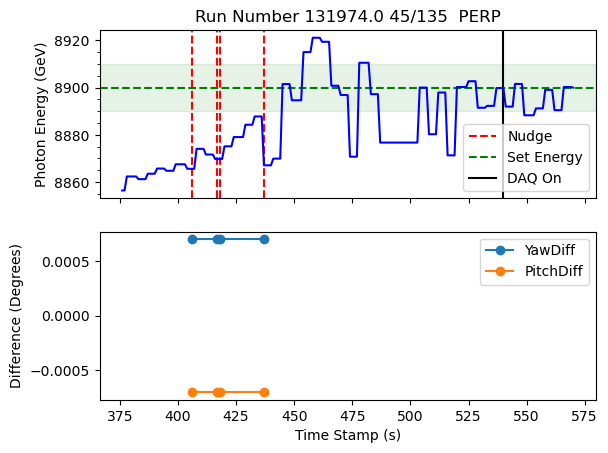

plotting for run  131992.0
Nudge number 1 occurs at time 9.0
Nudge number 2 occurs at time 28.0
Nudge number 3 occurs at time 50.0
Nudge number 4 occurs at time 103.0
Nudge number 5 occurs at time 104.0
Nudge number 6 occurs at time 177.0
daq on at time 302.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    322
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4661
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

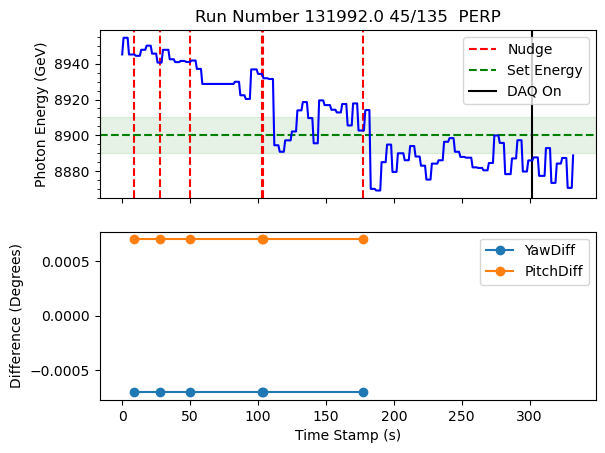

plotting for run  131996.0
Nudge number 2 occurs at time 584.0
Nudge number 3 occurs at time 623.0
Nudge number 4 occurs at time 732.0
Nudge number 5 occurs at time 765.0
daq on at time 860.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    316
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6975
 0.0      118
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

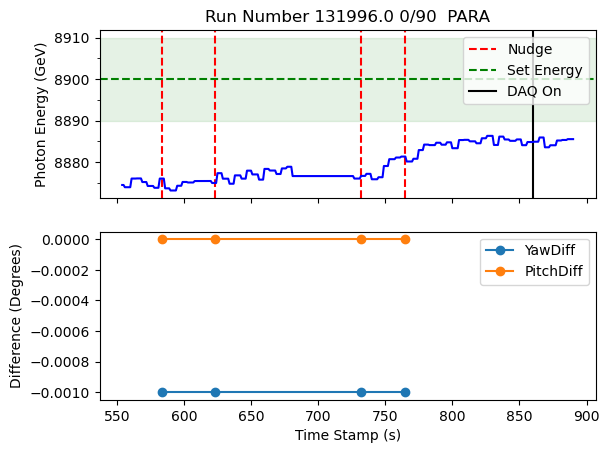

plotting for run  131998.0
Nudge number 1 occurs at time 133.0
Nudge number 2 occurs at time 139.0
Nudge number 3 occurs at time 142.0
Nudge number 4 occurs at time 154.0
Nudge number 5 occurs at time 156.0
Nudge number 6 occurs at time 174.0
Nudge number 7 occurs at time 177.0
daq on at time 215.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    143
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5393
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

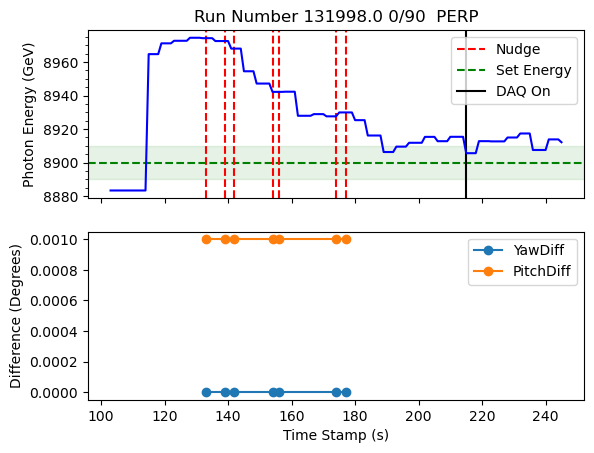

plotting for run  132001.0
daq on at time 487.0
[2. 0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    338
-16.6     79
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    5795
-16.6      79
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

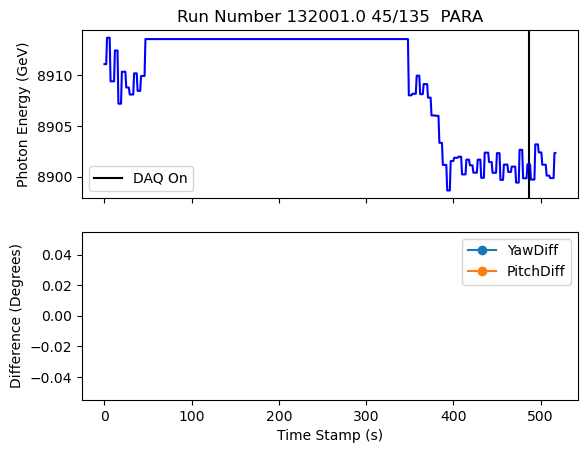

plotting for run  132003.0
Nudge number 2 occurs at time 255.0
daq on at time 375.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    142
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5662
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

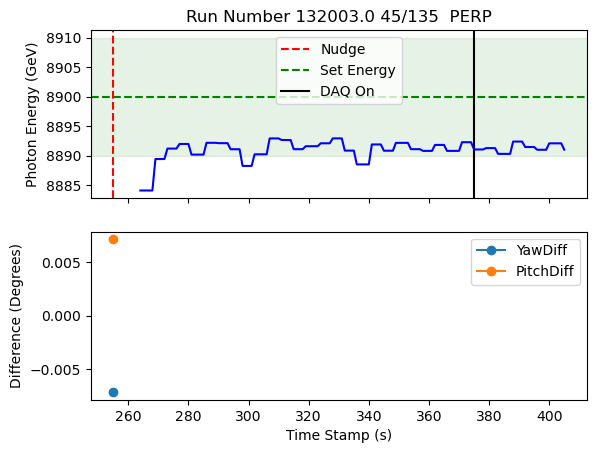

plotting for run  132004.0
Nudge number 5 occurs at time 728.0
Nudge number 6 occurs at time 729.0
Nudge number 7 occurs at time 741.0
daq on at time 852.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    185
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6236
0.0      123
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

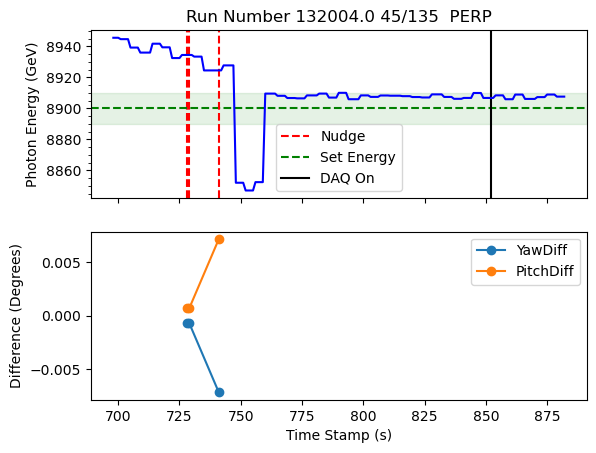

plotting for run  132006.0
Nudge number 2 occurs at time 775.0
daq on at time 836.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    97
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7156
 0.0       92
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

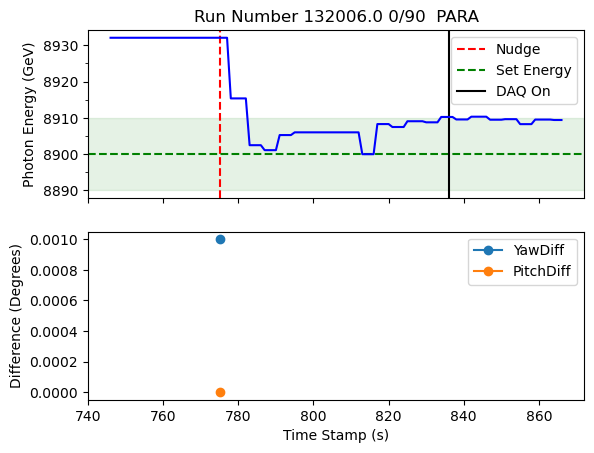

plotting for run  132009.0
Nudge number 5 occurs at time 419.0
Nudge number 6 occurs at time 430.0
Nudge number 7 occurs at time 442.0
Nudge number 8 occurs at time 483.0
Nudge number 9 occurs at time 498.0
Nudge number 10 occurs at time 511.0
Nudge number 11 occurs at time 525.0
Nudge number 12 occurs at time 554.0
daq on at time 139.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    453
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3212
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

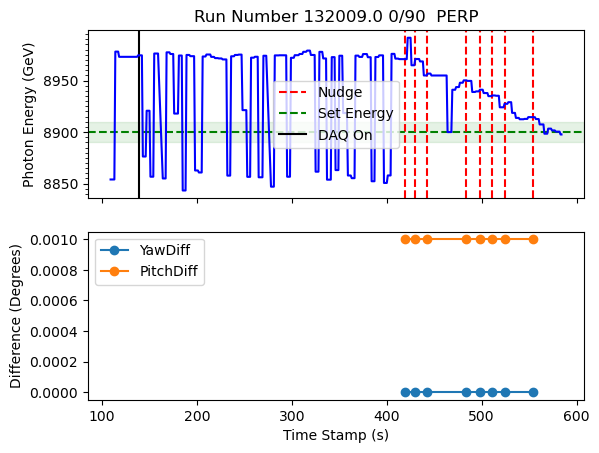

plotting for run  132010.0
Nudge number 4 occurs at time 11437.0
Nudge number 5 occurs at time 11442.0
Nudge number 6 occurs at time 11445.0
Nudge number 7 occurs at time 11447.0
Nudge number 8 occurs at time 11450.0
Nudge number 9 occurs at time 11451.0
Nudge number 12 occurs at time 11670.0
Nudge number 13 occurs at time 11696.0
daq on at time 12035.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    659
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7928
 0.0     3625
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

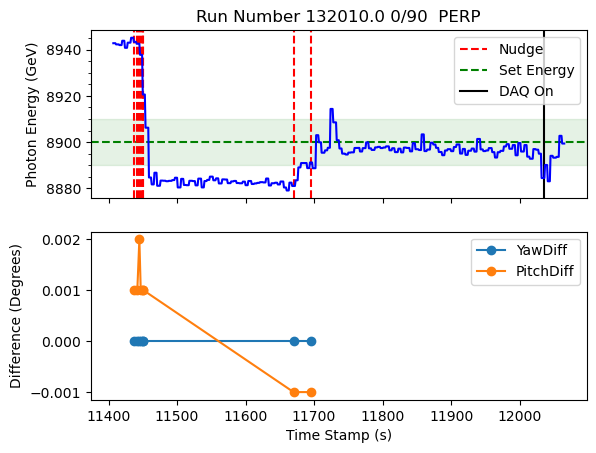

plotting for run  132017.0
daq on at time 292.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    289
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5728
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

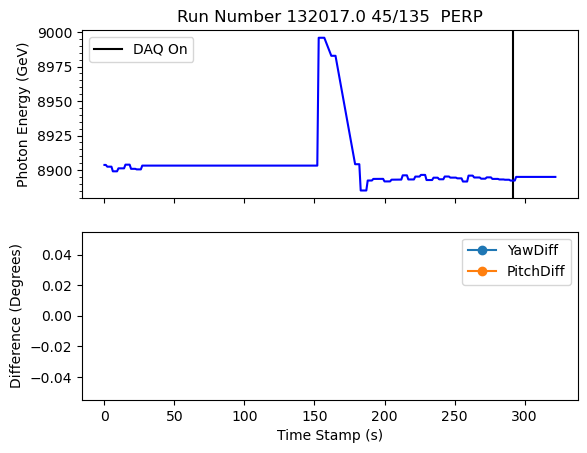

plotting for run  132021.0
Nudge number 2 occurs at time 531.0
daq on at time 686.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    213
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6649
 0.0      210
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

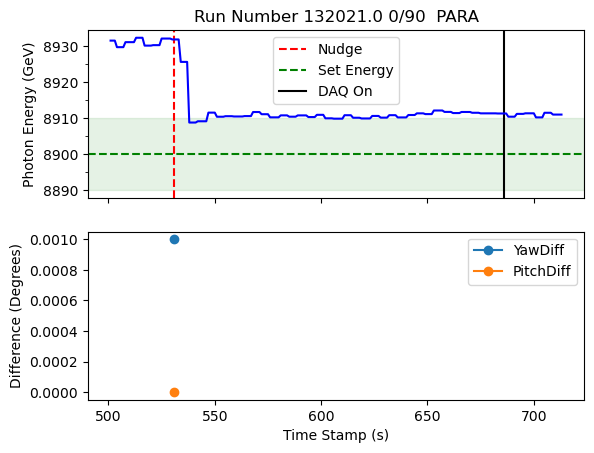

plotting for run  132024.0
Nudge number 2 occurs at time 481.0
Nudge number 3 occurs at time 509.0
daq on at time 634.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    214
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7302
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

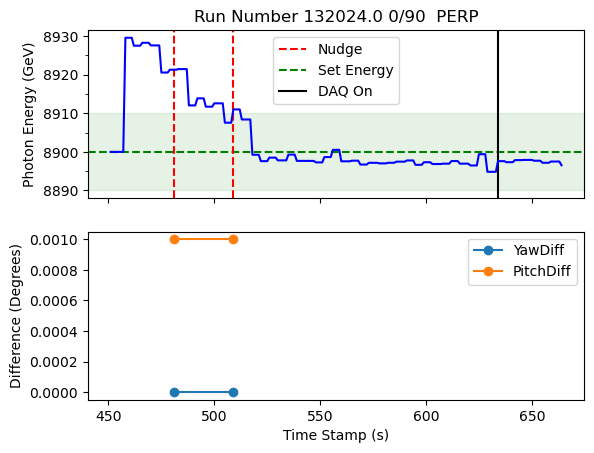

plotting for run  132033.0
Nudge number 5 occurs at time 277.0
Nudge number 6 occurs at time 282.0
Nudge number 7 occurs at time 286.0
Nudge number 8 occurs at time 294.0
Nudge number 9 occurs at time 303.0
Nudge number 10 occurs at time 327.0
Nudge number 11 occurs at time 388.0
daq on at time 751.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    535
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6057
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

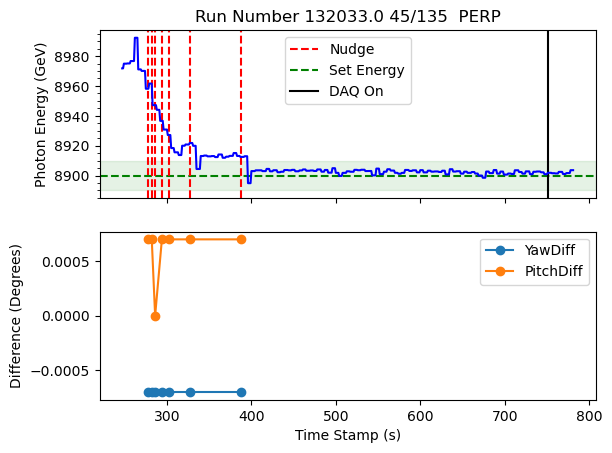

plotting for run  132039.0
Nudge number 2 occurs at time 381.0
Nudge number 3 occurs at time 385.0
Nudge number 4 occurs at time 387.0
Nudge number 5 occurs at time 390.0
Nudge number 6 occurs at time 402.0
Nudge number 7 occurs at time 410.0
Nudge number 8 occurs at time 412.0
Nudge number 9 occurs at time 420.0
Nudge number 10 occurs at time 423.0
Nudge number 11 occurs at time 425.0
Nudge number 12 occurs at time 427.0
Nudge number 13 occurs at time 431.0
Nudge number 14 occurs at time 445.0
Nudge number 15 occurs at time 481.0
Nudge number 18 occurs at time 555.0
Nudge number 19 occurs at time 556.0
Nudge number 20 occurs at time 561.0
Nudge number 21 occurs at time 585.0
Nudge number 22 occurs at time 592.0
Nudge number 23 occurs at time 597.0
Nudge number 24 occurs at time 609.0
Nudge number 25 occurs at time 617.0
Nudge number 26 occurs at time 624.0
Nudge number 27 occurs at time 777.0
Nudge number 28 occurs at time 795.0
Nudge number 29 occurs at time 884.0
Nudge number 30 occ

<Figure size 640x480 with 0 Axes>

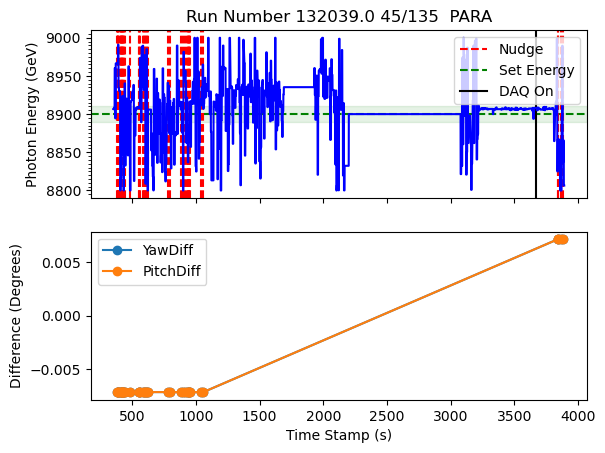

plotting for run  132045.0
Nudge number 1 occurs at time 94.0
daq on at time 746.0
[1. 0.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    318
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    640
 0.0      55
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

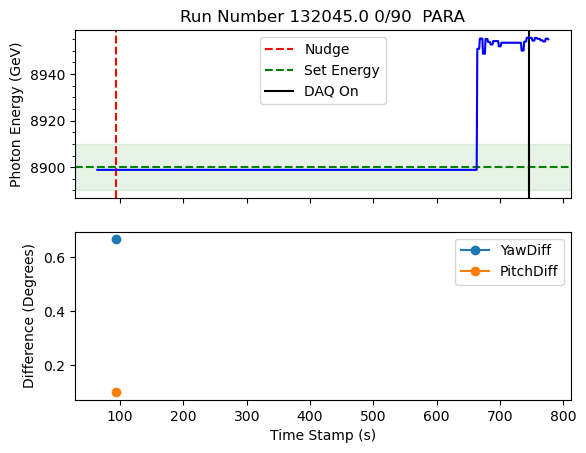

plotting for run  132048.0
Nudge number 1 occurs at time 178.0
Nudge number 2 occurs at time 182.0
Nudge number 3 occurs at time 204.0
Nudge number 4 occurs at time 230.0
daq on at time 0.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    217
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6535
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

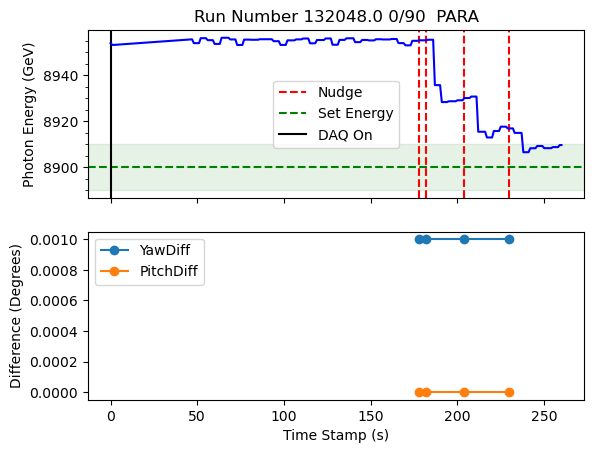

plotting for run  132052.0
Nudge number 1 occurs at time 6171.0
Nudge number 2 occurs at time 6179.0
Nudge number 3 occurs at time 6189.0
daq on at time 326.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    5028
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6554
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

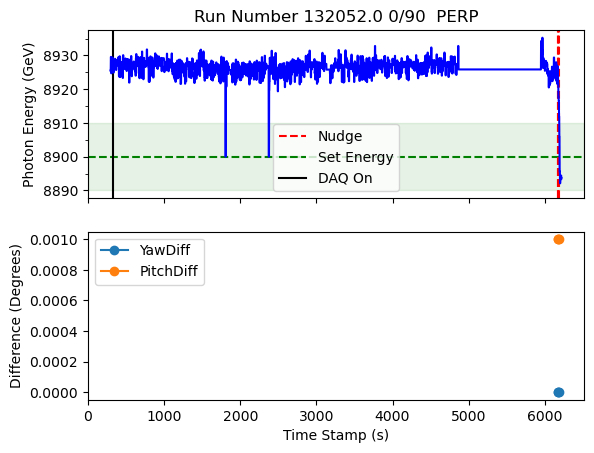

plotting for run  132058.0
Nudge number 1 occurs at time 2421.0
Nudge number 2 occurs at time 2425.0
Nudge number 3 occurs at time 2428.0
Nudge number 4 occurs at time 2431.0
Nudge number 5 occurs at time 2435.0
Nudge number 6 occurs at time 2438.0
Nudge number 7 occurs at time 2441.0
Nudge number 8 occurs at time 2459.0
Nudge number 9 occurs at time 2463.0
Nudge number 10 occurs at time 2466.0
Nudge number 11 occurs at time 2469.0
Nudge number 12 occurs at time 2473.0
Nudge number 13 occurs at time 2476.0
Nudge number 14 occurs at time 2479.0
Nudge number 15 occurs at time 2483.0
Nudge number 16 occurs at time 2486.0
Nudge number 17 occurs at time 2489.0
Nudge number 18 occurs at time 2493.0
Nudge number 19 occurs at time 2496.0
Nudge number 20 occurs at time 2499.0
Nudge number 21 occurs at time 2503.0
Nudge number 22 occurs at time 2506.0
Nudge number 23 occurs at time 2510.0
Nudge number 24 occurs at time 2513.0
Nudge number 25 occurs at time 2516.0
Nudge number 26 occurs at time 2

<Figure size 640x480 with 0 Axes>

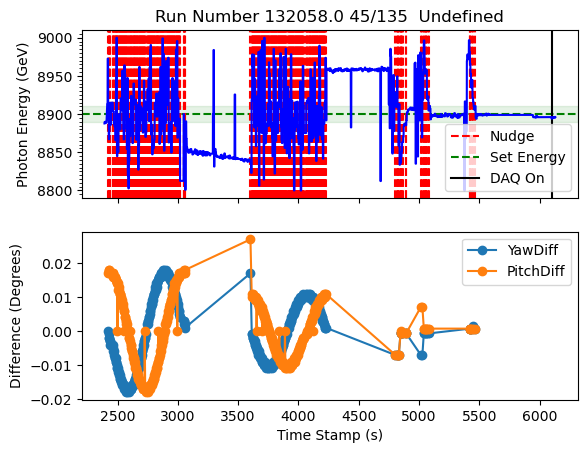

plotting for run  132061.0
Nudge number 5 occurs at time 1570.0
daq on at time 628.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    992
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5987
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

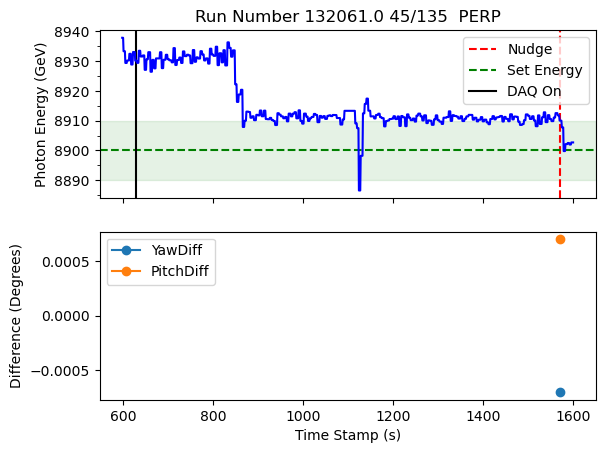

plotting for run  132071.0
Nudge number 2 occurs at time 529.0
Nudge number 3 occurs at time 536.0
daq on at time 577.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    109
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    6964
-16.6     102
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

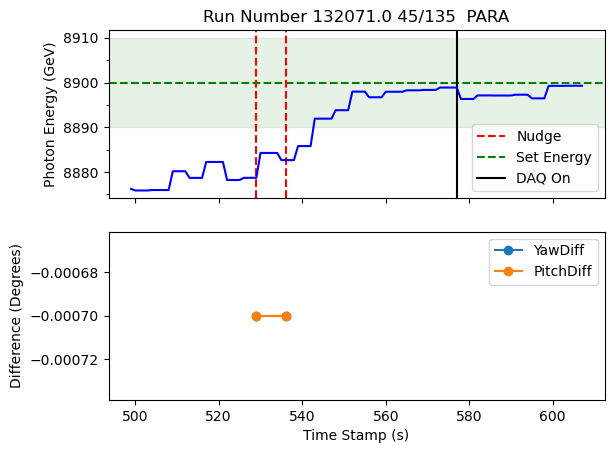

plotting for run  132088.0
Nudge number 2 occurs at time 1802.0
Nudge number 3 occurs at time 1807.0
Nudge number 4 occurs at time 1811.0
Nudge number 5 occurs at time 1814.0
Nudge number 6 occurs at time 1818.0
Nudge number 7 occurs at time 1821.0
Nudge number 8 occurs at time 1824.0
Nudge number 9 occurs at time 1828.0
Nudge number 10 occurs at time 1831.0
Nudge number 11 occurs at time 1835.0
Nudge number 12 occurs at time 1838.0
Nudge number 13 occurs at time 1841.0
Nudge number 14 occurs at time 1845.0
Nudge number 15 occurs at time 1848.0
Nudge number 16 occurs at time 1851.0
Nudge number 17 occurs at time 1855.0
Nudge number 18 occurs at time 1858.0
Nudge number 19 occurs at time 1861.0
Nudge number 20 occurs at time 1865.0
Nudge number 21 occurs at time 1868.0
Nudge number 22 occurs at time 1871.0
Nudge number 23 occurs at time 1875.0
Nudge number 24 occurs at time 1878.0
Nudge number 25 occurs at time 1882.0
Nudge number 26 occurs at time 1885.0
Nudge number 27 occurs at time 

<Figure size 640x480 with 0 Axes>

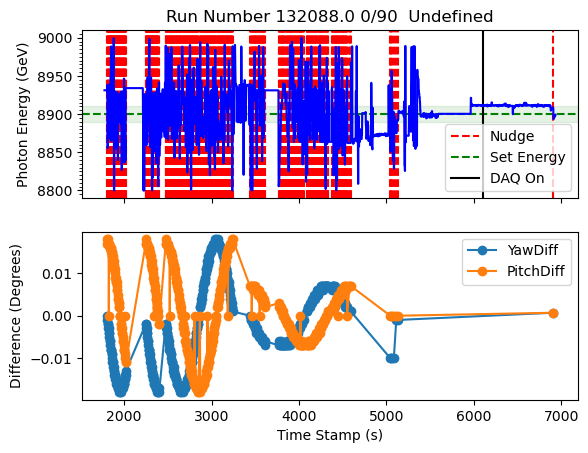

plotting for run  132093.0
Nudge number 4 occurs at time 398.0
daq on at time 407.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    70
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5891
 0.0       77
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

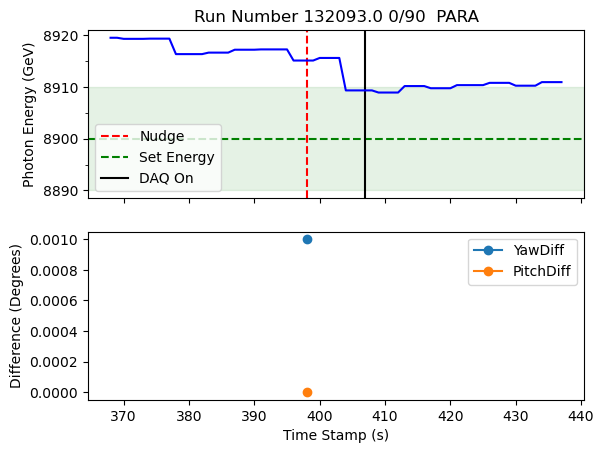

plotting for run  132095.0
Nudge number 2 occurs at time 127.0
Nudge number 3 occurs at time 129.0
Nudge number 4 occurs at time 147.0
Nudge number 5 occurs at time 148.0
daq on at time 276.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    210
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6403
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

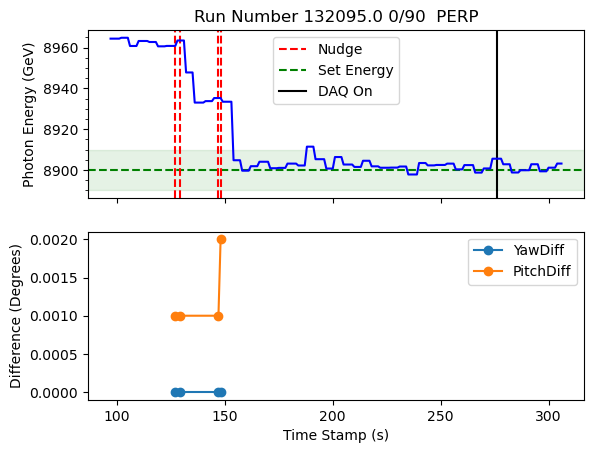

plotting for run  132100.0
daq on at time 296.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    327
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5508
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

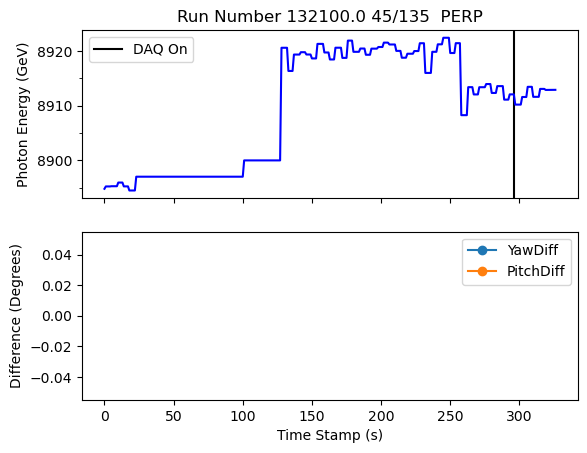

plotting for run  132108.0
Nudge number 1 occurs at time 163.0
Nudge number 2 occurs at time 361.0
Nudge number 3 occurs at time 382.0
Nudge number 4 occurs at time 401.0
Nudge number 5 occurs at time 422.0
Nudge number 6 occurs at time 461.0
daq on at time 644.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    513
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7730
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

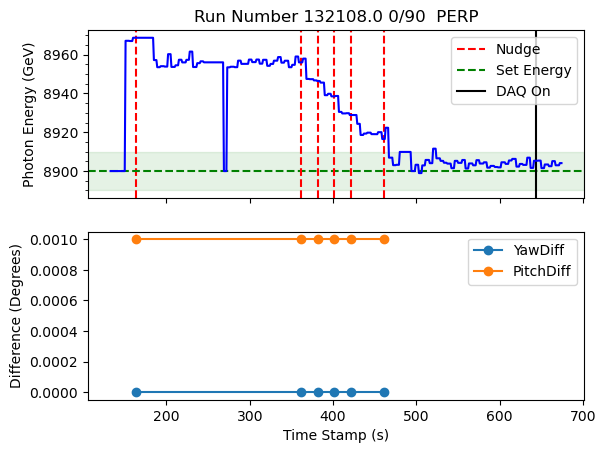

plotting for run  132110.0
Nudge number 2 occurs at time 367.0
Nudge number 3 occurs at time 376.0
daq on at time 241.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    168
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    378
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

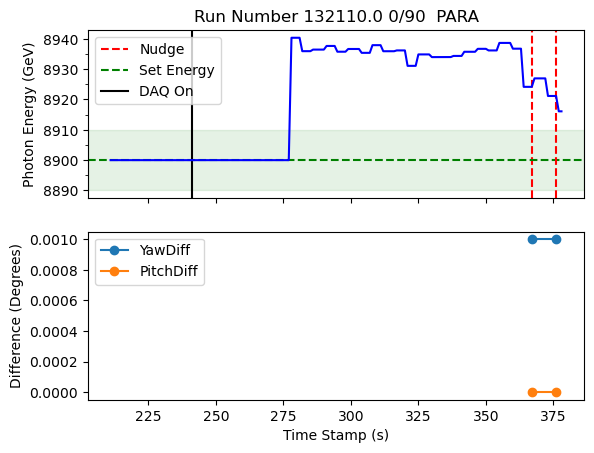

plotting for run  132111.0
Nudge number 1 occurs at time 5.0
daq on at time 124.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    155
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5637
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

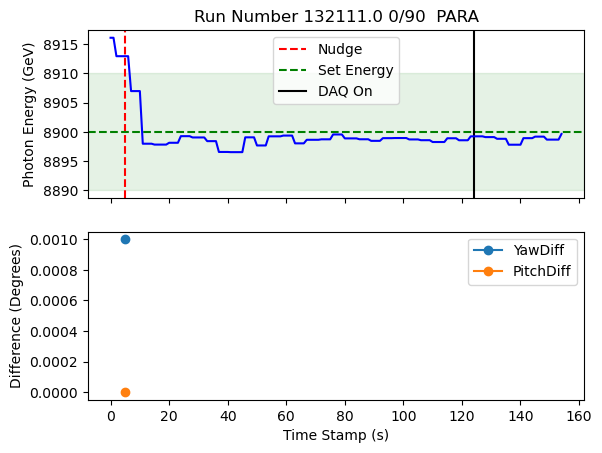

plotting for run  132112.0
Nudge number 1 occurs at time 209.0
Nudge number 2 occurs at time 439.0
Nudge number 3 occurs at time 456.0
Nudge number 4 occurs at time 467.0
Nudge number 5 occurs at time 486.0
Nudge number 6 occurs at time 3402.0
Nudge number 7 occurs at time 3425.0
daq on at time 583.0
[1. 0.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    3079
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    3115
-16.6     114
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

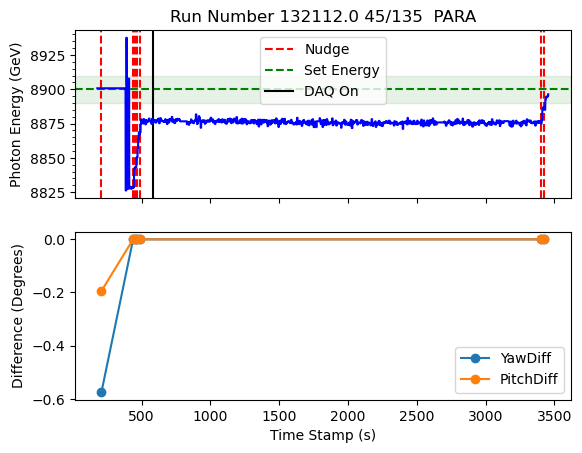

plotting for run  132113.0
Nudge number 1 occurs at time 15.0
daq on at time 309.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    327
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4621
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

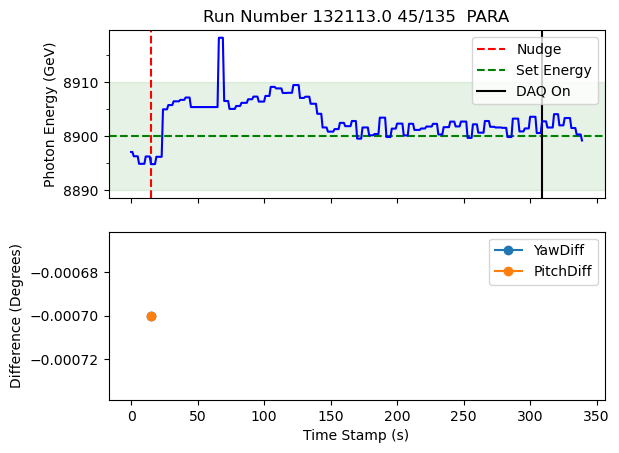

plotting for run  132126.0
Nudge number 0 occurs at time 307.0
Nudge number 3 occurs at time 1057.0
daq on at time 841.0
[0. 1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    576
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    617
 0.0     233
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

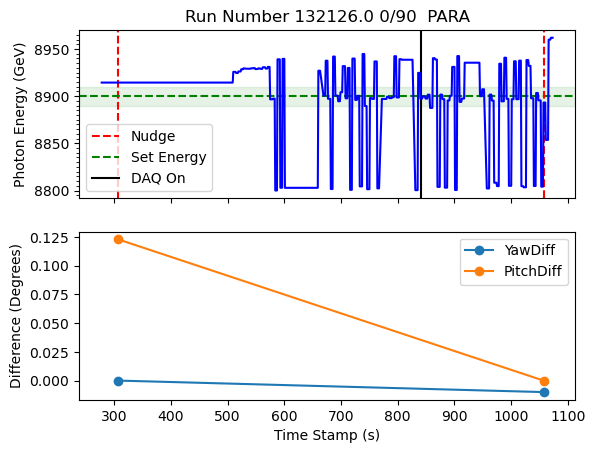

plotting for run  132127.0
Nudge number 2 occurs at time 29.0
Nudge number 3 occurs at time 35.0
daq on at time 180.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    211
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5536
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

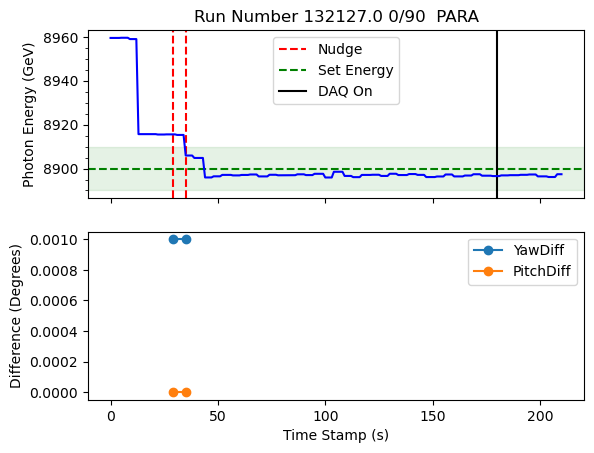

plotting for run  132132.0
Nudge number 1 occurs at time 1649.0
Nudge number 2 occurs at time 1668.0
Nudge number 3 occurs at time 1673.0
Nudge number 4 occurs at time 1678.0
Nudge number 5 occurs at time 1682.0
Nudge number 6 occurs at time 1686.0
Nudge number 7 occurs at time 1689.0
daq on at time 1827.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    226
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    1107
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

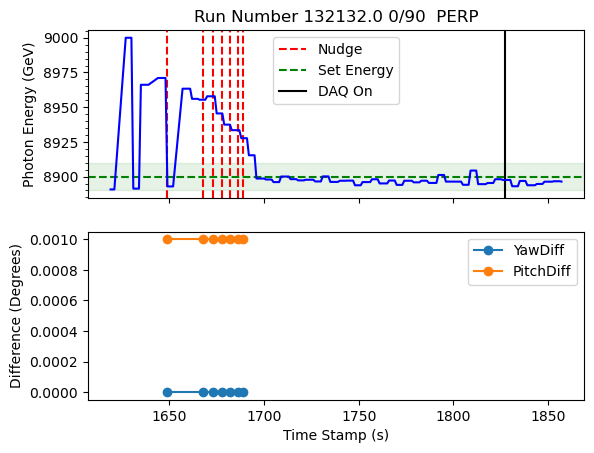

plotting for run  132137.0
daq on at time 366.0
[2. 0. 1.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
 28.4    208
-16.6    129
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    7468
-16.6     129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

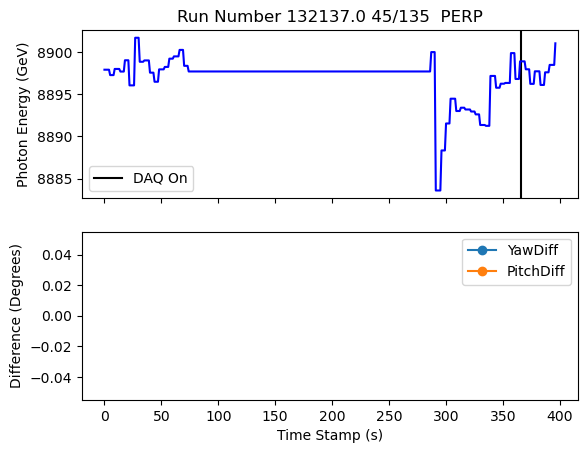

plotting for run  132139.0
daq on at time 675.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    706
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5945
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

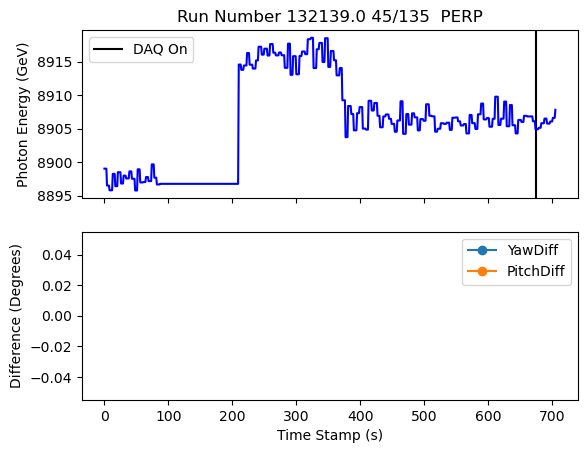

plotting for run  132142.0
Nudge number 2 occurs at time 454.0
daq on at time 505.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    112
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3015
 0.0       97
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

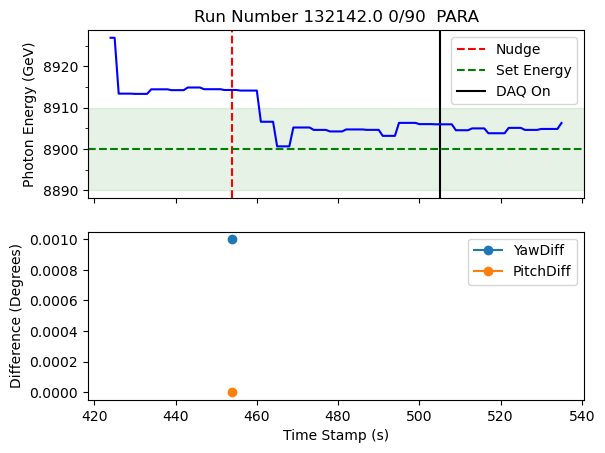

plotting for run  132145.0
Nudge number 2 occurs at time 248.0
Nudge number 3 occurs at time 269.0
Nudge number 4 occurs at time 279.0
Nudge number 5 occurs at time 280.0
Nudge number 6 occurs at time 300.0
daq on at time 327.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    140
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5796
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

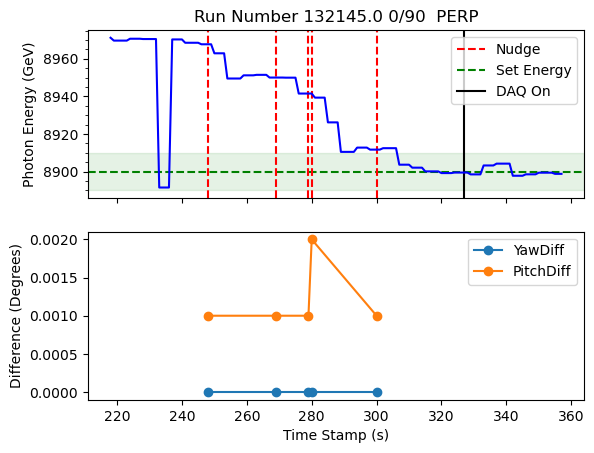

plotting for run  132152.0
daq on at time 6433.0
[1. 0. 2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    386
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    3327
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

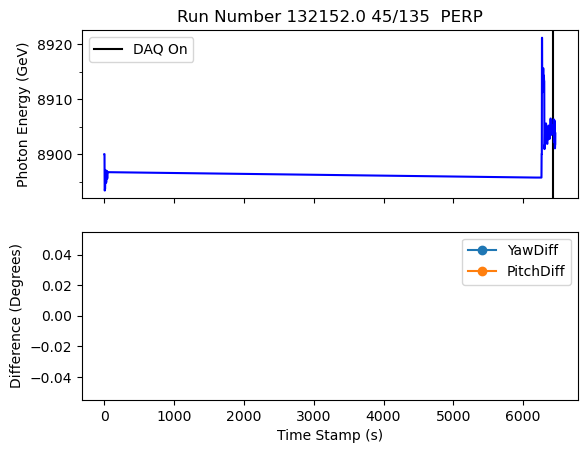

plotting for run  132158.0
Nudge number 4 occurs at time 561.0
Nudge number 5 occurs at time 599.0
Nudge number 6 occurs at time 619.0
daq on at time 737.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    237
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5849
 0.0      133
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

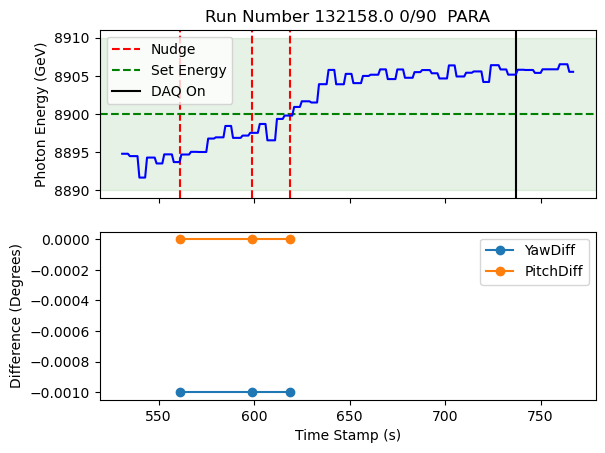

<Figure size 640x480 with 0 Axes>

In [20]:
# now for Spring 25
for runVal in nudge_list_2025:
    plot_run(df_2025_good,runVal)

plotting for run  131409
Nudge number 5 occurs at time 200.0
Nudge number 6 occurs at time 206.0
Nudge number 7 occurs at time 212.0
Nudge number 8 occurs at time 226.0
Nudge number 9 occurs at time 234.0
Nudge number 10 occurs at time 243.0
Nudge number 11 occurs at time 268.0
daq on at time 521.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    355
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    1390
Name: count, dtype: int64


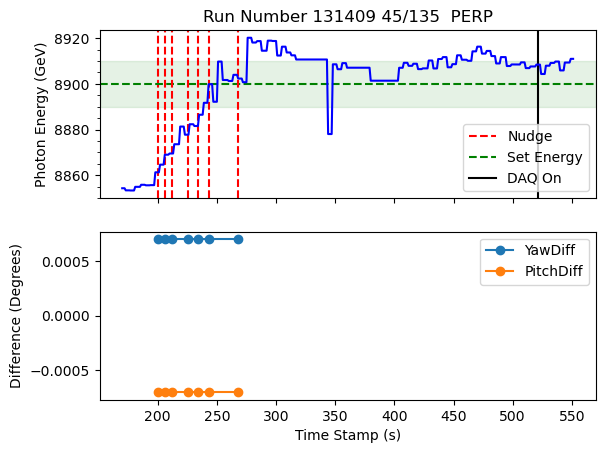

should have  [12] nudges for run 131409
energy change is 56.58399999999892
num_nudges_better is 6.9
energy change per nudge for run  131409 is 8.20057971014477
plotting for run  131662
Nudge number 4 occurs at time 970.0
Nudge number 5 occurs at time 972.0
Nudge number 6 occurs at time 973.0
daq on at time 585.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    398
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    4350
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

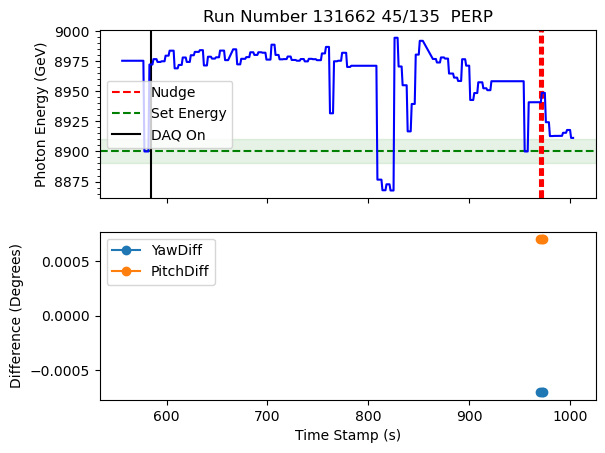

should have  [6] nudges for run 131662
energy change is 26.51749999999811
num_nudges_better is 3.0
energy change per nudge for run  131662 is 8.839166666666037
plotting for run  131703
Nudge number 2 occurs at time 4226.0
Nudge number 3 occurs at time 4228.0
Nudge number 4 occurs at time 4229.0
Nudge number 5 occurs at time 4232.0
Nudge number 6 occurs at time 4234.0
Nudge number 7 occurs at time 4236.0
Nudge number 8 occurs at time 4239.0
daq on at time 4302.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    137
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6205
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

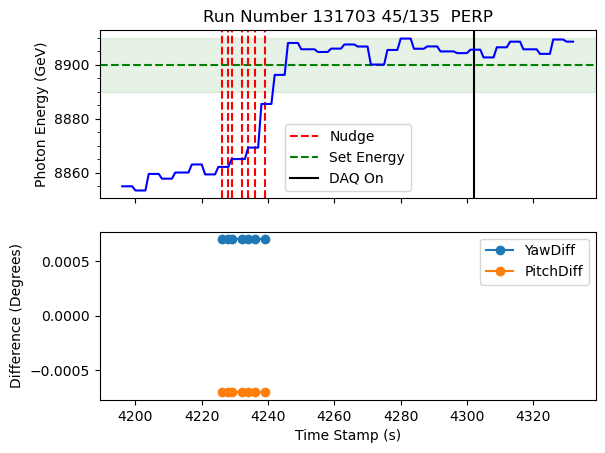

should have  [8] nudges for run 131703
energy change is 44.01800000000003
num_nudges_better is 6.9
energy change per nudge for run  131703 is 6.3794202898550765
plotting for run  131714
Nudge number 2 occurs at time 269.0
Nudge number 3 occurs at time 293.0
Nudge number 4 occurs at time 294.0
daq on at time 416.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    208
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6296
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

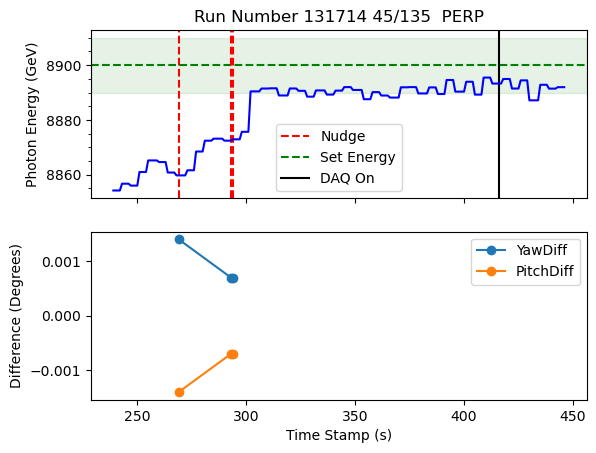

should have  [4] nudges for run 131714
energy change is 31.058000000000902
num_nudges_better is 3.0
energy change per nudge for run  131714 is 10.352666666666968
plotting for run  131734
Nudge number 4 occurs at time 1073.0
Nudge number 5 occurs at time 1090.0
Nudge number 6 occurs at time 1098.0
Nudge number 7 occurs at time 1114.0
daq on at time 394.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    776
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    7529
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

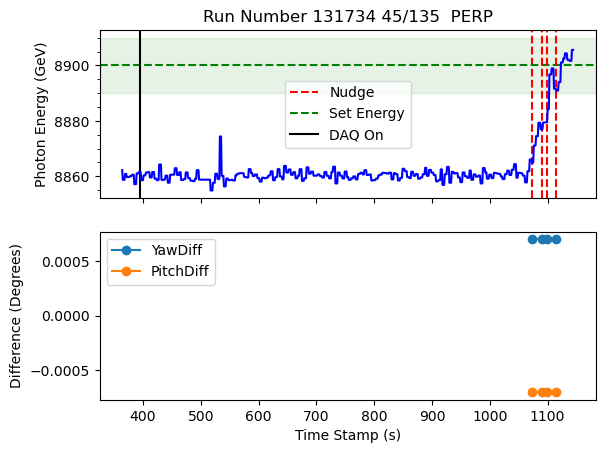

should have  [7] nudges for run 131734
energy change is 38.314000000000306
num_nudges_better is 4.0
energy change per nudge for run  131734 is 9.578500000000076
plotting for run  131777
Nudge number 4 occurs at time 319.0
daq on at time 357.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    99
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    2489
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

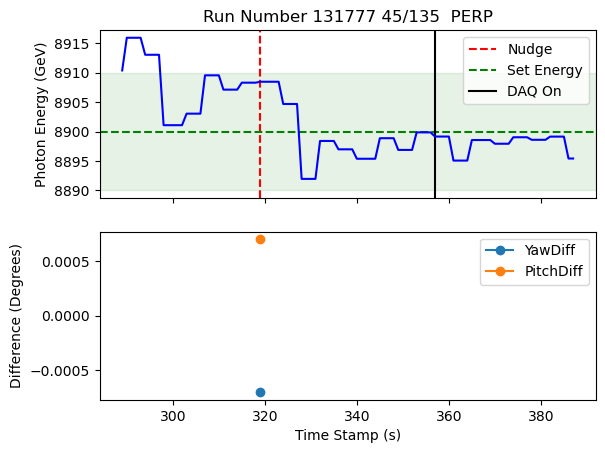

should have  [4] nudges for run 131777
energy change is 11.157999999999447
num_nudges_better is 1.0
energy change per nudge for run  131777 is 11.157999999999447
plotting for run  131807
Nudge number 2 occurs at time 227.0
Nudge number 3 occurs at time 249.0
Nudge number 4 occurs at time 259.0
Nudge number 5 occurs at time 280.0
Nudge number 6 occurs at time 300.0
daq on at time 133.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    189
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6813
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

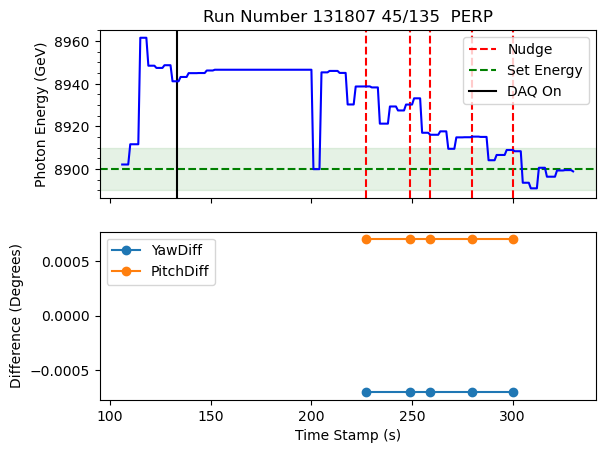

should have  [6] nudges for run 131807
energy change is 39.7920000000031
num_nudges_better is 4.9
energy change per nudge for run  131807 is 8.120816326531244
plotting for run  131825
Nudge number 5 occurs at time 235.0
Nudge number 6 occurs at time 249.0
Nudge number 7 occurs at time 257.0
Nudge number 8 occurs at time 265.0
Nudge number 9 occurs at time 283.0
Nudge number 10 occurs at time 334.0
daq on at time 470.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    285
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    2573
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

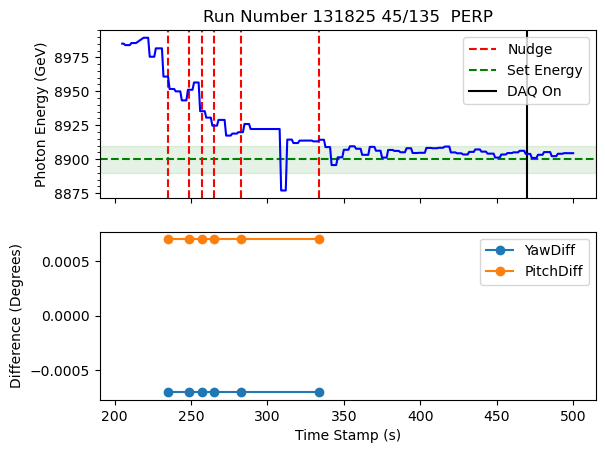

should have  [10] nudges for run 131825
energy change is 55.074000000000524
num_nudges_better is 5.9
energy change per nudge for run  131825 is 9.33457627118653
plotting for run  131863
Nudge number 2 occurs at time 165.0
Nudge number 3 occurs at time 183.0
Nudge number 4 occurs at time 223.0
Nudge number 5 occurs at time 247.0
daq on at time 418.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    314
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    3412
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

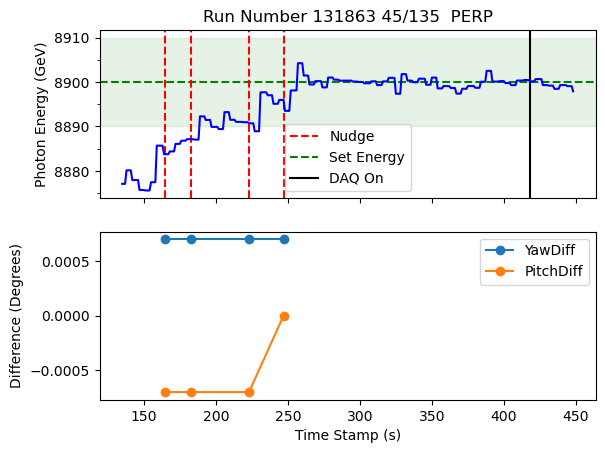

should have  [5] nudges for run 131863
energy change is 16.25249999999869
num_nudges_better is 4.0
energy change per nudge for run  131863 is 4.063124999999673
plotting for run  131866
Nudge number 1 occurs at time 689.0
daq on at time 44.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    645
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    690
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

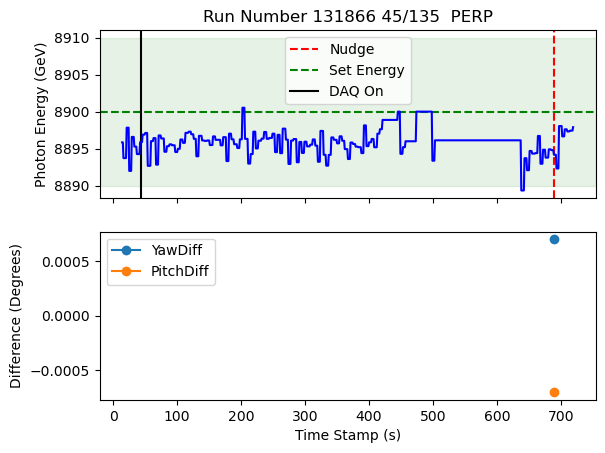

should have  [1] nudges for run 131866
energy change is 3.2120000000013533
num_nudges_better is 1.0
energy change per nudge for run  131866 is 3.2120000000013533
plotting for run  131918
Nudge number 2 occurs at time 159.0
Nudge number 3 occurs at time 178.0
Nudge number 4 occurs at time 207.0
daq on at time 285.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    187
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    502
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

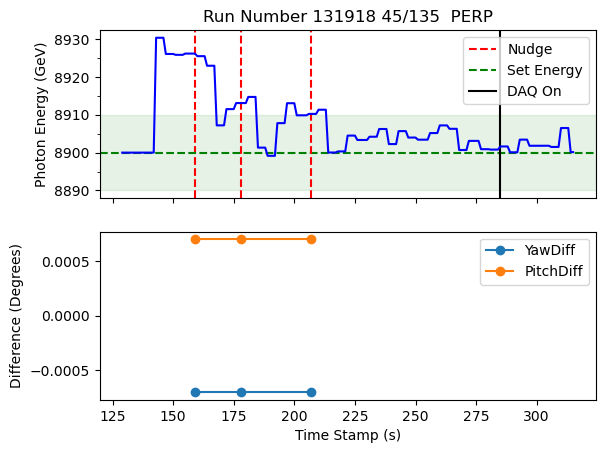

should have  [4] nudges for run 131918
energy change is 21.590000000000146
num_nudges_better is 3.0
energy change per nudge for run  131918 is 7.196666666666715
plotting for run  131932
Nudge number 5 occurs at time 218.0
Nudge number 6 occurs at time 236.0
Nudge number 7 occurs at time 258.0
Nudge number 8 occurs at time 280.0
daq on at time 333.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    176
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    7358
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

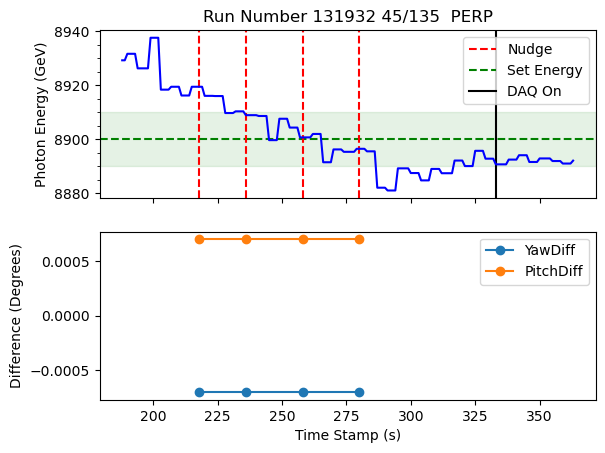

should have  [9] nudges for run 131932
energy change is 31.8224999999984
num_nudges_better is 4.0
energy change per nudge for run  131932 is 7.9556249999996
plotting for run  132033
Nudge number 5 occurs at time 277.0
Nudge number 6 occurs at time 282.0
Nudge number 7 occurs at time 286.0
Nudge number 8 occurs at time 294.0
Nudge number 9 occurs at time 303.0
Nudge number 10 occurs at time 327.0
Nudge number 11 occurs at time 388.0
daq on at time 751.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    535
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    6057
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

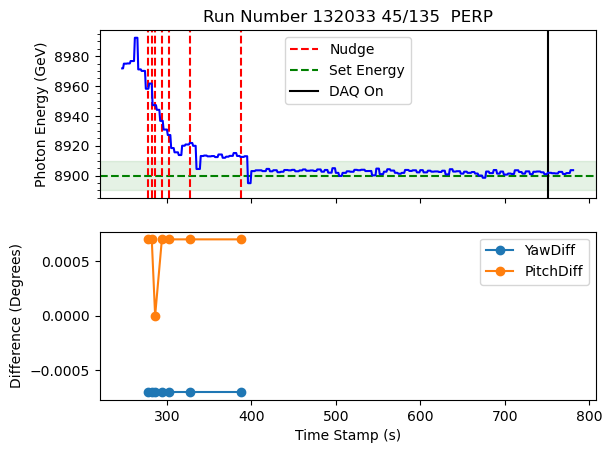

should have  [11] nudges for run 132033
energy change is 54.65599999999904
num_nudges_better is 6.9
energy change per nudge for run  132033 is 7.921159420289715
plotting for run  132061
Nudge number 5 occurs at time 1570.0
daq on at time 628.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    992
Name: count, dtype: int64
roll values are GONI:ROLL
28.4    5987
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

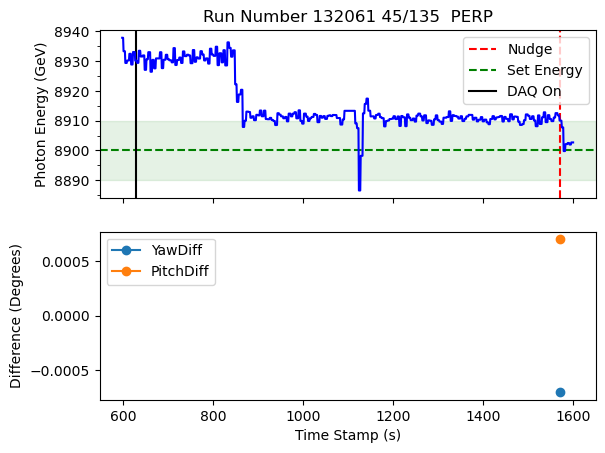

should have  [5] nudges for run 132061
energy change is 7.697500000000218
num_nudges_better is 1.0
energy change per nudge for run  132061 is 7.697500000000218
plotting for run  132071
Nudge number 2 occurs at time 529.0
Nudge number 3 occurs at time 536.0
daq on at time 577.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0    28.4
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
28.4    109
Name: count, dtype: int64
roll values are GONI:ROLL
 28.4    6964
-16.6     102
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

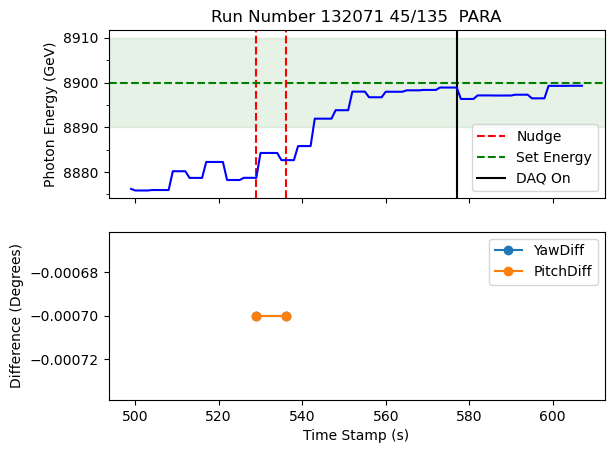

should have  [3] nudges for run 132071
energy change is 18.220000000001164
num_nudges_better is 2.0
energy change per nudge for run  132071 is 9.110000000000582
plotting for run  131421
Nudge number 1 occurs at time 2165.0
Nudge number 2 occurs at time 2328.0
Nudge number 3 occurs at time 2374.0
Nudge number 4 occurs at time 2389.0
Nudge number 5 occurs at time 2406.0
Nudge number 6 occurs at time 2425.0
daq on at time 777.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    1514
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6023
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

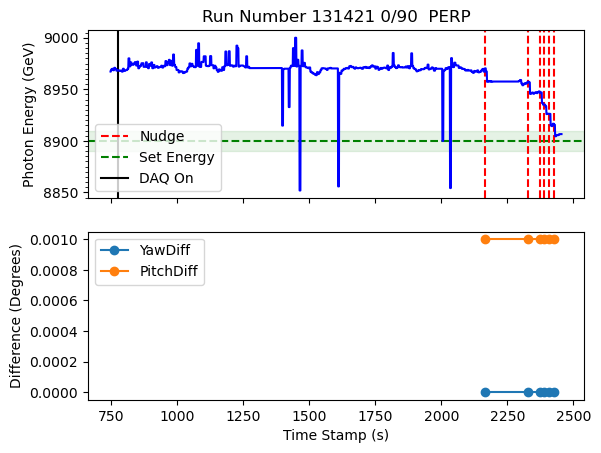

should have  [6] nudges for run 131421
energy change is 64.22999999999956
num_nudges_better is 6.0
energy change per nudge for run  131421 is 10.704999999999927
plotting for run  131602
Nudge number 2 occurs at time 2449.0
daq on at time 890.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    1408
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    2739
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

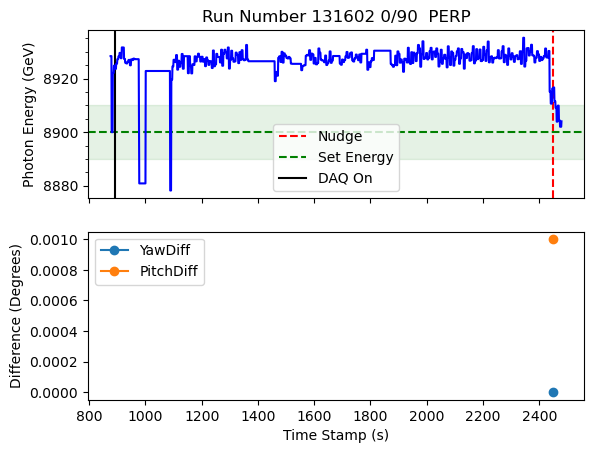

should have  [2] nudges for run 131602
energy change is 11.416000000001077
num_nudges_better is 1.0
energy change per nudge for run  131602 is 11.416000000001077
plotting for run  131634
Nudge number 2 occurs at time 289.0
Nudge number 3 occurs at time 309.0
Nudge number 4 occurs at time 312.0
Nudge number 5 occurs at time 326.0
Nudge number 6 occurs at time 346.0
Nudge number 7 occurs at time 347.0
daq on at time 459.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    200
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7007
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

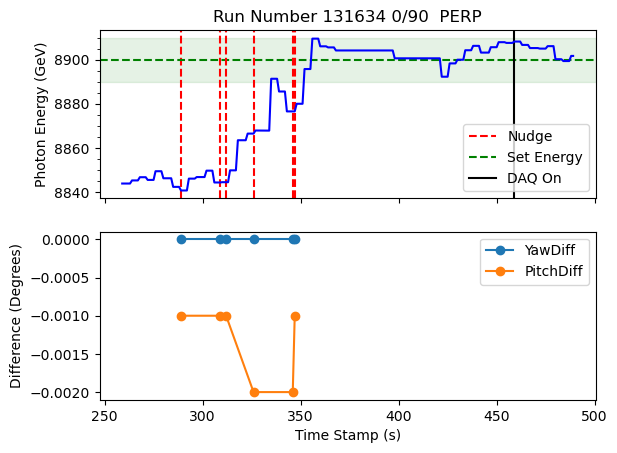

should have  [8] nudges for run 131634
energy change is 64.71000000000095
num_nudges_better is 6.0
energy change per nudge for run  131634 is 10.785000000000158
plotting for run  131677
Nudge number 1 occurs at time 59.0
Nudge number 2 occurs at time 72.0
Nudge number 3 occurs at time 73.0
daq on at time 261.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    242
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

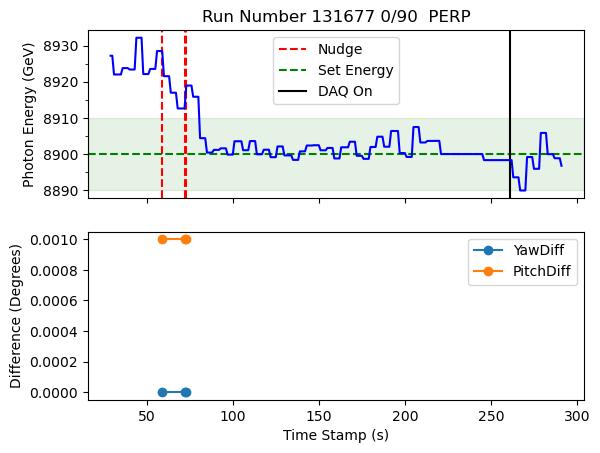

should have  [3] nudges for run 131677
energy change is 27.195999999998094
num_nudges_better is 3.0
energy change per nudge for run  131677 is 9.065333333332697
plotting for run  131771
Nudge number 1 occurs at time 347.0
Nudge number 2 occurs at time 370.0
daq on at time 991.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    705
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3011
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

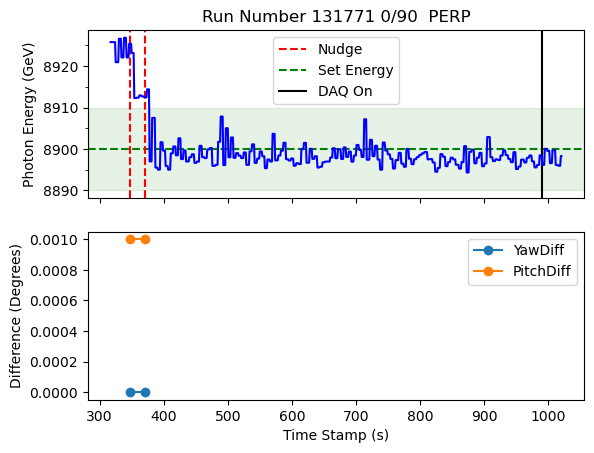

should have  [2] nudges for run 131771
energy change is 25.536000000000058
num_nudges_better is 2.0
energy change per nudge for run  131771 is 12.768000000000029
plotting for run  131801
Nudge number 2 occurs at time 229.0
daq on at time 266.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    98
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    4913
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

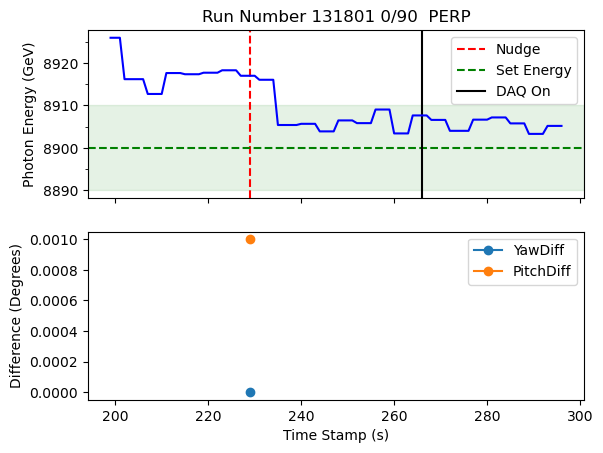

should have  [2] nudges for run 131801
energy change is 10.665000000000873
num_nudges_better is 1.0
energy change per nudge for run  131801 is 10.665000000000873
plotting for run  131874
Nudge number 2 occurs at time 343.0
daq on at time 391.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    109
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    2506
 0.0      129
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

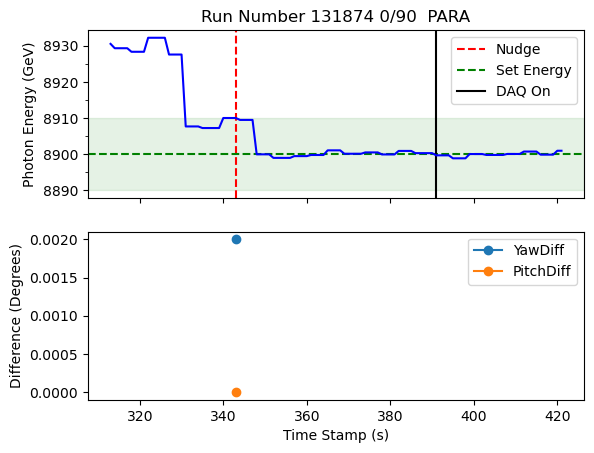

should have  [2] nudges for run 131874
energy change is 9.882499999999709
num_nudges_better is 2.0
energy change per nudge for run  131874 is 4.9412499999998545
plotting for run  131891
Nudge number 1 occurs at time 7577.0
daq on at time 143.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    7399
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7635
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

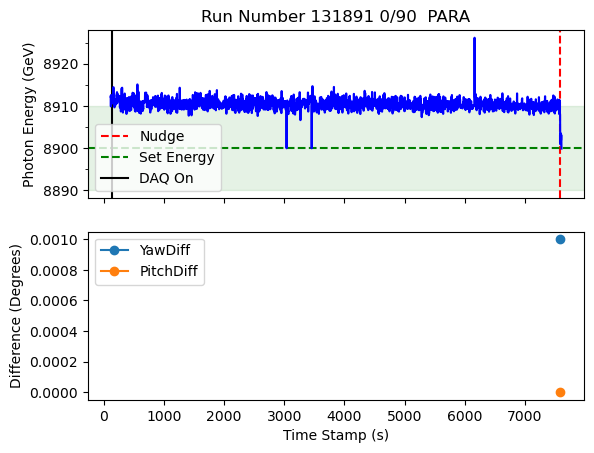

should have  [1] nudges for run 131891
energy change is 9.46600000000035
num_nudges_better is 1.0
energy change per nudge for run  131891 is 9.46600000000035
plotting for run  131908
Nudge number 2 occurs at time 672.0
Nudge number 3 occurs at time 698.0
Nudge number 4 occurs at time 729.0
daq on at time 848.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    202
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3316
 0.0      221
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

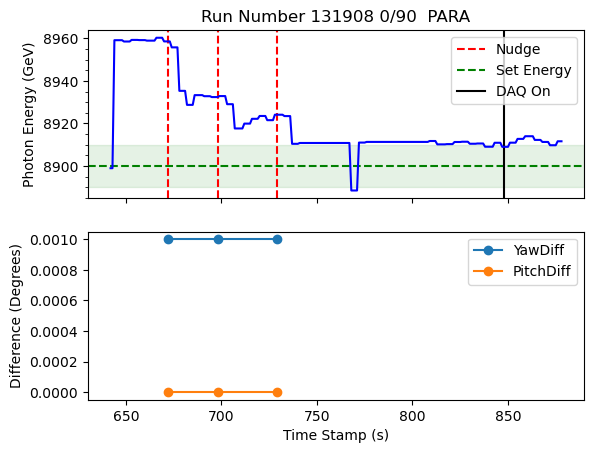

should have  [4] nudges for run 131908
energy change is 47.659999999999854
num_nudges_better is 3.0
energy change per nudge for run  131908 is 15.886666666666619
plotting for run  131925
Nudge number 2 occurs at time 1700.0
Nudge number 3 occurs at time 1701.0
Nudge number 4 occurs at time 1702.0
Nudge number 5 occurs at time 1703.0
daq on at time 1614.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    108
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5505
 0.0      143
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

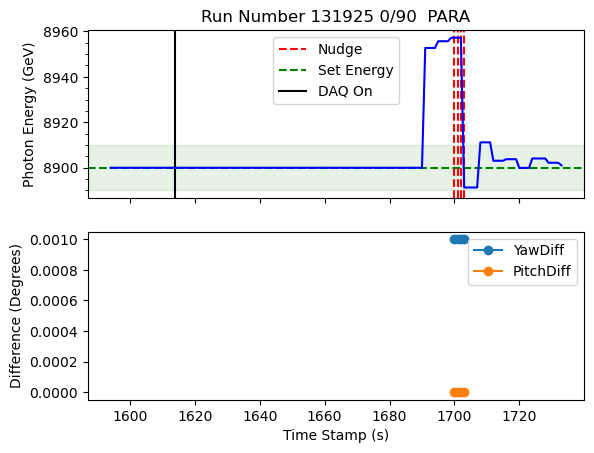

should have  [5] nudges for run 131925
energy change is 54.977999999999156
num_nudges_better is 4.0
energy change per nudge for run  131925 is 13.744499999999789
plotting for run  132009
Nudge number 5 occurs at time 419.0
Nudge number 6 occurs at time 430.0
Nudge number 7 occurs at time 442.0
Nudge number 8 occurs at time 483.0
Nudge number 9 occurs at time 498.0
Nudge number 10 occurs at time 511.0
Nudge number 11 occurs at time 525.0
Nudge number 12 occurs at time 554.0
daq on at time 139.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    453
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    3212
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

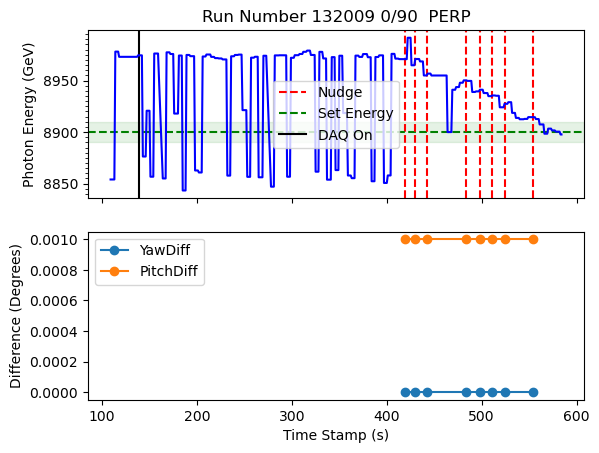

should have  [12] nudges for run 132009
energy change is 70.42599999999948
num_nudges_better is 8.0
energy change per nudge for run  132009 is 8.803249999999935
plotting for run  132024
Nudge number 2 occurs at time 481.0
Nudge number 3 occurs at time 509.0
daq on at time 634.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    214
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7302
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

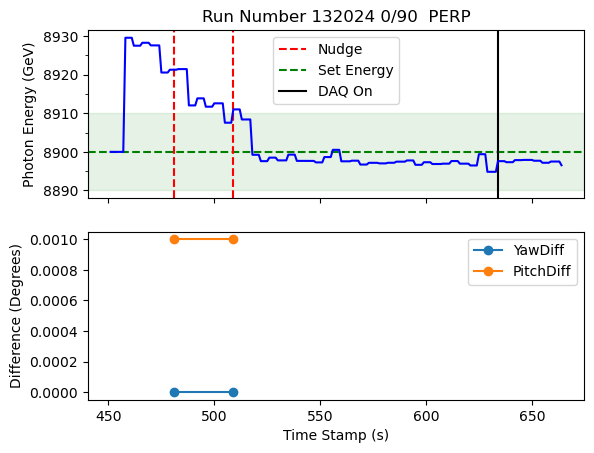

should have  [3] nudges for run 132024
energy change is 23.116000000001804
num_nudges_better is 2.0
energy change per nudge for run  132024 is 11.558000000000902
plotting for run  132048
Nudge number 1 occurs at time 178.0
Nudge number 2 occurs at time 182.0
Nudge number 3 occurs at time 204.0
Nudge number 4 occurs at time 230.0
daq on at time 0.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    217
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6535
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

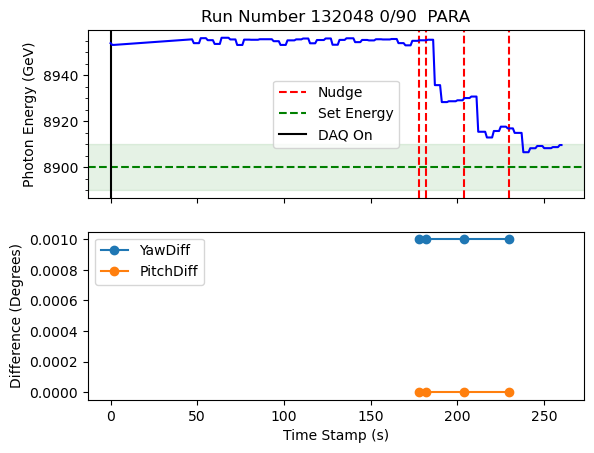

should have  [4] nudges for run 132048
energy change is 46.27399999999943
num_nudges_better is 4.0
energy change per nudge for run  132048 is 11.568499999999858
plotting for run  132093
Nudge number 4 occurs at time 398.0
daq on at time 407.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    70
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5891
 0.0       77
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

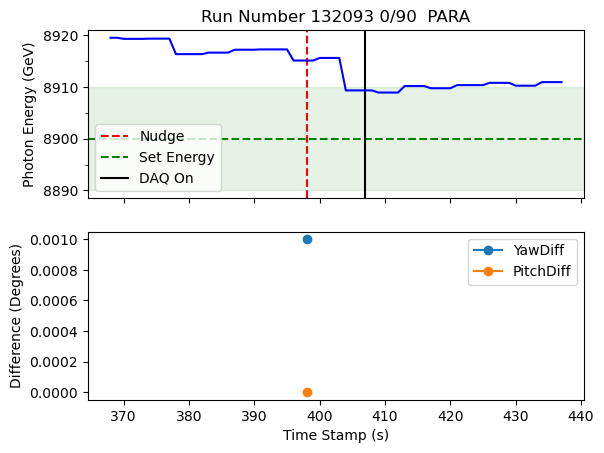

should have  [4] nudges for run 132093
energy change is 4.835000000000946
num_nudges_better is 1.0
energy change per nudge for run  132093 is 4.835000000000946
plotting for run  132095
Nudge number 2 occurs at time 127.0
Nudge number 3 occurs at time 129.0
Nudge number 4 occurs at time 147.0
Nudge number 5 occurs at time 148.0
daq on at time 276.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    210
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    6403
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

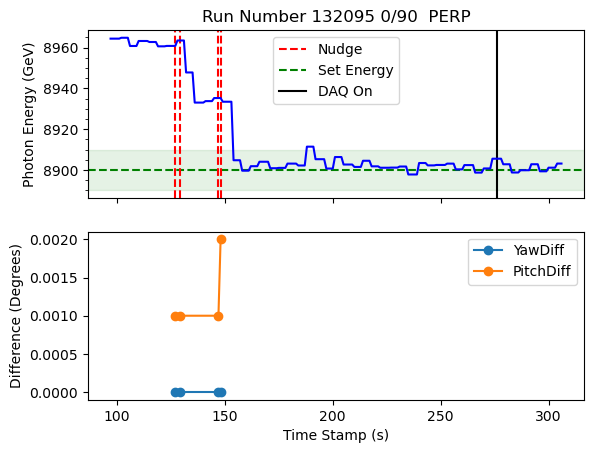

should have  [5] nudges for run 132095
energy change is 58.82999999999993
num_nudges_better is 4.0
energy change per nudge for run  132095 is 14.707499999999982
plotting for run  132108
Nudge number 1 occurs at time 163.0
Nudge number 2 occurs at time 361.0
Nudge number 3 occurs at time 382.0
Nudge number 4 occurs at time 401.0
Nudge number 5 occurs at time 422.0
Nudge number 6 occurs at time 461.0
daq on at time 644.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    513
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    7730
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

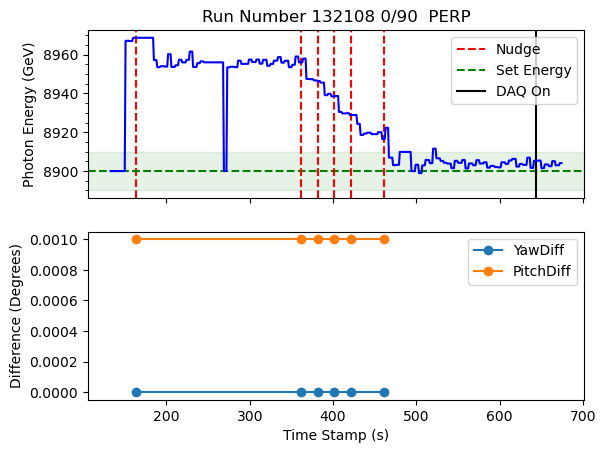

should have  [6] nudges for run 132108
energy change is 62.11499999999978
num_nudges_better is 6.0
energy change per nudge for run  132108 is 10.352499999999964
plotting for run  132111
Nudge number 1 occurs at time 5.0
daq on at time 124.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    155
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5637
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

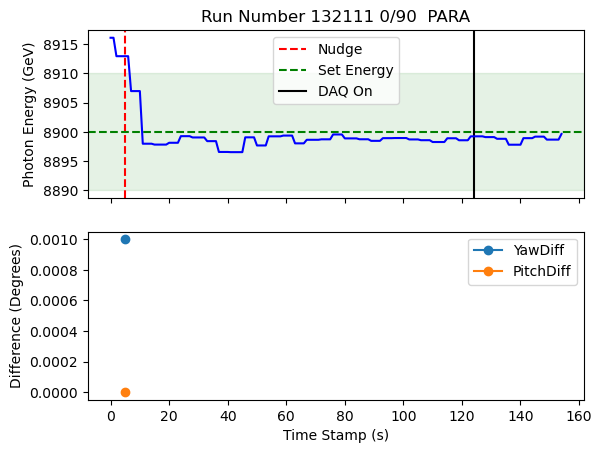

should have  [2] nudges for run 132111
energy change is 14.210000000000946
num_nudges_better is 1.0
energy change per nudge for run  132111 is 14.210000000000946
plotting for run  132127
Nudge number 2 occurs at time 29.0
Nudge number 3 occurs at time 35.0
daq on at time 180.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    211
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5536
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

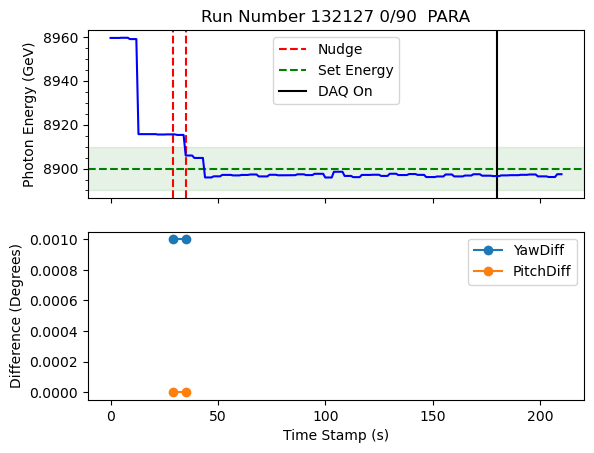

should have  [3] nudges for run 132127
energy change is 18.601999999997133
num_nudges_better is 2.0
energy change per nudge for run  132127 is 9.300999999998567
plotting for run  132145
Nudge number 2 occurs at time 248.0
Nudge number 3 occurs at time 269.0
Nudge number 4 occurs at time 279.0
Nudge number 5 occurs at time 280.0
Nudge number 6 occurs at time 300.0
daq on at time 327.0
[2.]
plane_values are 0    2.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    140
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5796
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

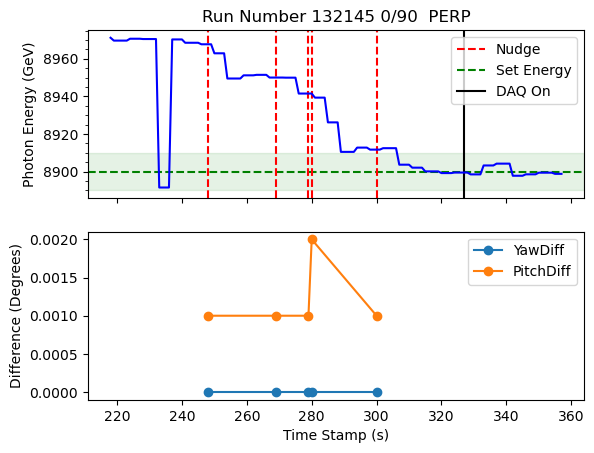

should have  [6] nudges for run 132145
energy change is 68.32750000000124
num_nudges_better is 5.0
energy change per nudge for run  132145 is 13.665500000000247
plotting for run  132158
Nudge number 4 occurs at time 561.0
Nudge number 5 occurs at time 599.0
Nudge number 6 occurs at time 619.0
daq on at time 737.0
[1.]
plane_values are 0    1.0
Name: CBREM:PLANE, dtype: float64
roll_values are 0   -16.6
Name: GONI:ROLL, dtype: float64
roll values are GONI:ROLL
-16.6    237
Name: count, dtype: int64
roll values are GONI:ROLL
-16.6    5849
 0.0      133
Name: count, dtype: int64


<Figure size 640x480 with 0 Axes>

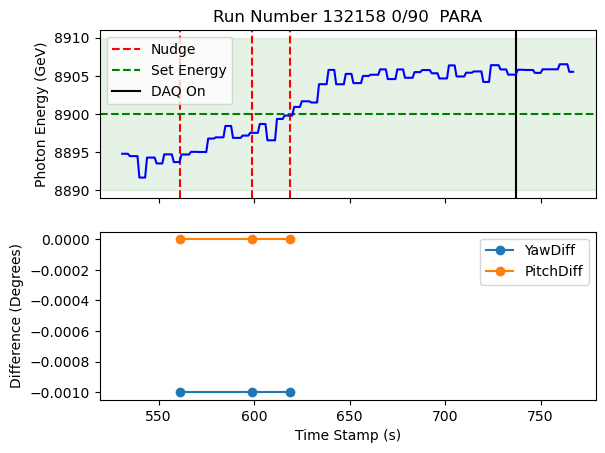

should have  [6] nudges for run 132158
energy change is 11.00250000000051
num_nudges_better is 3.0
energy change per nudge for run  132158 is 3.6675000000001696


<Figure size 640x480 with 0 Axes>

In [21]:
number_nudges = []
energy_changes = []

number_nudges_0_90 = []
energy_changes_0_90 = []

number_nudges_45_135 = []
energy_changes_45_135 = []

# run lists determined by manually looking through plots of all runs, output in cell above
runs_45_135 = [131409, 131662, 131703, 131714, 131734, 131777, 131807, 131825, 131863, 131866, 131918, 131932, 132033, 132061, 132071]
runs_0_90 = [131421, 131602, 131634, 131677, 131771, 131801, 131874, 131891, 131908, 131925, 132009, 132024, 132048, 132093, 132095, 132108, 132111, 132127, 132145, 132158]
good_run_list = runs_45_135+runs_0_90

# some of the runs listed above have unreliable behavior, ie nudges that do nothing, but aren't labeled as backlash
exclude_runs = []
for runNum in good_run_list:
    if runNum in exclude_runs:
        continue

    plot_run(df_2025_good,runNum)

    df_tmp = df_2025_good[(df_2025_good['RunNumber']==runNum)&(df_2025_good['NudgeOccurred'])&(~df_2025_good['BacklashNudge'])]
    df_tmp.reset_index(inplace=True)


    print('should have ',df_tmp['TotalNudges_thisRun'].unique(),'nudges for run',runNum)

    # we are looking at the subset of nudges that are not backlash, so none of these methods work for us
    #num_nudges = df_tmp['TotalNudgeSize_thisRun'].unique()[0]/0.001
    #num_nudges_alt = df_tmp['TotalNudges_thisRun'].unique()[0]
    
    # need to loop over nudge sizes, add in quadrature, and divide by 0.001
    num_nudges_fixed = 0
    for nudgeVal in df_tmp['NudgeNumber'].unique():
        df_tmp2 = df_tmp[df_tmp['NudgeNumber']==nudgeVal]
        num_nudges_fixed += (df_tmp['NudgePitchSize'].mode()[0]**2+df_tmp['NudgeYawSize'].mode()[0]**2)**0.5
    num_nudges_fixed = round(num_nudges_fixed/0.001,1)



    # look at energy at first nudge, compare to avg of last 5 energies
    nudge_list = df_tmp['NudgeNumber'].unique()
    df_first_nudge = df_tmp[df_tmp['NudgeNumber']==min(nudge_list)]
    df_first_nudge.reset_index()
    initial_energy = df_first_nudge.loc[0,'CBREM:ENERGY']


    # look 15-30 seconds after last nudge, take avg time
    df_last_nudge = df_tmp[df_tmp['NudgeNumber']==max(nudge_list)]
    df_last_nudge.reset_index(inplace=True)

    last_nudge_time = df_last_nudge.loc[0,'TimeStamp']

    df_end = df_2025_good[(df_2025_good['RunNumber']==runNum)&(df_2025_good['TimeStamp']>=(last_nudge_time+15))&(df_2025_good['TimeStamp']<=(last_nudge_time+30))]
    end_energies = df_end['CBREM:ENERGY'].unique()

    final_energy = np.mean(end_energies)

    energy_change = abs(final_energy - initial_energy)

    energy_changes.append(energy_change)
    number_nudges.append(num_nudges_fixed)

    print('energy change is',energy_change)
    print('num_nudges_better is',num_nudges_fixed)
    print('energy change per nudge for run ',runNum,'is',energy_change/num_nudges_fixed)

    if runNum in runs_45_135:
        energy_changes_45_135.append(energy_change)
        number_nudges_45_135.append(num_nudges_fixed)
    else:
        energy_changes_0_90.append(energy_change)
        number_nudges_0_90.append(num_nudges_fixed)


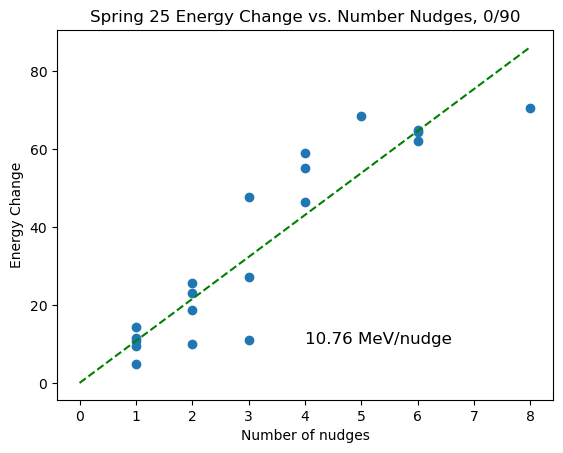

In [24]:
plt.scatter(number_nudges_0_90,energy_changes_0_90)
plt.title("Spring 25 Energy Change vs. Number Nudges, 0/90")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,50)
plt.ylabel("Energy Change")

from sklearn.linear_model import LinearRegression 
lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_0_90).reshape(-1,1)
y = energy_changes_0_90
lr.fit(X,y)

x_vals = np.array(np.arange(0,max(number_nudges_0_90)+1,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_0_90_Spring25.pdf')

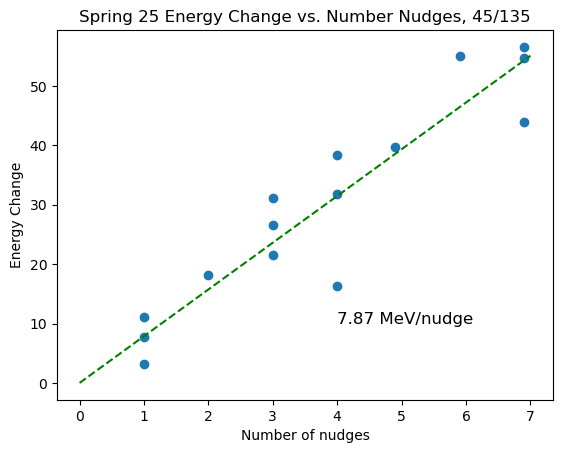

In [23]:
plt.scatter(number_nudges_45_135,energy_changes_45_135)
plt.title("Spring 25 Energy Change vs. Number Nudges, 45/135")
plt.xlabel("Number of nudges")
#plt.xlim(0,6)
#plt.ylim(0,30)
plt.ylabel("Energy Change")

lr = LinearRegression(fit_intercept=False)

X = np.array(number_nudges_45_135).reshape(-1,1)
y = energy_changes_45_135
lr.fit(X,y)

x_vals = np.array(np.arange(0,max(number_nudges_45_135)+1,1)).reshape(-1,1)
y_pred = lr.predict(x_vals)

plt.plot(x_vals,y_pred,color='g',linestyle='--')
plt.text(4.0,10,str(round(lr.coef_[0],2))+" MeV/nudge",fontsize=12)
plt.savefig('plots/multiNudge/energyChange_vs_Nudge_45_135_Spring25.pdf')